# CHAPTER 1: DEFINITION OF THE PROBLEM STATEMENT AND EXPLORATORY DATA ANALYSIS

## INTRODUCTION TO `OLA CABS`

> Ola Cabs is an `Indian multinational ridesharing company`, headquartered in `Bangalore`. `ANI Technologies` is the holding company of Ola Cabs. It also operates Ola Fleet, Ola Financial Services, Ola Foods and Ola Electric. Ola Cabs is India's largest mobility platform and one of the world's largest ride hailing companies, serving 250+ cities across India, Australia, New Zealand and the UK.

> Ola app offers mobility solutions by connecting customers to drivers and a wide range of vehicles across bikes, auto-rickshaws, metered taxis and cabs, enabling convenience and transperency for hundreds of millions of customers and over 1.5 million driver partners

## DEFINITION OF THE PROBLEM

> Recruiting and retaining the drivers is one of tough task for Ola Industry managers. Churn among drivers is high and it's very easy for drivers to stop working for the service on the fly or jump to its competitor 'Uber' depending on the rates.

> As the companies get bigger, the high churn could become a bigger problem. To find new drivers, Ola is casting a wide net, including people who don't have cars for jobs also. But this acquisition is really costly. Losing drivers frequently impacts the morale of the organisation and acquiring new drivers is more expensive than retaining existing ones.

> Assume You are working as a data scientist with the analytics department of Ola, focused on driver team attrition. You are provided with the monthly information for a segment of drivers for 2019 and 2020.

> Task is `to predict whether a driver will be leaving the company or not, based on their attributes like
1. Demographics (city,age, gender etc.,)
2. Tenure information (joining date, last date)
3. Historical data regarding the performance of the driver (Quarterly rating, Monthly business acquired, grade, income)

## IMPORTING THE LIBRARIES AND DATASET

### Importing all the required libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import combinations,permutations
from pandas.api.types import is_datetime64_any_dtype
import math, warnings,datetime,regex,mlflow,mlflow.sklearn,time,os
from scipy import stats
from sklearn.preprocessing import MinMaxScaler,StandardScaler,PowerTransformer
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV,KFold,learning_curve,validation_curve,cross_val_score,cross_validate,cross_val_predict
from sklearn.decomposition import PCA
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier,DecisionTreeRegressor,plot_tree,export_graphviz
from six import StringIO
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor,BaggingClassifier,StackingClassifier,VotingClassifier,AdaBoostClassifier,GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.impute import KNNImputer
from sklearn.metrics import accuracy_score,precision_score,recall_score,precision_recall_fscore_support,precision_recall_curve,ConfusionMatrixDisplay,confusion_matrix,roc_auc_score,roc_curve,mean_absolute_error,mean_squared_error,classification_report,f1_score,fbeta_score,auc
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier,DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier,BaggingClassifier,VotingClassifier,AdaBoostClassifier,StackingClassifier,GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.base import BaseEstimator, ClassifierMixin, clone
pd.set_option('display.max_columns', None)

### Importing the Dataset

In [ ]:
ola = pd.read_csv('ola_driver_scaler.csv')

In [ ]:
# top 10 rows of the dataset
ola.head(10)

,Unnamed: 0,MMM-YY,Driver_ID,Age,Gender,City,Education_Level,Income,Dateofjoining,LastWorkingDate,Joining Designation,Grade,Total Business Value,Quarterly Rating
0,0,01/01/19,1,28.0,0.0,C23,2,57387,24/12/18,NaN,1,1,2381060,2
1,1,02/01/19,1,28.0,0.0,C23,2,57387,24/12/18,NaN,1,1,-665480,2
2,2,03/01/19,1,28.0,0.0,C23,2,57387,24/12/18,03/11/19,1,1,0,2
3,3,11/01/20,2,31.0,0.0,C7,2,67016,11/06/20,NaN,2,2,0,1
4,4,12/01/20,2,31.0,0.0,C7,2,67016,11/06/20,NaN,2,2,0,1
5,5,12/01/19,4,43.0,0.0,C13,2,65603,12/07/19,NaN,2,2,0,1
6,6,01/01/20,4,43.0,0.0,C13,2,65603,12/07/19,NaN,2,2,0,1
7,7,02/01/20,4,43.0,0.0,C13,2,65603,12/07/19,NaN,2,2,0,1
8,8,03/01/20,4,43.0,0.0,C13,2,65603,12/07/19,NaN,2,2,350000,1
9,9,04/01/20,4,43.0,0.0,C13,2,65603,12/07/19,27/04/20,2,2,0,1


In [ ]:
ola.drop(columns=["Unnamed: 0"],inplace= True)

### Description regarding each column of the dataset

|Column Name|Description|
|-----------|-----------|
|**MMM-YY**|Reporting Date(Monthly)|
|**Driver_ID**|Unique Id for drivers|
|**Age**|Age of the driver|
|**Gender**|Gender of the driver - Male: 0, Female: 1|
|**City**|City Code of the driver|
|**Education_Level**|Education level - 0 for 10+, 1 for 12+, 2 for graduate|
|**Income**|Monthly average Income of the driver|
|**Dateofjoining**|Joining date for the driver|
|**LastWorkingDate**|Last date of working for the driver|
|**Joining Designation**|Designation of the driver at the time of joining|
|**Grade**|Grade of the driver at the time of reporting|
|**Total Business Value**|the total business value acquired by the driver in a month (negative business indicates cancellation/refund or car EMI adjustments)|
|**Quarterly Rating**|Quarterly rating of the driver: 1,2,3,4,5(higher is better)|

## ANALYSING BASIC METRICS OF DATASET

### Shape of the data

In [ ]:
print(f"Number of rows in the dataset = {ola.shape[0]}")
print(f"Number of columns in the dataset = {ola.shape[1]}")

Number of rows in the dataset = 19104
Number of columns in the dataset = 13


### Datatypes of all the attributes

In [ ]:
ola.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19104 entries, 0 to 19103
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   MMM-YY                19104 non-null  object 
 1   Driver_ID             19104 non-null  int64  
 2   Age                   19043 non-null  float64
 3   Gender                19052 non-null  float64
 4   City                  19104 non-null  object 
 5   Education_Level       19104 non-null  int64  
 6   Income                19104 non-null  int64  
 7   Dateofjoining         19104 non-null  object 
 8   LastWorkingDate       1616 non-null   object 
 9   Joining Designation   19104 non-null  int64  
 10  Grade                 19104 non-null  int64  
 11  Total Business Value  19104 non-null  int64  
 12  Quarterly Rating      19104 non-null  int64  
dtypes: float64(2), int64(7), object(4)
memory usage: 1.9+ MB


**Observation**
> Should convert MMM-YY, Dateofjoining and LastWorkingDate from object dtype to datetime64 dtype

### Missing value or Null Value Detection

In [ ]:
# Null value count
ola.isnull().sum()

MMM-YY                      0
Driver_ID                   0
Age                        61
Gender                     52
City                        0
Education_Level             0
Income                      0
Dateofjoining               0
LastWorkingDate         17488
Joining Designation         0
Grade                       0
Total Business Value        0
Quarterly Rating            0
dtype: int64

In [ ]:
# Percenatage of Null Values
(ola.isna().sum() / ola.shape[0]) * 100

MMM-YY                   0.000000
Driver_ID                0.000000
Age                      0.319305
Gender                   0.272194
City                     0.000000
Education_Level          0.000000
Income                   0.000000
Dateofjoining            0.000000
LastWorkingDate         91.541039
Joining Designation      0.000000
Grade                    0.000000
Total Business Value     0.000000
Quarterly Rating         0.000000
dtype: float64

In [ ]:
# Filtering the columns which have zero null values and sorting in descending order
def missing_ola(ola):
    total_missing_ola = ola.isna().sum().sort_values(ascending = False)
    percentage_missing_ola = ((ola.isna().sum()/len(ola)*100)).sort_values(ascending = False)
    missingola = pd.concat([total_missing_ola, percentage_missing_ola],axis = 1, keys=['Total', 'Percent'])
    return missingola


missing_ola = missing_ola(ola)
missing_ola[missing_ola["Total"]>0]

,Total,Percent
LastWorkingDate,17488,91.541039
Age,61,0.319305
Gender,52,0.272194


**Observation**
> 91.54 % Null values are present in LastWorkingDate. This implies that 91.54% drivers has not churned off from OLA. Remaining 8.46% drivers has last working date, so they have churned off from OLA.

> Age and gender may be related to other features like education, Income etc., So KNN Null Value Imputation is suitable

### Descriptive Statistics regarding each column of dataset

In [ ]:
ola.describe()

,Driver_ID,Age,Gender,Education_Level,Income,Joining Designation,Grade,Total Business Value,Quarterly Rating
count,19104.000000,19043.000000,19052.000000,19104.000000,19104.000000,19104.000000,19104.000000,1.910400e+04,19104.000000
mean,1415.591133,34.668435,0.418749,1.021671,65652.025126,1.690536,2.252670,5.716621e+05,2.008899
std,810.705321,6.257912,0.493367,0.800167,30914.515344,0.836984,1.026512,1.128312e+06,1.009832
min,1.000000,21.000000,0.000000,0.000000,10747.000000,1.000000,1.000000,-6.000000e+06,1.000000
25%,710.000000,30.000000,0.000000,0.000000,42383.000000,1.000000,1.000000,0.000000e+00,1.000000
50%,1417.000000,34.000000,0.000000,1.000000,60087.000000,1.000000,2.000000,2.500000e+05,2.000000
75%,2137.000000,39.000000,1.000000,2.000000,83969.000000,2.000000,3.000000,6.997000e+05,3.000000
max,2788.000000,58.000000,1.000000,2.000000,188418.000000,5.000000,5.000000,3.374772e+07,4.000000


**Observation**
> mean of Age --> 34.66, median of Age --> 34 (may be less number of outliers as there is small difference between mean and median)

> mean of Income --> 65652.025, median of Income --> 60087 (may be more number of outliers as there is large difference between mean and median)

> mean of Total Business value --> 571662.1, median of Total Business value --> 250000 (may be more number of outliers as there is large difference between mean and median)

> Driver_ID has min --> 1, max --> 2788, count --> 19104 (These metrics explain that given dataset has duplicate driver_ids because each driver_id will have multiple logs into the dataset with monthly frequency)

In [ ]:
ola.describe(include = "object")

,MMM-YY,City,Dateofjoining,LastWorkingDate
count,19104,19104,19104,1616
unique,24,29,869,493
top,01/01/19,C20,23/07/15,29/07/20
freq,1022,1008,192,70


### Number of unique values in each column of given dataset

In [ ]:
for i in ola.columns:
    print(i,":",ola[i].nunique())

MMM-YY : 24
Driver_ID : 2381
Age : 36
Gender : 2
City : 29
Education_Level : 3
Income : 2383
Dateofjoining : 869
LastWorkingDate : 493
Joining Designation : 5
Grade : 5
Total Business Value : 10181
Quarterly Rating : 4


### Unique values of columns whose nunique < 50

In [ ]:
for i in ola.columns:
    if ola[i].nunique() < 50:
        print(i,sorted(ola[i].unique()),"",sep = "\n")

MMM-YY
['01/01/19', '01/01/20', '02/01/19', '02/01/20', '03/01/19', '03/01/20', '04/01/19', '04/01/20', '05/01/19', '05/01/20', '06/01/19', '06/01/20', '07/01/19', '07/01/20', '08/01/19', '08/01/20', '09/01/19', '09/01/20', '10/01/19', '10/01/20', '11/01/19', '11/01/20', '12/01/19', '12/01/20']

Age
[21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, nan, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0, 53.0, 54.0, 55.0, 58.0]

Gender
[0.0, 1.0, nan]

City
['C1', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16', 'C17', 'C18', 'C19', 'C2', 'C20', 'C21', 'C22', 'C23', 'C24', 'C25', 'C26', 'C27', 'C28', 'C29', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9']

Education_Level
[0, 1, 2]

Joining Designation
[1, 2, 3, 4, 5]

Grade
[1, 2, 3, 4, 5]

Quarterly Rating
[1, 2, 3, 4]



**Observation**
> Joining Designation, Grade and Quarterly Rating having Encoding denoted with numericals from 1 to 5. Where 1 being least, 5 being highest

> Interestingly Quarterly rating 5 is missing in data.

> Education level 10+ is indicated with 0, 12+ is indicated with 1 and graduate with 2

### Conversion of MMM-YY, Dateofjoining and LastWorkingDate from object dtype to datetime64 dtype

In [ ]:
ola["MMM-YY"]=pd.to_datetime(ola["MMM-YY"],format="%m/%d/%y")
ola["Dateofjoining"]=pd.to_datetime(ola["Dateofjoining"],format="%d/%m/%y")
ola["LastWorkingDate"]=pd.to_datetime(ola["LastWorkingDate"],format="%d/%m/%y")

**Observation**
> Check the format of the date properly.

> For MMM-YY --> format --> MM/DD/YY so %m/%d/%y (Use %y for YY, Use %Y for YYYY)

> For Dateofjoining and LastWorkingDate --> format --> DD/MM/YY so %d/%m/%y

In [ ]:
ola.dtypes

MMM-YY                  datetime64[ns]
Driver_ID                        int64
Age                            float64
Gender                         float64
City                            object
Education_Level                  int64
Income                           int64
Dateofjoining           datetime64[ns]
LastWorkingDate         datetime64[ns]
Joining Designation              int64
Grade                            int64
Total Business Value             int64
Quarterly Rating                 int64
dtype: object

### Range of values of all numerical and date columns

In [ ]:
for i in ola.columns:
    if i != "City":
        print(f"Maximum of {i}",ola[i].max())
        print(f"Minimum of {i}",ola[i].min())
        print()

Maximum of MMM-YY 2020-12-01 00:00:00
Minimum of MMM-YY 2019-01-01 00:00:00

Maximum of Driver_ID 2788
Minimum of Driver_ID 1

Maximum of Age 58.0
Minimum of Age 21.0

Maximum of Gender 1.0
Minimum of Gender 0.0

Maximum of Education_Level 2
Minimum of Education_Level 0

Maximum of Income 188418
Minimum of Income 10747

Maximum of Dateofjoining 2020-12-28 00:00:00
Minimum of Dateofjoining 2013-01-04 00:00:00

Maximum of LastWorkingDate 2020-12-28 00:00:00
Minimum of LastWorkingDate 2018-12-31 00:00:00

Maximum of Joining Designation 5
Minimum of Joining Designation 1

Maximum of Grade 5
Minimum of Grade 1

Maximum of Total Business Value 33747720
Minimum of Total Business Value -6000000

Maximum of Quarterly Rating 4
Minimum of Quarterly Rating 1



In [ ]:
ola["MMM-YY"].max() - ola["MMM-YY"].min()

Timedelta('700 days 00:00:00')

**Observation**
> MMM-YY shows that data has about 24 months readings from Jan 2019 to Dec 2020. (700 days)

> Range of driver id is from 1 to 2788. But unique Driver Id's are 2381. So for some reason, some driver ids are missing in data. May be it is because of Driver Churn in the middle

> Age eligibility for driving is in range of 21 to 58

> Income has large difference between Max and min

> Drivers joining date starts from 2013 April. May be drivers who joined early may earn more total business value

> Last working date starts from 2018 December, Because we monthly reading starting from 2019 Jan onwards. Last date of Last working date is December 2020

> Total business value is negative and positive. Negative indicates loss value, cancellation or car EMI adjustments  

In [ ]:
for i in ola.columns:
    print("Value Counts of {}".format(i),end="\n\n")
    print(ola[i].value_counts(dropna= False),end="\n\n")

Value Counts of MMM-YY

MMM-YY
2019-01-01    1022
2019-02-01     944
2019-03-01     870
2020-12-01     819
2020-10-01     818
2020-08-01     812
2020-09-01     809
2020-07-01     806
2020-11-01     805
2019-12-01     795
2019-04-01     794
2020-01-01     782
2019-11-01     781
2020-06-01     770
2020-05-01     766
2019-05-01     764
2019-09-01     762
2020-02-01     761
2019-07-01     757
2019-08-01     754
2019-10-01     739
2020-04-01     729
2019-06-01     726
2020-03-01     719
Name: count, dtype: int64

Value Counts of Driver_ID

Driver_ID
2110    24
2617    24
1623    24
1642    24
1644    24
        ..
1614     1
445      1
2397     1
1619     1
469      1
Name: count, Length: 2381, dtype: int64

Value Counts of Age

Age
36.0    1283
33.0    1250
34.0    1234
30.0    1146
32.0    1143
35.0    1138
31.0    1076
29.0    1013
37.0     862
38.0     854
39.0     788
28.0     772
27.0     744
40.0     701
41.0     661
26.0     566
42.0     478
25.0     449
44.0     407
43.0     399
45

**Observation**

> Value counts of Driver Id is having max 24. Due to data of 24 months readings of each driver.

> Age from 30 to 36 having more number of drivers. Middle aged persons should be targeted.

> Gender ratio is (11074/7978 = ) 1.388 male for 1 female driver.

> Education levels almost have same count

> 2015, July 23 has highest peak in Date of joining (Should check monthly peaks)

> 2020, July 29 has highest driver count leaving the ola (Should check monthly graph)

> Joining designation has exponentialy decay from 1 to 5

> Grade 2 drivers are more than other grade

> Total Business value for so many rows (6499) is equal to zero. It is not a good sign. That means most of the drivers unable provide the business consistently.

> Quarterly rating also in decreasing manner from 1 to 4

# CHAPTER 2: PRELIMINARY DATA PREPROCESSING STEPS (NULL VALUE IMPUTATION, FEATURE ENGINEERING & AGGREGATION)

In [ ]:
# Creating a duplicate dataset for Data Preprocessing
ola_1 = ola.copy(deep = True)

In [ ]:
ola_1.isna().sum()

MMM-YY                      0
Driver_ID                   0
Age                        61
Gender                     52
City                        0
Education_Level             0
Income                      0
Dateofjoining               0
LastWorkingDate         17488
Joining Designation         0
Grade                       0
Total Business Value        0
Quarterly Rating            0
dtype: int64

**Observation**
> As Driver Id is repeating in the dataset, we can create a dictionary named as 'id_gender_dict'. In that dictionary, keys are Driver_id and values are Most Frequent Value of Gender of that Driver_ID.

> Gender null values can be imputed by using that id_gender_dict if that dictionary do not have any null values. Null values will be created if Gender feature is not logged at any reporting date for a driver_id. Then We have to use KNN imputation for Gender by using Hamming Distance as Distance metric as Gender is categorical Feature.

> Depending on Reporting date, Age Feature will change even for a driver. Either we can use KNN Imputer or ffill. As it is temporal data, ffill is better in this case.

## IMPUTATION OF NULL VALUES

### Gender Feature Null Value Imputation using id_gender_dict

#### Creating `id_gender_dict` Dictionary

In [ ]:
# Define a function to get the most frequent non-null gender
def get_most_frequent_gender(group):
    return group.dropna().mode().iloc[0] if not group.dropna().empty else None

# Group by Driver_id and apply the function
grouped = ola_1.groupby('Driver_ID')['Gender'].apply(get_most_frequent_gender).reset_index()

# Create the dictionary
id_gender_dict = pd.Series(grouped.Gender.values, index=grouped.Driver_ID).to_dict()

print(id_gender_dict)

{1: 0.0, 2: 0.0, 4: 0.0, 5: 0.0, 6: 1.0, 8: 0.0, 11: 1.0, 12: 0.0, 13: 0.0, 14: 1.0, 16: 1.0, 17: 0.0, 18: 1.0, 20: 1.0, 21: 1.0, 22: 0.0, 24: 0.0, 25: 0.0, 26: 0.0, 29: 0.0, 30: 0.0, 31: 1.0, 34: 1.0, 35: 0.0, 36: 1.0, 37: 1.0, 38: 0.0, 39: 0.0, 40: 0.0, 41: 0.0, 42: 1.0, 43: 1.0, 44: 0.0, 45: 0.0, 46: 1.0, 47: 0.0, 49: 0.0, 50: 1.0, 51: 0.0, 52: 0.0, 54: 0.0, 55: 1.0, 56: 1.0, 57: 1.0, 58: 0.0, 59: 1.0, 60: 1.0, 61: 0.0, 62: 0.0, 63: 0.0, 64: 0.0, 65: 1.0, 66: 1.0, 67: 0.0, 68: 0.0, 69: 1.0, 70: 0.0, 71: 0.0, 72: 0.0, 74: 1.0, 75: 1.0, 77: 0.0, 78: 0.0, 79: 0.0, 80: 1.0, 81: 0.0, 82: 1.0, 83: 0.0, 84: 0.0, 85: 0.0, 86: 0.0, 87: 0.0, 88: 1.0, 89: 0.0, 90: 0.0, 91: 0.0, 93: 0.0, 95: 1.0, 96: 0.0, 97: 1.0, 98: 0.0, 99: 0.0, 101: 0.0, 102: 1.0, 103: 1.0, 104: 1.0, 105: 0.0, 106: 1.0, 107: 0.0, 108: 0.0, 109: 1.0, 110: 1.0, 111: 0.0, 112: 0.0, 113: 1.0, 114: 1.0, 115: 0.0, 116: 0.0, 117: 1.0, 118: 1.0, 119: 1.0, 120: 0.0, 121: 1.0, 122: 0.0, 123: 0.0, 125: 1.0, 127: 0.0, 129: 1.0, 130: 0.

#### Check whether any driver has null value in the `id_gender_dict` dictionary

In [ ]:
# Check if any values in the dictionary are None
has_none_values = any(value is None for value in id_gender_dict.values())

print(f"Does id_gender_dict have None values? {has_none_values}")

Does id_gender_dict have None values? False


**Observation**
> As there are no null values in the dictionary, we can impute all the gender null values without any problem.

In [ ]:
# Function to impute Gender based on Driver_id using id_gender_dict
def impute_gender(row):
    if pd.isnull(row['Gender']):
        return id_gender_dict.get(row['Driver_ID'])
    return row['Gender']

# Apply the function to each row
ola_1['Gender'] = ola_1.apply(impute_gender, axis=1)

In [ ]:
ola_1.isna().sum()

MMM-YY                      0
Driver_ID                   0
Age                        61
Gender                      0
City                        0
Education_Level             0
Income                      0
Dateofjoining               0
LastWorkingDate         17488
Joining Designation         0
Grade                       0
Total Business Value        0
Quarterly Rating            0
dtype: int64

### Age Feature Null Value Imputation using ffill() and bfill()

In [ ]:
# Sort by 'Driver_ID' and 'Reporting Date' to ensure the most recent date comes first
ola_1 = ola_1.sort_values(by=['Driver_ID', 'MMM-YY'], ascending=[True,False])

# Forward fill the 'Age' values within each 'Driver_ID' group
ola_1['Age'] = ola_1.groupby('Driver_ID')['Age'].ffill()

In [ ]:
ola_1.isna().sum()

MMM-YY                      0
Driver_ID                   0
Age                         7
Gender                      0
City                        0
Education_Level             0
Income                      0
Dateofjoining               0
LastWorkingDate         17488
Joining Designation         0
Grade                       0
Total Business Value        0
Quarterly Rating            0
dtype: int64

**Observation**
> As 7 null values are remained after ffill method, Use bfill method to impute those nan values.

> ffill or bfill is better because we are imputing the null values to nearest possible age based on reporting date "MMM-YY" for respective driver.

In [ ]:
# Backward fill the 'Age' values within each 'Driver_ID' group for remaing 7 null values
ola_1['Age'] = ola_1.groupby('Driver_ID')['Age'].bfill()

In [ ]:
ola_1.isna().sum()

MMM-YY                      0
Driver_ID                   0
Age                         0
Gender                      0
City                        0
Education_Level             0
Income                      0
Dateofjoining               0
LastWorkingDate         17488
Joining Designation         0
Grade                       0
Total Business Value        0
Quarterly Rating            0
dtype: int64

## FEATURE ENGINEERING AND AGGREGATION BY `DRIVER_ID`

In [ ]:
ola_1.head()

,MMM-YY,Driver_ID,Age,Gender,City,Education_Level,Income,Dateofjoining,LastWorkingDate,Joining Designation,Grade,Total Business Value,Quarterly Rating
2,2019-03-01,1,28.0,0.0,C23,2,57387,2018-12-24,2019-11-03,1,1,0,2
1,2019-02-01,1,28.0,0.0,C23,2,57387,2018-12-24,NaT,1,1,-665480,2
0,2019-01-01,1,28.0,0.0,C23,2,57387,2018-12-24,NaT,1,1,2381060,2
4,2020-12-01,2,31.0,0.0,C7,2,67016,2020-06-11,NaT,2,2,0,1
3,2020-11-01,2,31.0,0.0,C7,2,67016,2020-06-11,NaT,2,2,0,1


### Convert Age and City to integers

In [ ]:
ola_1['Age'] = ola_1['Age'].astype('int64')
ola_1['City'] =ola_1['City'].astype('str').str.extractall('(\d+)').unstack().fillna('').sum(axis=1).astype(int)

<>:2: SyntaxWarning: invalid escape sequence '\d'
<>:2: SyntaxWarning: invalid escape sequence '\d'
C:\Users\saina\AppData\Local\Temp\ipykernel_11784\4116700500.py:2: SyntaxWarning: invalid escape sequence '\d'
  ola_1['City'] =ola_1['City'].astype('str').str.extractall('(\d+)').unstack().fillna('').sum(axis=1).astype(int)


In [ ]:
ola_1.head()

,MMM-YY,Driver_ID,Age,Gender,City,Education_Level,Income,Dateofjoining,LastWorkingDate,Joining Designation,Grade,Total Business Value,Quarterly Rating
2,2019-03-01,1,28,0.0,23,2,57387,2018-12-24,2019-11-03,1,1,0,2
1,2019-02-01,1,28,0.0,23,2,57387,2018-12-24,NaT,1,1,-665480,2
0,2019-01-01,1,28,0.0,23,2,57387,2018-12-24,NaT,1,1,2381060,2
4,2020-12-01,2,31,0.0,7,2,67016,2020-06-11,NaT,2,2,0,1
3,2020-11-01,2,31,0.0,7,2,67016,2020-06-11,NaT,2,2,0,1


### Sort the rows properly for Feature Engineering

In [ ]:
ola_1 = ola_1.sort_values(by=["Driver_ID","MMM-YY"],ascending=[True,True])

In [ ]:
ola_1.head()

,MMM-YY,Driver_ID,Age,Gender,City,Education_Level,Income,Dateofjoining,LastWorkingDate,Joining Designation,Grade,Total Business Value,Quarterly Rating
0,2019-01-01,1,28,0.0,23,2,57387,2018-12-24,NaT,1,1,2381060,2
1,2019-02-01,1,28,0.0,23,2,57387,2018-12-24,NaT,1,1,-665480,2
2,2019-03-01,1,28,0.0,23,2,57387,2018-12-24,2019-11-03,1,1,0,2
3,2020-11-01,2,31,0.0,7,2,67016,2020-06-11,NaT,2,2,0,1
4,2020-12-01,2,31,0.0,7,2,67016,2020-06-11,NaT,2,2,0,1


### Creating Target Feature from LastWorkingDate Feature

In [ ]:
ola_2 = ola_1.groupby("Driver_ID").agg({"LastWorkingDate":"last"})["LastWorkingDate"].isna().reset_index()

In [ ]:
ola_2.head()

,Driver_ID,LastWorkingDate
0,1,False
1,2,True
2,4,False
3,5,False
4,6,True


In [ ]:
ola_2["LastWorkingDate"].value_counts()

LastWorkingDate
False    1616
True      765
Name: count, dtype: int64

In [ ]:
ola_2["LastWorkingDate"].replace({True : 0,False: 1},inplace = True)

C:\Users\saina\AppData\Local\Temp\ipykernel_11784\3565191444.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  ola_2["LastWorkingDate"].replace({True : 0,False: 1},inplace = True)
C:\Users\saina\AppData\Local\Temp\ipykernel_11784\3565191444.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  ola_2

**Observation**
> 0 means "Driver has not churned"

> 1 means "Driver has churned"

In [ ]:
ola_2.head()

,Driver_ID,LastWorkingDate
0,1,1
1,2,0
2,4,1
3,5,1
4,6,0


In [ ]:
ola_2.rename(columns={"LastWorkingDate": "Target"},inplace= True)
ola_2.head()

,Driver_ID,Target
0,1,1
1,2,0
2,4,1
3,5,1
4,6,0


### Line Plots to check whether the Features are monotonically increasing or decreasing or constant or fluctuating with respect to "MMM-YY"

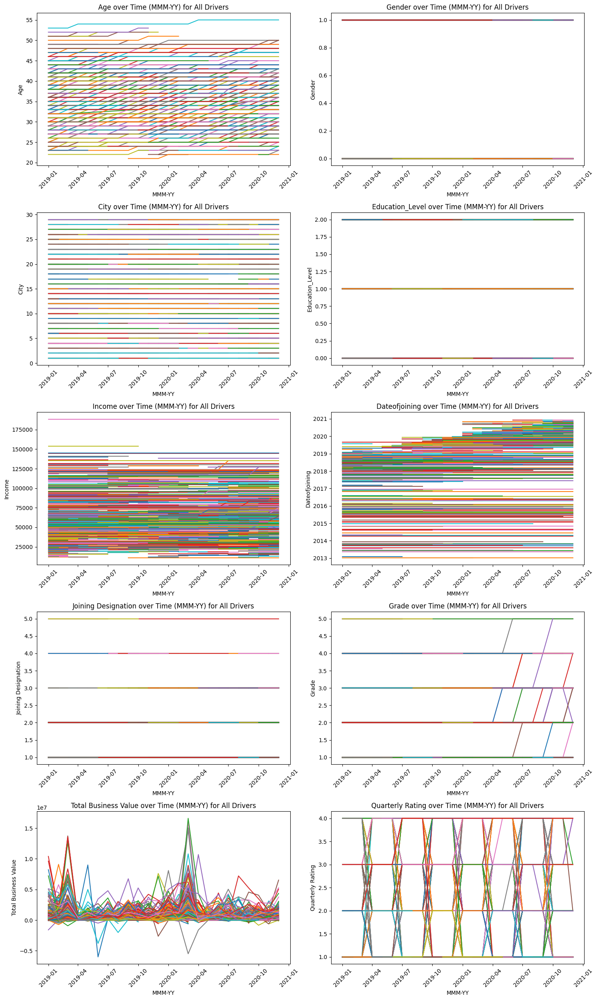

In [ ]:
features = ["Age","Gender","City","Education_Level","Income","Dateofjoining",
            "Joining Designation","Grade","Total Business Value", "Quarterly Rating"] # Selecting features that can be feature engineered
plt.figure(figsize=(15,25))
k = 1
# Create line plots for each feature
sampled_driver_ids = np.random.choice(ola_1['Driver_ID'].unique(), size=1000, replace=False)
for feature in features:
    plt.subplot(5,2,k)
    k += 1

    # Loop through each driver and plot their data
    for driver_id in sampled_driver_ids:
        driver_data = ola_1[ola_1['Driver_ID'] == driver_id]
        plt.plot(driver_data['MMM-YY'], driver_data[feature], label=f'Driver {driver_id}')

    # Set plot title and labels
    plt.title(f'{feature} over Time (MMM-YY) for All Drivers')
    plt.xlabel('MMM-YY')
    plt.ylabel(feature)
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

**Observation**
> Constant Features are (Gender, City, Education_Level, Joining Designation, Dateofjoining)

> monotonically increasing Feature are (Age, Income, Grade)

> Fluctuating Features are (Total Business Value, Quarterly Rating)

> For Constant features, No need to do any feature engineering, Just take first or last value while aggregating

> Among monotonically increasing features, Age should be aggregated with last value or max value only. And can create features like Income_raise and Grade_raise (0 indicates constant, 1 indicates raise)

> For Fluctuating Features, We need to capture mean, sum, std, range, increase/Decrease

> For Income Feature also, We can calculate range. (No need to calculate mean, std because it is mostly constant, only increasing at one or two points)

### Create `income_raise` Feature using increase/decrease/equal in Income

In [ ]:
incm1 =  (ola_1.groupby('Driver_ID').agg({'Income':'first'})['Income']).reset_index()
incm2 = (ola_1.groupby('Driver_ID').agg({'Income':'last'})['Income']).reset_index()

In [ ]:
ola_2.head()

,Driver_ID,Target
0,1,1
1,2,0
2,4,1
3,5,1
4,6,0


In [ ]:
ola_2 = ola_2.merge(incm1,on='Driver_ID')
ola_2 = ola_2.merge(incm2,on='Driver_ID')

In [ ]:
ola_2.head()

,Driver_ID,Target,Income_x,Income_y
0,1,1,57387,57387
1,2,0,67016,67016
2,4,1,65603,65603
3,5,1,46368,46368
4,6,0,78728,78728


In [ ]:
def income_raise(row):
    if row["Income_x"] == row["Income_y"]:
        return 0
    elif row["Income_x"] < row["Income_y"]:
        return 1
    else:
        return -1

ola_2['Income_raise'] = ola_2.apply(income_raise,axis = 1)

In [ ]:
ola_2.head()

,Driver_ID,Target,Income_x,Income_y,Income_raise
0,1,1,57387,57387,0
1,2,0,67016,67016,0
2,4,1,65603,65603,0
3,5,1,46368,46368,0
4,6,0,78728,78728,0


In [ ]:
ola_2["Income_raise"].unique()

array([0, 1], dtype=int64)

**Observation**
> 0 indicates income has not increased or not decreased

>-1 indicates income has decreased. But No one has decrease in income

> 1 was not present --> indicates that for any driver, income was never raised in these 24 month period

### Create `Grade_raise` Feature using increase/decrease/equal in Grade

In [ ]:
GD1 =  (ola_1.groupby('Driver_ID').agg({'Grade':'first'})['Grade']).reset_index()
GD2 = (ola_1.groupby('Driver_ID').agg({'Grade':'last'})['Grade']).reset_index()

ola_2 = ola_2.merge(GD1,on='Driver_ID')
ola_2 = ola_2.merge(GD2,on='Driver_ID')

def Grade_raise(row):
    if row["Grade_x"] == row["Grade_y"]:
        return 0
    elif row["Grade_x"] < row["Grade_y"]:
        return 1
    else:
        return -1

ola_2['Grade_raise'] = ola_2.apply(Grade_raise,axis = 1)

ola_2["Grade_raise"].unique()

array([0, 1], dtype=int64)

**Observation**
> 0 indicates grade has not increased or not decreased

>-1 indicates grade has decreased, No one has Decrease in Grade.

> 1 was not present --> indicates that for any driver, grade was never raised in these 24 month period

### Create `TBV_raise` Feature using increase/decrease/equal in Total Business Value

In [ ]:
TBV1 =  (ola_1.groupby('Driver_ID').agg({'Total Business Value':'first'})['Total Business Value']).reset_index()
TBV2 = (ola_1.groupby('Driver_ID').agg({'Total Business Value':'last'})['Total Business Value']).reset_index()

ola_2 = ola_2.merge(TBV1,on='Driver_ID')
ola_2 = ola_2.merge(TBV2,on='Driver_ID')

def TBV_raise(row):
    if row["Total Business Value_x"] == row["Total Business Value_y"]:
        return 0
    elif row["Total Business Value_x"] < row["Total Business Value_y"]:
        return 1
    else:
        return -1

ola_2['TBV_raise'] = ola_2.apply(TBV_raise,axis = 1)

ola_2["TBV_raise"].unique()

array([-1,  0,  1], dtype=int64)

**Observation**
> 0 indicates that Total Business Value was not increase or not decreased

> 1 indicates Increased TBV

> -1 indicates Decreased TBV

### Create `Promotion` Feature using increase/decrease/equal in Quarterly Rating

In [ ]:
QR1 =  (ola_1.groupby('Driver_ID').agg({'Quarterly Rating':'first'})['Quarterly Rating']).reset_index()
QR2 = (ola_1.groupby('Driver_ID').agg({'Quarterly Rating':'last'})['Quarterly Rating']).reset_index()

ola_2 = ola_2.merge(QR1,on='Driver_ID')
ola_2 = ola_2.merge(QR2,on='Driver_ID')

def promotion_demotion(row):
    if row["Quarterly Rating_x"] == row["Quarterly Rating_y"]:
        return 0
    elif row["Quarterly Rating_x"] < row["Quarterly Rating_y"]:
        return 1
    else:
        return -1

ola_2['Rating_Promotion'] = ola_2.apply(promotion_demotion,axis = 1)

ola_2["Rating_Promotion"].unique()

array([ 0,  1, -1], dtype=int64)

**Observation**
> 0 indicates No Promotion or Demotion in Quarterly Rating

> 1 indicates Promotion

> -1 indicates Demotion  

### Grouping all the remaining column using aggregate method

In [ ]:
functions = {
    'MMM-YY': 'count',
    'Driver_ID': 'first',
    'Age': 'max',
    'Gender': 'last',
    'City': 'last',
    'Education_Level': 'last',
    'Income': ['sum', lambda x: x.max() - x.min()],  # Sum and Range (max - min)
    'Dateofjoining': 'first',
    'LastWorkingDate': 'last',
    'Joining Designation': 'last',
    'Grade': 'last',
    'Total Business Value': ['sum', 'mean', 'std', lambda x: x.max() - x.min()],  # Sum, Mean, Std, Range
    'Quarterly Rating': ['last','mean', 'sum', 'std', lambda x: x.max() - x.min()]  # last, Mean, Sum, Std, Range
}

# Applying the aggregation functions
ola_1_aggregated = ola_1.groupby('Driver_ID').aggregate(functions)

In [ ]:
# Renaming the columns for better readability
ola_1_aggregated.columns = [
    'Reportings', 'Driver_ID', 'Age', 'Gender', 'City', 'Education_Level',
    'Income_sum', 'Income_range', 'Dateofjoining', 'LastWorkingDate',
    'Joining Designation', 'Grade', 'TBV_sum', 'TBV_mean', 'TBV_std', 'TBV_range','QuarterlyRating_last',
    'QuarterlyRating_mean', 'QuarterlyRating_sum', 'QuarterlyRating_std', 'QuarterlyRating_range'
]

# Adding 'join_month' and 'join_year' based on 'Dateofjoining'
ola_1_aggregated['Join_month'] = pd.to_datetime(ola_1_aggregated['Dateofjoining']).dt.month
ola_1_aggregated['Join_year'] = pd.DatetimeIndex(ola_1_aggregated['Dateofjoining']).year


**Observation**
> Reportings is obtained by counting the Number of reporting dates in these two years

> join_month and join_year was extracted from DateofJoining. So that we can delete the DateofJoining feature.

> Can calculate Tenure by subtracting Dateofjoining from LastWorkingDate. But as LastWorkingDate is Target feature, It is not good to have Tenure feature

#### Merging ola_1_aggregated and ola_2

In [ ]:
ola_1_aggregated.reset_index(drop=True, inplace=True)

In [ ]:
ola_1 = ola_1_aggregated.merge(ola_2,on='Driver_ID')
ola_1.head()

,Reportings,Driver_ID,Age,Gender,City,Education_Level,Income_sum,Income_range,Dateofjoining,LastWorkingDate,Joining Designation,Grade,TBV_sum,TBV_mean,TBV_std,TBV_range,QuarterlyRating_last,QuarterlyRating_mean,QuarterlyRating_sum,QuarterlyRating_std,QuarterlyRating_range,Join_month,Join_year,Target,Income_x,Income_y,Income_raise,Grade_x,Grade_y,Grade_raise,Total Business Value_x,Total Business Value_y,TBV_raise,Quarterly Rating_x,Quarterly Rating_y,Rating_Promotion
0,3,1,28,0.0,23,2,172161,0,2018-12-24,2019-11-03,1,1,1715580,571860.0,1.601755e+06,3046540,2,2.0,6,0.000000,0,12,2018,1,57387,57387,0,1,1,0,2381060,0,-1,2,2,0
1,2,2,31,0.0,7,2,134032,0,2020-06-11,NaT,2,2,0,0.0,0.000000e+00,0,1,1.0,2,0.000000,0,6,2020,0,67016,67016,0,2,2,0,0,0,0,1,1,0
2,5,4,43,0.0,13,2,328015,0,2019-07-12,2020-04-27,2,2,350000,70000.0,1.565248e+05,350000,1,1.0,5,0.000000,0,7,2019,1,65603,65603,0,2,2,0,0,0,0,1,1,0
3,3,5,29,0.0,9,0,139104,0,2019-09-01,2019-07-03,1,1,120360,40120.0,6.948988e+04,120360,1,1.0,3,0.000000,0,9,2019,1,46368,46368,0,1,1,0,0,0,0,1,1,0
4,5,6,31,1.0,11,1,393640,0,2020-07-31,NaT,3,3,1265000,253000.0,5.657252e+05,1265000,2,1.6,8,0.547723,1,7,2020,0,78728,78728,0,3,3,0,0,0,0,1,2,1


### Droping the unwanted features

In [ ]:
ola_1.isna().sum()

Reportings                  0
Driver_ID                   0
Age                         0
Gender                      0
City                        0
Education_Level             0
Income_sum                  0
Income_range                0
Dateofjoining               0
LastWorkingDate           765
Joining Designation         0
Grade                       0
TBV_sum                     0
TBV_mean                    0
TBV_std                   181
TBV_range                   0
QuarterlyRating_last        0
QuarterlyRating_mean        0
QuarterlyRating_sum         0
QuarterlyRating_std       181
QuarterlyRating_range       0
Join_month                  0
Join_year                   0
Target                      0
Income_x                    0
Income_y                    0
Income_raise                0
Grade_x                     0
Grade_y                     0
Grade_raise                 0
Total Business Value_x      0
Total Business Value_y      0
TBV_raise                   0
Quarterly 

In [ ]:
np.sum(ola_1[(ola_1["QuarterlyRating_std"].isna()) | (ola_1["TBV_std"].isna())]["Reportings"] != 1)

0

**Observation**
> So if the number of reportings are equal to 1, Std is showing as null values, So Those std can make as zeros

> Out of 2381 Drivers, 765 Drivers are having null Last working date, means they are still not churned off.

In [ ]:
ola_1['TBV_std'].fillna(0, inplace=True)
ola_1['QuarterlyRating_std'].fillna(0, inplace=True)

C:\Users\saina\AppData\Local\Temp\ipykernel_11784\3652393424.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  ola_1['TBV_std'].fillna(0, inplace=True)
C:\Users\saina\AppData\Local\Temp\ipykernel_11784\3652393424.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, wh

In [ ]:
ola_1.drop(columns=['Driver_ID','Dateofjoining','LastWorkingDate','Income_x','Income_y',
                    'Grade_x','Grade_y','Total Business Value_x','Total Business Value_y',
                    'Quarterly Rating_x','Quarterly Rating_y'],axis=1,inplace=True)
ola_1['Gender'] = ola_1['Gender'].astype('int64')

**Observation**
> Driver_ID is primary key. Not advisable to use in model building

> Date of joining is seperated as join_month and join_year. So we can delete this date feature

> LastWorkingDate has many null values. It was converted as Target. So We should delete this feature. It is not advisable to create Tenure feature also.

> Remaining features in above columns list are unwanted features which are created during feature engineering.    

In [ ]:
ola_1.head()

,Reportings,Age,Gender,City,Education_Level,Income_sum,Income_range,Joining Designation,Grade,TBV_sum,TBV_mean,TBV_std,TBV_range,QuarterlyRating_last,QuarterlyRating_mean,QuarterlyRating_sum,QuarterlyRating_std,QuarterlyRating_range,Join_month,Join_year,Target,Income_raise,Grade_raise,TBV_raise,Rating_Promotion
0,3,28,0,23,2,172161,0,1,1,1715580,571860.0,1.601755e+06,3046540,2,2.0,6,0.000000,0,12,2018,1,0,0,-1,0
1,2,31,0,7,2,134032,0,2,2,0,0.0,0.000000e+00,0,1,1.0,2,0.000000,0,6,2020,0,0,0,0,0
2,5,43,0,13,2,328015,0,2,2,350000,70000.0,1.565248e+05,350000,1,1.0,5,0.000000,0,7,2019,1,0,0,0,0
3,3,29,0,9,0,139104,0,1,1,120360,40120.0,6.948988e+04,120360,1,1.0,3,0.000000,0,9,2019,1,0,0,0,0
4,5,31,1,11,1,393640,0,3,3,1265000,253000.0,5.657252e+05,1265000,2,1.6,8,0.547723,1,7,2020,0,0,0,0,1


#### Changing the order of columns, Taking Target Feature to End, DriverID to Start

In [ ]:
ola = ola_1[['Age', 'City','Education_Level', 'Gender', 'Grade', 'Grade_raise', 'Income_raise', 'Income_range',
             'Income_sum','Join_month','Join_year','Joining Designation','QuarterlyRating_last', 'QuarterlyRating_mean',
             'QuarterlyRating_range', 'QuarterlyRating_std','QuarterlyRating_sum', 'Rating_Promotion', 'Reportings',
             'TBV_mean', 'TBV_raise', 'TBV_range', 'TBV_std','TBV_sum','Target']]

## STATISTICAL SUMMARY OF MODIFIED DATASET

In [ ]:
sum(ola.isna().sum())

0

In [ ]:
ola.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,2381.0,3.366317e+01,5.983375e+00,2.100000e+01,29.0,33.000000,3.700000e+01,5.800000e+01
City,2381.0,1.533557e+01,8.371843e+00,1.000000e+00,8.0,15.000000,2.200000e+01,2.900000e+01
Education_Level,2381.0,1.007560e+00,8.162900e-01,0.000000e+00,0.0,1.000000,2.000000e+00,2.000000e+00
Gender,2381.0,4.103318e-01,4.919972e-01,0.000000e+00,0.0,0.000000,1.000000e+00,1.000000e+00
Grade,2381.0,2.096598e+00,9.415218e-01,1.000000e+00,1.0,2.000000,3.000000e+00,5.000000e+00
Grade_raise,2381.0,1.805964e-02,1.331951e-01,0.000000e+00,0.0,0.000000,0.000000e+00,1.000000e+00
Income_raise,2381.0,1.805964e-02,1.331951e-01,0.000000e+00,0.0,0.000000,0.000000e+00,1.000000e+00
Income_range,2381.0,1.270987e+02,9.731710e+02,0.000000e+00,0.0,0.000000,0.000000e+00,1.215500e+04
Income_sum,2381.0,5.267603e+05,6.231633e+05,1.088300e+04,139895.0,292980.000000,6.514560e+05,4.522032e+06
Join_month,2381.0,6.958001e+00,3.221762e+00,1.000000e+00,5.0,7.000000,1.000000e+01,1.200000e+01


**Observation**
> The dataset is reduced or aggregate to Driver level and there are no null values in the dataset

> By observing min and max values of numerical columns - Income and Business Value will have significant outliers.

> Reportings are count of occurrences. So it can be treated as numerical column.   

# CHAPTER 3: DATA VISUALIZATION

## UNIVARIATE ANALYSIS

In [ ]:
cont_cols = ['Age', 'Income_range','Income_sum', 'QuarterlyRating_mean', 'QuarterlyRating_range', 'QuarterlyRating_std',
              'QuarterlyRating_sum', 'Reportings', 'TBV_mean','TBV_range', 'TBV_std','TBV_sum']

cat_cols = ['City','Education_Level', 'Gender', 'Grade', 'Grade_raise', 'Income_raise','Join_month','Join_year',
             'Joining Designation','QuarterlyRating_last','Rating_Promotion','TBV_raise','Target']

**Observation**
> Driver_ID is primary Key so not included in Categorical Cols

### Distribution plots of all Numerical Columns

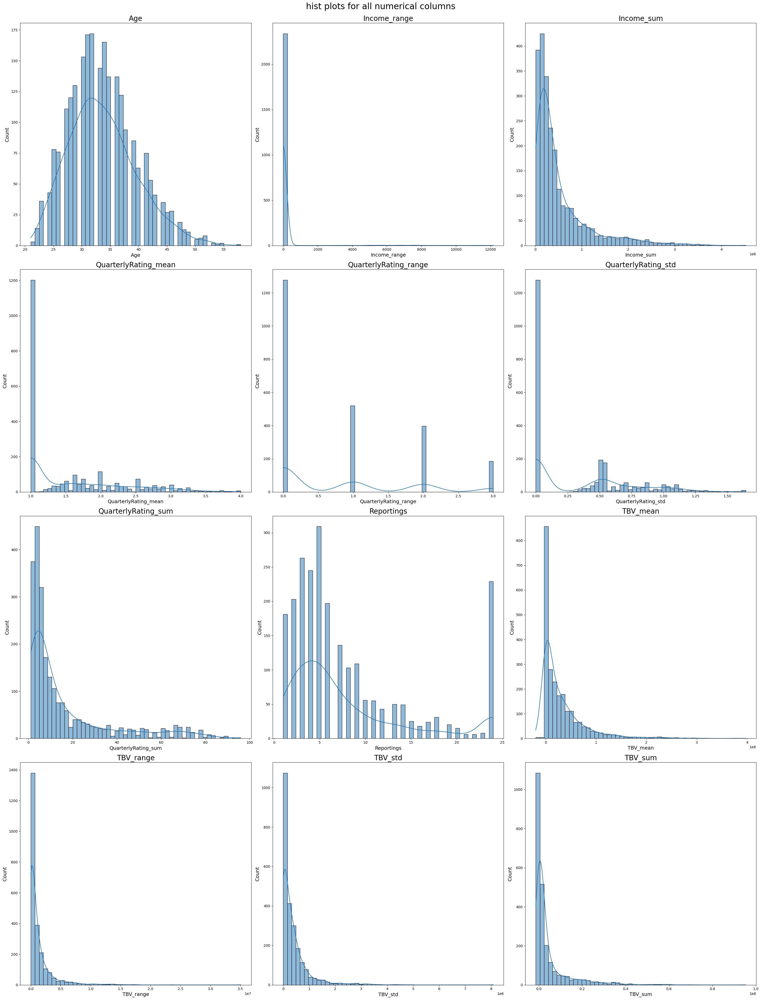

In [ ]:
fig = plt.figure(figsize = (3*10,len(cont_cols)*10/3))
plt.suptitle("hist plots for all numerical columns\n",fontsize=24)
k = 1
for i in cont_cols:
    plt.subplot(math.ceil(len(cont_cols)/3),3,k)
    plt.title("{}".format(i),fontsize = 20)
    k += 1
    plot = sns.histplot(data=ola,x = i,kde = True,bins = 50)

    # Increase label and legend font sizes
    plot.set_xlabel(plot.get_xlabel(), fontsize=14)
    plot.set_ylabel(plot.get_ylabel(), fontsize=14)

    warnings.filterwarnings('ignore')
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()
warnings.filterwarnings('ignore')

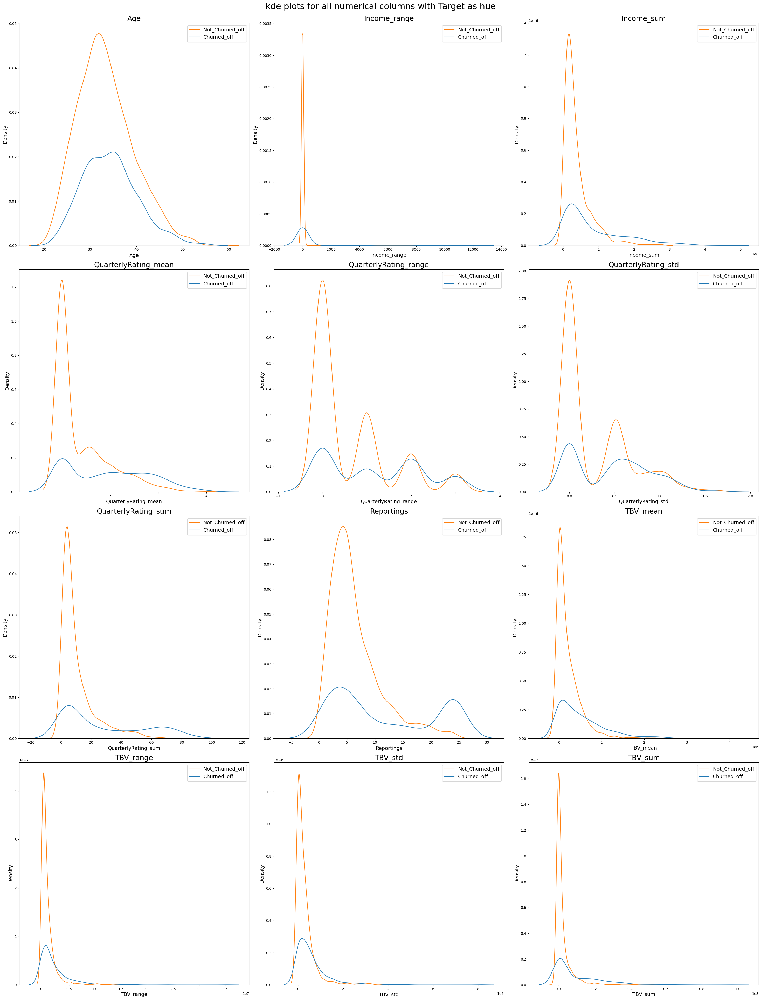

In [ ]:
fig = plt.figure(figsize = (3*10,len(cont_cols)*10/3))
plt.suptitle("kde plots for all numerical columns with Target as hue\n",fontsize=24)
k = 1
for i in cont_cols:
    plt.subplot(math.ceil(len(cont_cols)/3),3,k)
    plt.title("{}".format(i),fontsize = 20)
    k += 1
    plot = sns.kdeplot(data=ola,x = i,hue = "Target")

    # Increase label and legend font sizes
    plot.set_xlabel(plot.get_xlabel(), fontsize=14)
    plot.set_ylabel(plot.get_ylabel(), fontsize=14)
    plt.legend(plot.get_legend_handles_labels,labels = ["Not_Churned_off","Churned_off"],fontsize = 14, title_fontsize = 16)

    warnings.filterwarnings('ignore')
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> Income and TBV was left Skewed, These features may have outliers.

> Age in range of 25 to 40 are significant

> Reportings range from 1 to 24. Indicating 24 months data. Distribution is concentrated in the range of 1-9. Indicating many drivers are leaving in first 9 months itself.

> On observing kde plot shows that there is imbalanced distribution between Churn and not churn drivers.

> kde plot of reportings, We can observe that there is unusual spike at 24 because of not churned drivers only.

> kde plot of not churned drivers clearly dominates the churned off drivers.

### Box plots of all Numerical columns

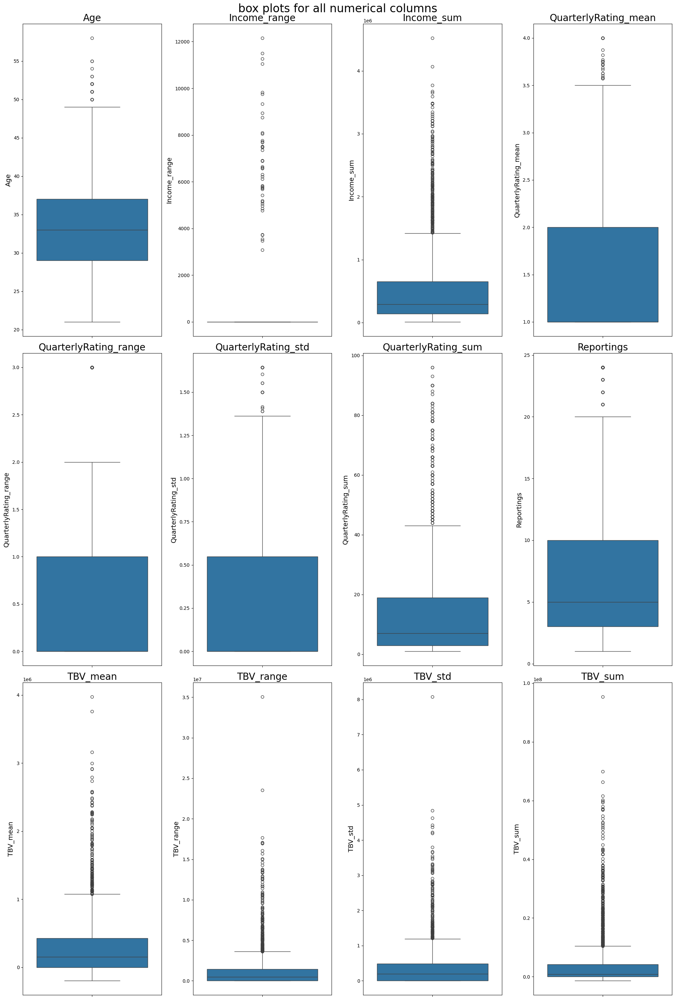

In [ ]:
fig = plt.figure(figsize = (4*5,len(cont_cols)*5/(4/2)))
plt.suptitle("box plots for all numerical columns\n",fontsize=24)
k = 1
for i in cont_cols:
    plt.subplot(math.ceil(len(cont_cols)/4),4,k)
    plt.title("{}".format(i),fontsize = 20)
    k += 1
    plot = sns.boxplot(data=ola,y = i)

    # Increase label and legend font sizes
    plot.set_xlabel(plot.get_xlabel(), fontsize=14)
    plot.set_ylabel(plot.get_ylabel(), fontsize=14)

    warnings.filterwarnings('ignore')
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> May be because of lot of zeros in the distribution, Box plots are showing lot of outliers

> Lets remove the zeros and plot them again

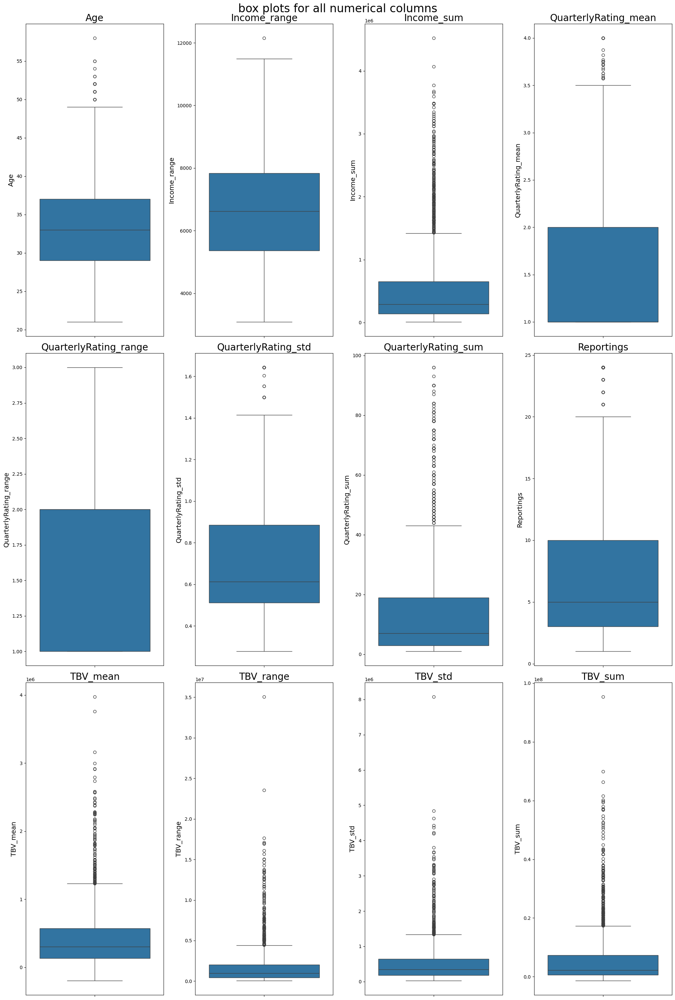

In [ ]:
fig = plt.figure(figsize = (4*5,len(cont_cols)*5/(4/2)))
plt.suptitle("box plots for all numerical columns\n",fontsize=24)
k = 1
for i in cont_cols:
    plt.subplot(math.ceil(len(cont_cols)/4),4,k)
    plt.title("{}".format(i),fontsize = 20)
    k += 1
    plot = sns.boxplot(data=ola[ola[i] != 0],y = i)

    # Increase label and legend font sizes
    plot.set_xlabel(plot.get_xlabel(), fontsize=14)
    plot.set_ylabel(plot.get_ylabel(), fontsize=14)

    warnings.filterwarnings('ignore')
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> Clearly we can identify There are many outliers with large range in TBV and Income. Those should be handled by transformations because we have very small dataset.

### Count plots of all categorical columns

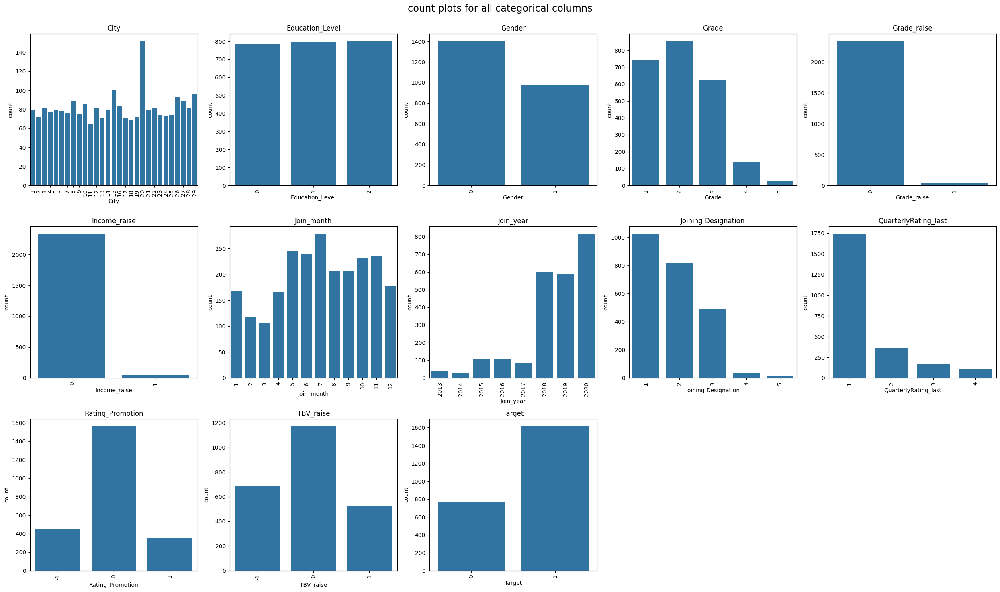

In [ ]:
fig = plt.figure(figsize=(25,15))
fig.suptitle("count plots for all categorical columns\n",fontsize = "xx-large" )
k = 1
for i in cat_cols:
    plt.subplot(3,5,k)
    plt.title("{}".format(i))
    sns.countplot(data=ola,x = i)
    plt.xticks(rotation = 90)
    k = k+1
plt.tight_layout()
plt.show()

**Observation**
> Male --> 0, Female --> 1, Male Drivers > Female Drivers

> Education level is uniformly distributed among 10+, 12+, Graduate

> Joining Designation is lower for most of the drivers. JD count is decreasing with increase in JD value

> Grade 2 > Grade 1 Drivers. Grade 4 and Grade 5 are very less.

> Quarterly rating is 1 for most of the drivers

> In july month, most of the drivers has joined in ola

> In data, Joining year ranges from 2013 to 2020. Most of the members are new Drivers. This indicates, Old Drivers are churning mostly.

> Rating promotion was rarely increased or decreased

> Income is constant for most of the drivers. Income was never increased in these 24 months. But decreased for few.

> Grade is constant for most of the drivers. Grade was never increased in these 24 months. But decreased for few.

> Total Business Value is constant for approx 50% drivers, 25% decrease, 25% increase

> City 20 has more number of drivers

> Target feature is imbalanced. 1 indicates churn, 0 indicate no churn. 1 dominates 0   

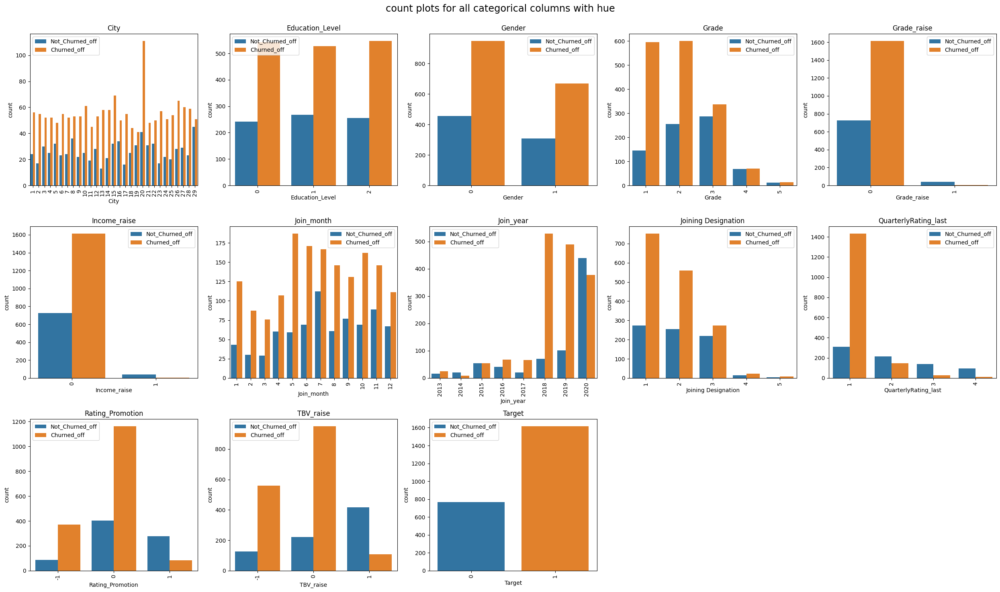

In [ ]:
fig = plt.figure(figsize=(25,15))
fig.suptitle("count plots for all categorical columns with hue\n",fontsize = "xx-large" )
k = 1
for i in cat_cols:
    plt.subplot(3,5,k)
    plt.title("{}".format(i))
    sns.countplot(data=ola,x = i, hue = "Target")
    plt.legend(plot.get_legend_handles_labels,labels = ["Not_Churned_off","Churned_off"])
    plt.xticks(rotation = 90)
    k = k+1
plt.tight_layout()
plt.show()

**Observation**
> Positive Rating Promotion and TBV Raise is significantly low for Churned off Drivers.

## BIVARIATE ANALYSIS OF IMPORTANT FEATURES

### Categorical Vs Categorical

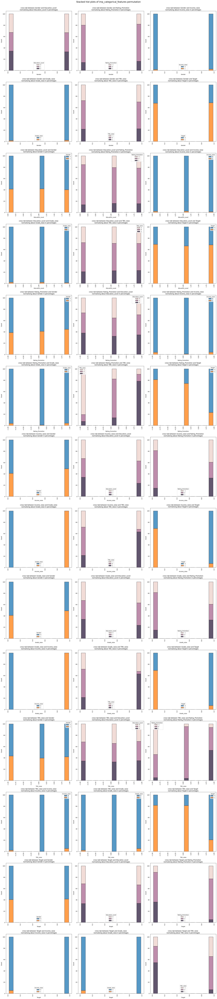

In [ ]:
imp_cat_features = ['Gender','Education_Level','Rating_Promotion','Income_raise', 'Grade_raise', 'TBV_raise',"Target"]
cat_perm = list(permutations(imp_cat_features,2))
fig = plt.figure(figsize = (3*8,len(cat_perm)*8/3))
plt.suptitle("Stacked hist plots of imp_categorical_features permutation\n",fontsize="xx-large")
k = 1
for p,q in cat_perm:
    if (ola[p].nunique()<50) and (ola[q].nunique()<50):
        plt.subplot(math.ceil(len(cat_perm)/3),3,k)
        plt.title(f"cross tab between {p} and {q} \nnormalising about {q} in percentages")
        k += 1
        plot = ola.groupby([p])[q].value_counts(normalize=True).mul(100).reset_index(name='percentage')
        sns.histplot(x = p , hue = q, weights= 'percentage', multiple = 'stack',data=plot,shrink = 0.7)
        plt.xticks(rotation = 90)
        warnings.filterwarnings('ignore')
plt.tight_layout()
plt.subplots_adjust(top=0.97)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> Gender and Education Level has no effect on raises

> if Rating is promoted , There is high chance he/she may raise TBV. Viceversa is also True

> if income decreases, Rating may decrease or increase. TBV may Decrease.

> High correlation between Grade raise and income raise. If income decreases, Grade definitely decreases. and vice versa.

> When TBV raises or rating promotion increases, Churn off also raises

### Numerical Vs Categorical

In [ ]:
imp_cat_features = ['Rating_Promotion','Income_raise', 'Grade_raise', 'TBV_raise']  # Gender and Education Level was removed because of no effect
imp_cont_features = ['Age', 'Income_sum','Reportings', 'TBV_sum']
Cat_Vs_cont = []
for i in range(len(imp_cat_features)):
    for j in range(len(imp_cont_features)):
        if (ola[imp_cat_features[i]].nunique()<50):
            Cat_Vs_cont.append((imp_cat_features[i], imp_cont_features[j]))
print(Cat_Vs_cont)
print(len(Cat_Vs_cont))

[('Rating_Promotion', 'Age'), ('Rating_Promotion', 'Income_sum'), ('Rating_Promotion', 'Reportings'), ('Rating_Promotion', 'TBV_sum'), ('Income_raise', 'Age'), ('Income_raise', 'Income_sum'), ('Income_raise', 'Reportings'), ('Income_raise', 'TBV_sum'), ('Grade_raise', 'Age'), ('Grade_raise', 'Income_sum'), ('Grade_raise', 'Reportings'), ('Grade_raise', 'TBV_sum'), ('TBV_raise', 'Age'), ('TBV_raise', 'Income_sum'), ('TBV_raise', 'Reportings'), ('TBV_raise', 'TBV_sum')]
16


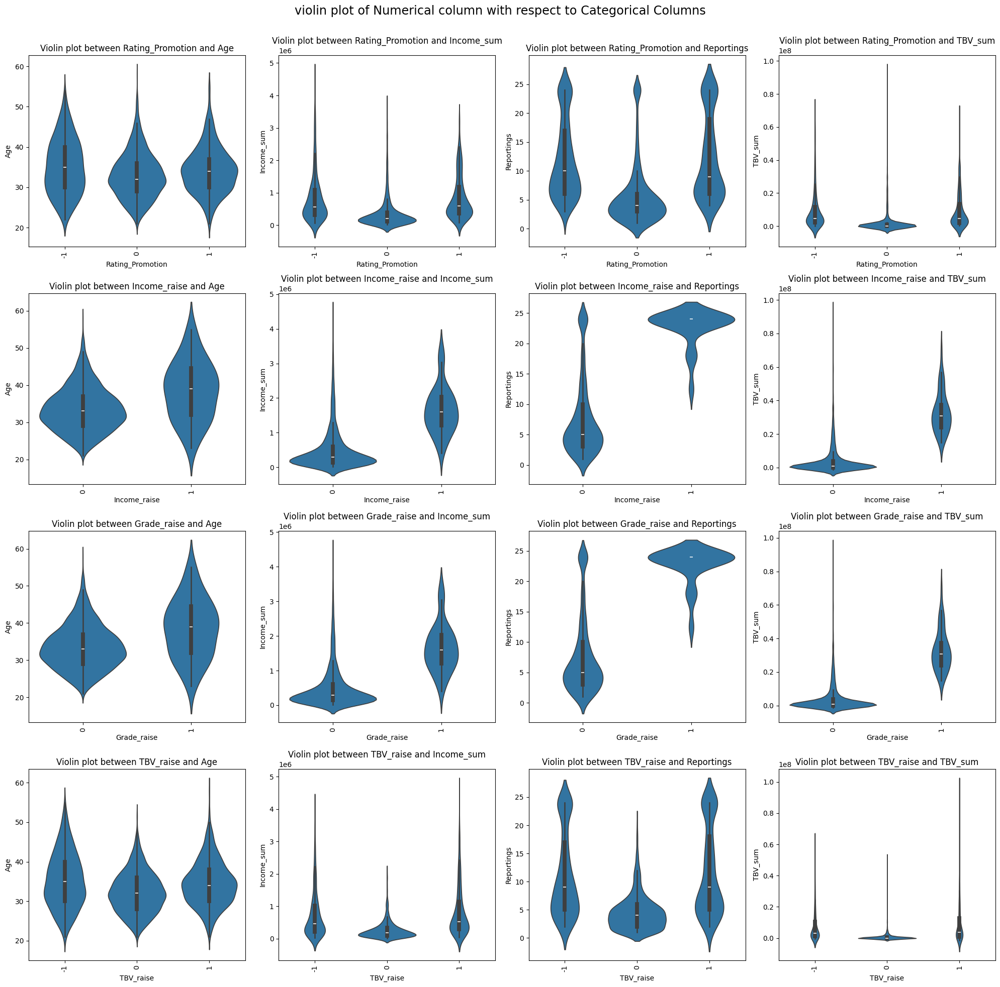

In [ ]:
fig = plt.figure(figsize = (4*5,len(Cat_Vs_cont)*5/4))
plt.suptitle("violin plot of Numerical column with respect to Categorical Columns",fontsize = "xx-large")
k = 1
for p,q in Cat_Vs_cont:
    plt.subplot(math.ceil(len(Cat_Vs_cont)/5),4,k)
    plt.title(f"Violin plot between {p} and {q}")
    k +=1
    sns.violinplot(data = ola,x = p,y= q)
    plt.xticks(rotation = 90)
plt.tight_layout()
plt.subplots_adjust(top=0.93)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> Age was well distributed in all plots

> We already know that income raise, TBV Raise and Grade raise are correlated.

> Number of reportings are significantly higher if income was decreased or Grade was decreased   

In [ ]:
imp_cat_features = ["Gender","Education_Level","Joining Designation","Grade","QuarterlyRating_last","Join_month","Join_year"]
imp_cont_features = ['Age', 'Income_sum','Reportings', 'TBV_sum']
Cat_Vs_cont = []
for i in range(len(imp_cat_features)):
    for j in range(len(imp_cont_features)):
        if (ola[imp_cat_features[i]].nunique()<50):
            Cat_Vs_cont.append((imp_cat_features[i], imp_cont_features[j]))
print(Cat_Vs_cont)
print(len(Cat_Vs_cont))

[('Gender', 'Age'), ('Gender', 'Income_sum'), ('Gender', 'Reportings'), ('Gender', 'TBV_sum'), ('Education_Level', 'Age'), ('Education_Level', 'Income_sum'), ('Education_Level', 'Reportings'), ('Education_Level', 'TBV_sum'), ('Joining Designation', 'Age'), ('Joining Designation', 'Income_sum'), ('Joining Designation', 'Reportings'), ('Joining Designation', 'TBV_sum'), ('Grade', 'Age'), ('Grade', 'Income_sum'), ('Grade', 'Reportings'), ('Grade', 'TBV_sum'), ('QuarterlyRating_last', 'Age'), ('QuarterlyRating_last', 'Income_sum'), ('QuarterlyRating_last', 'Reportings'), ('QuarterlyRating_last', 'TBV_sum'), ('Join_month', 'Age'), ('Join_month', 'Income_sum'), ('Join_month', 'Reportings'), ('Join_month', 'TBV_sum'), ('Join_year', 'Age'), ('Join_year', 'Income_sum'), ('Join_year', 'Reportings'), ('Join_year', 'TBV_sum')]
28


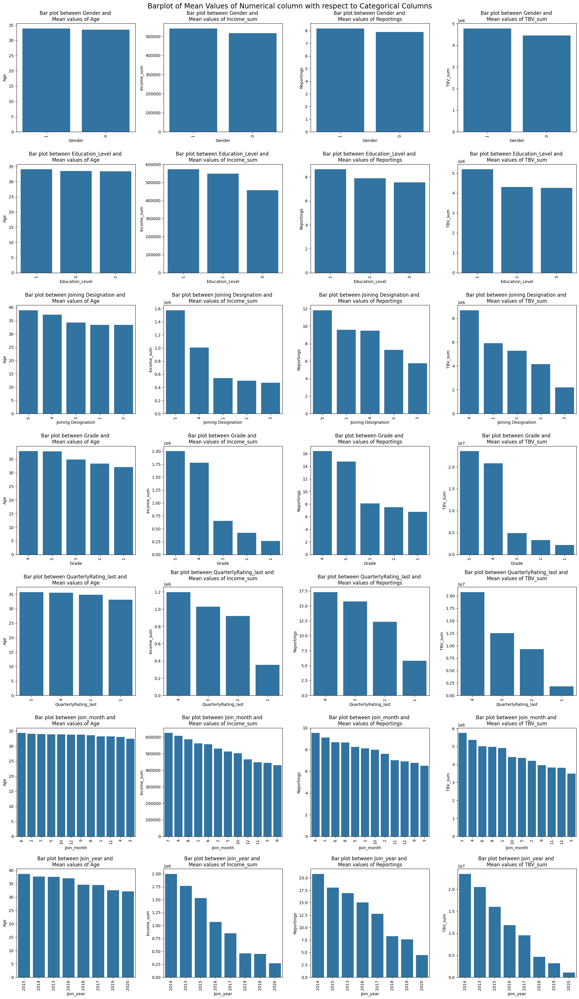

In [ ]:
fig = plt.figure(figsize = (4*5,len(Cat_Vs_cont)*5/4))
plt.suptitle("Barplot of Mean Values of Numerical column with respect to Categorical Columns\n",fontsize = "xx-large")
k = 1
for p,q in Cat_Vs_cont:
    plt.subplot(math.ceil(len(Cat_Vs_cont)/4),4,k)
    plt.title(f"Bar plot between {p} and \nMean values of {q}")
    k += 1
    df = pd.DataFrame(ola.groupby([p])[[q]].mean().reset_index())
    sns.barplot(data = df,x = p,y= q,order = df.sort_values(q,ascending = False)[p])
    plt.xticks(rotation = 90)
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> Income for Joining Designation 5 and 4 significantly higher than remaining Joining Designations

> Income and Quarterly Rating directly correlated

> Income is higher for old employees (2013 to 2015)

> TBV is directly related to join year, quarterly rating,

> TBV of jD = 4 is higher

> Reportings are higher for older employees

## MULTI-VARIATE ANALYSIS OF IMPORTANT FEATURES

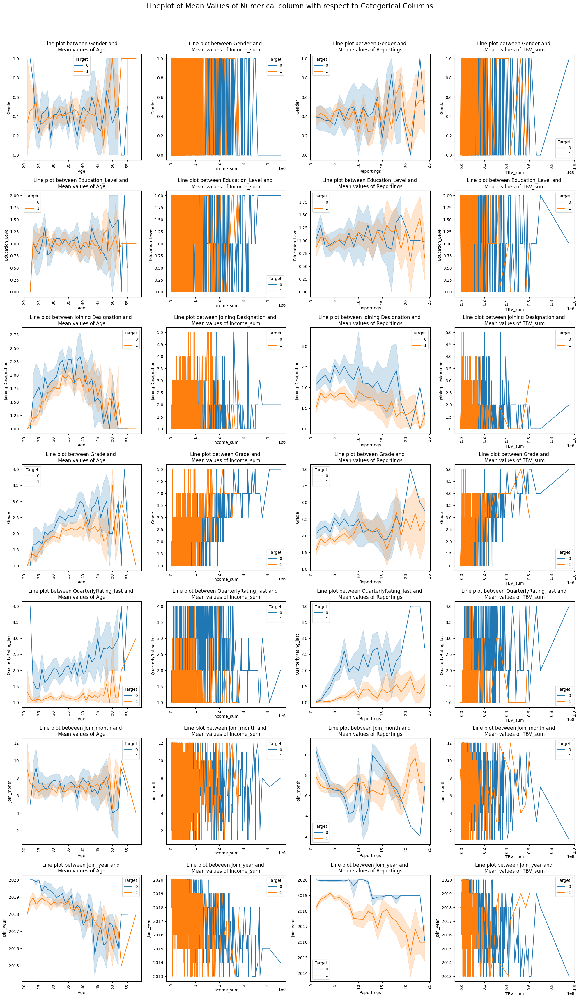

In [ ]:
fig = plt.figure(figsize = (4*5,len(Cat_Vs_cont)*5/4))
plt.suptitle("Lineplot of Mean Values of Numerical column with respect to Categorical Columns\n",fontsize = "xx-large")
k = 1
for p,q in Cat_Vs_cont:
    plt.subplot(math.ceil(len(Cat_Vs_cont)/4),4,k)
    plt.title(f"Line plot between {p} and \nMean values of {q}")
    k += 1
    sns.lineplot(data = ola,x=q,y=p,hue = "Target")
    plt.xticks(rotation = 90)
plt.tight_layout()
plt.subplots_adjust(top=0.93)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> Images are showing Aggregated Grade feature with 95 % confidence region.

> Joining Designation, Grade, Quarterly Rating  of Churned off(1) Drivers is Lesser compared to Joining Designation, Grade, Quarterly Rating of not churned off Drivers(0) with respect to their similar age.

### Numerical vs Numerical vs Target

In [ ]:
cont_cols = ['Age', 'Income_sum','Reportings', 'TBV_sum']

In [ ]:
cont_comb = list(combinations(cont_cols,2))

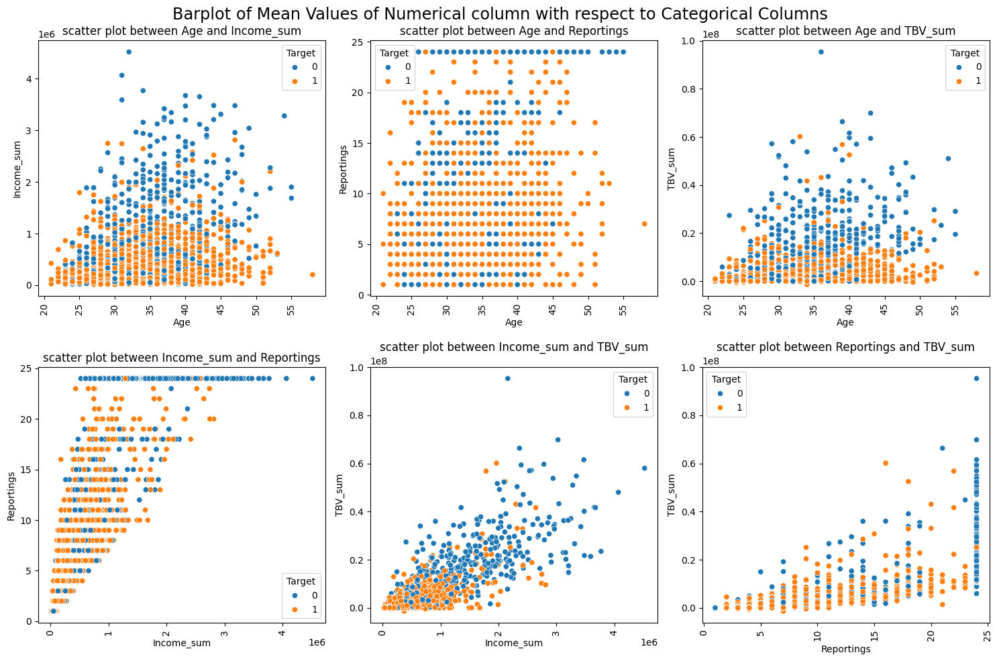

In [ ]:
fig = plt.figure(figsize = (3*5,len(cont_comb)*5/3))
plt.suptitle("Barplot of Mean Values of Numerical column with respect to Categorical Columns\n",fontsize = "xx-large")
k = 1
for p,q in cont_comb:
    plt.subplot(math.ceil(len(cont_comb)/3),3,k)
    plt.title(f"scatter plot between {p} and {q}")
    k += 1
    sns.scatterplot(data = ola,x=p,y=q,hue = "Target")
    plt.xticks(rotation = 90)
plt.tight_layout()
plt.subplots_adjust(top=0.93)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> Blue dots (not churned off Drivers ) are concentrated upper and right wards. This indicates Not churned off dominates the churned off drivers in TBV, Income, Reportings at all Ages.

## HEAT MAPS

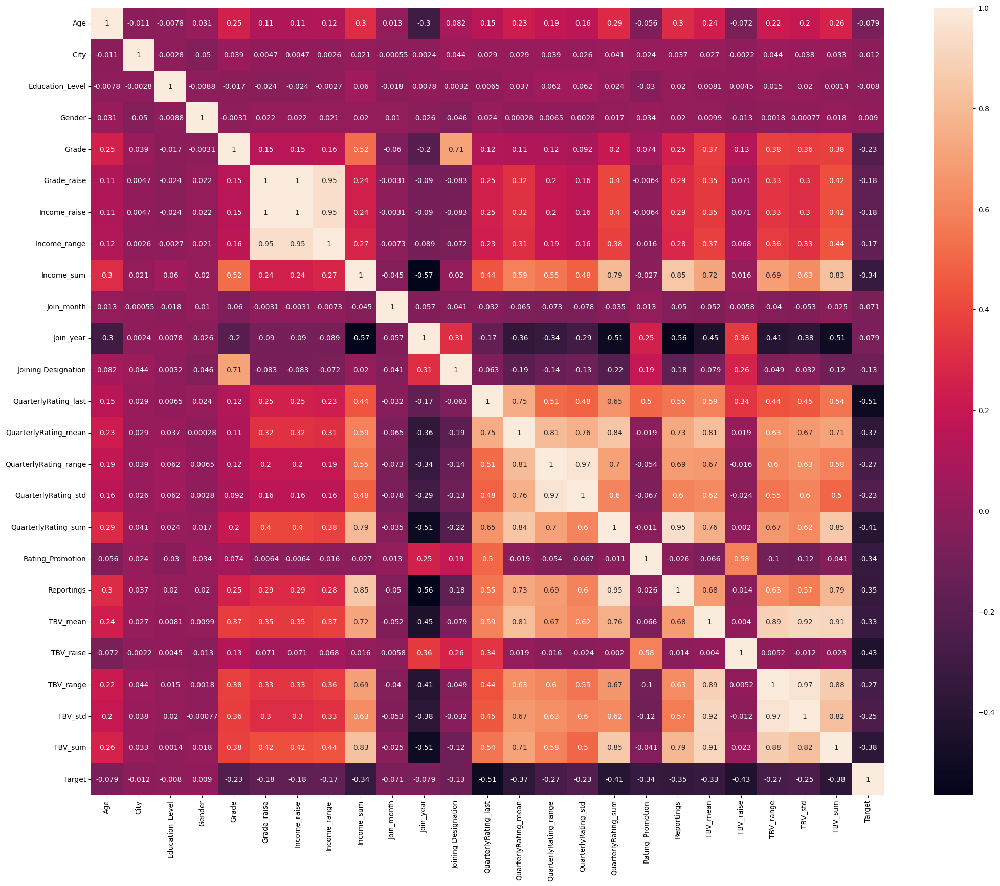

In [ ]:
corr = ola.corr()
plt.figure(figsize=(25,20))
sns.heatmap(corr,annot=True)
plt.show()

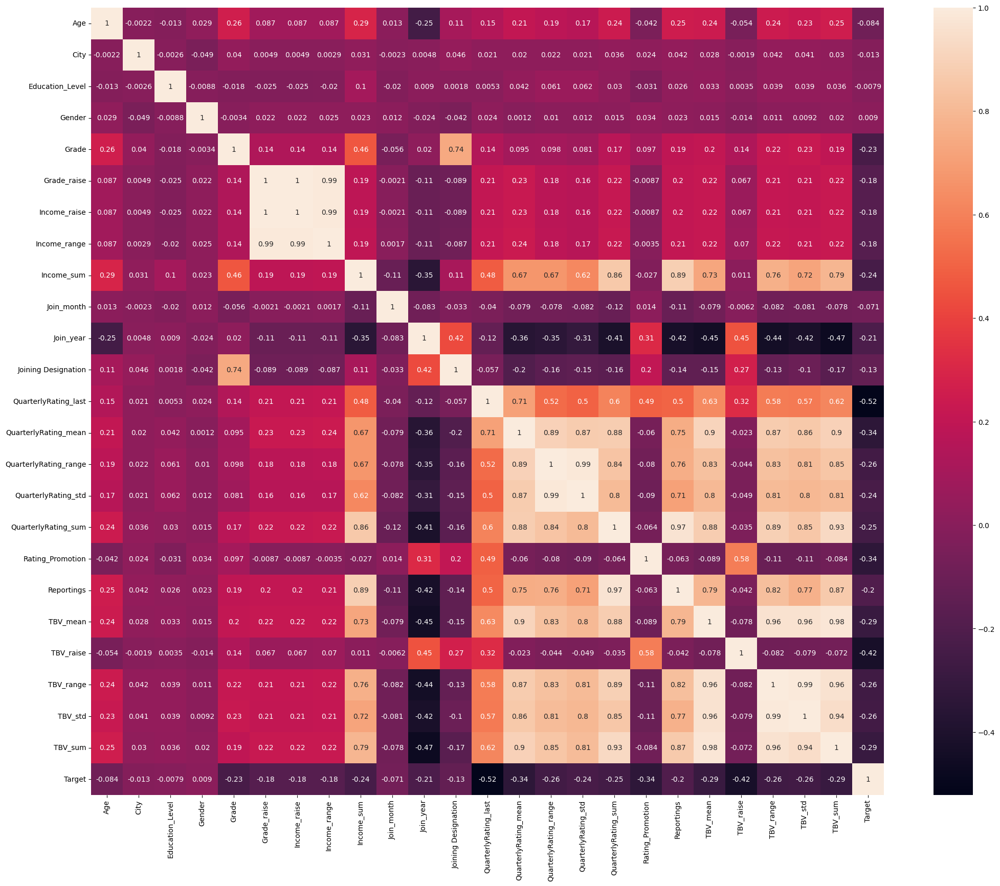

In [ ]:
corr = ola.corr(method= 'spearman')
plt.figure(figsize=(25,20))
sns.heatmap(corr,annot=True)
plt.show()

**Observation**
> High positive correlation pairs are observed between Income, Grade, Quarterly Rating and TBV related pairs

> High negative correlation pairs are observed between Join month , join year with respect to other features

# CHAPTER 4: DATA PREPROCESSING AND BASIC MODEL BUILDING

## OUTLIER TREATMENT AND BOX PLOTS OF NUMERICAL COLUMNS

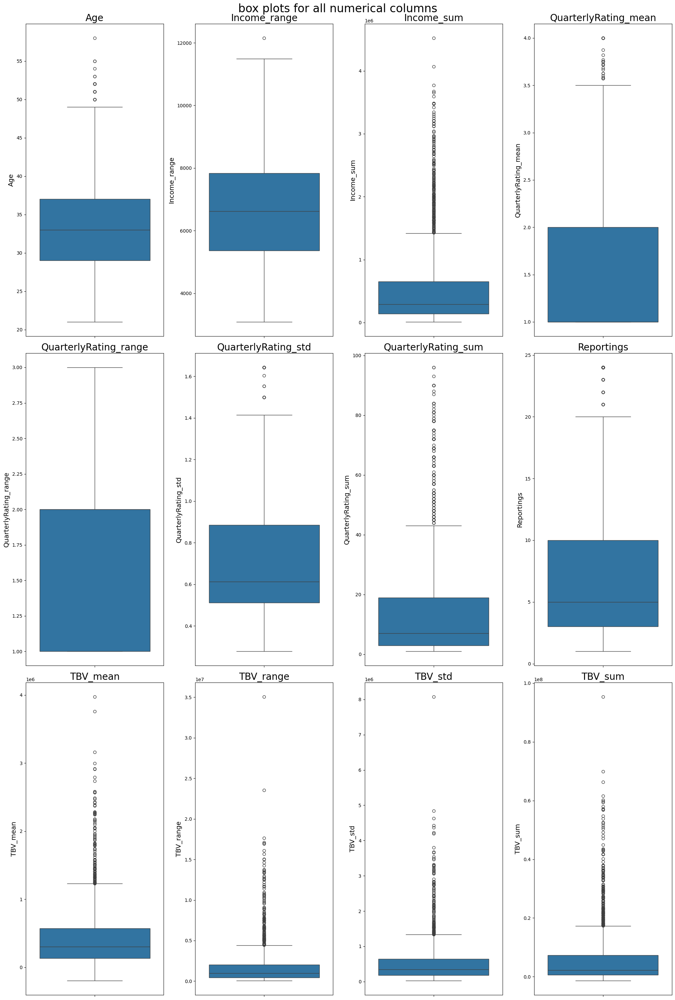

In [ ]:
cont_cols = ['Age', 'Income_range','Income_sum', 'QuarterlyRating_mean', 'QuarterlyRating_range', 'QuarterlyRating_std',
              'QuarterlyRating_sum', 'Reportings', 'TBV_mean','TBV_range', 'TBV_std','TBV_sum']
fig = plt.figure(figsize = (4*5,len(cont_cols)*5/(4/2)))
plt.suptitle("box plots for all numerical columns\n",fontsize=24)
k = 1
for i in cont_cols:
    plt.subplot(math.ceil(len(cont_cols)/4),4,k)
    plt.title("{}".format(i),fontsize = 20)
    k += 1
    plot = sns.boxplot(data=ola[ola[i] != 0],y = i)

    # Increase label and legend font sizes
    plot.set_xlabel(plot.get_xlabel(), fontsize=14)
    plot.set_ylabel(plot.get_ylabel(), fontsize=14)

    warnings.filterwarnings('ignore')
plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.show()
warnings.filterwarnings('ignore')

**Observation**
> Clearly all the numerical columns have some outliers outside the upper whisker. We have small dataset. So we can't remove them

> Age and Reportings are meaningfull outliers. No need to handle them

> Income_sum, QuarterlyRating_sum, TBV_mean, TBV_range,TBV_std,TBV_sum has many outliers

> For features with positive and Negative, It is better to use Yeo Johnson Transformation

> If features has only Positive values, it is better to use simple log transformation.

### Tranformation of Income and TBV to reduce the impact of Outliers

#### Income log Transformation

In [ ]:
outlier_treatment_features = ["Income_sum","QuarterlyRating_sum","TBV_mean","TBV_range","TBV_std","TBV_sum"]

In [ ]:
for i in outlier_treatment_features:
    print(i,ola[i].min())

Income_sum 10883
QuarterlyRating_sum 1
TBV_mean -197932.85714285713
TBV_range 0
TBV_std 0.0
TBV_sum -1385530


**Observation**
> TBV_mean, TBV_sum has positive and Negative Features

In [ ]:
# creating two datasets, one with outliers, another without outliers
ola_no_out = ola.copy(deep=True)

In [ ]:
# Initialize the PowerTransformer with method='yeo-johnson'
pt = PowerTransformer(method='yeo-johnson')

# Fit and transform the TBV column
ola_no_out['TBV_sum_yj'] = pt.fit_transform(ola_no_out[['TBV_sum']])
ola_no_out['TBV_mean_yj'] = pt.fit_transform(ola_no_out[['TBV_mean']])

# If you want to store the lambda value for TBV transformation
tbv_lambda = pt.lambdas_[0]

# To inverse transform later if needed
# ola_no_out['TBV_Original'] = pt.inverse_transform(ola_no_out[['TBV_sum_yj']])

<Axes: ylabel='TBV_sum_yj'>

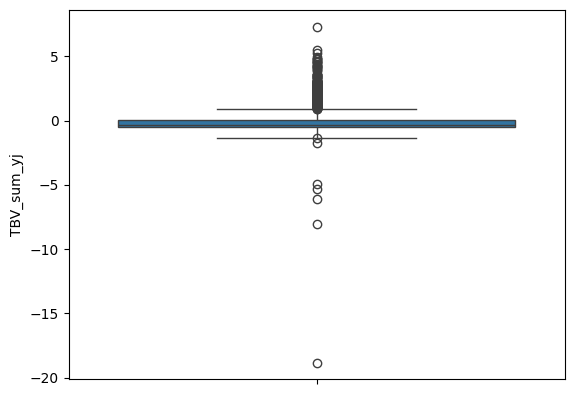

In [ ]:
sns.boxplot(data = ola_no_out,y  = "TBV_sum_yj")

<Axes: ylabel='TBV_mean_yj'>

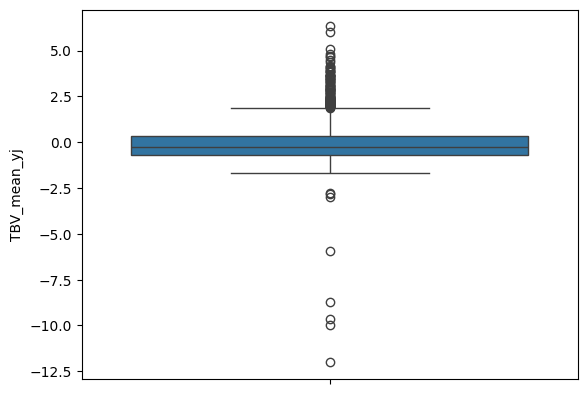

In [ ]:
sns.boxplot(data = ola_no_out,y  = "TBV_mean_yj")

In [ ]:
ola_no_out.drop(["TBV_sum_yj","TBV_mean_yj"], axis = 1, inplace= True)

**Observation**
> Even after applying yeo_johnson method, Outliers are huge.

> So Lets try to seperate the TBV magnitude and sign as two seperate columns and apply log or box cox transformation on magnitude column

> TBV negative indicates that Driver has Significant number of cancellation/refunds/EMI adjustments through out his tenure.

In [ ]:
# Separate positive and negative values
ola_no_out['TBV_sum_positive'] = ola_no_out['TBV_sum'].apply(lambda x: x if x > 0 else 0)
ola_no_out['TBV_sum_negative'] = ola_no_out['TBV_sum'].apply(lambda x: -x if x < 0 else 0)

In [ ]:
ola_no_out['TBV_mean_positive'] = ola_no_out['TBV_mean'].apply(lambda x: x if x > 0 else 0)
ola_no_out['TBV_mean_negative'] = ola_no_out['TBV_mean'].apply(lambda x: -x if x < 0 else 0)

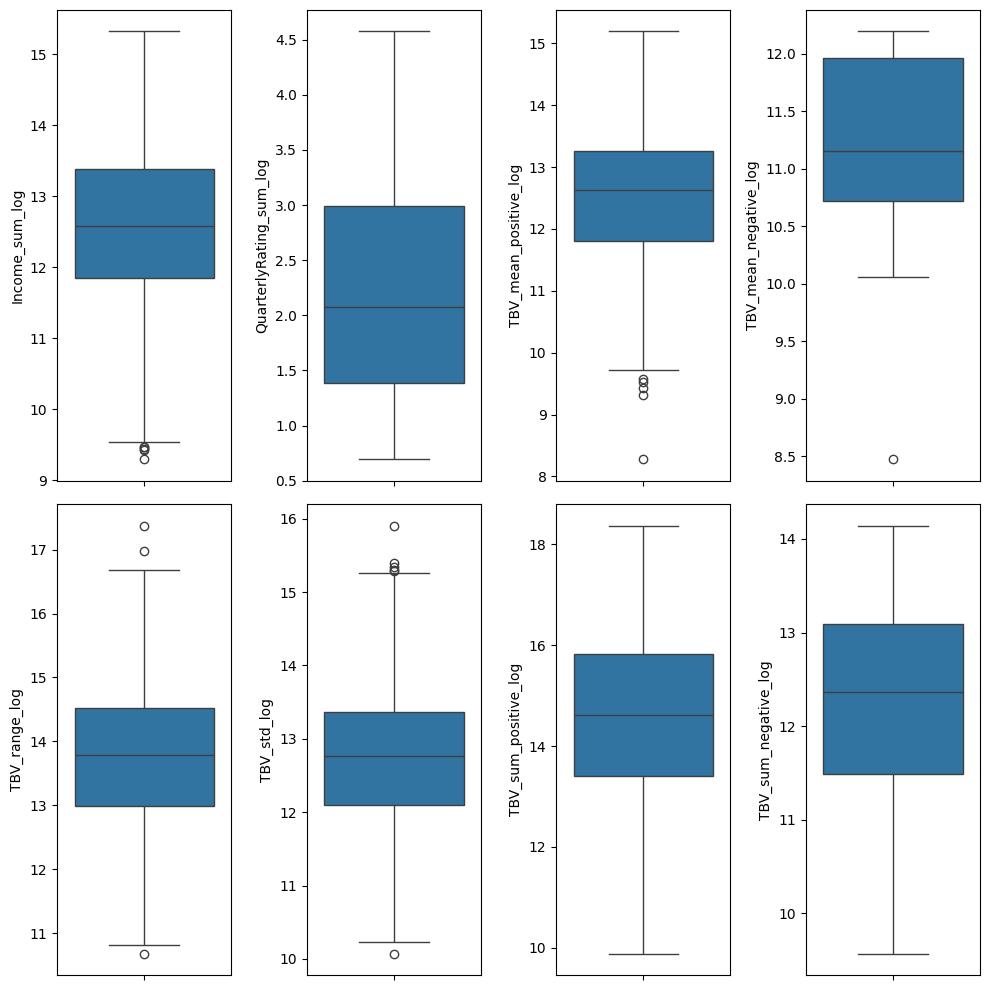

In [ ]:
log_features = ["Income_sum","QuarterlyRating_sum","TBV_mean_positive","TBV_mean_negative",
                "TBV_range","TBV_std","TBV_sum_positive","TBV_sum_negative"]
plt.figure(figsize=(10,10))
k = 1
for i in log_features:
    plt.subplot(2,4,k)
    k += 1
    str = "_".join([i,"log"])
    ola_no_out[str] = np.log1p(ola_no_out[i])
    sns.boxplot(data = ola_no_out[ola_no_out[str] != 0], y = str)
plt.tight_layout()
plt.show()

**Observation**
> All the outliers are handled by using log transformation successfully

In [ ]:
ola_no_out.drop(["Income_sum","QuarterlyRating_sum","TBV_mean","TBV_range","TBV_std","TBV_sum"], axis = 1, inplace= True)

### Checking which is better among ola or ola_no_out by using simple Logistic regression model

#### Dataset with outliers

In [ ]:
# Seperating Target feature from the dataset
y = ola["Target"]
X = ola.drop("Target",axis = 1)

# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# standard Scaling
st = StandardScaler()
X_train = st.fit_transform(X_train.values)
X_test = st.transform(X_test.values)

# Logistic Regression model
model = LogisticRegression(random_state=42)
model.fit(X_train, y_train)
y_pred_train = model.predict(X_train)
y_pred_test = model.predict(X_test)

# accuracy
print("train_accuracy",accuracy_score(y_train,y_pred_train))
print("test_accuracy",accuracy_score(y_test,y_pred_test))

train_accuracy 0.8592436974789915
test_accuracy 0.870020964360587


#### Dataset without outliers

In [ ]:
# Seperating Target feature from the dataset
y = ola_no_out["Target"]
X = ola_no_out.drop("Target",axis = 1)

# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# standard Scaling
st = StandardScaler()
X_train = st.fit_transform(X_train.values)
X_test = st.transform(X_test.values)

# Logistic Regression model
model = LogisticRegression(random_state=42)
model.fit(X_train, y_train)
y_pred_train = model.predict(X_train)
y_pred_test = model.predict(X_test)

# accuracy
print("train_accuracy",accuracy_score(y_train,y_pred_train))
print("test_accuracy",accuracy_score(y_test,y_pred_test))

train_accuracy 0.8865546218487395
test_accuracy 0.909853249475891


**Observation**
> Clearly ola_no_out has Good Accuracy than the ola because of outlier treatment

## BALANCED OR IMBALANCED

In [ ]:
ola = ola_no_out

In [ ]:
ola.shape

(2381, 31)

In [ ]:
ola["Target"].value_counts()

Target
1    1616
0     765
Name: count, dtype: int64

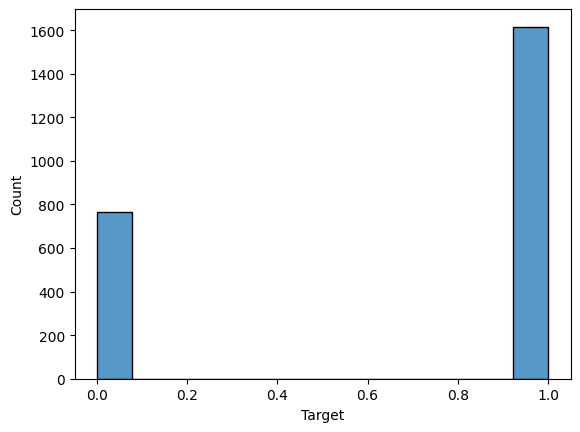

In [ ]:
sns.histplot(data = ola, x = "Target")
plt.show()

**Observation**
> ola primlimnary pre processed data has 31 columns and 2381 rows. It is small dataset. So better to use Kfold validation instead of train_val_test split.

> It is highly imbalanced Binary Class data. we can compare the performance of models before and after balancing the datasets

### Balancing using SMOTE

In [ ]:
# Seperating Target feature from the dataset
y = ola["Target"]
X = ola.drop("Target",axis = 1)

# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# SMOTE balancing
smt = SMOTE(random_state=42)
X_train , y_train = smt.fit_resample(X_train,y_train)

# standard Scaling
st = StandardScaler()
X_train = st.fit_transform(X_train.values)
X_test = st.transform(X_test.values)

# Logistic Regression model
model = LogisticRegression(random_state=42)
model.fit(X_train, y_train)
y_pred_train = model.predict(X_train)
y_pred_test = model.predict(X_test)

# accuracy
print("train_accuracy",accuracy_score(y_train,y_pred_train))
print("test_accuracy",accuracy_score(y_test,y_pred_test))

train_accuracy 0.8657874321179209
test_accuracy 0.8637316561844863


### Balancing by using class weight parameter

In [ ]:
# Seperating Target feature from the dataset
y = ola["Target"]
X = ola.drop("Target",axis = 1)

# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# standard Scaling
st = StandardScaler()
X_train = st.fit_transform(X_train.values)
X_test = st.transform(X_test.values)

# Logistic Regression model
model = LogisticRegression(random_state=42,class_weight="balanced")
model.fit(X_train, y_train)
y_pred_train = model.predict(X_train)
y_pred_test = model.predict(X_test)

# accuracy
print("train_accuracy",accuracy_score(y_train,y_pred_train))
print("test_accuracy",accuracy_score(y_test,y_pred_test))

train_accuracy 0.8797268907563025
test_accuracy 0.8867924528301887


### Balancing by using both SMOTE and class weight parameter

In [ ]:
# Seperating Target feature from the dataset
y = ola["Target"]
X = ola.drop("Target",axis = 1)

# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# SMOTE balancing
smt = SMOTE(random_state=42)
X_train , y_train = smt.fit_resample(X_train,y_train)

# standard Scaling
st = StandardScaler()
X_train = st.fit_transform(X_train.values)
X_test = st.transform(X_test.values)

# Logistic Regression model
model = LogisticRegression(random_state=42,class_weight="balanced")
model.fit(X_train, y_train)
y_pred_train = model.predict(X_train)
y_pred_test = model.predict(X_test)

# accuracy
print("train_accuracy",accuracy_score(y_train,y_pred_train))
print("test_accuracy",accuracy_score(y_test,y_pred_test))

train_accuracy 0.8657874321179209
test_accuracy 0.8637316561844863


**Observation**
> After observing above balancing methods and its accuracies, Clearly Dataset before balancing has better accuracy(90%) than the Dataset after balancing (88%). So We should apply next models for both before and after balancing Datasets for better comparison.

## ENCODING REQUIRED OR NOT

In [ ]:
ola.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2381 entries, 0 to 2380
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      2381 non-null   int64  
 1   City                     2381 non-null   int32  
 2   Education_Level          2381 non-null   int64  
 3   Gender                   2381 non-null   int64  
 4   Grade                    2381 non-null   int64  
 5   Grade_raise              2381 non-null   int64  
 6   Income_raise             2381 non-null   int64  
 7   Income_range             2381 non-null   int64  
 8   Join_month               2381 non-null   int32  
 9   Join_year                2381 non-null   int32  
 10  Joining Designation      2381 non-null   int64  
 11  QuarterlyRating_last     2381 non-null   int64  
 12  QuarterlyRating_mean     2381 non-null   float64
 13  QuarterlyRating_range    2381 non-null   int64  
 14  QuarterlyRating_std     

**Observation**
> Encoding is not required as all the features are integers. Can directly go for Scaling the data. Because here Categorical features like Education Level, Joining Designation, Grade, Quarterly Rating, join_month, join_year, Rating Promotion etc., are Ordinal Features. So Label Encoding is suitable. These are already in order in given dataset

> Remember SMOTE should be applied before Scaling the data for creating meaningful intermediate points.

> Apply the train test split, before doing any other pre processing steps like scaling, balancing, PCA

> PCA gets effected by scale, so it is better to do PCA after Scaling   

## TRAIN TEST SPLIT FOR MODELS

### Before Balancing Dataset

In [ ]:
# Seperating Target feature from the dataset
y = ola["Target"]
X = ola.drop("Target",axis = 1)
print("X shape",X.shape)
print("y shape",y.shape)

# Split the dataset into training and testing sets
X_train_imb, X_test_imb, y_train_imb, y_test_imb = train_test_split(X, y, test_size=0.2, random_state=42)

print("X_train_imb shape",X_train_imb.shape)
print("X_test_imb shape",X_test_imb.shape)
print("y_train_imb shape",y_train_imb.shape)
print("y_test_imb shape",y_test_imb.shape)
print("y_train_imb value_counts", y_train_imb.value_counts())
print("y_test_imb value_counts", y_test_imb.value_counts())

X shape (2381, 30)
y shape (2381,)
X_train_imb shape (1904, 30)
X_test_imb shape (477, 30)
y_train_imb shape (1904,)
y_test_imb shape (477,)
y_train_imb value_counts Target
1    1289
0     615
Name: count, dtype: int64
y_test_imb value_counts Target
1    327
0    150
Name: count, dtype: int64


### After Balancing the Dataset

In [ ]:
# Seperating Target feature from the dataset
y = ola["Target"]
X = ola.drop("Target",axis = 1)
print("X shape",X.shape)
print("y shape",y.shape)

# Split the dataset into training and testing sets
X_train_bal, X_test_bal, y_train_bal, y_test_bal = train_test_split(X, y, test_size=0.2, random_state=42)

# SMOTE balancing
smt = SMOTE(random_state=42)
X_train_bal , y_train_bal = smt.fit_resample(X_train_bal,y_train_bal)

print("X_train_bal shape",X_train_bal.shape)
print("X_test_bal shape",X_test_bal.shape)
print("y_train_bal shape",y_train_bal.shape)
print("y_test_bal shape",y_test_bal.shape)
print("y_train_bal value_counts", y_train_bal.value_counts())
print("y_test_bal value_counts", y_test_bal.value_counts())

X shape (2381, 30)
y shape (2381,)
X_train_bal shape (2578, 30)
X_test_bal shape (477, 30)
y_train_bal shape (2578,)
y_test_bal shape (477,)
y_train_bal value_counts Target
0    1289
1    1289
Name: count, dtype: int64
y_test_bal value_counts Target
1    327
0    150
Name: count, dtype: int64


**Observation**
> bal indicates train and test sets formed from imbalanced ola dataset

> X_test should not be balanced as it is test data

> Balancing should be done before scaling for creating meaningful features  

## STANDARD SCALING OF BALANCED AND IMBALANCED DATASETS

### imbalanced Dataset

In [ ]:
st = StandardScaler()
X_train_imb= st.fit_transform(X_train_imb.values)
X_test_imb = st.transform(X_test_imb.values)
# No need to do scaling for target features

### Balanced Dataset

In [ ]:
st = StandardScaler()
X_train_bal= st.fit_transform(X_train_bal.values)
X_test_bal = st.transform(X_test_bal.values)

## PCA VISUALISATION OF BALANCED AND IMBALANCED DATASETS

### Imbalanced Dataset

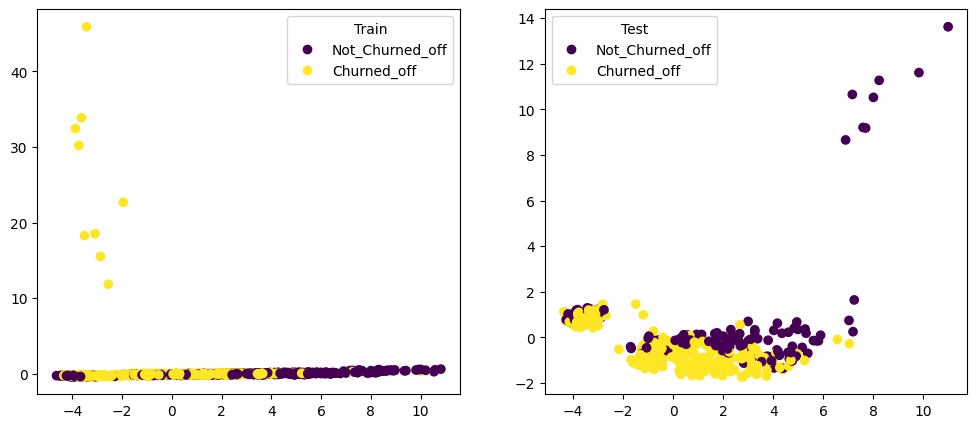

In [ ]:
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)

# Converting multidimensional dataset to 2D train dataset using PCA instance
pca = PCA(n_components=2,random_state=42)
visualize = pca.fit_transform(X_train_imb)

# 2D Scatter Plot of Train Dataset to visualize
scatter = plt.scatter(visualize[:,0],visualize[:,1],c = y_train_imb.values)
plt.legend(handles = scatter.legend_elements()[0],labels = ["Not_Churned_off","Churned_off"], title = "Train")

plt.subplot(1,2,2)

# Converting multidimensional dataset to 2D test dataset using PCA instance
pca = PCA(n_components=2,random_state=42)
visualize = pca.fit_transform(X_test_imb)

# 2D Scatter Plot of Test Dataset to visualize
scatter = plt.scatter(visualize[:,0],visualize[:,1],c = y_test_imb.values)
plt.legend(handles = scatter.legend_elements()[0],labels = ["Not_Churned_off","Churned_off"],title = "Test")
plt.show()

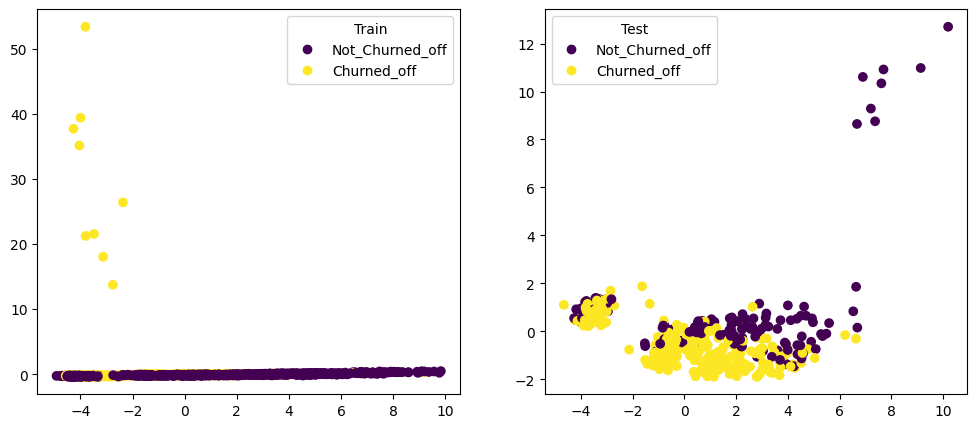

In [ ]:
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)

# Converting multidimensional dataset to 2D train dataset using PCA instance
pca = PCA(n_components=2,random_state=42)
visualize = pca.fit_transform(X_train_bal)

# 2D Scatter Plot of Train Dataset to visualize
scatter = plt.scatter(visualize[:,0],visualize[:,1],c = y_train_bal.values)
plt.legend(handles = scatter.legend_elements()[0],labels = ["Not_Churned_off","Churned_off"], title = "Train")

plt.subplot(1,2,2)

# Converting multidimensional dataset to 2D test dataset using PCA instance
pca = PCA(n_components=2,random_state=42)
visualize = pca.fit_transform(X_test_bal)

# 2D Scatter Plot of Test Dataset to visualize
scatter = plt.scatter(visualize[:,0],visualize[:,1],c = y_test_bal.values)
plt.legend(handles = scatter.legend_elements()[0],labels = ["Not_Churned_off","Churned_off"],title = "Test")
plt.show()

**Observation**
> Can clearly observe that more Dark blue points are created because of SMOTE which are Not_churned_off (minority Class)

## CREATING ALL THE REQUIRED FUNCTIONS TO LOG METRICS, PARAMS, ARTIFACTS, PLOTS INTO MLFLOW AND ALSO PRINT THEM

### auc_plots function

In [ ]:
def auc_plots(model, X, y):
    try:
        y_pred_prob = model.predict_proba(X)[:, 1]  # Consider only positive class
        fpr, tpr, _ = roc_curve(y, y_pred_prob)
        pr, re, _ = precision_recall_curve(y, y_pred_prob)
        roc_auc = auc(fpr, tpr)
        pr_auc = auc(re, pr)
        return fpr, tpr, pr, re, roc_auc, pr_auc
    except Exception as e:
        print(f"Error in auc_plots: {e}")
        return None, None, None, None, None, None

### plot_learning_curve function

In [ ]:
def plot_learning_curve(model, X, y, run_name):
    try:
        train_sizes, train_scores, validation_scores = learning_curve(model, X, y, cv=5, n_jobs=-1)
        train_mean = train_scores.mean(axis=1)
        train_std = train_scores.std(axis=1)
        validation_mean = validation_scores.mean(axis=1)
        validation_std = validation_scores.std(axis=1)

        plt.figure(figsize=(10, 6))
        plt.plot(train_sizes, train_mean, 'o-', color='blue', label='Training score')
        plt.plot(train_sizes, validation_mean, 'o-', color='red', label='Validation score')
        plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.1, color='blue')
        plt.fill_between(train_sizes, validation_mean - validation_std, validation_mean + validation_std, alpha=0.1, color='red')

        plt.xlabel('Training examples')
        plt.ylabel('Score')
        plt.title('Learning Curve')
        plt.legend(loc='best')
        plt.grid(True)

        # Save the learning curve plot
        plt.savefig(f"{run_name}_learning_curve.png")
        plt.show()
        plt.close()
        return f"{run_name}_learning_curve.png"

    except Exception as e:
        print(f"Error in plot_learning_curve: {e}")
        return None

### mlflow_logging_and_metric_printing function

In [ ]:
def mlflow_logging_and_metric_printing(model, run_name, bal_type, X_train, y_train, X_test, y_test, y_pred_train, y_pred_test,hyper_tuning_score = 0, **params):
    mlflow.set_experiment("Ola_Ensemble_Learning")

    with mlflow.start_run(run_name=run_name):
        try:
            # Log parameters
            if params:
                mlflow.log_params(params)
            mlflow.log_param("bal_type", bal_type)

            # Calculate metrics
            train_metrics = {
                "Accuracy_train": accuracy_score(y_train, y_pred_train),
                "Precision_train": precision_score(y_train, y_pred_train),
                "Recall_train": recall_score(y_train, y_pred_train),
                "F1_score_train": f1_score(y_train, y_pred_train),
                "F2_score_train": fbeta_score(y_train, y_pred_train, beta=2)  # Emphasize recall
            }

            test_metrics = {
                "Accuracy_test": accuracy_score(y_test, y_pred_test),
                "Precision_test": precision_score(y_test, y_pred_test),
                "Recall_test": recall_score(y_test, y_pred_test),
                "F1_score_test": f1_score(y_test, y_pred_test),
                "F2_score_test": fbeta_score(y_test, y_pred_test, beta=2)  # Emphasize recall
            }

            tuning_metrics = {"hyper_parameter_tuning_best_est_score":hyper_tuning_score}


            # Compute AUC metrics
            train_fpr, train_tpr, train_pr, train_re, train_roc_auc, train_pr_auc = auc_plots(model, X_train, y_train)
            test_fpr, test_tpr, test_pr, test_re, test_roc_auc, test_pr_auc = auc_plots(model, X_test, y_test)

            # Log AUC metrics
            if train_roc_auc is not None:
                train_metrics["Roc_auc_train"] = train_roc_auc
                mlflow.log_metric("Roc_auc_train", train_roc_auc)
            if train_pr_auc is not None:
                train_metrics["Pr_auc_train"] = train_pr_auc
                mlflow.log_metric("Pr_auc_train", train_pr_auc)
            if test_roc_auc is not None:
                test_metrics["Roc_auc_test"] = test_roc_auc
                mlflow.log_metric("Roc_auc_test", test_roc_auc)
            if test_pr_auc is not None:
                test_metrics["Pr_auc_test"] = test_pr_auc
                mlflow.log_metric("Pr_auc_test", test_pr_auc)

            # Print metrics
            print("Train Metrics:")
            for key, value in train_metrics.items():
                print(f"{key}: {value:.4f}")
            print("\nTest Metrics:")
            for key, value in test_metrics.items():
                print(f"{key}: {value:.4f}")
            print("\nTuning Metrics:")
            for key, value in tuning_metrics.items():
                print(f"{key}: {value:.4f}")

            # Classification Reports
            train_clf_report = classification_report(y_train, y_pred_train)
            test_clf_report = classification_report(y_test, y_pred_test)

            # Print classification reports
            print("\nTrain Classification Report:")
            print(train_clf_report)
            print("\nTest Classification Report:")
            print(test_clf_report)

            # Log metrics
            mlflow.log_metrics(train_metrics)
            mlflow.log_metrics(test_metrics)
            mlflow.log_metrics(tuning_metrics)

            # Convert classification reports to DataFrames
            train_clf_report_dict = classification_report(y_train, y_pred_train, output_dict=True)
            train_clf_report_df = pd.DataFrame(train_clf_report_dict).transpose()
            test_clf_report_dict = classification_report(y_test, y_pred_test, output_dict=True)
            test_clf_report_df = pd.DataFrame(test_clf_report_dict).transpose()

            # Save classification reports and log as artifacts
            train_clf_report_df.to_csv(f"{run_name}_train_classification_report.csv")
            mlflow.log_artifact(f"{run_name}_train_classification_report.csv")

            test_clf_report_df.to_csv(f"{run_name}_test_classification_report.csv")
            mlflow.log_artifact(f"{run_name}_test_classification_report.csv")

            # Plot confusion matrices
            fig, axes = plt.subplots(1, 2, figsize=(12, 6))

            ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_train, y_pred_train), display_labels=["Not_churned_off", "Churned_off"]).plot(ax=axes[0], cmap="Blues")
            axes[0].set_title('Train Confusion Matrix')

            ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_test), display_labels=["Not_churned_off", "Churned_off"]).plot(ax=axes[1], cmap="Blues")
            axes[1].set_title('Test Confusion Matrix')

            plt.tight_layout()
            plt.savefig(f"{run_name}_confusion_matrix.png")
            mlflow.log_artifact(f"{run_name}_confusion_matrix.png")

            # ROC and Precision-Recall curves
            fig, axes = plt.subplots(2, 2, figsize=(12, 12))
            datasets = [("Train", X_train, y_train), ("Test", X_test, y_test)]

            for i, (name, X, y) in enumerate(datasets):
                fpr, tpr, pr, re, roc_auc, pr_auc = auc_plots(model, X, y)
                if fpr is None:
                    return

                # ROC AUC Curve
                axes[i, 0].plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
                axes[i, 0].plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
                axes[i, 0].set_xlim([0.0, 1.0])
                axes[i, 0].set_ylim([0.0, 1.0])
                axes[i, 0].set_xlabel('False Positive Rate')
                axes[i, 0].set_ylabel('True Positive Rate')
                axes[i, 0].set_title(f'Receiver Operating Characteristic ({name} data)')
                axes[i, 0].legend(loc='lower right')

                # Precision-Recall Curve
                axes[i, 1].plot(re, pr, color='green', lw=2, label=f'Precision-Recall curve (area = {pr_auc:.2f})')
                axes[i, 1].set_xlabel('Recall')
                axes[i, 1].set_ylabel('Precision')
                axes[i, 1].set_title(f'Precision-Recall Curve ({name} data)')
                axes[i, 1].legend(loc='lower left')

            plt.tight_layout()
            plt.savefig(f"{run_name}_auc_plots.png")
            mlflow.log_artifact(f"{run_name}_auc_plots.png")

            # Plot learning curves
            learning_curve_file = plot_learning_curve(model, X_train, y_train, run_name)
            if learning_curve_file:
                mlflow.log_artifact(learning_curve_file)

            # Log the model
            mlflow.sklearn.log_model(model, f"{run_name}_model")
            print("MLFLOW Logging is completed")

        except Exception as e:
            print(f"Error in mlflow_logging_and_metric_printing: {e}")

    # To view the logged data, run the following command in the terminal:
    # mlflow ui


**Observation**
> fbeta_score = fbeta_score(y_test_imb,y_pred_imb,beta=2)

> Recall is given priority by reducing False Negatives i.e, Most of the employees who are likely to churn are identified correctly

> above functions are used to logged the metrics into mlflow and print the metrics in jupyter notebook.

> For comparison sake, We will use this function for best estimators of Grid or Random search CV.

### Simple_Logistic_Regresssion_on_Imbalanced Dataset

In [ ]:
# Initialize DataFrames
time_df = pd.DataFrame(columns=["Model", "bal_type","Training_Time", "Testing_Time","Tuning_Time"])
feature_importance_df = pd.DataFrame()
ola_features = ola.columns.drop("Target")

In [ ]:
# Model details
name = "Simple_Logistic_Regression_on_Imbalanced_Dataset"
model = LogisticRegression(random_state=42,n_jobs = -1)

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")

Model: Simple_Logistic_Regression_on_Imbalanced_Dataset
Training Time: 2.7384 seconds
Testing Time: 0.0023 seconds


### log_time_and_feature_importance_df function

In [ ]:
def log_time_and_feature_importances_df(time_df, feature_importance_df, name, training_time, testing_time, model, ola_features, bal_type, tuning_time=0):
    # Store the times in the DataFrame using pd.concat
    time_df = pd.concat([time_df, pd.DataFrame({
        "Model": [name],
        "bal_type": [bal_type],
        "Training_Time": [training_time],
        "Testing_Time": [testing_time],
        "Tuning_Time": [tuning_time]
    })], ignore_index=True)

    # Feature Importances
    if hasattr(model, "coef_"):
        # For linear models like Logistic Regression or Linear SVC
        feature_importances = model.coef_.flatten()

    elif hasattr(model, "feature_importances_"):
        # For tree-based models like Decision Trees, RandomForest, GradientBoosting, etc.
        feature_importances = model.feature_importances_

    else:
        # If the model does not have feature importances, we skip logging for this model
        feature_importances = None

    if feature_importances is not None:
        # Create a DataFrame with feature importances
        importance_df = pd.DataFrame(feature_importances, index=ola_features, columns=[name])
        feature_importance_df = pd.concat([feature_importance_df, importance_df], axis=1)

    return time_df, feature_importance_df

In [ ]:
def feature_importances_df_new(feature_importance_df, name, model, ola_features, bal_type):
    # Feature Importances
    if hasattr(model, "coef_"):
        # For linear models like Logistic Regression or Linear SVC
        feature_importances = model.coef_.flatten()

    elif hasattr(model, "feature_importances_"):
        # For tree-based models like Decision Trees, RandomForest, GradientBoosting, etc.
        feature_importances = model.feature_importances_

    else:
        # If the model does not have feature importances, we skip logging for this model
        feature_importances = None

    if feature_importances is not None:
        # Create a DataFrame with feature importances
        importance_df = pd.DataFrame(feature_importances, index=ola_features, columns=[name])
        feature_importance_df = pd.concat([feature_importance_df, importance_df], axis=1)

    return feature_importance_df

In [ ]:
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,"Imbalanced")

In [ ]:
# if mlflow.active_run() is not None:
#     mlflow.end_run()

Simple_Logistic_Regression_on_Imbalanced_Dataset
Train Metrics:
Accuracy_train: 0.8866
Precision_train: 0.8942
Recall_train: 0.9441
F1_score_train: 0.9185
F2_score_train: 0.9337
Roc_auc_train: 0.9460
Pr_auc_train: 0.9723

Test Metrics:
Accuracy_test: 0.9099
Precision_test: 0.9104
Recall_test: 0.9633
F1_score_test: 0.9361
F2_score_test: 0.9522
Roc_auc_test: 0.9427
Pr_auc_test: 0.9598

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.0000

Train Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.77      0.81       615
           1       0.89      0.94      0.92      1289

    accuracy                           0.89      1904
   macro avg       0.88      0.85      0.87      1904
weighted avg       0.89      0.89      0.88      1904


Test Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.79      0.85       150
           1       0.91      0.96      0.94       327

 

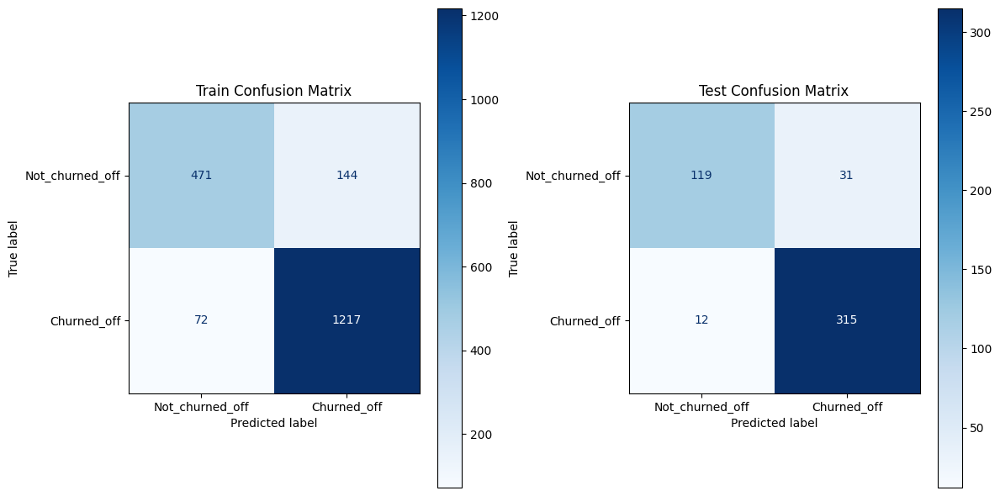

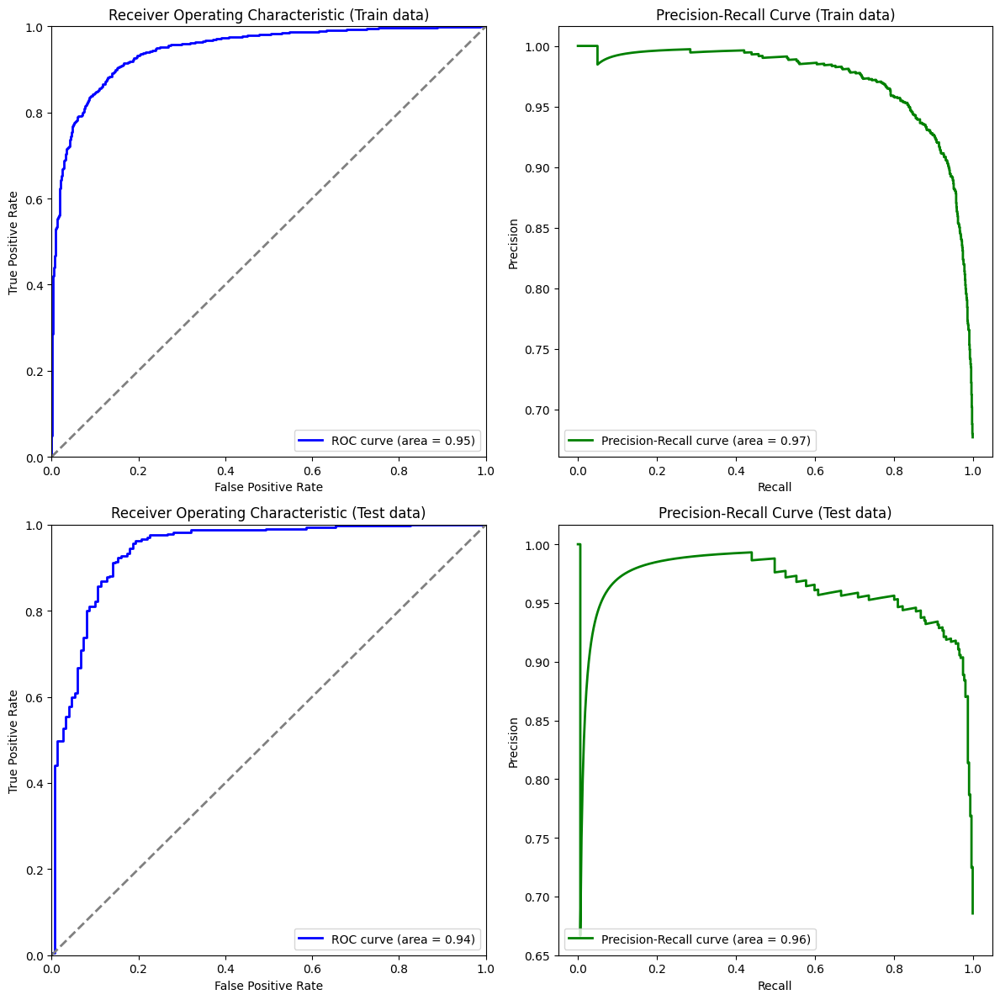

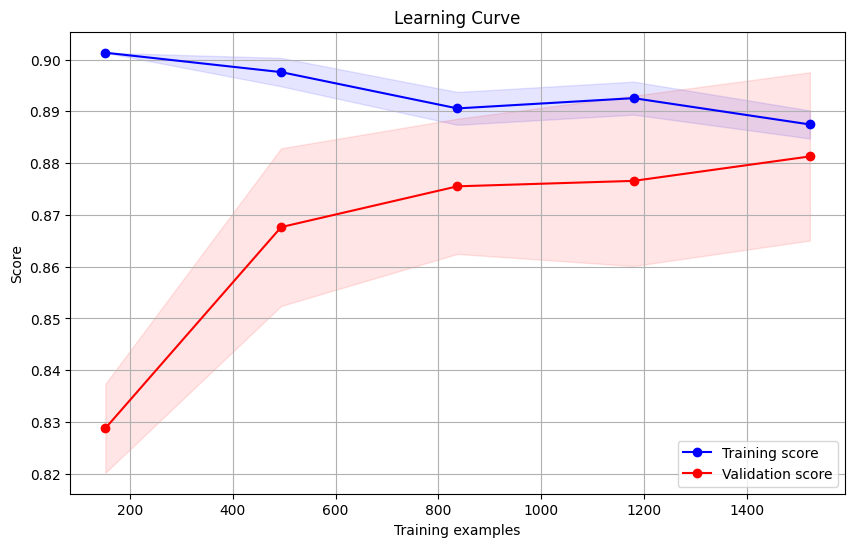

MLFLOW Logging is completed


In [ ]:
params = {"random_state":42,"n_jobs":-1}
print(name)
mlflow_logging_and_metric_printing(model,name,"Imbalanced",X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,**params)

### Simple_Logistic_Regresssion_on_Balanced Dataset

In [ ]:
# Model details
name = "Simple_Logistic_Regresssion_on_balanced_Dataset"
model = LogisticRegression(random_state=42,n_jobs = -1)
bal_type = "Balanced"

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")

# log time and feature importances into df
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type)

Model: Simple_Logistic_Regresssion_on_balanced_Dataset
Training Time: 0.0362 seconds
Testing Time: 0.0000 seconds


Simple_Logistic_Regresssion_on_balanced_Dataset
Train Metrics:
Accuracy_train: 0.8658
Precision_train: 0.8527
Recall_train: 0.8844
F1_score_train: 0.8682
F2_score_train: 0.8779
Roc_auc_train: 0.9424
Pr_auc_train: 0.9463

Test Metrics:
Accuracy_test: 0.8637
Precision_test: 0.9226
Recall_test: 0.8746
F1_score_test: 0.8980
F2_score_test: 0.8838
Roc_auc_test: 0.9292
Pr_auc_test: 0.9552

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.0000

Train Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.85      0.86      1289
           1       0.85      0.88      0.87      1289

    accuracy                           0.87      2578
   macro avg       0.87      0.87      0.87      2578
weighted avg       0.87      0.87      0.87      2578


Test Classification Report:
              precision    recall  f1-score   support

           0       0.75      0.84      0.79       150
           1       0.92      0.87      0.90       327

  

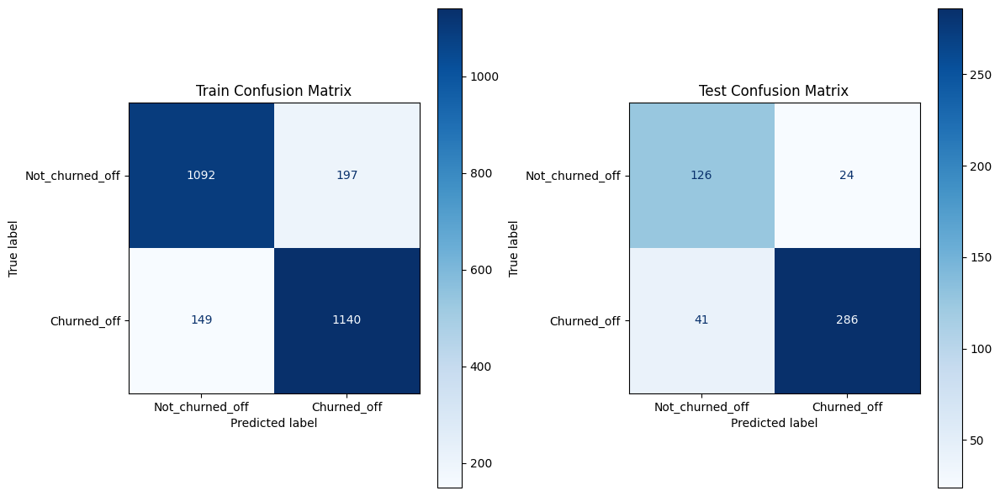

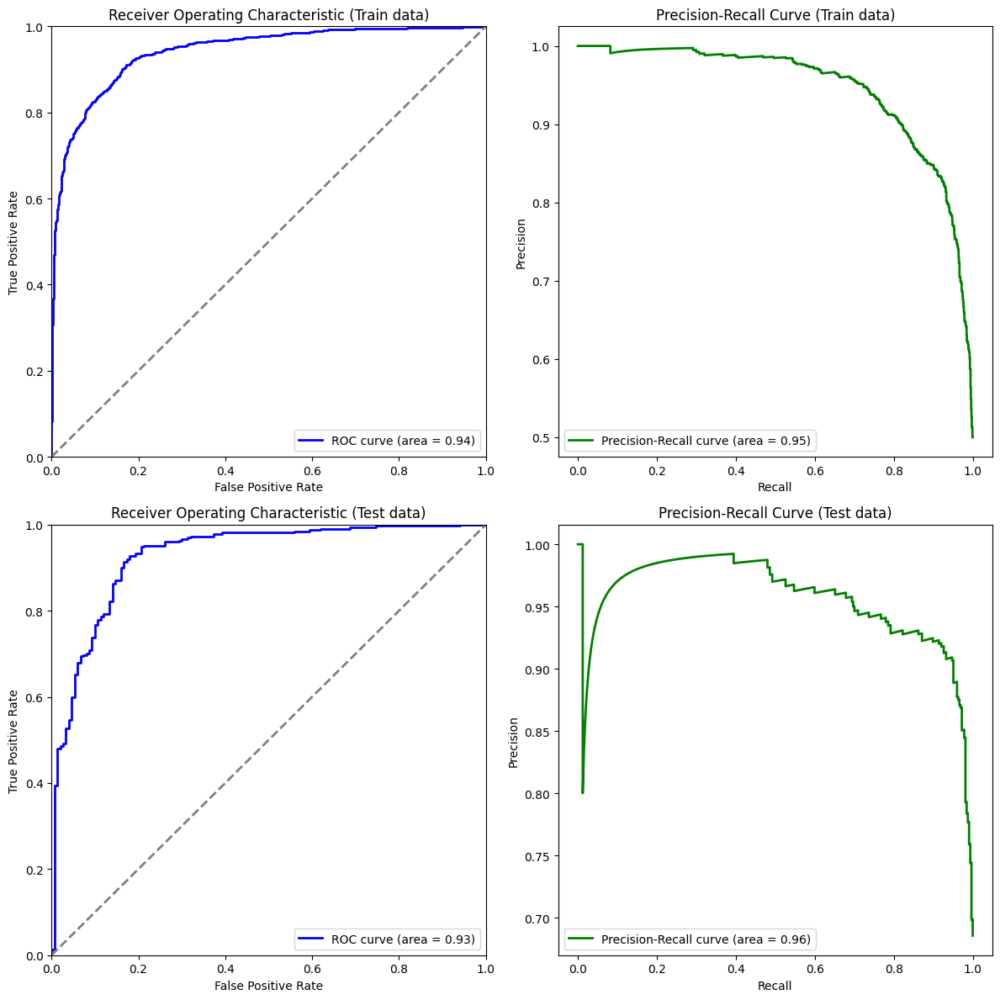

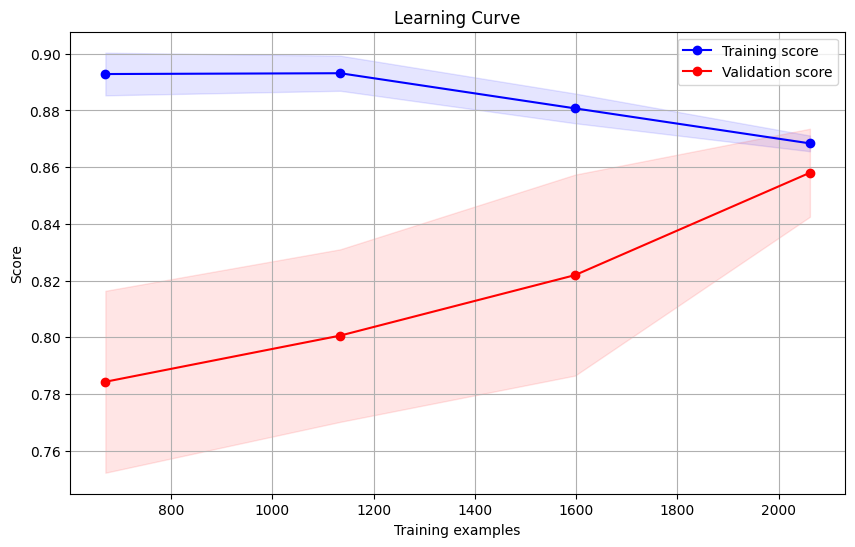

MLFLOW Logging is completed


In [ ]:
params = {"random_state":42,"n_jobs":-1}
print(name)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,**params)

### all_logged_metrics function

In [ ]:
def all_logged_metrics():
    # Set the experiment name
    experiment_name = "Ola_Ensemble_Learning"

    # Get the experiment details
    experiment = mlflow.get_experiment_by_name(experiment_name)
    experiment_id = experiment.experiment_id

    # Retrieve all runs from the experiment
    runs_df = mlflow.search_runs(experiment_ids=[experiment_id])

    # Extract metrics columns
    metrics_columns = [col for col in runs_df.columns if col.startswith("metrics.")]
    metrics_df = runs_df[metrics_columns]

    # Add run_name as a column
    metrics_df['run_name'] = runs_df['tags.mlflow.runName']
    metrics_df["bal_type"] = runs_df["params.bal_type"]

    # Combine all params into a dictionary
    params_columns = [col for col in runs_df.columns if col.startswith("params.")]
    metrics_df["params_dict"] = runs_df[params_columns].apply(lambda row: row.dropna().to_dict(), axis=1)

    # Sort remaining columns alphabetically
    sorted_columns = sorted(metrics_columns)

    # Rearrange columns: first column is 'run_name', followed by 'bal_type', 'params_dict', and then sorted metric columns
    ordered_columns = ['run_name', "bal_type", "params_dict"] + sorted_columns
    metrics_df = metrics_df[ordered_columns]

    # If you want to view it in a more readable format
    return metrics_df

### Visualising all_logged_metrics, time_df and feature_imporatance df

#### All_logged_metrics_plots

In [ ]:
# Example usage
pd.set_option('display.max_colwidth', None)  # Show full content in cells
all_logged_metrics_df = all_logged_metrics()
all_logged_metrics_df.head()


,run_name,bal_type,params_dict,metrics.Accuracy_test,metrics.Accuracy_train,metrics.F1_score_test,metrics.F1_score_train,metrics.F2_score_test,metrics.F2_score_train,metrics.Pr_auc_test,metrics.Pr_auc_train,metrics.Precision_test,metrics.Precision_train,metrics.Recall_test,metrics.Recall_train,metrics.Roc_auc_test,metrics.Roc_auc_train,metrics.hyper_parameter_tuning_best_est_score
0,Simple_Logistic_Regresssion_on_balanced_Dataset,Balanced,"{'params.bal_type': 'Balanced', 'params.random_state': '42', 'params.n_jobs': '-1'}",0.863732,0.865787,0.897959,0.868241,0.883807,0.877868,0.955210,0.946333,0.922581,0.852655,0.874618,0.884407,0.929154,0.942393,0.00000
1,Simple_Logistic_Regression_on_Imbalanced_Dataset,Imbalanced,"{'params.bal_type': 'Imbalanced', 'params.random_state': '42', 'params.n_jobs': '-1'}",0.909853,0.886555,0.936107,0.918491,0.952237,0.933712,0.959764,0.972315,0.910405,0.894195,0.963303,0.944143,0.942650,0.945990,0.00000
2,Two_Level_Cascading_Classifier_on_Balanced_Dataset,Balanced,{'params.bal_type': 'Balanced'},0.899371,0.999224,0.926154,0.999224,0.922747,0.999224,NaN,NaN,0.931889,0.999224,0.920489,0.999224,NaN,NaN,0.92282
3,Two_Level_Cascading_Classifier_on_Imbalanced_Dataset,Imbalanced,{'params.bal_type': 'Imbalanced'},0.911950,0.957458,0.936747,0.968906,0.945289,0.974969,NaN,NaN,0.922849,0.958967,0.951070,0.979054,NaN,NaN,0.92282
4,Tuned_Stacking_Classifier_on_Balanced_Dataset,Balanced,"{'params.bal_type': 'Balanced', 'params.passthrough': 'True', 'params.stack_method': 'predict'}",0.899371,0.999224,0.926154,0.999224,0.922747,0.999224,0.963908,0.999996,0.931889,0.999224,0.920489,0.999224,0.938899,0.999996,0.92282


In [ ]:
pd.reset_option('display.max_colwidth')

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def all_logged_metrics_df_plots(df):
    # Melt the DataFrame to make it easier to plot
    metrics_columns = df.columns[3:]  # Select only metric columns
    df_melted = df.melt(id_vars=['run_name', 'bal_type'],
                        value_vars=metrics_columns,
                        var_name='Metric',
                        value_name='Value')

    # Create subplots with 8 rows and 2 columns
    n_rows = 8
    n_cols = 2
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 30))
    axes = axes.flatten()  # Flatten the axes array for easy iteration

    # Plot each metric in a separate subplot
    for i, metric in enumerate(metrics_columns):
        sns.barplot(x='bal_type', y='Value', hue='run_name', data=df_melted[df_melted['Metric'] == metric], ax=axes[i])
        axes[i].set_title(metric)
        axes[i].set_xlabel('')
        axes[i].set_ylabel('Value')
        axes[i].legend_.remove()  # Remove legend from individual plots

    # Remove any unused subplots
    for j in range(len(metrics_columns), len(axes)):
        fig.delaxes(axes[j])

    # Add a single legend for all subplots
    handles, labels = axes[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', ncol=3, bbox_to_anchor=(0.5, 1.03))

    # Adjust layout
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)  # Adjust top to make space for the global legend
    plt.show()

# Example usage with your DataFrame
# all_logged_metrics_df_plots(all_logged_metrics_df)

![image.png](attachment:image.png)

#### time_df_plots

In [ ]:
time_df

,Model,bal_type,Training_Time,Testing_Time,Tuning_Time
0,Simple_Logistic_Regression_on_Imbalanced_Dataset,Imbalanced,2.738420,0.002282,0
1,Simple_Logistic_Regresssion_on_balanced_Dataset,Balanced,0.036155,0.000000,0


In [ ]:
def time_df_plots(time_df):
    # Create subplots for Training Time and Testing Time
    fig, axes = plt.subplots(1, 3, figsize=(25, 10))

    # Plot Training Time
    sns.barplot(x='Model', y='Training_Time', hue='bal_type', data=time_df, ax=axes[0])
    axes[0].set_title('Training Time by Model and Dataset Balance')
    axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')
    axes[0].set_xlabel('Model')
    axes[0].set_ylabel('Training Time (seconds)')

    # Plot Testing Time
    sns.barplot(x='Model', y='Testing_Time', hue='bal_type', data=time_df, ax=axes[1])
    axes[1].set_title('Testing Time by Model and Dataset Balance')
    axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')
    axes[1].set_xlabel('Model')
    axes[1].set_ylabel('Testing Time (seconds)')

    # Plot Tuning Time
    sns.barplot(x='Model', y='Tuning_Time', hue='bal_type', data=time_df, ax=axes[2])
    axes[2].set_title('Testing Time by Model and Dataset Balance')
    axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, ha='right')
    axes[2].set_xlabel('Model')
    axes[2].set_ylabel('Tuning Time (seconds)')

    # Adjust layout
    plt.tight_layout()

    # Show the plot
    plt.show()
# time_df_plots(time_df)

![image.png](attachment:image.png)

#### feature_importance_df_plots

In [ ]:
feature_importance_df

,Simple_Logistic_Regression_on_Imbalanced_Dataset,Simple_Logistic_Regresssion_on_balanced_Dataset
Age,0.109896,0.095305
City,0.069281,0.098565
Education_Level,0.037378,0.256508
Gender,0.047752,0.335353
Grade,-0.778416,-0.293402
Grade_raise,-0.200566,0.095718
Income_raise,-0.200566,0.095718
Income_range,0.722095,0.239048
Join_month,-0.365371,-0.312485
Join_year,-2.013868,-2.256950


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def feature_importance_plots(feature_importance_df):
    # Reset the index to get the features as a column
    feature_importance_df_reset = feature_importance_df.reset_index()

    # Melt the DataFrame to have a long-form DataFrame suitable for seaborn
    feature_importance_melted = feature_importance_df_reset.melt(id_vars='index',
                                                                 var_name='Model',
                                                                 value_name='Importance')

    # Create a seaborn horizontal barplot
    plt.figure(figsize=(10, 30))  # Adjust the figure size to be taller
    sns.barplot(x='Importance', y='index', hue='Model', data=feature_importance_melted, orient='h')

    # Set title and labels
    plt.title('Feature Importance Comparison')
    plt.xlabel('Importance Value')
    plt.ylabel('Features')
    plt.legend(loc = "lower right")
    # Display the plot
    plt.tight_layout()
    plt.show()

# Example usage with your feature_importance_df
# feature_importance_plots(feature_importance_df)


![image.png](attachment:image.png)

**Observation**
> We have created predefined functions for our easeness to log and print the metrics of the models

> Basically we have to do Grid or Random search CV, Then find the best estimator. On that best estimator, we can apply `mlflow_logging_and_metric_printing` function, `log_time_and_feature_importances_df` function

> if we want to visualize all metrics, time and feature importances for all the models, then use `all_logged_metrics`function, get the df from that function and use it in `All_logged_metrics_plots` function. We can use `time_df_plots' and 'feature_importance_df_plots' functions also.

> plots are modified at the end for better visualization  

# CHAPTER 5: MODEL BUILDING AND ENSEMBLE LEARNING

## LOGISTIC REGRESSION MODEL

In [ ]:
y_train_bal.value_counts()

Target
0    1289
1    1289
Name: count, dtype: int64

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid for RandomizedSearchCV
start_tune_time = time.time()
param_dist = {
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'C': stats.uniform(loc=0.01, scale=5000-0.01),  # Uniform distribution from 0.01 to 5000
    'solver': ['saga'],  # saga solver supports all penalties
    'class_weight': ['balanced']
}

# Initialize the Logistic Regression model
logReg = LogisticRegression(max_iter=10000,random_state=42)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator= logReg,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time",tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'C': 1872.706848835624, 'class_weight': 'balanced', 'penalty': 'l1', 'solver': 'saga'}
Best score: 0.87761983699406
Tuning_time 101.47512793540955


#### Logging Best Logistic Regression Model into MLFLOW

Model: Tuned_Logistic_Regression_on_Imbalanced_Dataset
params: {'C': 1872.706848835624, 'class_weight': 'balanced', 'penalty': 'l1', 'solver': 'saga'}
Training Time: 1.0464 seconds
Testing Time: 0.0012 seconds
Tuning Time: 101.4751 seconds
Train Metrics:
Accuracy_train: 0.8797
Precision_train: 0.9337
Recall_train: 0.8852
F1_score_train: 0.9088
F2_score_train: 0.8945
Roc_auc_train: 0.9482
Pr_auc_train: 0.9738

Test Metrics:
Accuracy_test: 0.8910
Precision_test: 0.9338
Recall_test: 0.9052
F1_score_test: 0.9193
F2_score_test: 0.9108
Roc_auc_test: 0.9421
Pr_auc_test: 0.9598

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8776

Train Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.87      0.82       615
           1       0.93      0.89      0.91      1289

    accuracy                           0.88      1904
   macro avg       0.86      0.88      0.87      1904
weighted avg       0.89      0.88      0.88      1904


Te

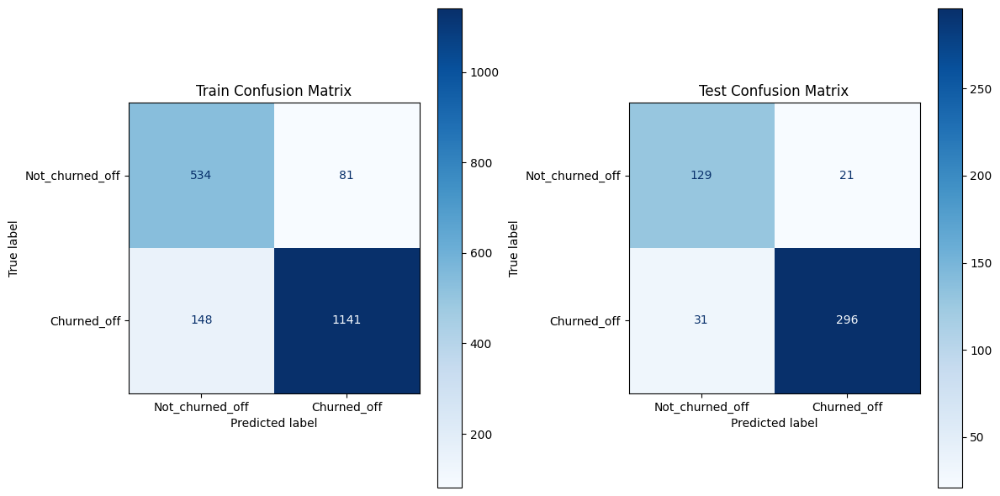

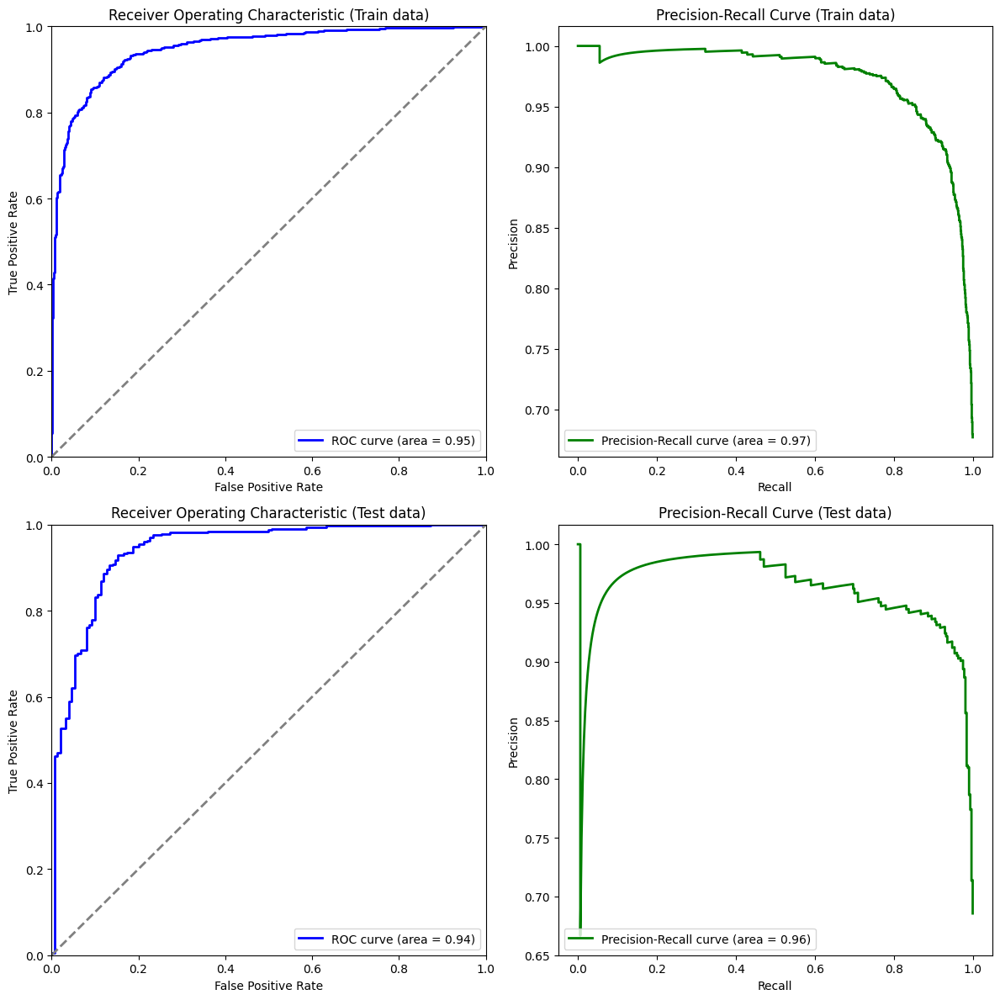

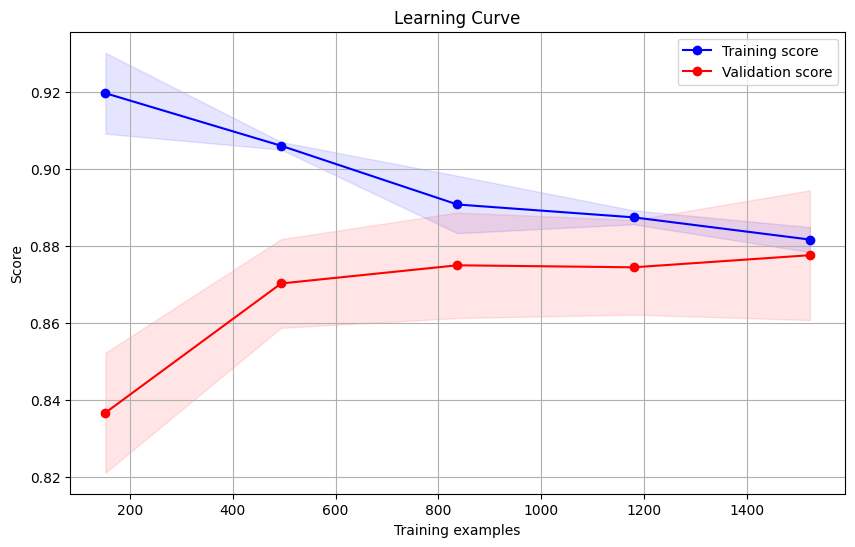

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Logistic_Regression_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid for RandomizedSearchCV
start_tune_time = time.time()
param_dist = {
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'C': stats.uniform(loc=0.01, scale=5000-0.01),  # Uniform distribution from 0.01 to 5000
    'solver': ['saga'],  # saga solver supports all penalties
    'class_weight': ['balanced']
}

# Initialize the Logistic Regression model
logReg = LogisticRegression(max_iter=10000,random_state = 42)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator= logReg,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time",tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'C': 1872.706848835624, 'class_weight': 'balanced', 'penalty': 'l1', 'solver': 'saga'}
Best score: 0.8622969820124935
Tuning_time 98.46020817756653


#### Logging Best Logistic Regression Model into MLFLOW

Model: Tuned_Logistic_Regression_on_Balanced_Dataset
params: {'C': 1872.706848835624, 'class_weight': 'balanced', 'penalty': 'l1', 'solver': 'saga'}
Training Time: 1.5594 seconds
Testing Time: 0.0023 seconds
Tuning Time: 98.4602 seconds
Train Metrics:
Accuracy_train: 0.8693
Precision_train: 0.8574
Recall_train: 0.8860
F1_score_train: 0.8714
F2_score_train: 0.8801
Roc_auc_train: 0.9427
Pr_auc_train: 0.9460

Test Metrics:
Accuracy_test: 0.8700
Precision_test: 0.9316
Recall_test: 0.8746
F1_score_test: 0.9022
F2_score_test: 0.8854
Roc_auc_test: 0.9298
Pr_auc_test: 0.9545

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8623

Train Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.85      0.87      1289
           1       0.86      0.89      0.87      1289

    accuracy                           0.87      2578
   macro avg       0.87      0.87      0.87      2578
weighted avg       0.87      0.87      0.87      2578


Test 

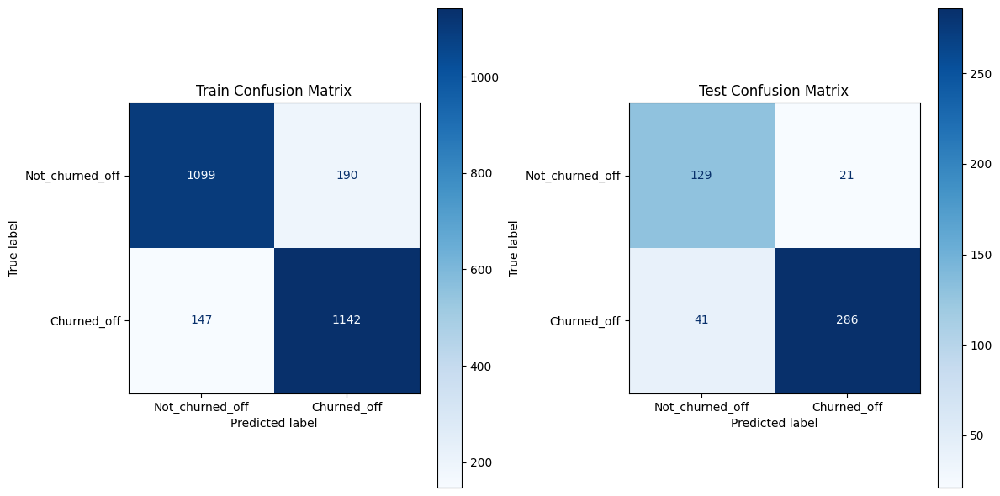

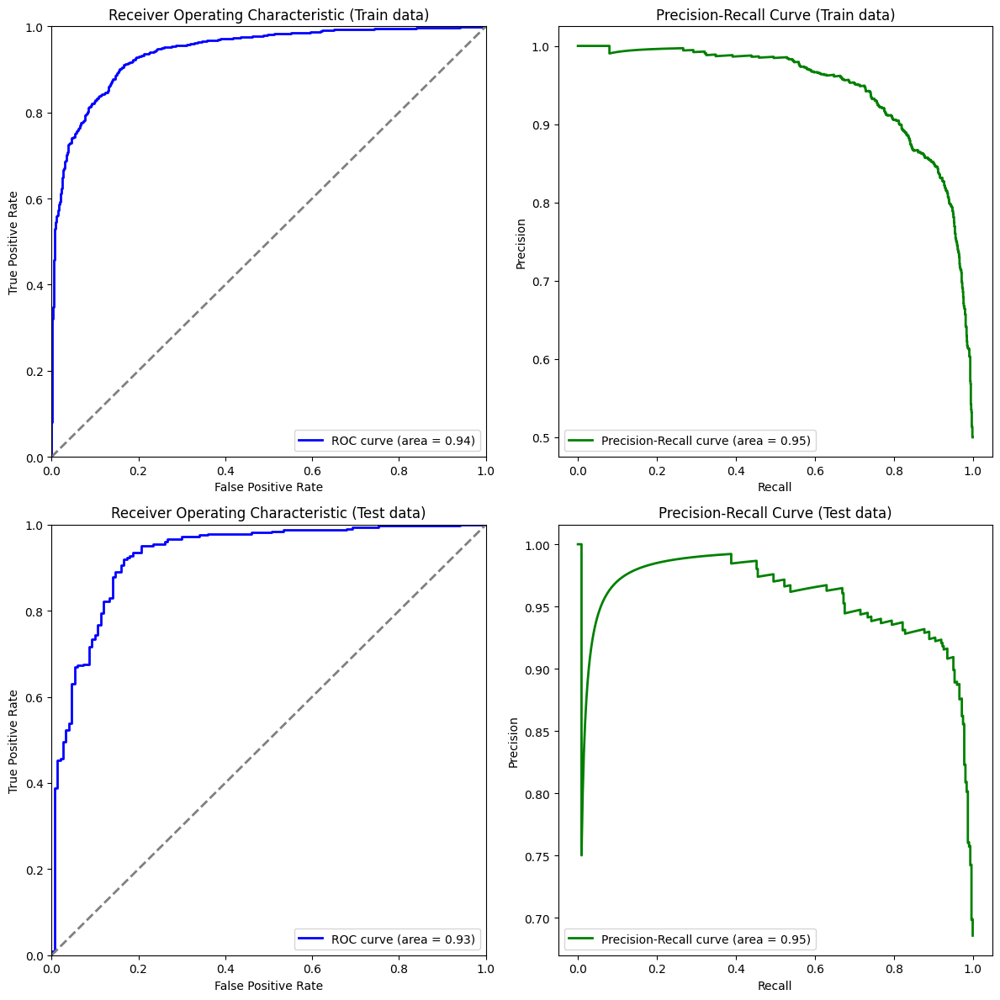

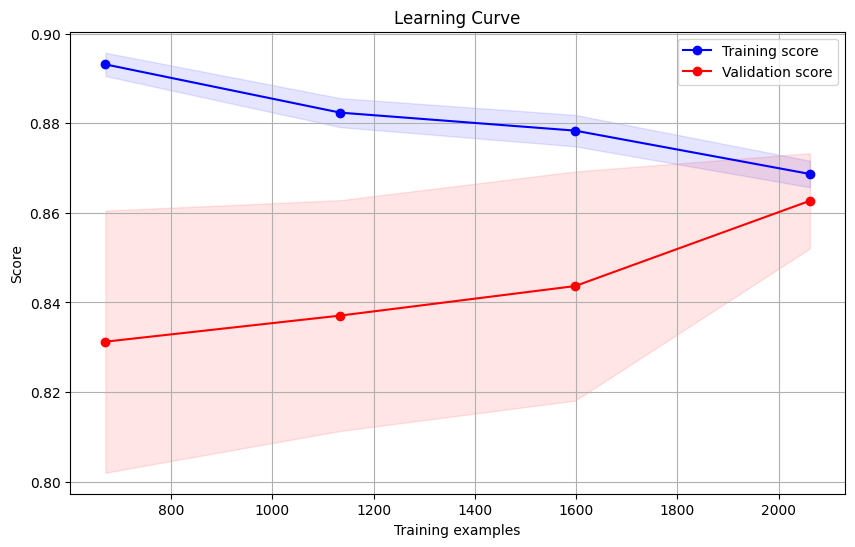

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Logistic_Regression_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## MULTI_LAYER_PERCEPTRON NEURAL NETWORK MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'hidden_layer_sizes': [(50,), (100,), (100, 50), (50, 50, 50)],
    'activation': ['identity', 'logistic', 'tanh', 'relu'],
    'solver': ['adam'],  # 'adam' is suitable for all activation functions
    'alpha': stats.uniform(0.0001, 5000),  # Uniform distribution from 0.0001 to 5000
    'learning_rate': ['constant', 'invscaling', 'adaptive'],
    'learning_rate_init': stats.uniform(0.0001, 0.1),  # Small learning rates for better convergence
    'max_iter': stats.randint(200, 1000),  # Increase max_iter for better convergence
    'early_stopping': [True, False],  # Use early stopping to prevent overfitting
    'tol': [1e-4, 1e-5, 1e-6],  # Lower tolerance for more precise convergence
}

# Initialize the MLPClassifier
mlp = MLPClassifier(max_iter=10000,random_state=42)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=mlp,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time",tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'activation': 'logistic', 'alpha': 3.893929205071642, 'early_stopping': False, 'hidden_layer_sizes': (50,), 'learning_rate': 'constant', 'learning_rate_init': 0.030524224295953774, 'max_iter': 221, 'solver': 'adam', 'tol': 0.0001}
Best score: 0.8209020582953446
Tuning_time 34.14068078994751


**Observation**
> n_iter increased to 200 in RandomizedSearchCV, Because 100 iter/candidate providing 0.67 score only.

#### Logging Best MLPClassifier Model into MLFLOW

Model: Tuned_MLPClassifier_on_Imbalanced_Dataset
params: {'activation': 'logistic', 'alpha': 3.893929205071642, 'early_stopping': False, 'hidden_layer_sizes': (50,), 'learning_rate': 'constant', 'learning_rate_init': 0.030524224295953774, 'max_iter': 221, 'solver': 'adam', 'tol': 0.0001}
Training Time: 0.2157 seconds
Testing Time: 0.0073 seconds
Tuning Time: 34.1407 seconds
Train Metrics:
Accuracy_train: 0.8309
Precision_train: 0.8300
Recall_train: 0.9434
F1_score_train: 0.8831
F2_score_train: 0.9183
Roc_auc_train: 0.8991
Pr_auc_train: 0.9487

Test Metrics:
Accuracy_test: 0.8281
Precision_test: 0.8267
Recall_test: 0.9480
F1_score_test: 0.8832
F2_score_test: 0.9210
Roc_auc_test: 0.8858
Pr_auc_test: 0.9342

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8209

Train Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.60      0.69       615
           1       0.83      0.94      0.88      1289

    accuracy                 

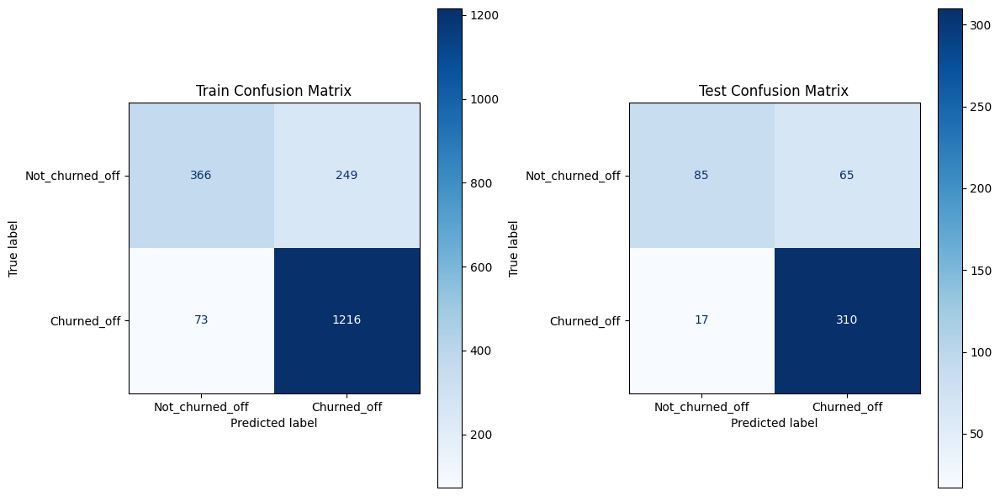

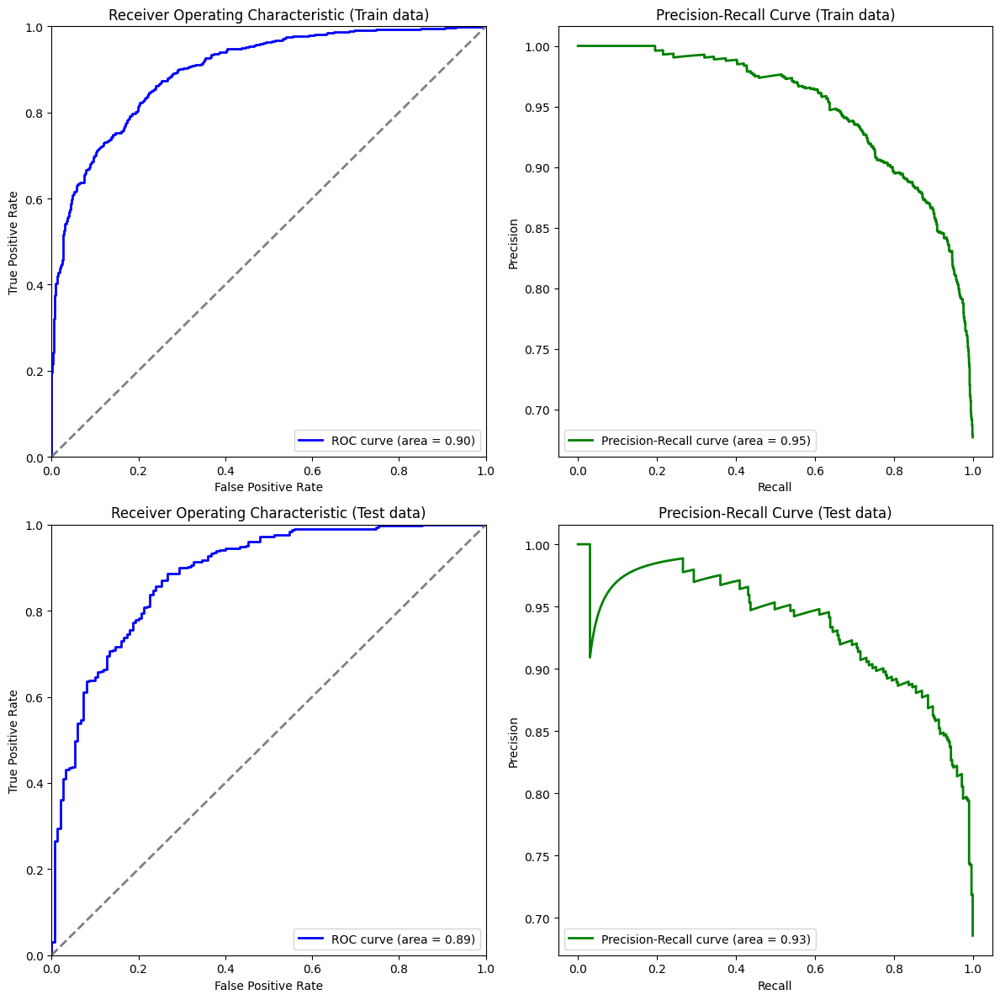

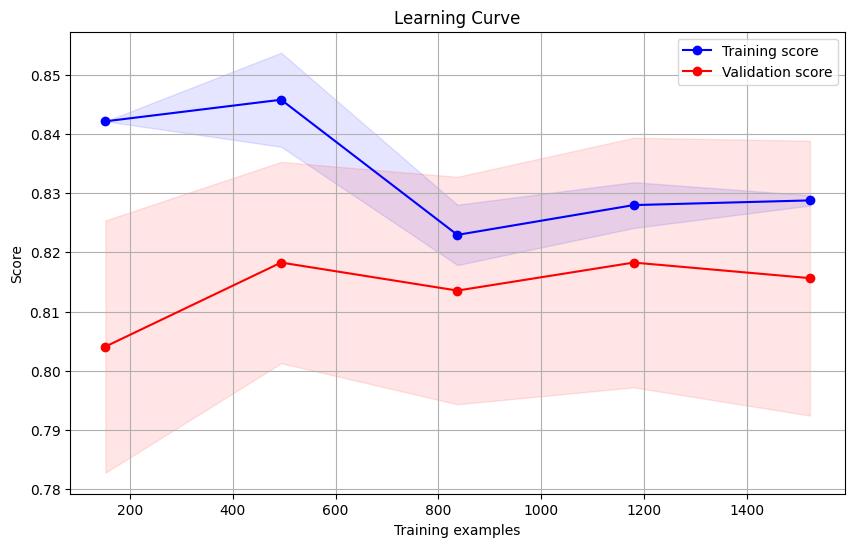

MLFLOW Logging is completed


In [ ]:
# Model details
name ="Tuned_MLPClassifier_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'hidden_layer_sizes': [(50,), (100,), (100, 50), (50, 50, 50)],
    'activation': ['identity', 'logistic', 'tanh', 'relu'],
    'solver': ['adam'],  # 'adam' is suitable for all activation functions
    'alpha': stats.uniform(0.0001, 5000),  # Uniform distribution from 0.0001 to 5000
    'learning_rate': ['constant', 'invscaling', 'adaptive'],
    'learning_rate_init': stats.uniform(0.0001, 0.1),  # Small learning rates for better convergence
    'max_iter': stats.randint(200, 1000),  # Increase max_iter for better convergence
    'early_stopping': [True, False],  # Use early stopping to prevent overfitting
    'tol': [1e-4, 1e-5, 1e-6],  # Lower tolerance for more precise convergence
}

# Initialize the MLPClassifier
mlp = MLPClassifier(max_iter=10000,random_state=42)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=mlp,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time",tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'activation': 'logistic', 'alpha': 3.893929205071642, 'early_stopping': False, 'hidden_layer_sizes': (50,), 'learning_rate': 'constant', 'learning_rate_init': 0.030524224295953774, 'max_iter': 221, 'solver': 'adam', 'tol': 0.0001}
Best score: 0.7878166629035901
Tuning_time 47.7030189037323


#### Logging Best MLPClassifer Model into MLFLOW

Model: Tuned_MLPClassifier_on_Balanced_Dataset
params: {'activation': 'logistic', 'alpha': 3.893929205071642, 'early_stopping': False, 'hidden_layer_sizes': (50,), 'learning_rate': 'constant', 'learning_rate_init': 0.030524224295953774, 'max_iter': 221, 'solver': 'adam', 'tol': 0.0001}
Training Time: 0.3507 seconds
Testing Time: 0.0092 seconds
Tuning Time: 47.7030 seconds
Train Metrics:
Accuracy_train: 0.7995
Precision_train: 0.7801
Recall_train: 0.8340
F1_score_train: 0.8061
F2_score_train: 0.8226
Roc_auc_train: 0.8945
Pr_auc_train: 0.9019

Test Metrics:
Accuracy_test: 0.8113
Precision_test: 0.8738
Recall_test: 0.8471
F1_score_test: 0.8602
F2_score_test: 0.8523
Roc_auc_test: 0.8727
Pr_auc_test: 0.9315

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.7878

Train Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.76      0.79      1289
           1       0.78      0.83      0.81      1289

    accuracy                   

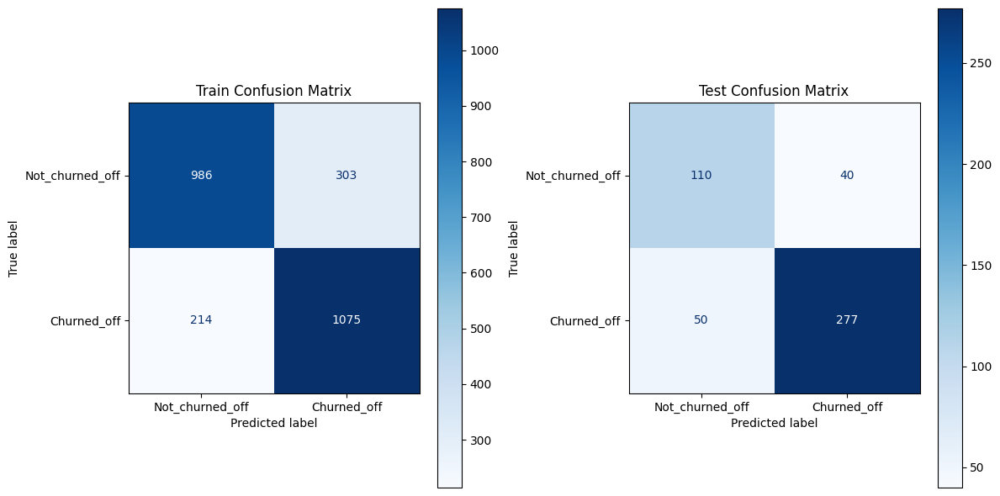

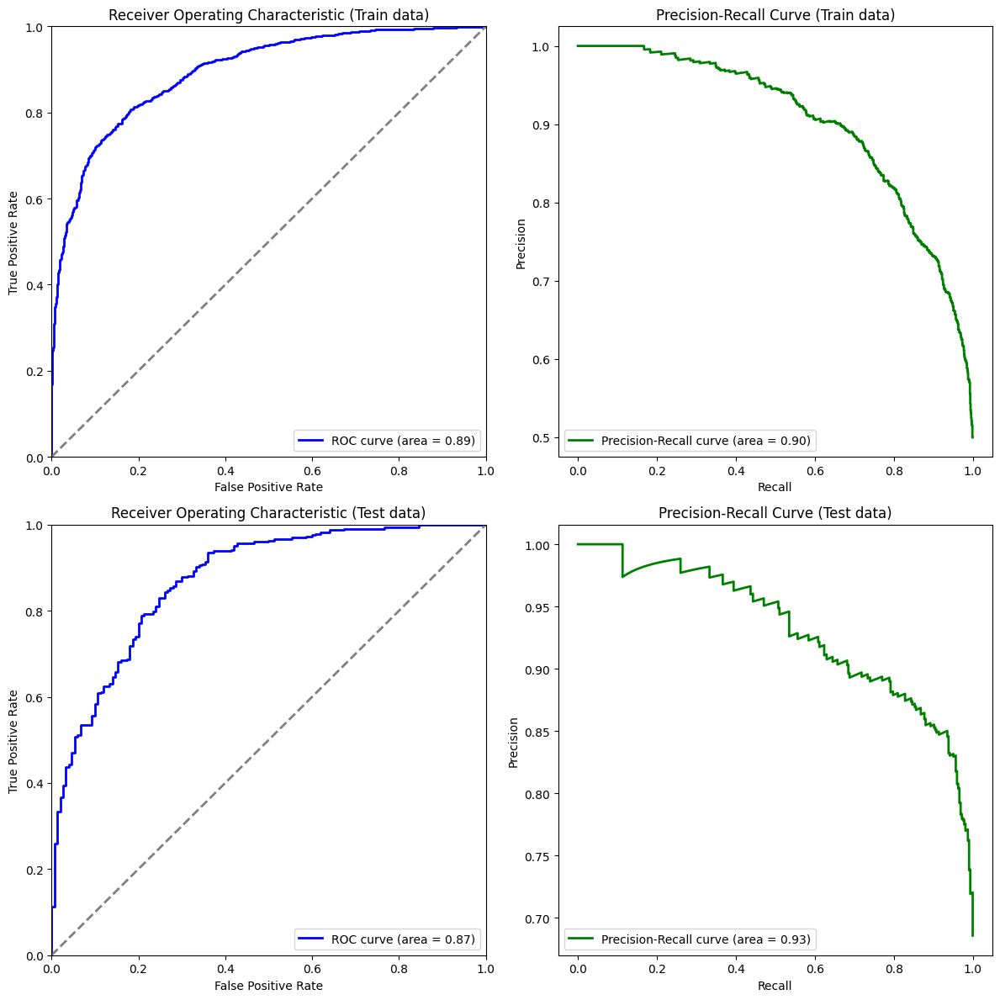

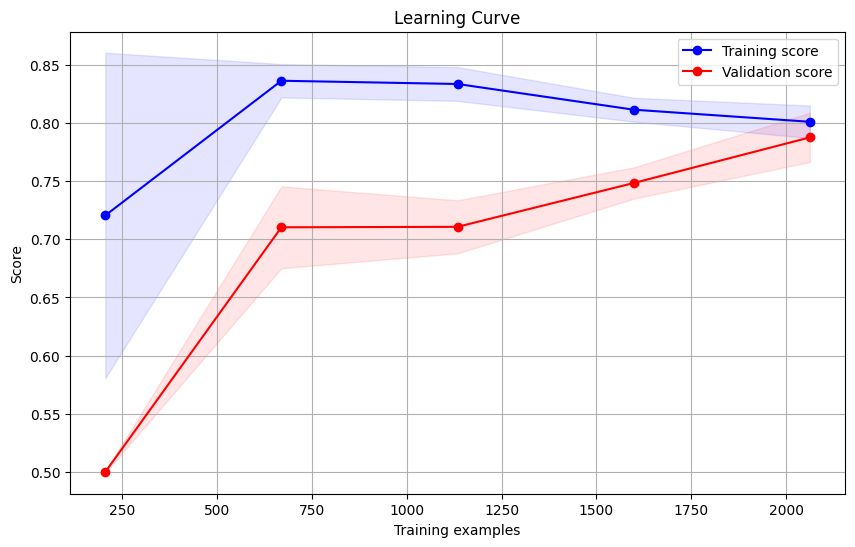

MLFLOW Logging is completed


In [ ]:
# Model details
name ="Tuned_MLPClassifier_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## K NEAREST NEIGHBORS MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'n_neighbors': stats.randint(1, 35),
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'leaf_size': stats.randint(10, 50),
    'p': [1, 2,3,4],  # Manhattan power
    'metric': ['minkowski', 'euclidean', 'manhattan', 'chebyshev']
}

# Initialize the KNN model
knn = KNeighborsClassifier()

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=knn,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time",tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'algorithm': 'kd_tree', 'leaf_size': 28, 'metric': 'manhattan', 'n_neighbors': 11, 'p': 3, 'weights': 'distance'}
Best score: 0.8749896394529632
Tuning_time 9.158213376998901


#### Logging Best K Nearest Neighbor Model into MLFLOW

Model: Tuned_KNN_on_Imbalanced_Dataset
params: {'algorithm': 'kd_tree', 'leaf_size': 28, 'metric': 'manhattan', 'n_neighbors': 11, 'p': 3, 'weights': 'distance'}
Training Time: 0.0064 seconds
Testing Time: 0.1407 seconds
Tuning Time: 9.1582 seconds
Train Metrics:
Accuracy_train: 1.0000
Precision_train: 1.0000
Recall_train: 1.0000
F1_score_train: 1.0000
F2_score_train: 1.0000
Roc_auc_train: 1.0000
Pr_auc_train: 1.0000

Test Metrics:
Accuracy_test: 0.8700
Precision_test: 0.8775
Recall_test: 0.9419
F1_score_test: 0.9086
F2_score_test: 0.9283
Roc_auc_test: 0.9123
Pr_auc_test: 0.9522

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8750

Train Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       615
           1       1.00      1.00      1.00      1289

    accuracy                           1.00      1904
   macro avg       1.00      1.00      1.00      1904
weighted avg       1.00      1.00      1.00      

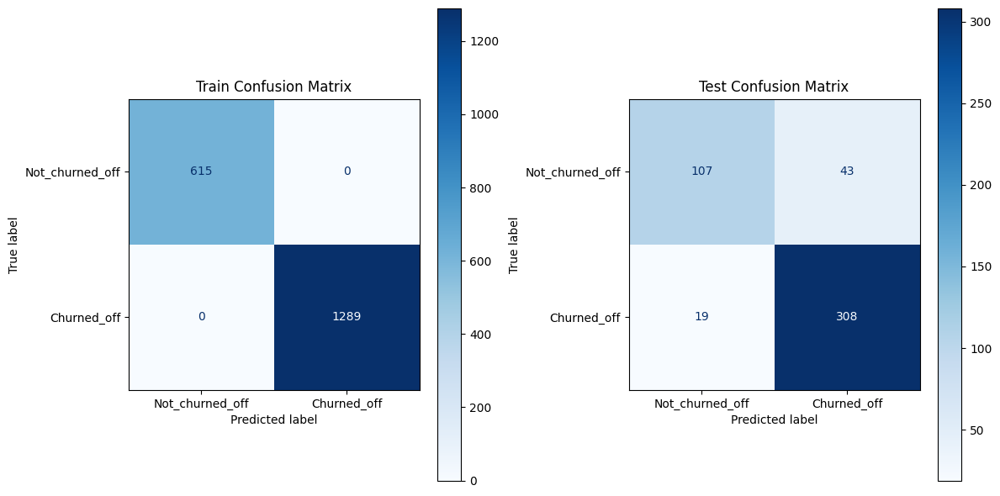

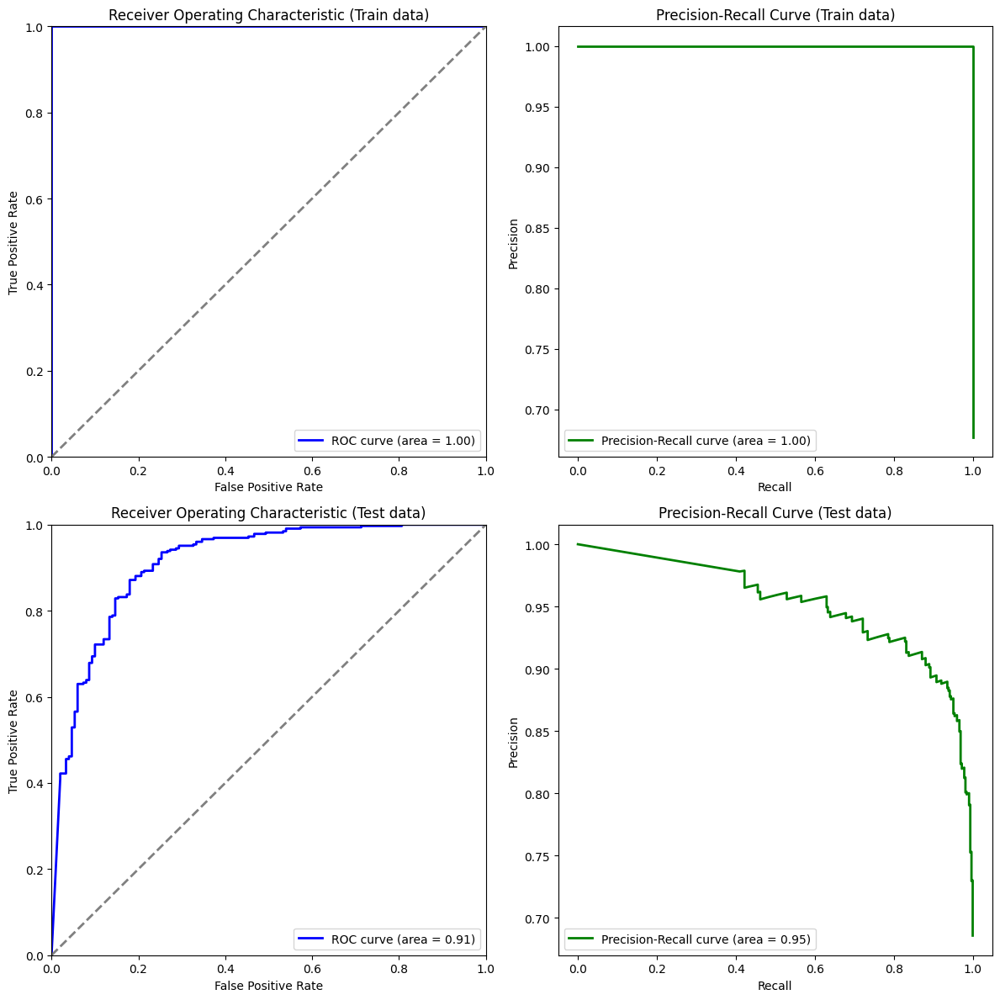

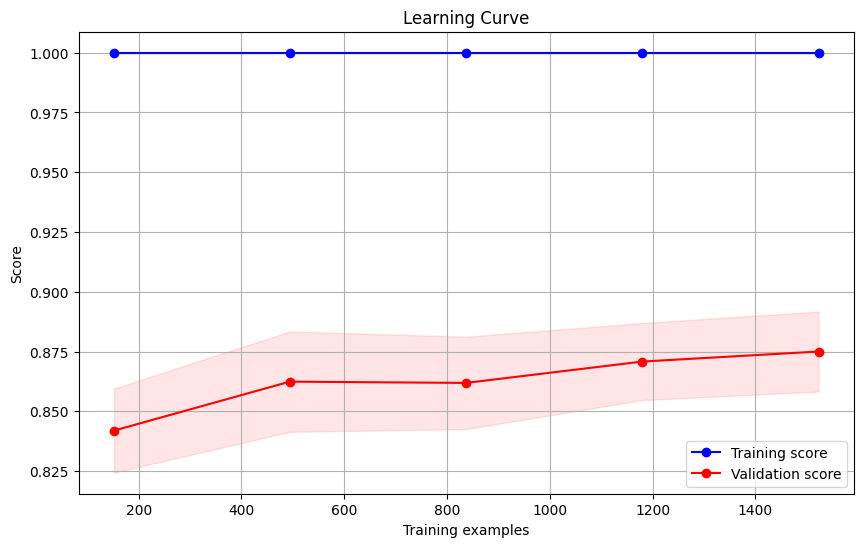

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_KNN_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'n_neighbors': stats.randint(1, 35),
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'leaf_size': stats.randint(10, 50),
    'p': [1, 2,3,4],  # Manhattan power
    'metric': ['minkowski', 'euclidean', 'manhattan', 'chebyshev']
}

# Initialize the KNN model
knn = KNeighborsClassifier()

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=knn,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time",tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'algorithm': 'ball_tree', 'leaf_size': 49, 'metric': 'minkowski', 'n_neighbors': 16, 'p': 1, 'weights': 'distance'}
Best score: 0.8758794310228041
Tuning_time 14.376519441604614


#### Logging Best K Nearest Neighbor Model into MLFLOW

Model: Tuned_KNN_on_Balanced_Dataset
params: {'algorithm': 'ball_tree', 'leaf_size': 49, 'metric': 'minkowski', 'n_neighbors': 16, 'p': 1, 'weights': 'distance'}
Training Time: 0.0061 seconds
Testing Time: 0.1884 seconds
Tuning Time: 14.3765 seconds
Train Metrics:
Accuracy_train: 1.0000
Precision_train: 1.0000
Recall_train: 1.0000
F1_score_train: 1.0000
F2_score_train: 1.0000
Roc_auc_train: 1.0000
Pr_auc_train: 1.0000

Test Metrics:
Accuracy_test: 0.8239
Precision_test: 0.9119
Recall_test: 0.8226
F1_score_test: 0.8650
F2_score_test: 0.8391
Roc_auc_test: 0.8987
Pr_auc_test: 0.9411

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8759

Train Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1289
           1       1.00      1.00      1.00      1289

    accuracy                           1.00      2578
   macro avg       1.00      1.00      1.00      2578
weighted avg       1.00      1.00      1.00     

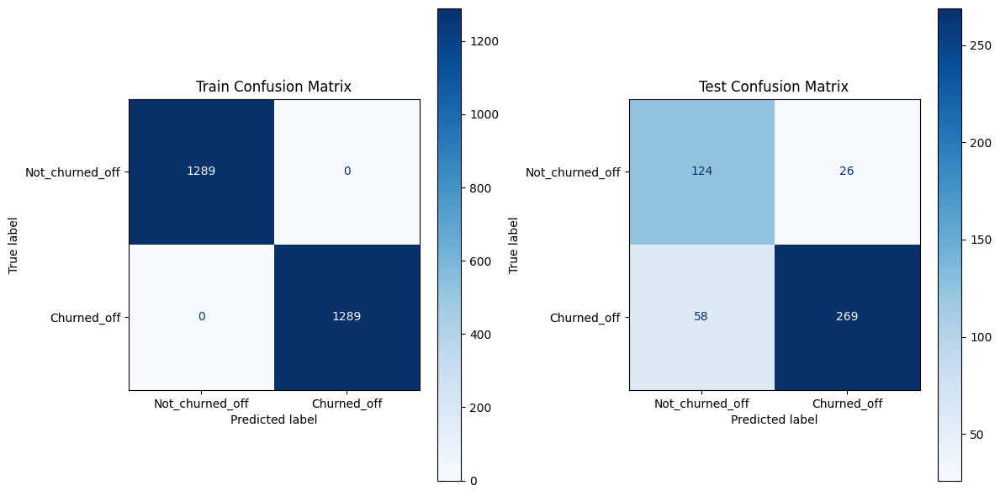

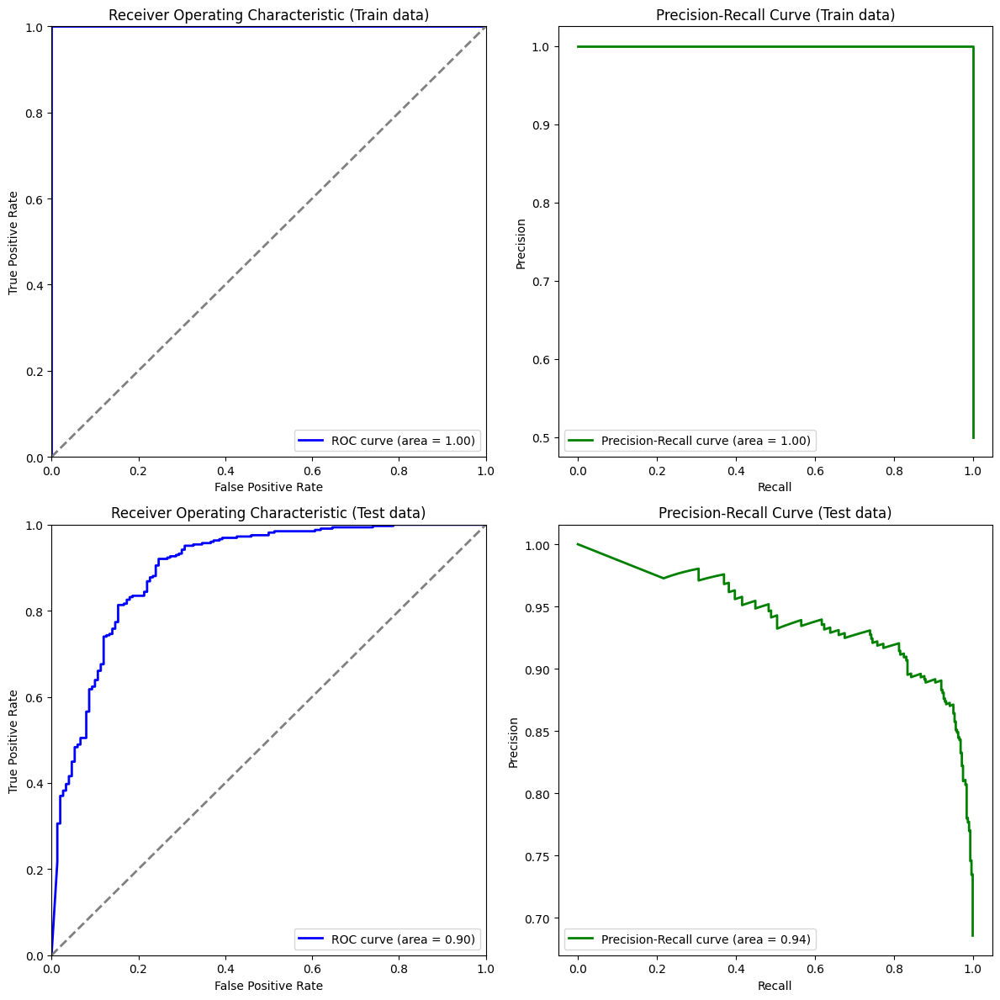

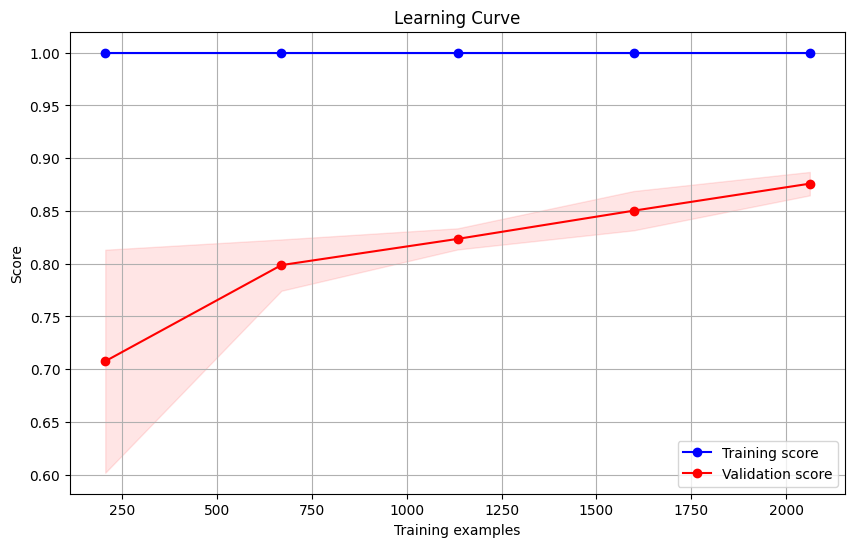

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_KNN_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## SUPPORT VECTOR MACHINE MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'C': stats.expon(scale=100),  # Exponential distribution for C
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'degree': stats.randint(2, 5),  # Degrees for polynomial kernel
    'gamma': ['scale', 'auto'],  # Options for gamma
    'shrinking': [True, False],
    'max_iter': stats.randint(100, 2000),  # Random integers for max_iter
    'random_state': [42]  # Fixed random state for reproducibility
}

# Initialize the SVC model
svc = SVC(class_weight='balanced',probability=True)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=svc,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time",tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'C': 6.436932213118794, 'degree': 4, 'gamma': 'auto', 'kernel': 'rbf', 'max_iter': 1130, 'random_state': 42, 'shrinking': True}
Best score: 0.8839218124050283
Tuning_time 28.28290867805481


#### Logging Best Support Vector Machine Model into MLFLOW

Model: Tuned_SVC_on_Imbalanced_Dataset
params: {'C': 6.436932213118794, 'degree': 4, 'gamma': 'auto', 'kernel': 'rbf', 'max_iter': 1130, 'random_state': 42, 'shrinking': True}
Training Time: 0.3759 seconds
Testing Time: 0.1145 seconds
Tuning Time: 28.2829 seconds
Train Metrics:
Accuracy_train: 0.9338
Precision_train: 0.9716
Recall_train: 0.9294
F1_score_train: 0.9500
F2_score_train: 0.9375
Roc_auc_train: 0.9821
Pr_auc_train: 0.9915

Test Metrics:
Accuracy_test: 0.8847
Precision_test: 0.9331
Recall_test: 0.8960
F1_score_test: 0.9142
F2_score_test: 0.9032
Roc_auc_test: 0.9455
Pr_auc_test: 0.9708

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8839

Train Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.94      0.90       615
           1       0.97      0.93      0.95      1289

    accuracy                           0.93      1904
   macro avg       0.92      0.94      0.93      1904
weighted avg       0.94      0.93 

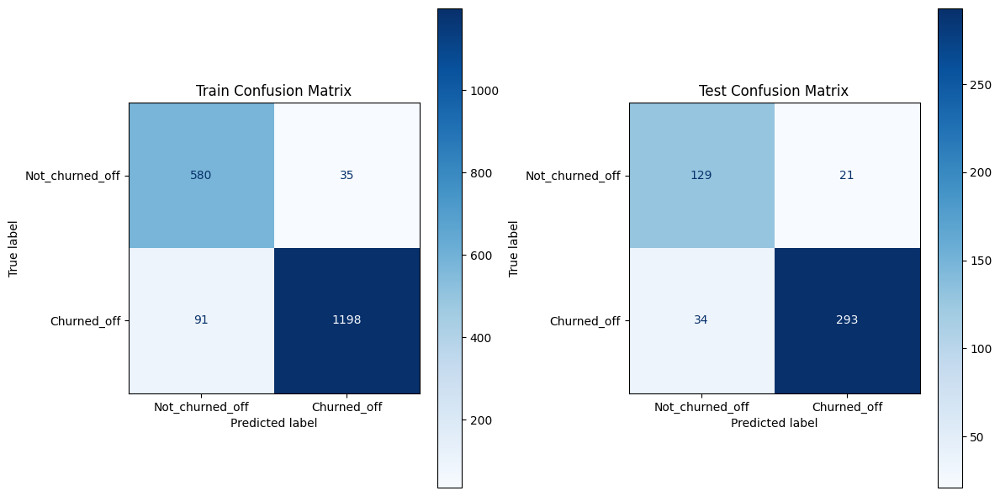

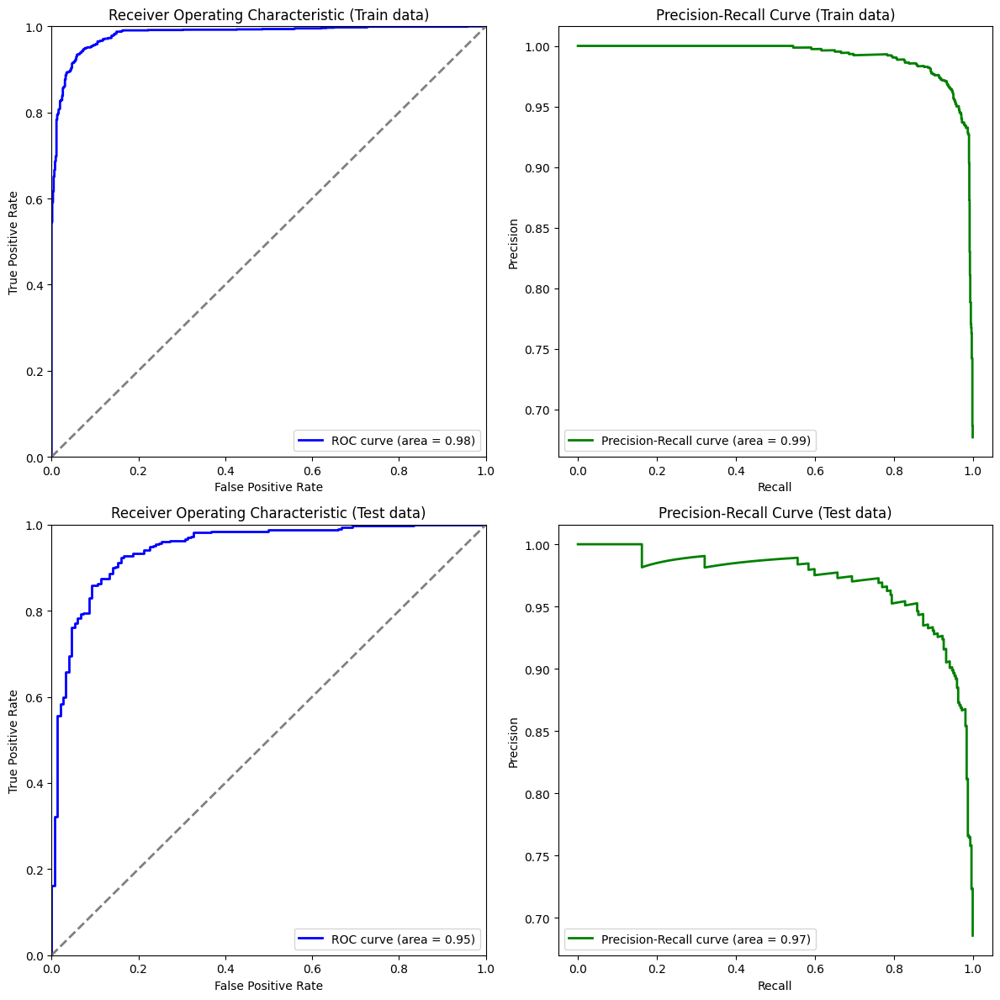

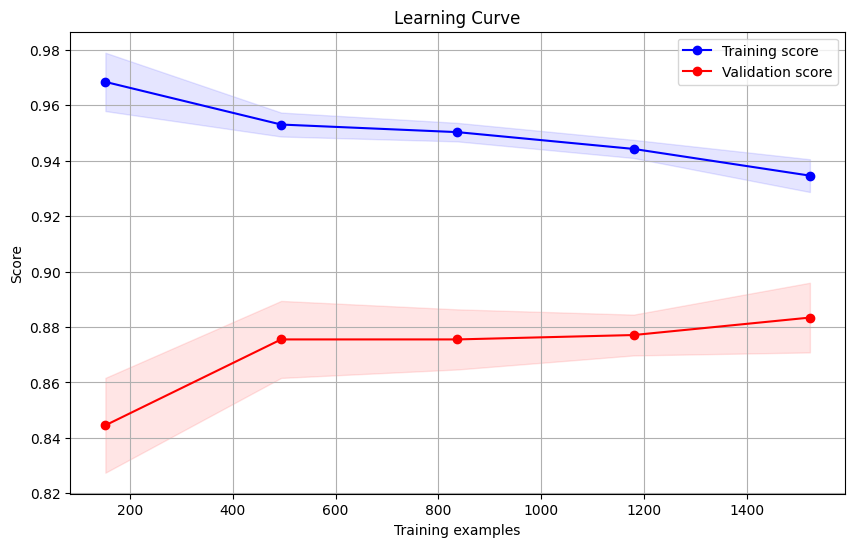

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_SVC_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'C': stats.expon(scale=100),  # Exponential distribution for C
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'degree': stats.randint(2, 5),  # Degrees for polynomial kernel
    'gamma': ['scale', 'auto'],  # Options for gamma
    'shrinking': [True, False],
    'max_iter': stats.randint(100, 2000),  # Random integers for max_iter
    'random_state': [42]  # Fixed random state for reproducibility
}

# Initialize the SVC model
svc = SVC(class_weight='balanced',probability=True)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=svc,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time",tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'C': 81.5862458136845, 'degree': 2, 'gamma': 'auto', 'kernel': 'rbf', 'max_iter': 1677, 'random_state': 42, 'shrinking': True}
Best score: 0.8976096936855573
Tuning_time 48.674527645111084


#### Logging Best Support Vector Machine Model into MLFLOW

Model: Tuned_SVC_on_Balanced_Dataset
params: {'C': 81.5862458136845, 'degree': 2, 'gamma': 'auto', 'kernel': 'rbf', 'max_iter': 1677, 'random_state': 42, 'shrinking': True}
Training Time: 0.6545 seconds
Testing Time: 0.1660 seconds
Tuning Time: 48.6745 seconds
Train Metrics:
Accuracy_train: 0.9728
Precision_train: 0.9765
Recall_train: 0.9690
F1_score_train: 0.9727
F2_score_train: 0.9705
Roc_auc_train: 0.9929
Pr_auc_train: 0.9941

Test Metrics:
Accuracy_test: 0.8365
Precision_test: 0.8854
Recall_test: 0.8746
F1_score_test: 0.8800
F2_score_test: 0.8768
Roc_auc_test: 0.9112
Pr_auc_test: 0.9591

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8976

Train Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      1289
           1       0.98      0.97      0.97      1289

    accuracy                           0.97      2578
   macro avg       0.97      0.97      0.97      2578
weighted avg       0.97      0.97    

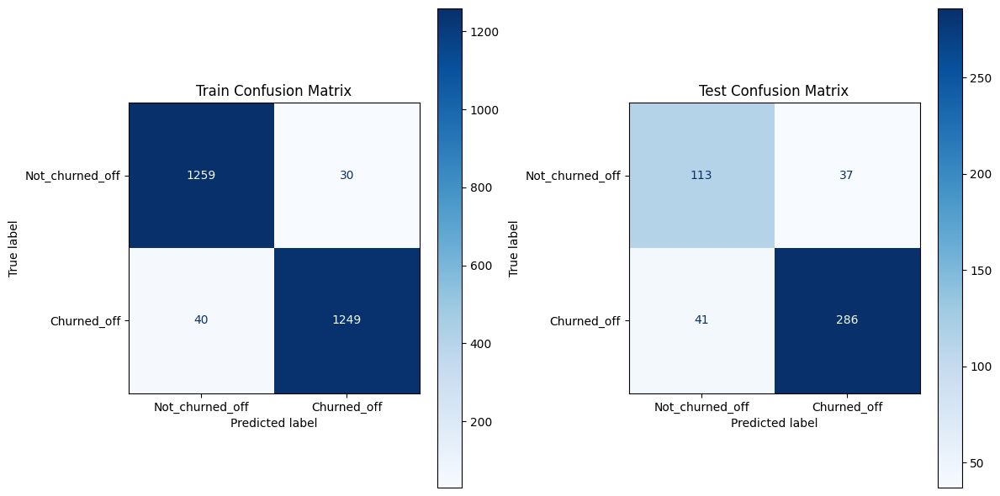

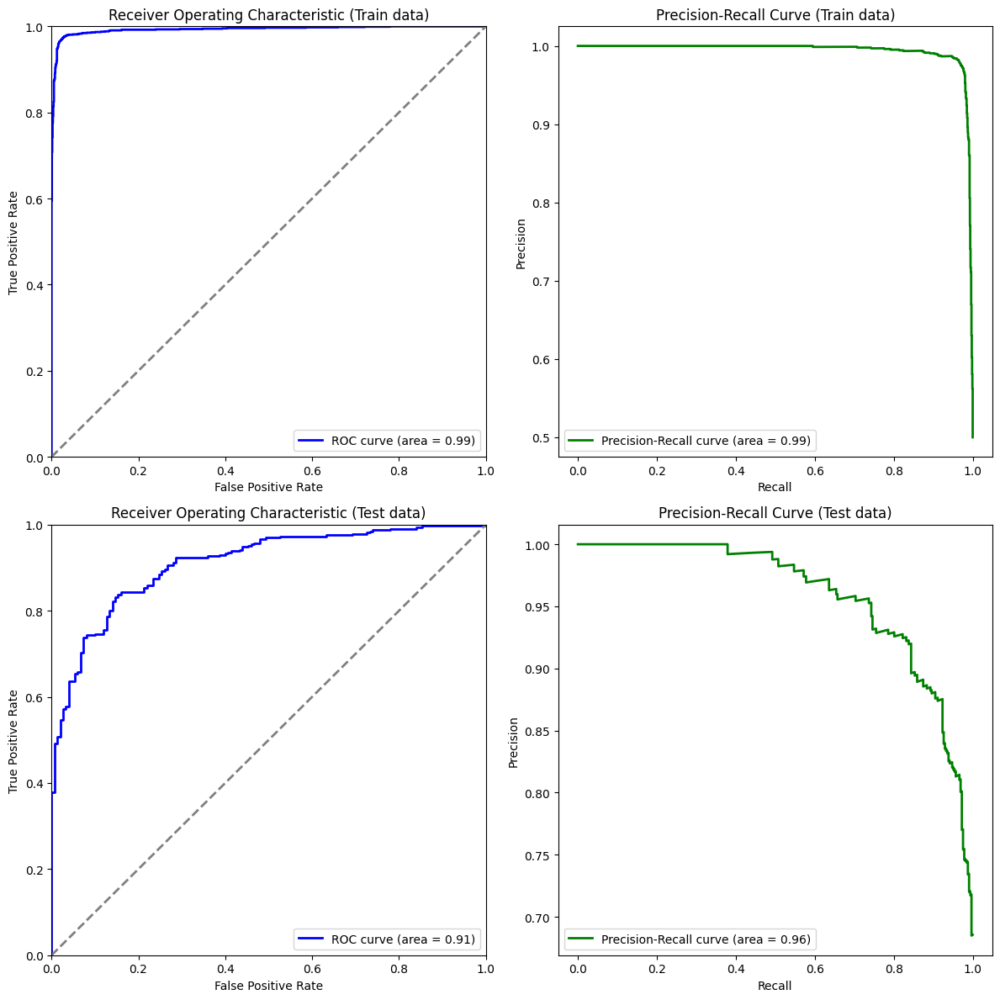

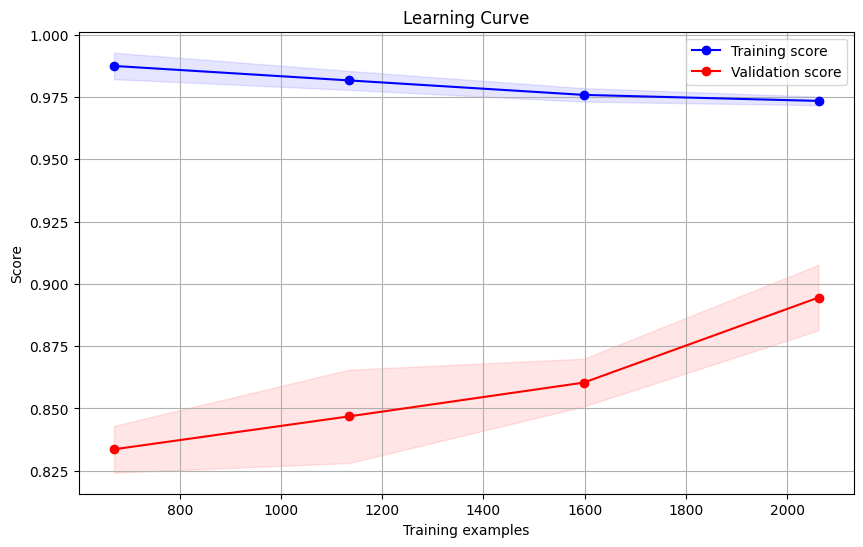

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_SVC_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## DECISION TREE MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'splitter': ['best', 'random'],
    'max_depth': stats.randint(2, 20),  # Random integers for max_depth
    'min_samples_split': stats.randint(2, 20),  # Random integers for min_samples_split
    'min_samples_leaf': stats.randint(1, 20),  # Random integers for min_samples_leaf
    'min_weight_fraction_leaf': stats.uniform(0.0, 0.5),  # Uniform distribution for min_weight_fraction_leaf
    'max_features': [None, 'auto', 'sqrt', 'log2'],  # Options for max_features
    'max_leaf_nodes': stats.randint(2, 100),  # Random integers for max_leaf_nodes
    'min_impurity_decrease': stats.uniform(0.0, 0.1),  # Uniform distribution for min_impurity_decrease
    'ccp_alpha': stats.uniform(0.0, 0.1),  # Uniform distribution for ccp_alpha
    'random_state': [42]  # Fixed random state for reproducibility
}

# Initialize the Decision Tree classifier
dtc = DecisionTreeClassifier()

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=dtc,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time", tuning_time)


Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'ccp_alpha': 0.01504168911035282, 'criterion': 'gini', 'max_depth': 18, 'max_features': None, 'max_leaf_nodes': 34, 'min_impurity_decrease': 0.046869315979497034, 'min_samples_leaf': 3, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0068359824134986424, 'random_state': 42, 'splitter': 'best'}
Best score: 0.8340267992816687
Tuning_time 1.4809610843658447


#### Logging Best Decision Tree Model into MLFLOW

Model: Tuned_Decision_Tree_on_Imbalanced_Dataset
params: {'ccp_alpha': 0.01504168911035282, 'criterion': 'gini', 'max_depth': 18, 'max_features': None, 'max_leaf_nodes': 34, 'min_impurity_decrease': 0.046869315979497034, 'min_samples_leaf': 3, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0068359824134986424, 'random_state': 42, 'splitter': 'best'}
Training Time: 0.0095 seconds
Testing Time: 0.0020 seconds
Tuning Time: 1.4810 seconds
Train Metrics:
Accuracy_train: 0.8451
Precision_train: 0.8596
Recall_train: 0.9216
F1_score_train: 0.8896
F2_score_train: 0.9085
Roc_auc_train: 0.8062
Pr_auc_train: 0.9177

Test Metrics:
Accuracy_test: 0.8658
Precision_test: 0.8663
Recall_test: 0.9511
F1_score_test: 0.9067
F2_score_test: 0.9328
Roc_auc_test: 0.8184
Pr_auc_test: 0.9261

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8340

Train Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.68      0.74       615
           1   

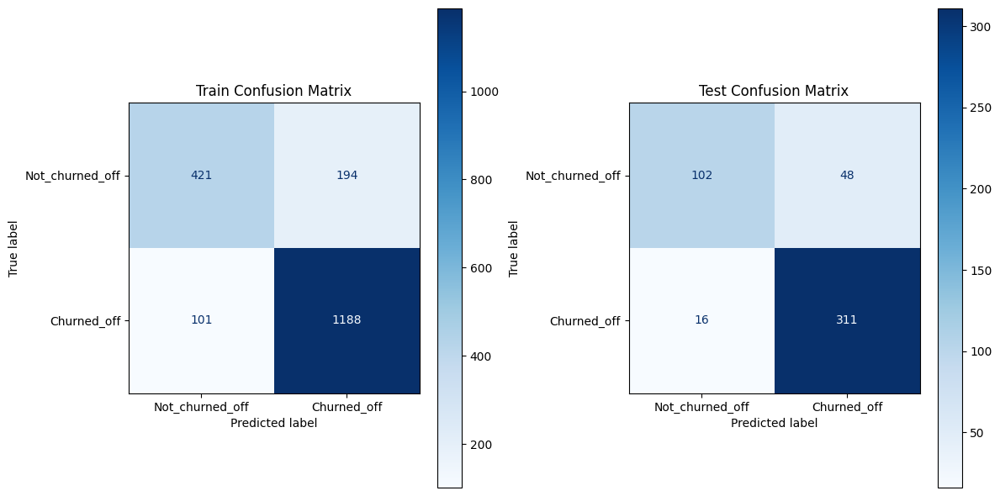

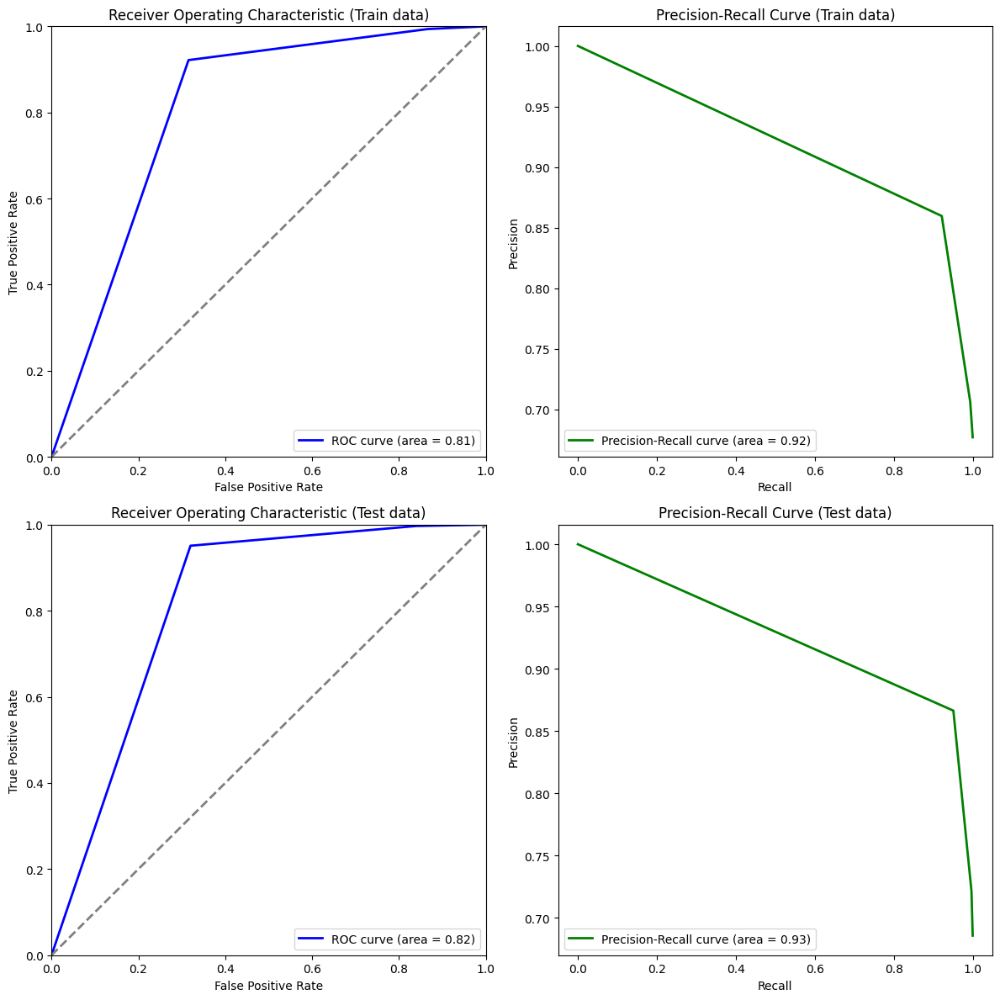

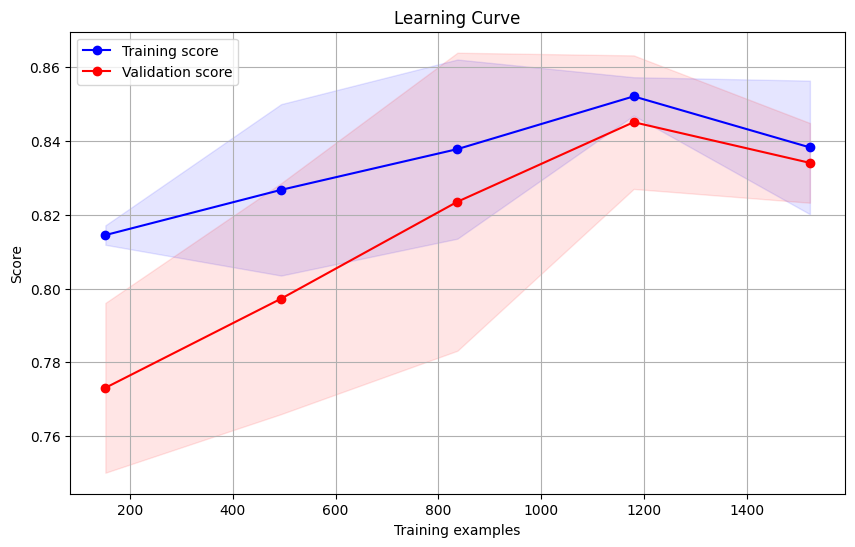

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Decision_Tree_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'splitter': ['best', 'random'],
    'max_depth': stats.randint(2, 20),  # Random integers for max_depth
    'min_samples_split': stats.randint(2, 20),  # Random integers for min_samples_split
    'min_samples_leaf': stats.randint(1, 20),  # Random integers for min_samples_leaf
    'min_weight_fraction_leaf': stats.uniform(0.0, 0.5),  # Uniform distribution for min_weight_fraction_leaf
    'max_features': [None, 'auto', 'sqrt', 'log2'],  # Options for max_features
    'max_leaf_nodes': stats.randint(2, 100),  # Random integers for max_leaf_nodes
    'min_impurity_decrease': stats.uniform(0.0, 0.1),  # Uniform distribution for min_impurity_decrease
    'ccp_alpha': stats.uniform(0.0, 0.1),  # Uniform distribution for ccp_alpha
    'random_state': [42]  # Fixed random state for reproducibility
}

# Initialize the Decision Tree classifier
dtc = DecisionTreeClassifier()

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=dtc,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time", tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'ccp_alpha': 0.011483682473920355, 'criterion': 'entropy', 'max_depth': 15, 'max_features': 'log2', 'max_leaf_nodes': 39, 'min_impurity_decrease': 0.05812382214226123, 'min_samples_leaf': 11, 'min_samples_split': 5, 'min_weight_fraction_leaf': 0.16032109607975714, 'random_state': 42, 'splitter': 'best'}
Best score: 0.8153653947467449
Tuning_time 1.478015422821045


#### Logging Best Decision Tree Model into MLFLOW

Model: Tuned_Decision_Tree_on_Balanced_Dataset
params: {'ccp_alpha': 0.011483682473920355, 'criterion': 'entropy', 'max_depth': 15, 'max_features': 'log2', 'max_leaf_nodes': 39, 'min_impurity_decrease': 0.05812382214226123, 'min_samples_leaf': 11, 'min_samples_split': 5, 'min_weight_fraction_leaf': 0.16032109607975714, 'random_state': 42, 'splitter': 'best'}
Training Time: 0.0068 seconds
Testing Time: 0.0016 seconds
Tuning Time: 1.4780 seconds
Train Metrics:
Accuracy_train: 0.8169
Precision_train: 0.9397
Recall_train: 0.6773
F1_score_train: 0.7872
F2_score_train: 0.7173
Roc_auc_train: 0.8781
Pr_auc_train: 0.9027

Test Metrics:
Accuracy_test: 0.7505
Precision_test: 0.9561
Recall_test: 0.6667
F1_score_test: 0.7856
F2_score_test: 0.7096
Roc_auc_test: 0.8654
Pr_auc_test: 0.9402

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8154

Train Classification Report:
              precision    recall  f1-score   support

           0       0.75      0.96      0.84      1289
           1 

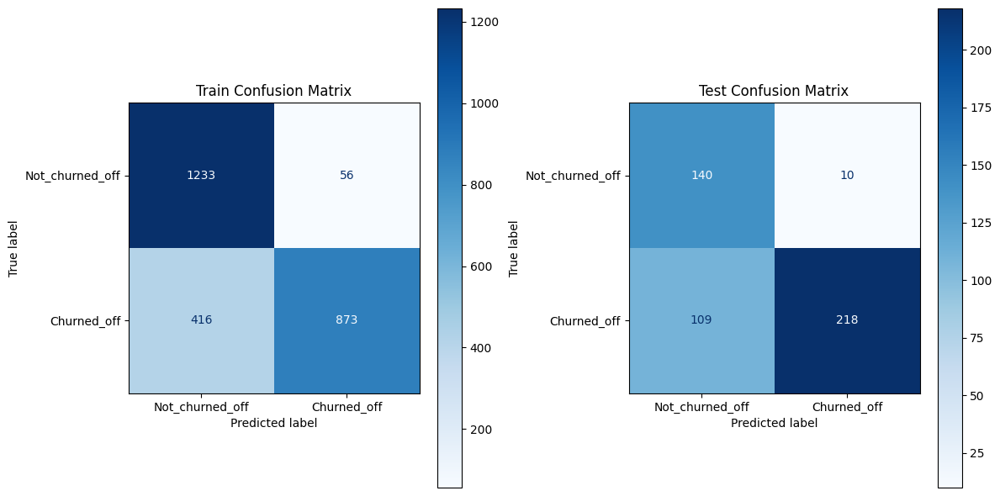

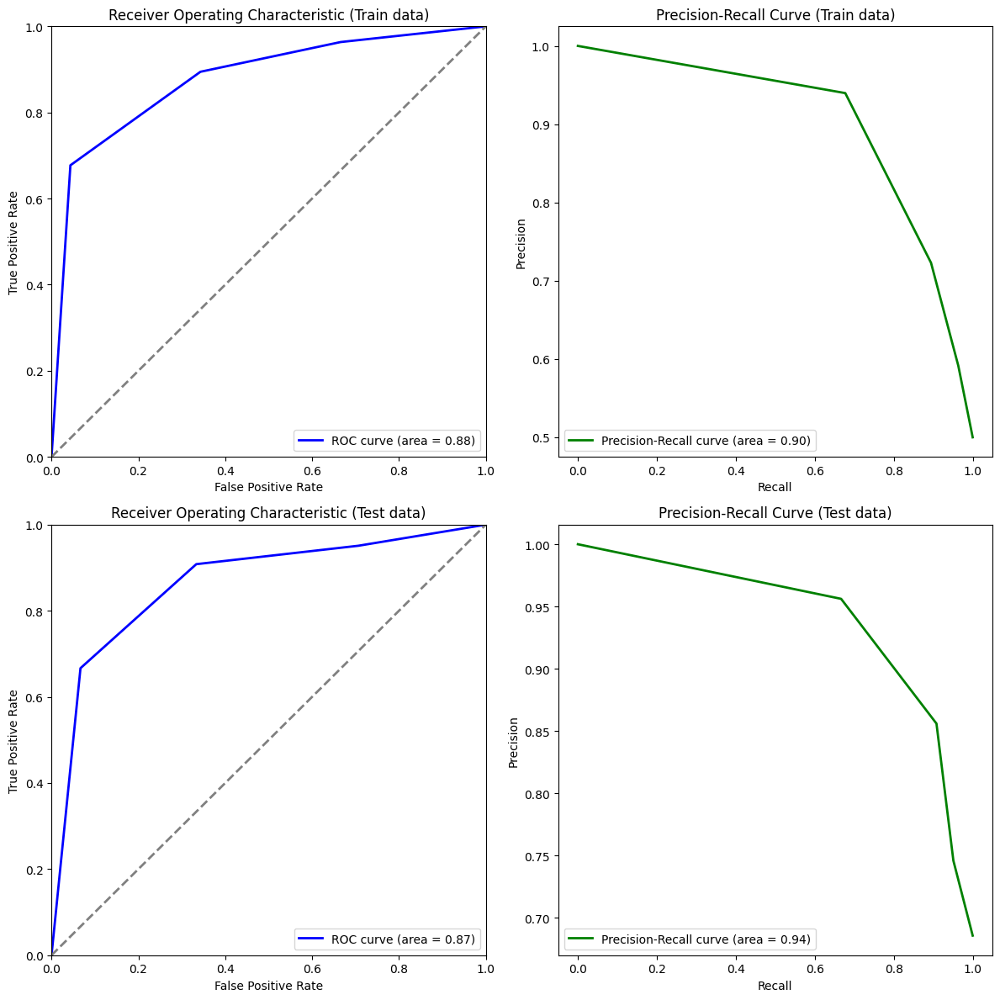

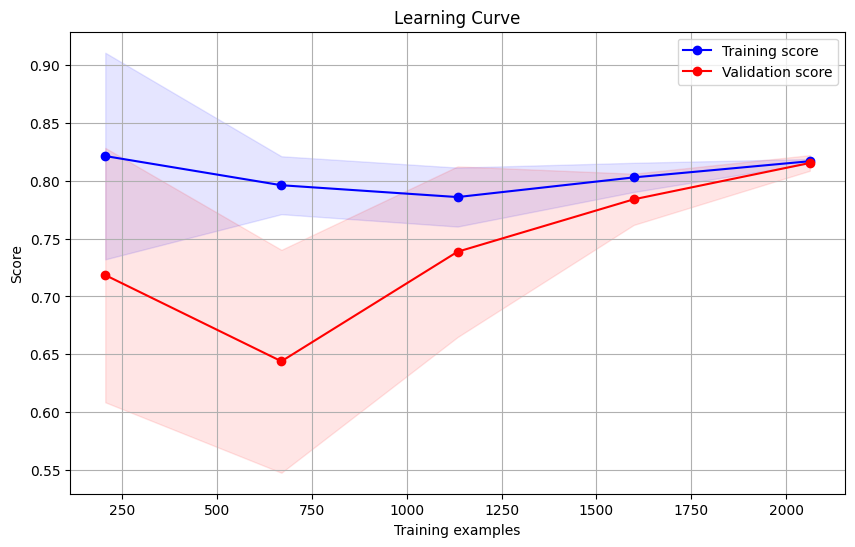

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Decision_Tree_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## RANDOM FOREST MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'n_estimators': stats.randint(50, 1000),  # Random integers for n_estimators
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': stats.randint(2, 20),  # Random integers for max_depth
    'min_samples_split': stats.randint(2, 20),  # Random integers for min_samples_split
    'min_samples_leaf': stats.randint(1, 20),  # Random integers for min_samples_leaf
    'min_weight_fraction_leaf': stats.uniform(0.0, 0.5),  # Uniform distribution for min_weight_fraction_leaf
    'max_features': ['auto', 'sqrt', 'log2', None],  # Options for max_features
    'max_leaf_nodes': stats.randint(2, 100),  # Random integers for max_leaf_nodes
    'min_impurity_decrease': stats.uniform(0.0, 0.1),  # Uniform distribution for min_impurity_decrease
    'bootstrap': [True, False],  # Whether bootstrap samples are used when building trees
    'oob_score': [True, False],  # Whether to use out-of-bag samples to estimate the generalization accuracy
    'ccp_alpha': stats.uniform(0.0, 0.1),  # Uniform distribution for ccp_alpha
    'random_state': [42]  # Fixed random state for reproducibility
}

# Initialize the RandomForest classifier
rfc = RandomForestClassifier(class_weight="balanced")

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=rfc,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time", tuning_time)


Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'bootstrap': True, 'ccp_alpha': 0.028792961647572612, 'criterion': 'log_loss', 'max_depth': 13, 'max_features': 'sqrt', 'max_leaf_nodes': 14, 'min_impurity_decrease': 0.013911619414306187, 'min_samples_leaf': 18, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.009055091910420254, 'n_estimators': 877, 'oob_score': True, 'random_state': 42}
Best score: 0.8833954966155545
Tuning_time 191.6145143508911


In [ ]:
rfc_imb = random_search.best_estimator_

#### Logging Best Random Forest Model into MLFLOW

Model: Tuned_Random_Forest_on_Imbalanced_Dataset
params: {'bootstrap': True, 'ccp_alpha': 0.028792961647572612, 'criterion': 'log_loss', 'max_depth': 13, 'max_features': 'sqrt', 'max_leaf_nodes': 14, 'min_impurity_decrease': 0.013911619414306187, 'min_samples_leaf': 18, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.009055091910420254, 'n_estimators': 877, 'oob_score': True, 'random_state': 42}
Training Time: 3.7044 seconds
Testing Time: 0.2037 seconds
Tuning Time: 191.6145 seconds
Train Metrics:
Accuracy_train: 0.8929
Precision_train: 0.9242
Recall_train: 0.9170
F1_score_train: 0.9206
F2_score_train: 0.9184
Roc_auc_train: 0.9484
Pr_auc_train: 0.9735

Test Metrics:
Accuracy_test: 0.8847
Precision_test: 0.9224
Recall_test: 0.9083
F1_score_test: 0.9153
F2_score_test: 0.9110
Roc_auc_test: 0.9424
Pr_auc_test: 0.9683

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8834

Train Classification Report:
              precision    recall  f1-score   support

           0       0.

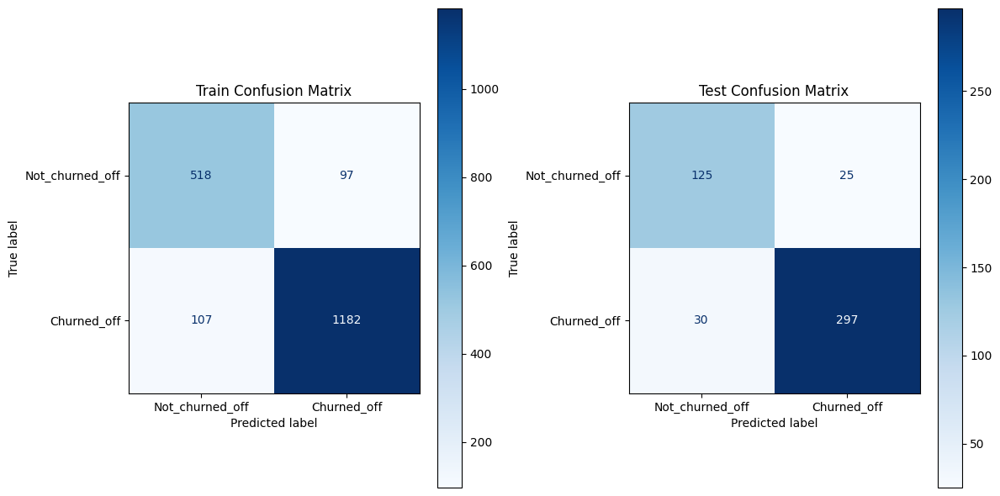

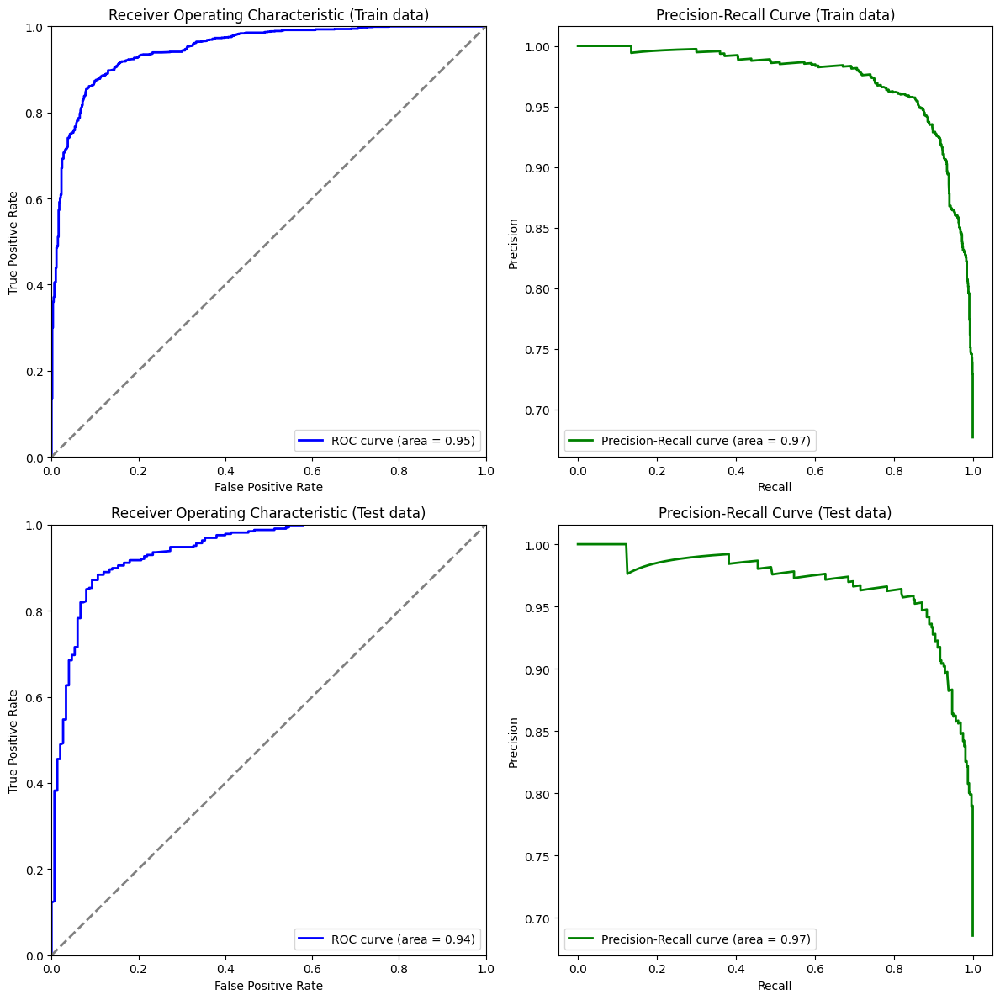

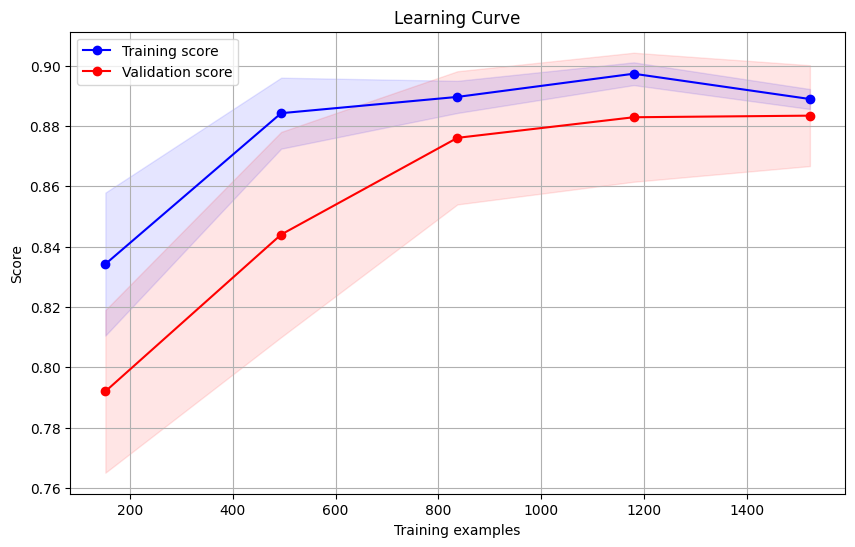

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Random_Forest_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'n_estimators': stats.randint(50, 1000),  # Random integers for n_estimators
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': stats.randint(2, 20),  # Random integers for max_depth
    'min_samples_split': stats.randint(2, 20),  # Random integers for min_samples_split
    'min_samples_leaf': stats.randint(1, 20),  # Random integers for min_samples_leaf
    'min_weight_fraction_leaf': stats.uniform(0.0, 0.5),  # Uniform distribution for min_weight_fraction_leaf
    'max_features': ['auto', 'sqrt', 'log2', None],  # Options for max_features
    'max_leaf_nodes': stats.randint(2, 100),  # Random integers for max_leaf_nodes
    'min_impurity_decrease': stats.uniform(0.0, 0.1),  # Uniform distribution for min_impurity_decrease
    'bootstrap': [True, False],  # Whether bootstrap samples are used when building trees
    'oob_score': [True, False],  # Whether to use out-of-bag samples to estimate the generalization accuracy
    'ccp_alpha': stats.uniform(0.0, 0.1),  # Uniform distribution for ccp_alpha
    'random_state': [42]  # Fixed random state for reproducibility
}

# Initialize the RandomForest classifier
rfc = RandomForestClassifier(class_weight="balanced")

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=rfc,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time", tuning_time)


Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'bootstrap': True, 'ccp_alpha': 0.028792961647572612, 'criterion': 'log_loss', 'max_depth': 13, 'max_features': 'sqrt', 'max_leaf_nodes': 14, 'min_impurity_decrease': 0.013911619414306187, 'min_samples_leaf': 18, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.009055091910420254, 'n_estimators': 877, 'oob_score': True, 'random_state': 42}
Best score: 0.852979604124332
Tuning_time 209.51067566871643


In [ ]:
rfc_bal = random_search.best_estimator_

#### Logging Best Random Forest Model into MLFLOW

Model: Tuned_Random_Forest_on_Balanced_Dataset
params: {'bootstrap': True, 'ccp_alpha': 0.028792961647572612, 'criterion': 'log_loss', 'max_depth': 13, 'max_features': 'sqrt', 'max_leaf_nodes': 14, 'min_impurity_decrease': 0.013911619414306187, 'min_samples_leaf': 18, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.009055091910420254, 'n_estimators': 877, 'oob_score': True, 'random_state': 42}
Training Time: 4.0574 seconds
Testing Time: 0.2175 seconds
Tuning Time: 209.5107 seconds
Train Metrics:
Accuracy_train: 0.8638
Precision_train: 0.8271
Recall_train: 0.9201
F1_score_train: 0.8711
F2_score_train: 0.8998
Roc_auc_train: 0.9412
Pr_auc_train: 0.9453

Test Metrics:
Accuracy_test: 0.8805
Precision_test: 0.9141
Recall_test: 0.9113
F1_score_test: 0.9127
F2_score_test: 0.9119
Roc_auc_test: 0.9335
Pr_auc_test: 0.9653

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8530

Train Classification Report:
              precision    recall  f1-score   support

           0       0.91

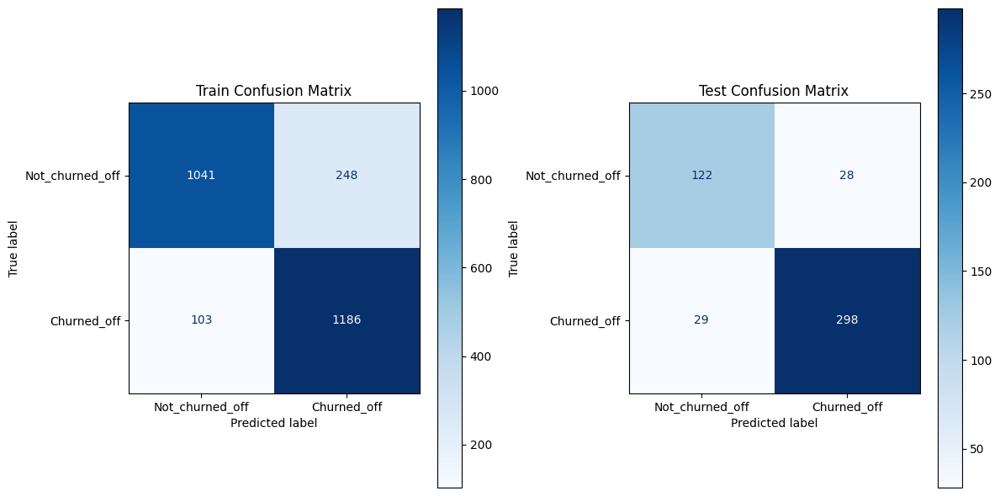

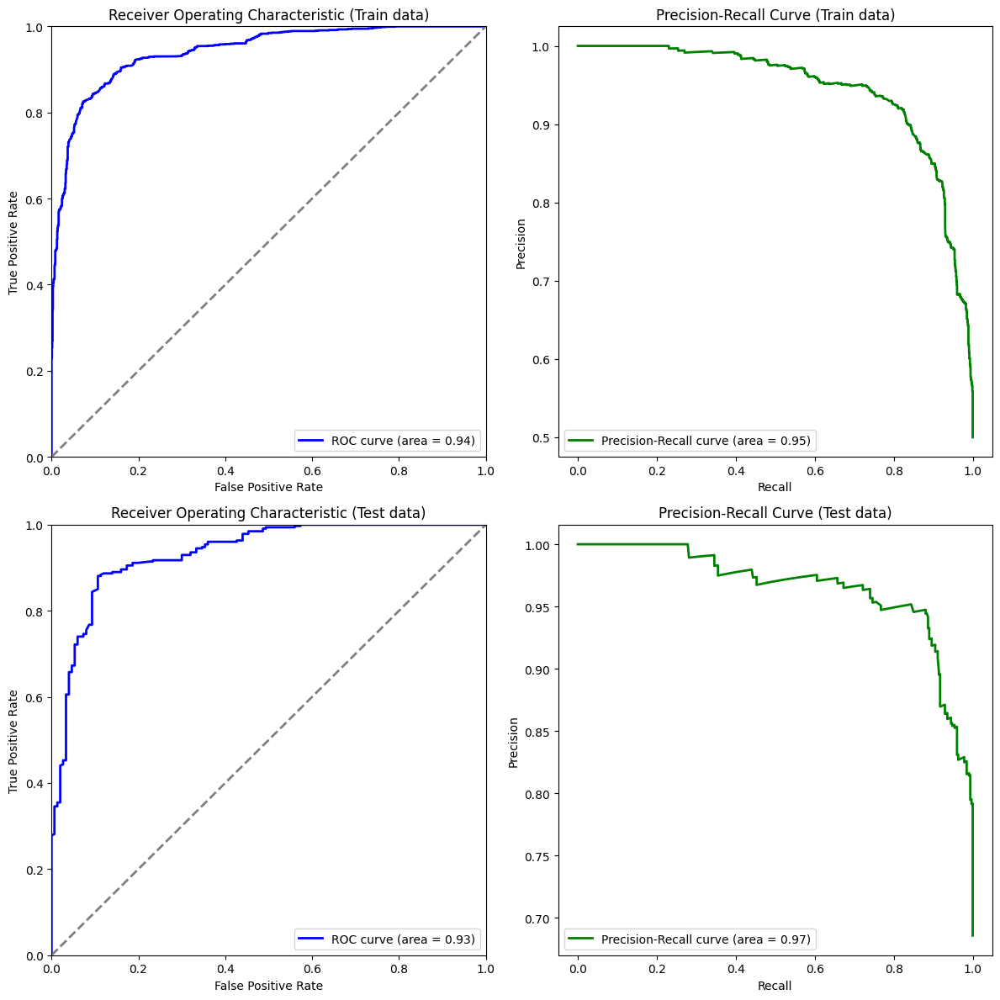

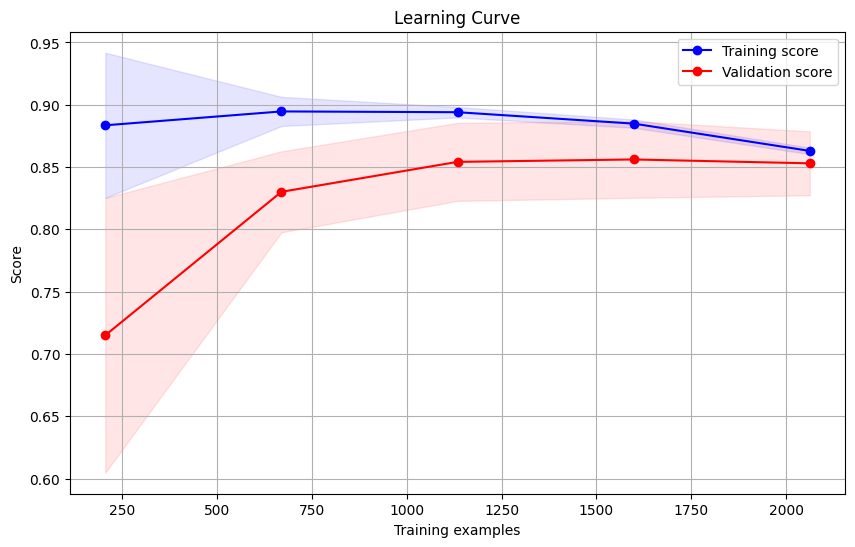

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Random_Forest_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## BAGGING CLASSIFIER ON BEST_RF MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
rfc_imb

RandomForestClassifier(ccp_alpha=0.028792961647572612, class_weight='balanced',
                       criterion='log_loss', max_depth=13, max_leaf_nodes=14,
                       min_impurity_decrease=0.013911619414306187,
                       min_samples_leaf=18,
                       min_weight_fraction_leaf=0.009055091910420254,
                       n_estimators=877, oob_score=True, random_state=42)

In [ ]:
# Base RandomForest model with the provided parameters
base_rf = RandomForestClassifier(class_weight='balanced',criterion='log_loss', max_depth=20, max_leaf_nodes=20,
                       n_estimators=5, oob_score=True, random_state=42)

# Define the parameter grid for Bagging
start_tune_time = time.time()
param_dist = {
    'n_estimators': stats.randint(10, 500),  # Number of base estimators in the ensemble
    'max_samples': stats.uniform(0.1, 1.0),  # Fraction of samples to draw from X to train each base estimator
    'max_features': stats.uniform(0.1, 1.0),  # Fraction of features to draw from X to train each base estimator
    'bootstrap': [True, False],  # Whether samples are drawn with replacement
    'bootstrap_features': [True, False],  # Whether features are drawn with replacement
    'random_state': [42]  # Fixed random state for reproducibility
}

# Initialize the Bagging classifier with the RandomForest as the base estimator
bagging_clf = BaggingClassifier(estimator=base_rf,n_jobs=-1)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=bagging_clf,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=5,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time", tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'bootstrap': False, 'bootstrap_features': False, 'max_features': 0.9631385219890038, 'max_samples': 0.9803599686384168, 'n_estimators': 154, 'random_state': 42}
Best score: 0.9043983975687249
Tuning_time 860.3156924247742


#### Logging Best Bagging RF Model into MLFLOW

Model: Tuned_Bagging_RF_on_Imbalanced_Dataset
params: {'bootstrap': False, 'bootstrap_features': False, 'max_features': 0.9631385219890038, 'max_samples': 0.9803599686384168, 'n_estimators': 154, 'random_state': 42}
Training Time: 0.8501 seconds
Testing Time: 0.4739 seconds
Tuning Time: 860.3157 seconds
Train Metrics:
Accuracy_train: 0.9181
Precision_train: 0.9381
Recall_train: 0.9410
F1_score_train: 0.9396
F2_score_train: 0.9405
Roc_auc_train: 0.9724
Pr_auc_train: 0.9863

Test Metrics:
Accuracy_test: 0.9078
Precision_test: 0.9224
Recall_test: 0.9450
F1_score_test: 0.9335
F2_score_test: 0.9404
Roc_auc_test: 0.9518
Pr_auc_test: 0.9716

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.9044

Train Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.87      0.87       615
           1       0.94      0.94      0.94      1289

    accuracy                           0.92      1904
   macro avg       0.91      0.91      0.91    

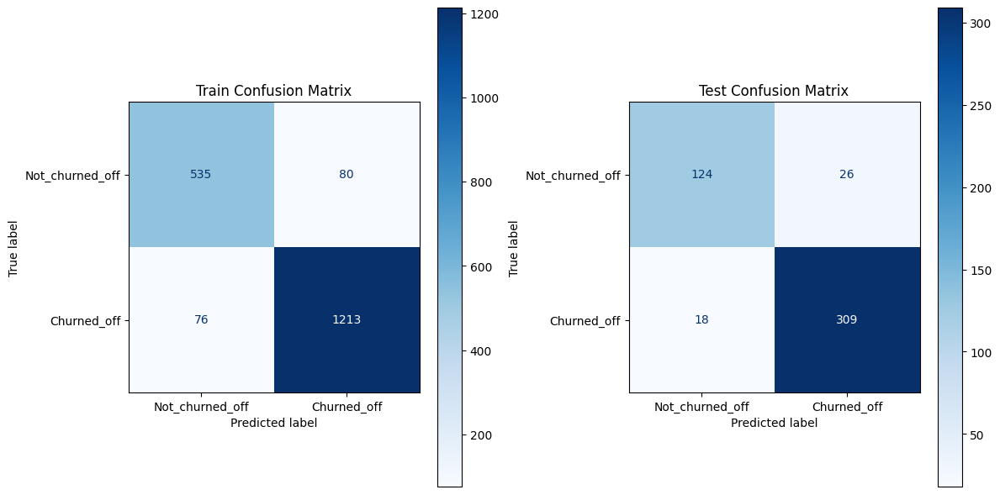

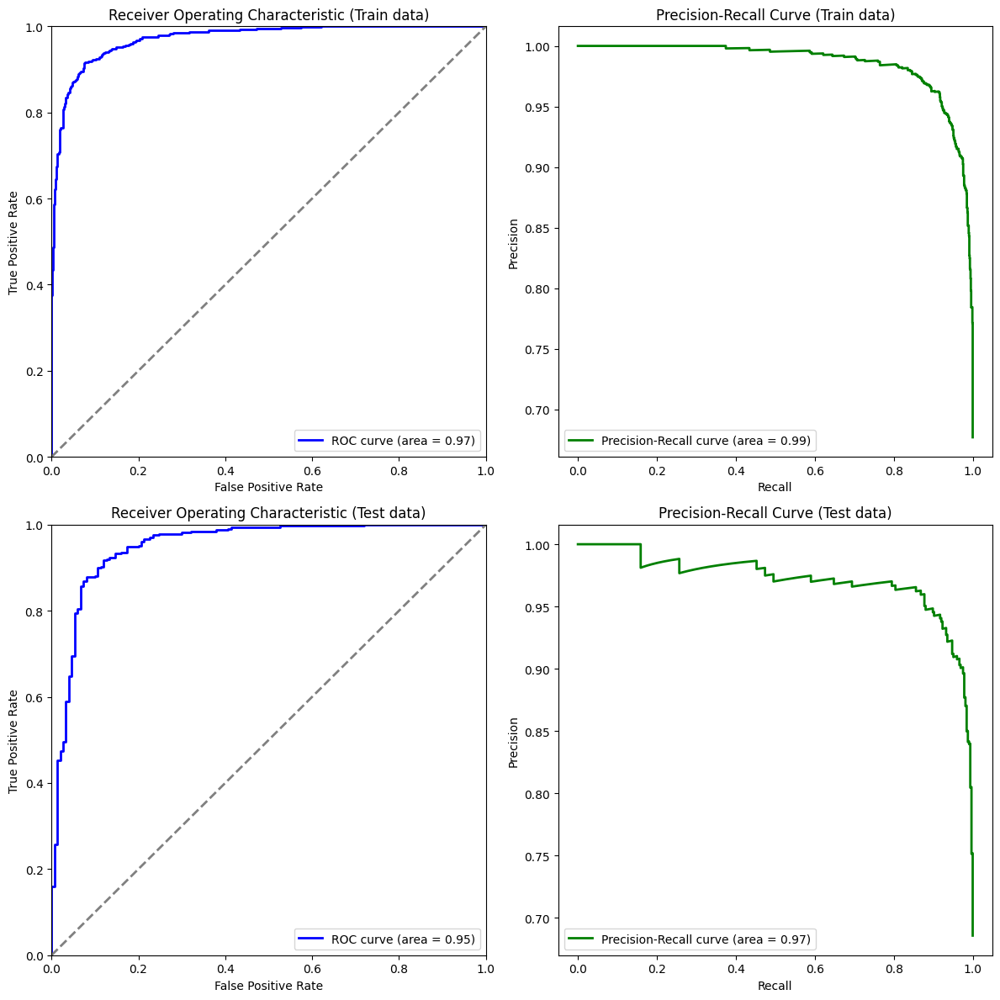

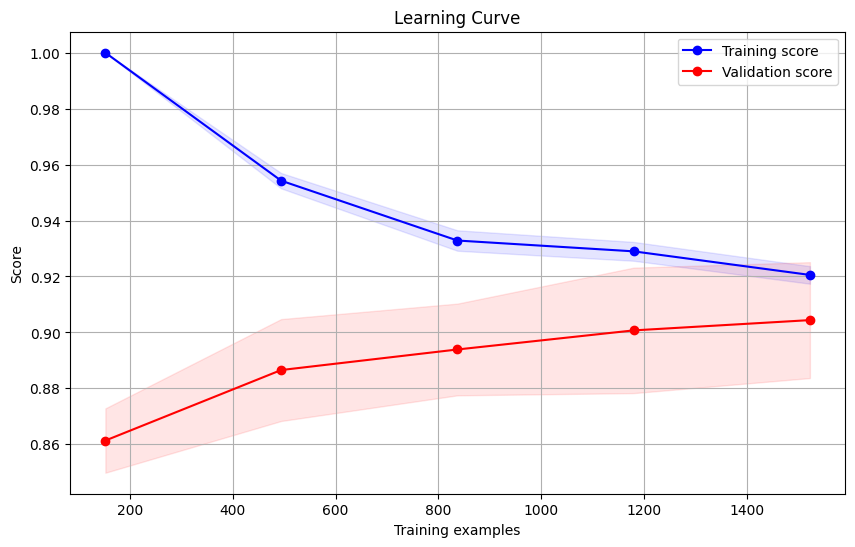

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Bagging_RF_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Base RandomForest model with the provided parameters
base_rf = RandomForestClassifier(class_weight='balanced',criterion='log_loss', max_depth=20, max_leaf_nodes=20,
                       n_estimators=5, oob_score=True, random_state=42)

# Define the parameter grid for Bagging
start_tune_time = time.time()
param_dist = {
    'n_estimators': stats.randint(10, 500),  # Number of base estimators in the ensemble
    'max_samples': stats.uniform(0.1, 1.0),  # Fraction of samples to draw from X to train each base estimator
    'max_features': stats.uniform(0.1, 1.0),  # Fraction of features to draw from X to train each base estimator
    'bootstrap': [True, False],  # Whether samples are drawn with replacement
    'bootstrap_features': [True, False],  # Whether features are drawn with replacement
    'random_state': [42]  # Fixed random state for reproducibility
}

# Initialize the Bagging classifier with the RandomForest as the base estimator
bagging_clf = BaggingClassifier(estimator=base_rf)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=bagging_clf,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time", tuning_time)


Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'bootstrap': False, 'bootstrap_features': False, 'max_features': 0.9631385219890038, 'max_samples': 0.9803599686384168, 'n_estimators': 154, 'random_state': 42}
Best score: 0.8824678256942876
Tuning_time 861.6904680728912


#### Logging Best Bagging RF Model into MLFLOW

Model: Tuned_Bagging_RF_on_Balanced_Dataset
params: {'bootstrap': False, 'bootstrap_features': False, 'max_features': 0.9631385219890038, 'max_samples': 0.9803599686384168, 'n_estimators': 154, 'random_state': 42}
Training Time: 5.0681 seconds
Testing Time: 0.4171 seconds
Tuning Time: 861.6905 seconds
Train Metrics:
Accuracy_train: 0.9077
Precision_train: 0.8873
Recall_train: 0.9341
F1_score_train: 0.9101
F2_score_train: 0.9243
Roc_auc_train: 0.9681
Pr_auc_train: 0.9690

Test Metrics:
Accuracy_test: 0.9015
Precision_test: 0.9321
Recall_test: 0.9235
F1_score_test: 0.9278
F2_score_test: 0.9252
Roc_auc_test: 0.9482
Pr_auc_test: 0.9708

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.8825

Train Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.88      0.91      1289
           1       0.89      0.93      0.91      1289

    accuracy                           0.91      2578
   macro avg       0.91      0.91      0.91      

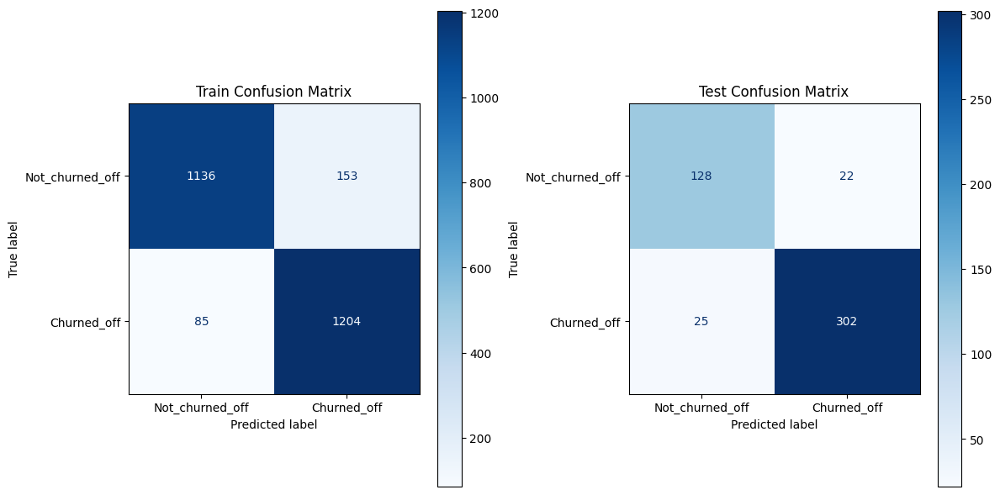

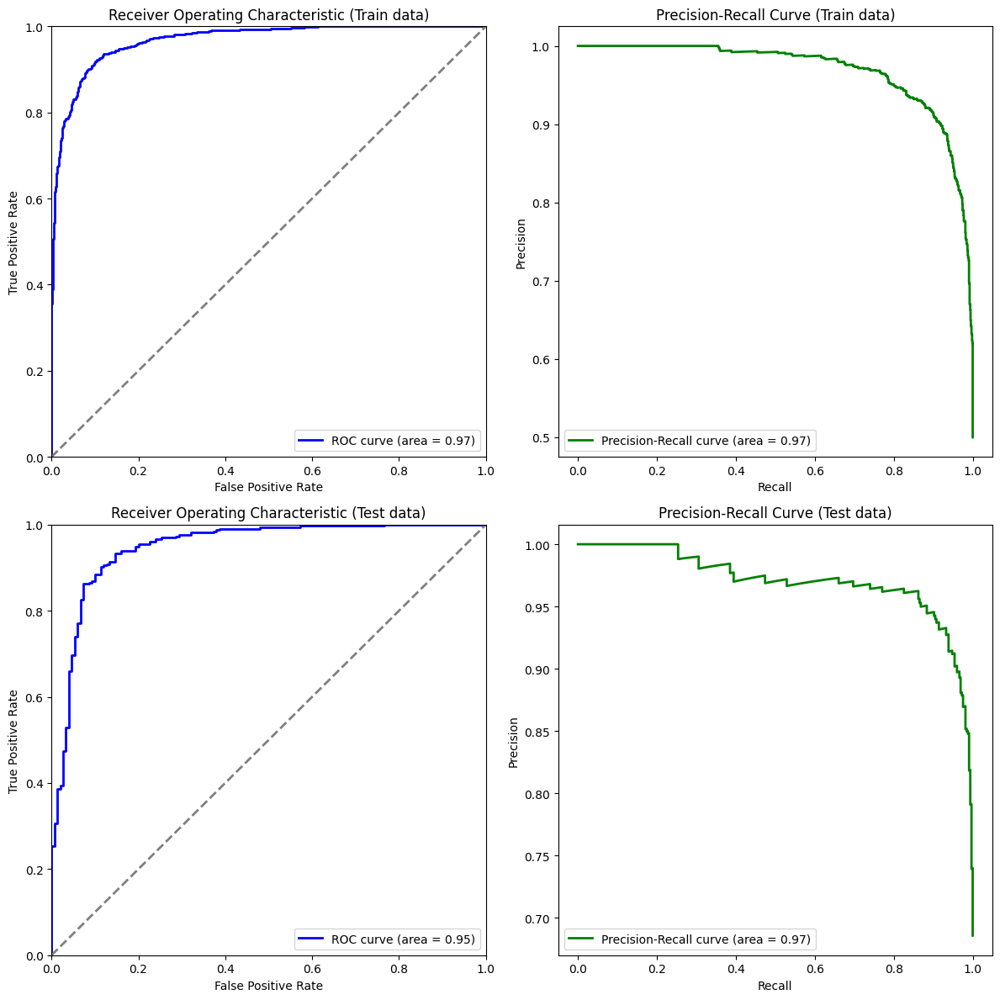

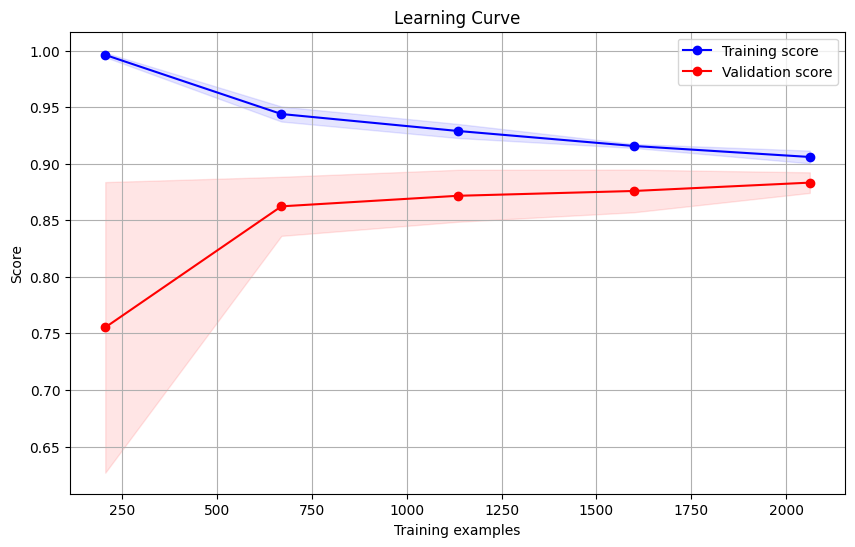

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Bagging_RF_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## ADABOOST MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the base estimator (Decision Stump)
base_stump = DecisionTreeClassifier(max_depth=5)

# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'n_estimators': stats.randint(50, 1000),  # Number of boosting stages
    'learning_rate': stats.uniform(0.01, 1.0),  # Step size for boosting
    'algorithm': ['SAMME', 'SAMME.R'],  # Algorithm to use for boosting
}

# Initialize the AdaBoost model with the decision stump as base estimator
ada_boost = AdaBoostClassifier(estimator=base_stump, random_state=42)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=ada_boost,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time:", tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'algorithm': 'SAMME', 'learning_rate': 0.1370605126518848, 'n_estimators': 313}
Best score: 0.9154344522724133
Tuning_time: 908.1767725944519


#### Logging Best Adaboost Model into MLFLOW

Model: Tuned_Adaboost_on_Imbalanced_Dataset
params: {'algorithm': 'SAMME', 'learning_rate': 0.1370605126518848, 'n_estimators': 313}
Training Time: 3.8815 seconds
Testing Time: 0.2613 seconds
Tuning Time: 908.1768 seconds
Train Metrics:
Accuracy_train: 0.9727
Precision_train: 0.9703
Recall_train: 0.9899
F1_score_train: 0.9800
F2_score_train: 0.9859
Roc_auc_train: 0.9980
Pr_auc_train: 0.9991

Test Metrics:
Accuracy_test: 0.9036
Precision_test: 0.9169
Recall_test: 0.9450
F1_score_test: 0.9307
F2_score_test: 0.9392
Roc_auc_test: 0.9559
Pr_auc_test: 0.9759

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.9154

Train Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96       615
           1       0.97      0.99      0.98      1289

    accuracy                           0.97      1904
   macro avg       0.97      0.96      0.97      1904
weighted avg       0.97      0.97      0.97      1904


Test Classification 

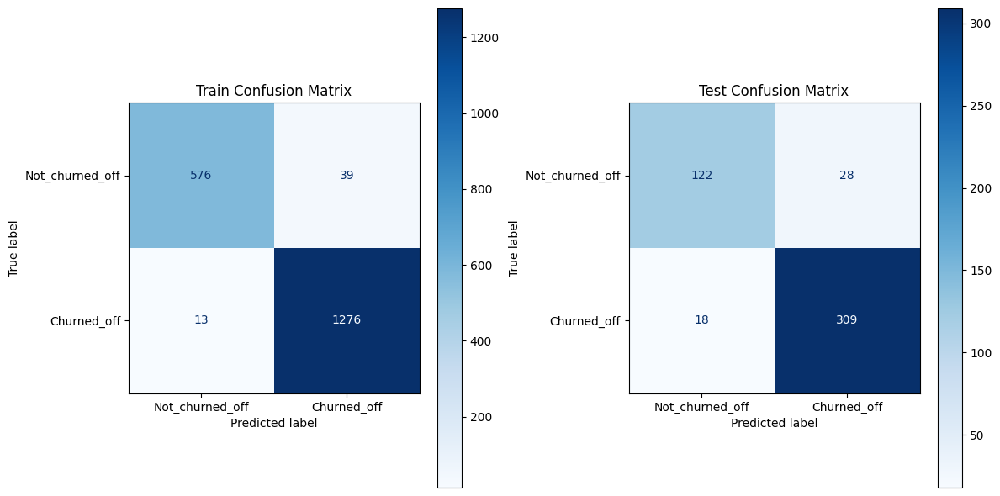

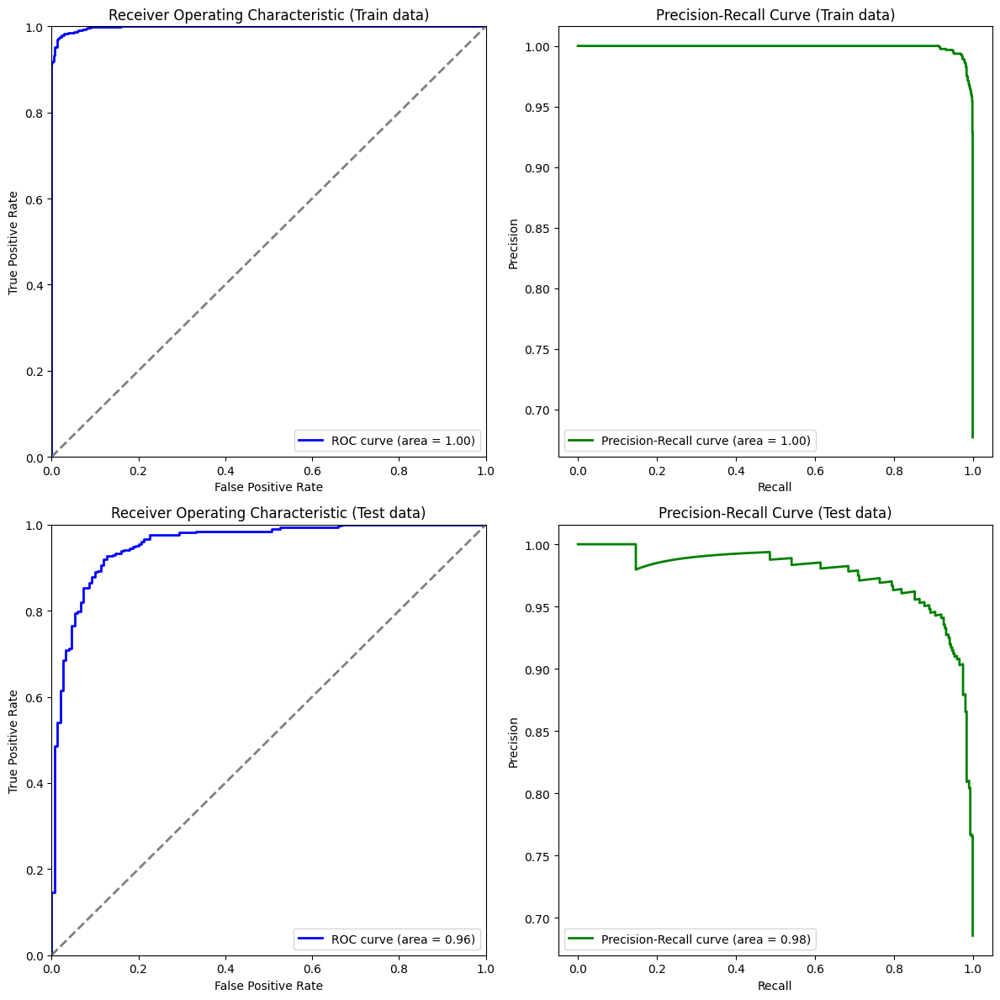

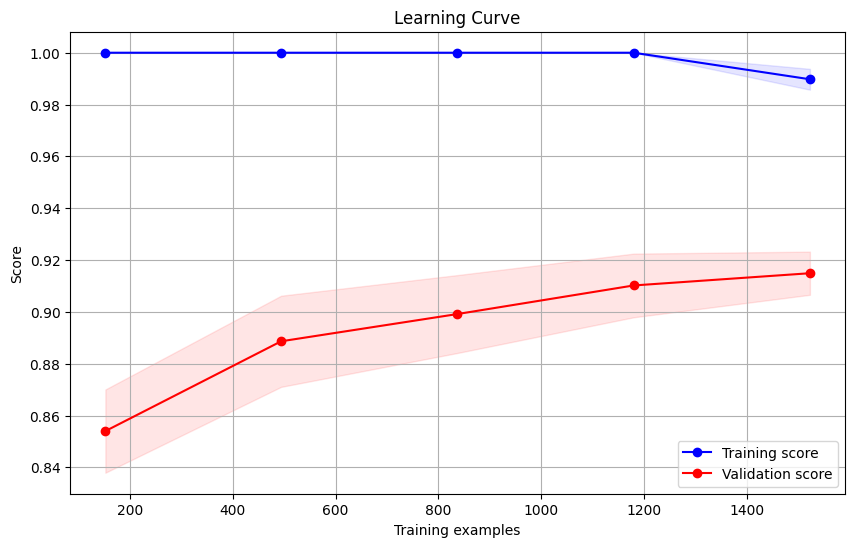

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Adaboost_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the base estimator (Decision Stump)
base_stump = DecisionTreeClassifier(max_depth=5)

# Define the parameter grid
start_tune_time = time.time()
param_dist = {
    'n_estimators': stats.randint(50, 1000),  # Number of boosting stages
    'learning_rate': stats.uniform(0.01, 1.0),  # Step size for boosting
    'algorithm': ['SAMME', 'SAMME.R'],  # Algorithm to use for boosting
 }

# Initialize the AdaBoost model with the decision stump as base estimator
ada_boost = AdaBoostClassifier(estimator=base_stump, random_state=42)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=ada_boost,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time:", tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'algorithm': 'SAMME.R', 'learning_rate': 0.9000053418175663, 'n_estimators': 520}
Best score: 0.9185534733197862
Tuning_time: 1126.033709526062


#### Logging Best Adaboost Model into MLFLOW

Model: Tuned_Adaboost_on_Balanced_Dataset
params: {'algorithm': 'SAMME.R', 'learning_rate': 0.9000053418175663, 'n_estimators': 520}
Training Time: 8.7266 seconds
Testing Time: 0.5456 seconds
Tuning Time: 1126.0337 seconds
Train Metrics:
Accuracy_train: 1.0000
Precision_train: 1.0000
Recall_train: 1.0000
F1_score_train: 1.0000
F2_score_train: 1.0000
Roc_auc_train: 1.0000
Pr_auc_train: 1.0000

Test Metrics:
Accuracy_test: 0.8931
Precision_test: 0.9233
Recall_test: 0.9205
F1_score_test: 0.9219
F2_score_test: 0.9211
Roc_auc_test: 0.9431
Pr_auc_test: 0.9686

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.9186

Train Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1289
           1       1.00      1.00      1.00      1289

    accuracy                           1.00      2578
   macro avg       1.00      1.00      1.00      2578
weighted avg       1.00      1.00      1.00      2578


Test Classification

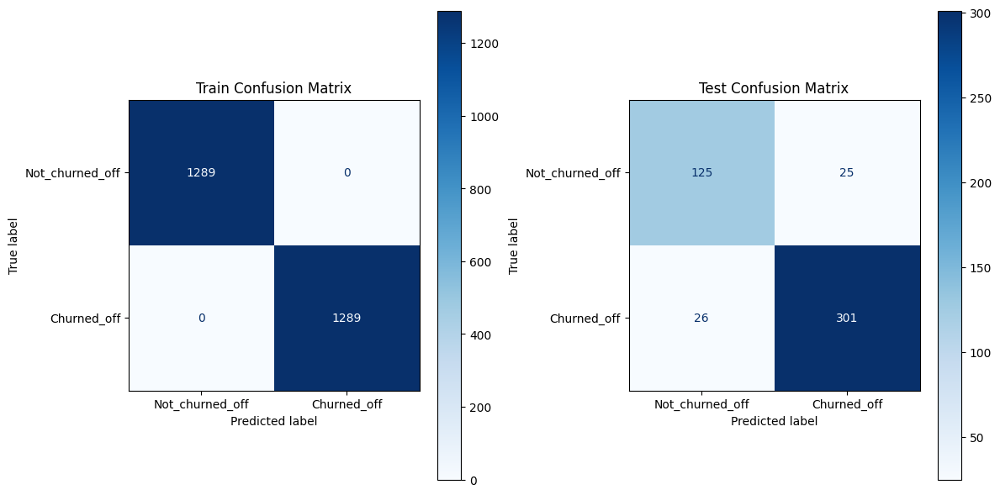

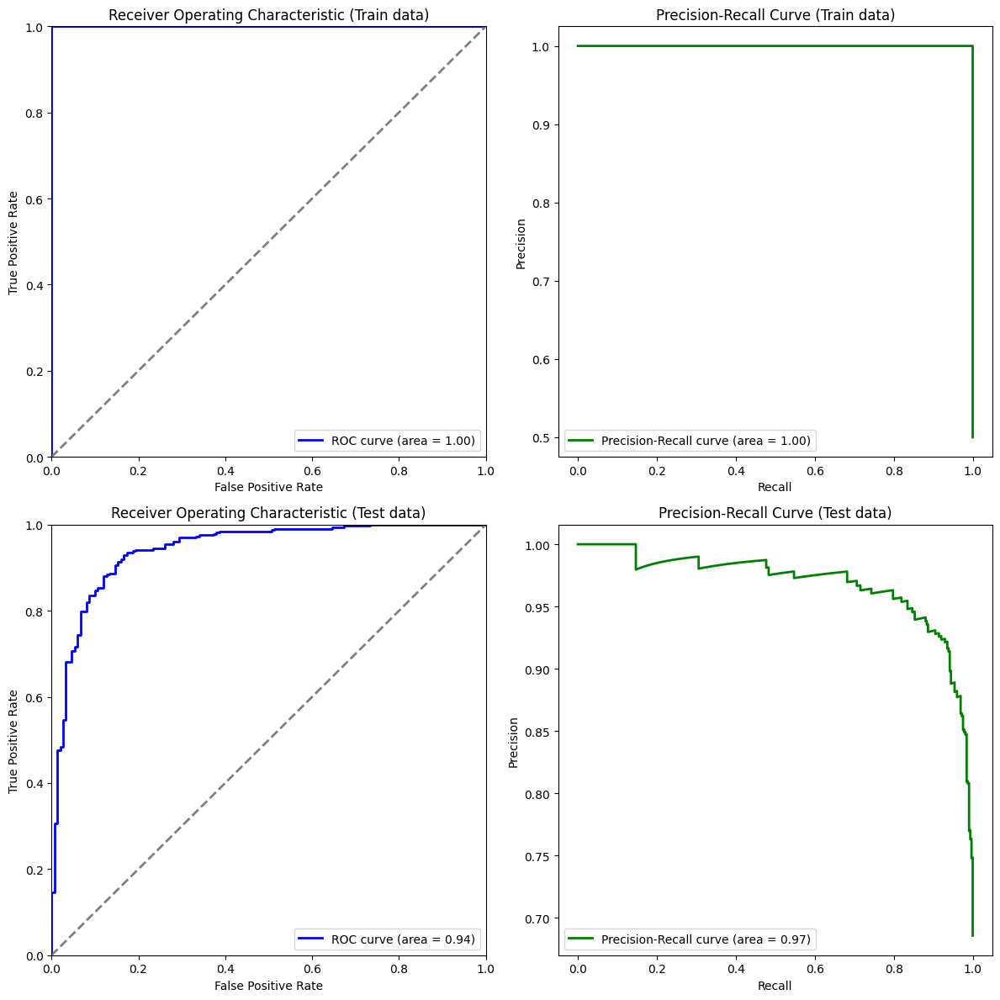

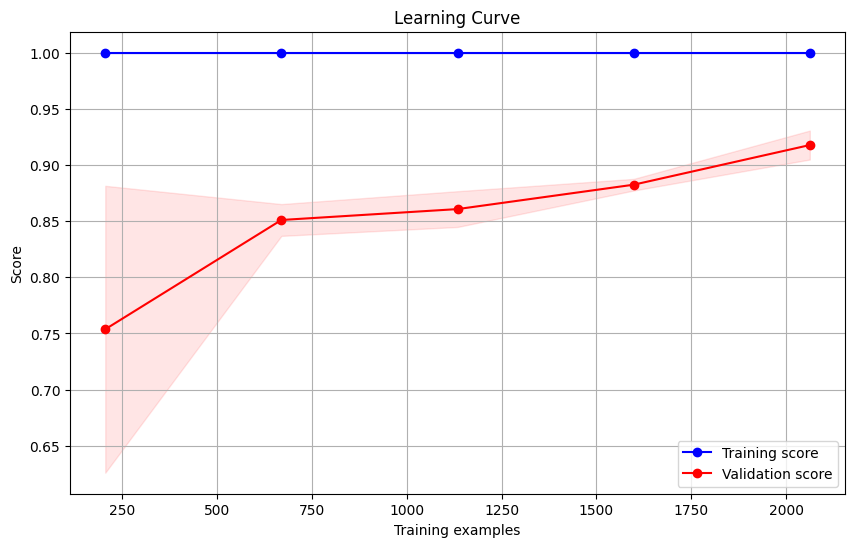

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Adaboost_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## GRADIENT BOOST MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Start timing the tuning process
start_tune_time = time.time()

# Define the parameter grid
param_dist = {
    'n_estimators': stats.randint(100, 1000),          # Number of boosting stages to be run
    'learning_rate': stats.uniform(0.01, 0.3),         # Learning rate shrinks the contribution of each tree
    'max_depth': stats.randint(3, 15),                 # Maximum depth of the individual regression estimators
    'min_samples_split': stats.randint(2, 20),         # Minimum number of samples required to split an internal node
    'min_samples_leaf': stats.randint(1, 20),          # Minimum number of samples required to be at a leaf node
    'max_features': ['auto', 'sqrt', 'log2', None],    # Number of features to consider when looking for the best split
    'subsample': stats.uniform(0.7, 0.3),              # Fraction of samples used for fitting the individual base learners
    'min_impurity_decrease': stats.uniform(0.0, 0.1),  # A node will be split if this split induces a decrease of the impurity
    'random_state': [42]                               # Fixed random state for reproducibility
}

# Initialize the GradientBoostingClassifier
gbc = GradientBoostingClassifier()

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=gbc,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=5,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_

# End timing and print tuning time
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time:", tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'learning_rate': 0.06676646193550176, 'max_depth': 7, 'max_features': 'log2', 'min_impurity_decrease': 0.09613152881849074, 'min_samples_leaf': 19, 'min_samples_split': 11, 'n_estimators': 493, 'random_state': 42, 'subsample': 0.94598407522243}
Best score: 0.9164815582262744
Tuning_time: 149.77282738685608


#### Logging Best Gradient boost Model into MLFLOW

Model: Tuned_Gradient_boost_on_Imbalanced_Dataset
params: {'learning_rate': 0.06676646193550176, 'max_depth': 7, 'max_features': 'log2', 'min_impurity_decrease': 0.09613152881849074, 'min_samples_leaf': 19, 'min_samples_split': 11, 'n_estimators': 493, 'random_state': 42, 'subsample': 0.94598407522243}
Training Time: 1.0254 seconds
Testing Time: 0.0091 seconds
Tuning Time: 149.7728 seconds
Train Metrics:
Accuracy_train: 0.9496
Precision_train: 0.9529
Recall_train: 0.9736
F1_score_train: 0.9632
F2_score_train: 0.9694
Roc_auc_train: 0.9889
Pr_auc_train: 0.9945

Test Metrics:
Accuracy_test: 0.9203
Precision_test: 0.9263
Recall_test: 0.9602
F1_score_test: 0.9429
F2_score_test: 0.9532
Roc_auc_test: 0.9553
Pr_auc_test: 0.9625

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.9165

Train Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.90      0.92       615
           1       0.95      0.97      0.96      1289

    accuracy 

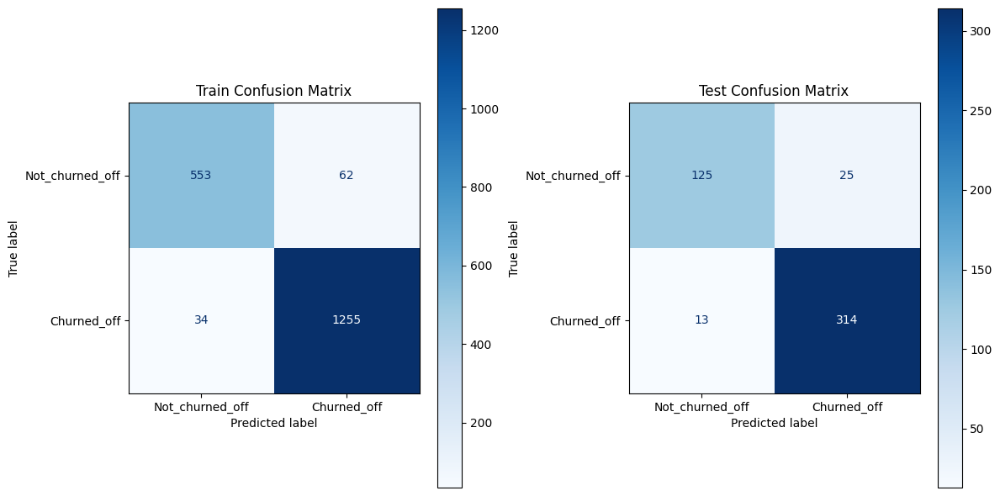

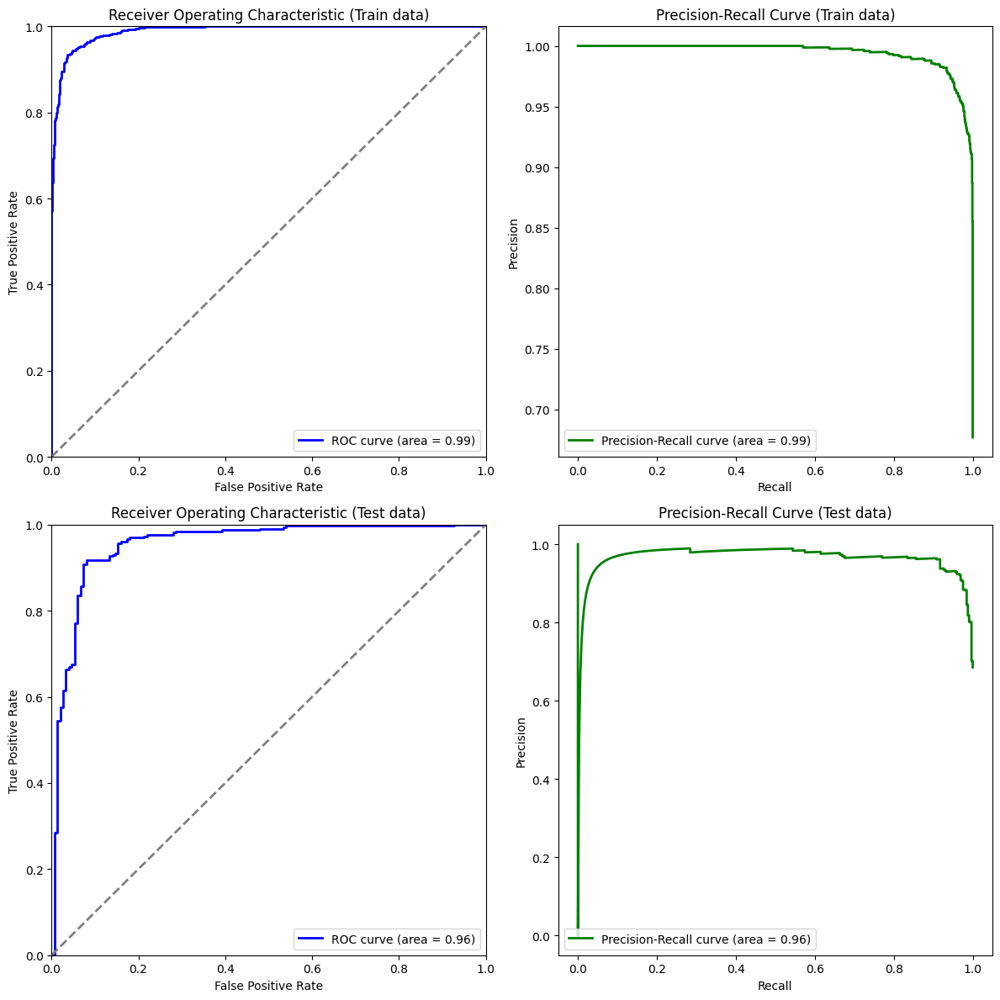

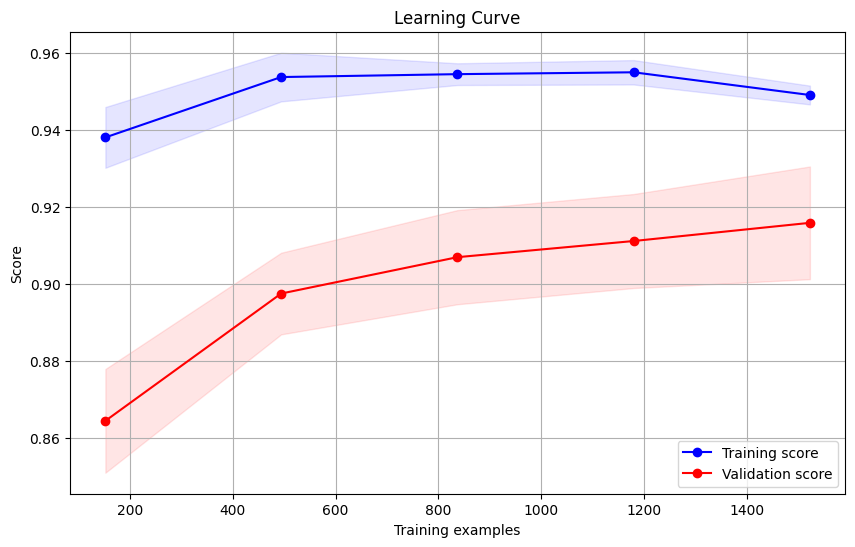

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Gradient_boost_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Start timing the tuning process
start_tune_time = time.time()

# Define the parameter grid
param_dist = {
    'n_estimators': stats.randint(100, 1000),          # Number of boosting stages to be run
    'learning_rate': stats.uniform(0.01, 0.3),         # Learning rate shrinks the contribution of each tree
    'max_depth': stats.randint(3, 15),                 # Maximum depth of the individual regression estimators
    'min_samples_split': stats.randint(2, 20),         # Minimum number of samples required to split an internal node
    'min_samples_leaf': stats.randint(1, 20),          # Minimum number of samples required to be at a leaf node
    'max_features': ['auto', 'sqrt', 'log2', None],    # Number of features to consider when looking for the best split
    'subsample': stats.uniform(0.7, 0.3),              # Fraction of samples used for fitting the individual base learners
    'min_impurity_decrease': stats.uniform(0.0, 0.1),  # A node will be split if this split induces a decrease of the impurity
    'random_state': [42]                               # Fixed random state for reproducibility
}

# Initialize the GradientBoostingClassifier
gbc = GradientBoostingClassifier()

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=gbc,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=5,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_

# End timing and print tuning time
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time:", tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'learning_rate': 0.07858754845747705, 'max_depth': 9, 'max_features': 'log2', 'min_impurity_decrease': 0.0001120111480109487, 'min_samples_leaf': 2, 'min_samples_split': 15, 'n_estimators': 688, 'random_state': 42, 'subsample': 0.8522403201282508}
Best score: 0.9204937156619252
Tuning_time: 184.98244452476501


#### Logging Best Gradient boost Model into MLFLOW

Model: Tuned_Gradient_boost_on_Balanced_Dataset
params: {'learning_rate': 0.07858754845747705, 'max_depth': 9, 'max_features': 'log2', 'min_impurity_decrease': 0.0001120111480109487, 'min_samples_leaf': 2, 'min_samples_split': 15, 'n_estimators': 688, 'random_state': 42, 'subsample': 0.8522403201282508}
Training Time: 3.1670 seconds
Testing Time: 0.0326 seconds
Tuning Time: 184.9824 seconds
Train Metrics:
Accuracy_train: 1.0000
Precision_train: 1.0000
Recall_train: 1.0000
F1_score_train: 1.0000
F2_score_train: 1.0000
Roc_auc_train: 1.0000
Pr_auc_train: 1.0000

Test Metrics:
Accuracy_test: 0.8889
Precision_test: 0.9281
Recall_test: 0.9083
F1_score_test: 0.9181
F2_score_test: 0.9122
Roc_auc_test: 0.9405
Pr_auc_test: 0.9598

Tuning Metrics:
hyper_parameter_tuning_best_est_score: 0.9205

Train Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1289
           1       1.00      1.00      1.00      1289

    accuracy

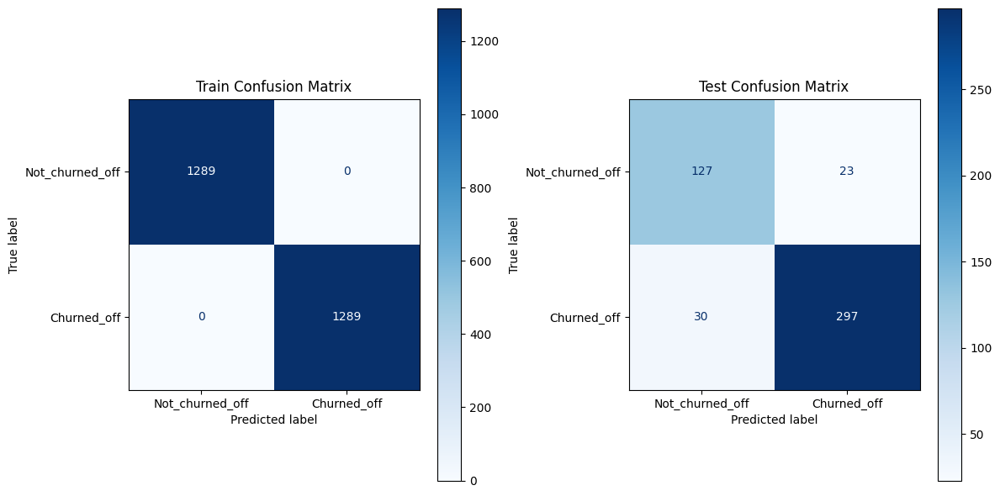

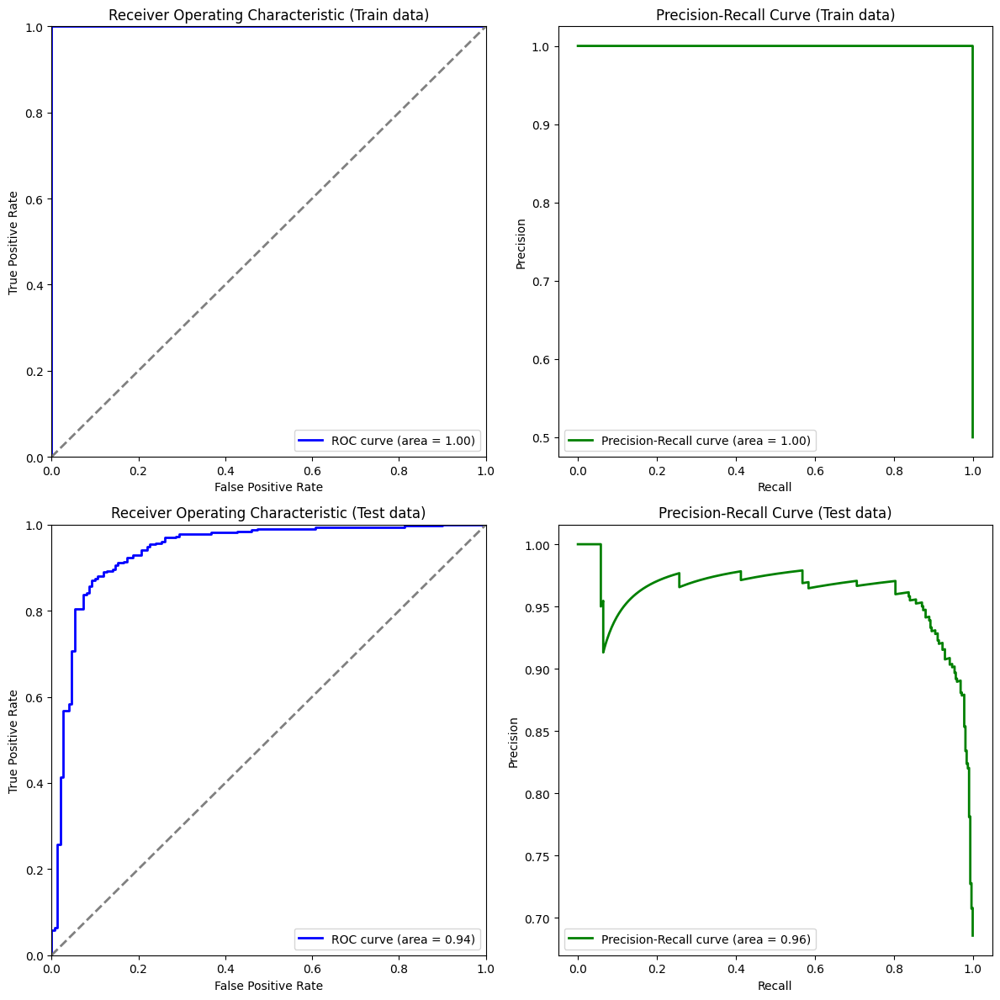

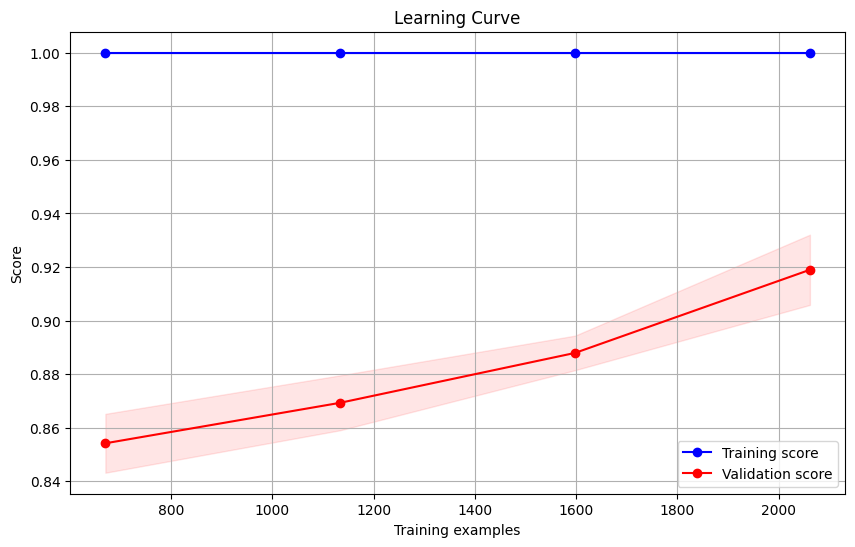

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Gradient_boost_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## XGBOOST MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Start timing the tuning process
start_tune_time = time.time()

# Define the parameter grid
param_dist = {
    'n_estimators': stats.randint(100, 1000),          # Number of boosting rounds
    'learning_rate': stats.uniform(0.01, 0.3),         # Learning rate (shrinkage factor)
    'max_depth': stats.randint(3, 15),                 # Maximum depth of a tree
    'min_child_weight': stats.randint(1, 10),          # Minimum sum of instance weight (hessian) needed in a child
    'gamma': stats.uniform(0, 0.5),                    # Minimum loss reduction required to make a split
    'subsample': stats.uniform(0.7, 0.3),              # Subsample ratio of the training instance
    'colsample_bytree': stats.uniform(0.7, 0.3),       # Subsample ratio of columns when constructing each tree
    'colsample_bylevel': stats.uniform(0.7, 0.3),      # Subsample ratio of columns for each level of a tree
    'colsample_bynode': stats.uniform(0.7, 0.3),       # Subsample ratio of columns for each node (split)
    'reg_alpha': stats.uniform(0, 0.5),                # L1 regularization term on weights
    'reg_lambda': stats.uniform(0.5, 1.5),             # L2 regularization term on weights
    'scale_pos_weight': stats.uniform(0.5, 2),         # Balance of positive and negative weights
    'booster': ['gbtree', 'gblinear', 'dart'],         # Type of booster to use
    'tree_method': ['auto', 'exact', 'approx', 'hist'],# Algorithm used to train trees
    'grow_policy': ['depthwise', 'lossguide'],         # Controls the way new nodes are added to the tree
    'objective': ['binary:logistic', 'multi:softprob'],# Learning task and the corresponding objective function
    'sampling_method': ['uniform', 'gradient_based'],  # Method used to sample training data
    'random_state': [42]                               # Fixed random state for reproducibility
}

# Initialize the XGBClassifier
xgb_clf = XGBClassifier(use_label_encoder=False, eval_metric='logloss')

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=xgb_clf,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_

# End timing and print tuning time
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time:", tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'booster': 'dart', 'colsample_bylevel': 0.9526356769407125, 'colsample_bynode': 0.9514986114133412, 'colsample_bytree': 0.840607947938491, 'gamma': 0.2074097511688326, 'grow_policy': 'depthwise', 'learning_rate': 0.014101589448099186, 'max_depth': 9, 'min_child_weight': 6, 'n_estimators': 575, 'objective': 'binary:logistic', 'random_state': 42, 'reg_alpha': 0.26717313751473154, 'reg_lambda': 1.6248661242049578, 'sampling_method': 'uniform', 'scale_pos_weight': 1.610863411205255, 'subsample': 0.9306962245541531, 'tree_method': 'auto'}
Best score: 0.9122793203481143
Tuning_time: 845.787605047226


#### Logging Best XG boost Model into MLFLOW

Model: Tuned_XG_boost_on_Imbalanced_Dataset
params: {'booster': 'dart', 'colsample_bylevel': 0.9526356769407125, 'colsample_bynode': 0.9514986114133412, 'colsample_bytree': 0.840607947938491, 'gamma': 0.2074097511688326, 'grow_policy': 'depthwise', 'learning_rate': 0.014101589448099186, 'max_depth': 9, 'min_child_weight': 6, 'n_estimators': 575, 'objective': 'binary:logistic', 'random_state': 42, 'reg_alpha': 0.26717313751473154, 'reg_lambda': 1.6248661242049578, 'sampling_method': 'uniform', 'scale_pos_weight': 1.610863411205255, 'subsample': 0.9306962245541531, 'tree_method': 'auto'}
Training Time: 44.0436 seconds
Testing Time: 0.2345 seconds
Tuning Time: 845.7876 seconds
Train Metrics:
Accuracy_train: 0.9559
Precision_train: 0.9500
Recall_train: 0.9868
F1_score_train: 0.9680
F2_score_train: 0.9792
Roc_auc_train: 0.9919
Pr_auc_train: 0.9960

Test Metrics:
Accuracy_test: 0.9099
Precision_test: 0.9104
Recall_test: 0.9633
F1_score_test: 0.9361
F2_score_test: 0.9522
Roc_auc_test: 0.9569


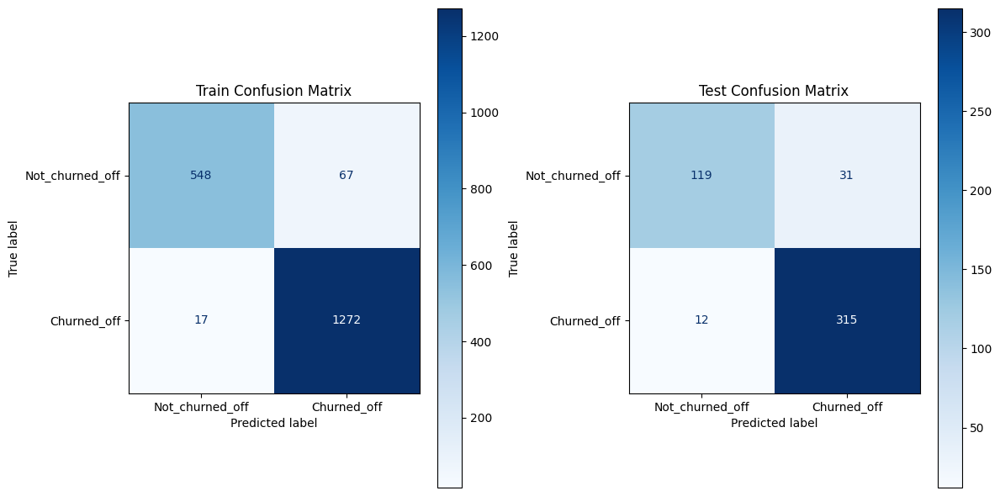

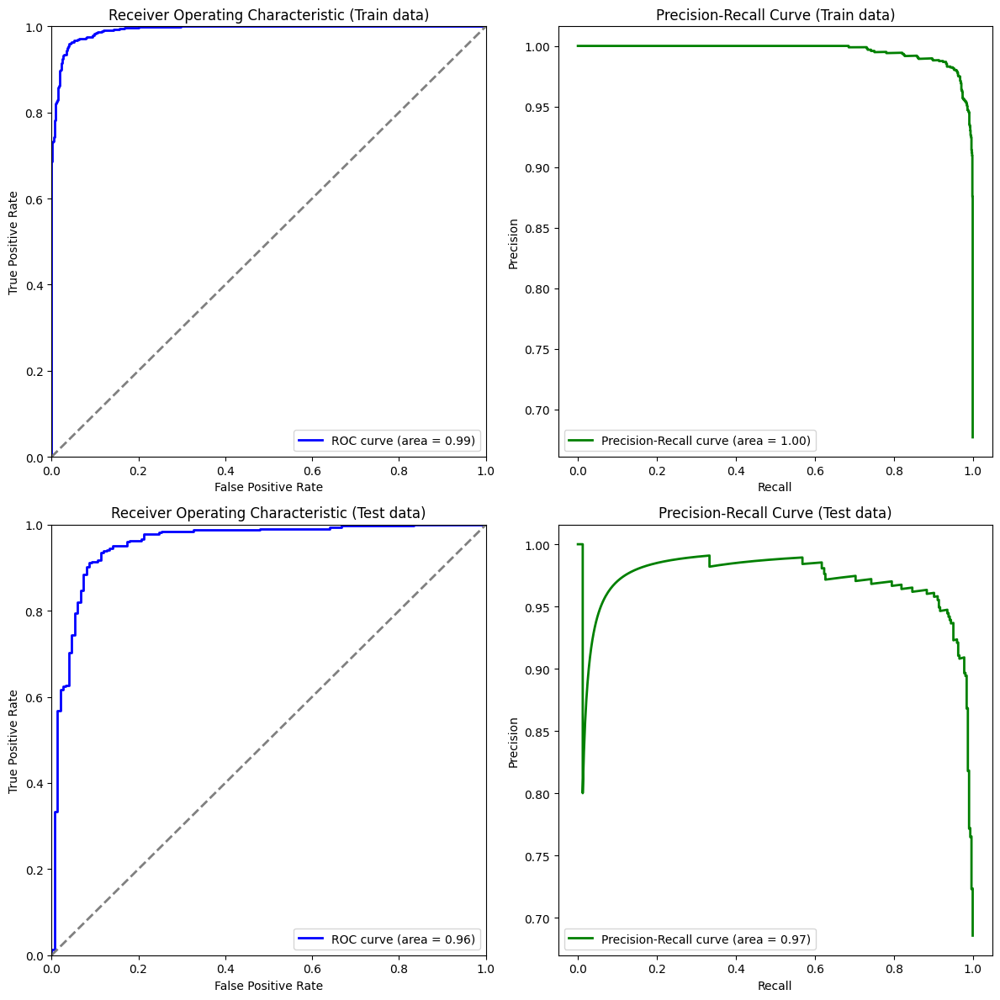

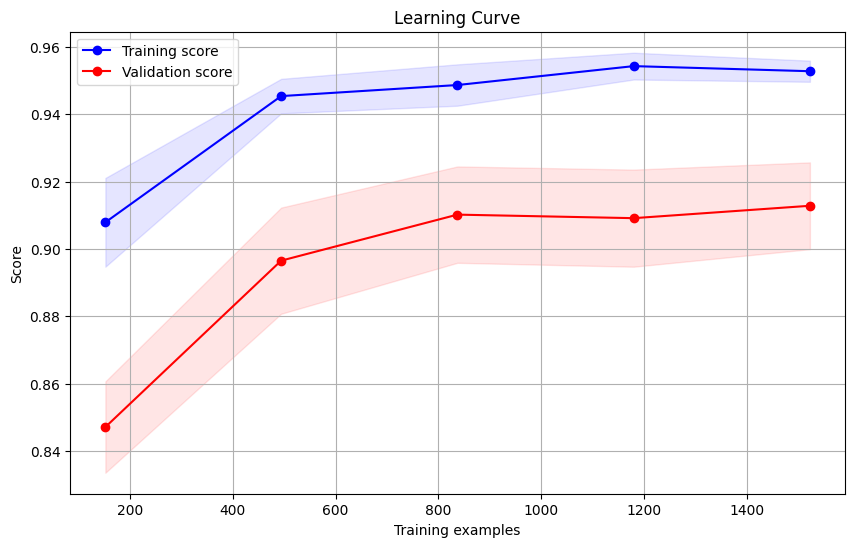

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_XG_boost_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Start timing the tuning process
start_tune_time = time.time()

# Define the parameter grid
param_dist = {
    'n_estimators': stats.randint(100, 1000),          # Number of boosting rounds
    'learning_rate': stats.uniform(0.01, 0.3),         # Learning rate (shrinkage factor)
    'max_depth': stats.randint(3, 15),                 # Maximum depth of a tree
    'min_child_weight': stats.randint(1, 10),          # Minimum sum of instance weight (hessian) needed in a child
    'gamma': stats.uniform(0, 0.5),                    # Minimum loss reduction required to make a split
    'subsample': stats.uniform(0.7, 0.3),              # Subsample ratio of the training instance
    'colsample_bytree': stats.uniform(0.7, 0.3),       # Subsample ratio of columns when constructing each tree
    'colsample_bylevel': stats.uniform(0.7, 0.3),      # Subsample ratio of columns for each level of a tree
    'colsample_bynode': stats.uniform(0.7, 0.3),       # Subsample ratio of columns for each node (split)
    'reg_alpha': stats.uniform(0, 0.5),                # L1 regularization term on weights
    'reg_lambda': stats.uniform(0.5, 1.5),             # L2 regularization term on weights
    'scale_pos_weight': stats.uniform(0.5, 2),         # Balance of positive and negative weights
    'booster': ['gbtree', 'gblinear', 'dart'],         # Type of booster to use
    'tree_method': ['auto', 'exact', 'approx', 'hist'],# Algorithm used to train trees
    'grow_policy': ['depthwise', 'lossguide'],         # Controls the way new nodes are added to the tree
    'objective': ['binary:logistic', 'multi:softprob'],# Learning task and the corresponding objective function
    'sampling_method': ['uniform', 'gradient_based'],  # Method used to sample training data
    'random_state': [42]                               # Fixed random state for reproducibility
}

# Initialize the XGBClassifier
xgb_clf = XGBClassifier(use_label_encoder=False, eval_metric='logloss')

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=xgb_clf,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_

# End timing and print tuning time
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time:", tuning_time)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best parameters found: {'booster': 'dart', 'colsample_bylevel': 0.8350373297259278, 'colsample_bynode': 0.7680894083096093, 'colsample_bytree': 0.9668172748386532, 'gamma': 0.22530982836487895, 'grow_policy': 'depthwise', 'learning_rate': 0.055050700245112494, 'max_depth': 14, 'min_child_weight': 1, 'n_estimators': 186, 'objective': 'binary:logistic', 'random_state': 42, 'reg_alpha': 0.023915410197052733, 'reg_lambda': 0.5570327723561823, 'sampling_method': 'uniform', 'scale_pos_weight': 1.9326467761253645, 'subsample': 0.721625300799602, 'tree_method': 'hist'}
Best score: 0.9185466997817416
Tuning_time: 1073.087533712387


#### Logging Best XG boost Model into MLFLOW

Model: Tuned_XG_boost_on_Balanced_Dataset
params: {'booster': 'dart', 'colsample_bylevel': 0.8350373297259278, 'colsample_bynode': 0.7680894083096093, 'colsample_bytree': 0.9668172748386532, 'gamma': 0.22530982836487895, 'grow_policy': 'depthwise', 'learning_rate': 0.055050700245112494, 'max_depth': 14, 'min_child_weight': 1, 'n_estimators': 186, 'objective': 'binary:logistic', 'random_state': 42, 'reg_alpha': 0.023915410197052733, 'reg_lambda': 0.5570327723561823, 'sampling_method': 'uniform', 'scale_pos_weight': 1.9326467761253645, 'subsample': 0.721625300799602, 'tree_method': 'hist'}
Training Time: 4.4050 seconds
Testing Time: 0.0725 seconds
Tuning Time: 1073.0875 seconds
Train Metrics:
Accuracy_train: 0.9996
Precision_train: 0.9992
Recall_train: 1.0000
F1_score_train: 0.9996
F2_score_train: 0.9998
Roc_auc_train: 1.0000
Pr_auc_train: 1.0000

Test Metrics:
Accuracy_test: 0.8952
Precision_test: 0.9288
Recall_test: 0.9174
F1_score_test: 0.9231
F2_score_test: 0.9197
Roc_auc_test: 0.947

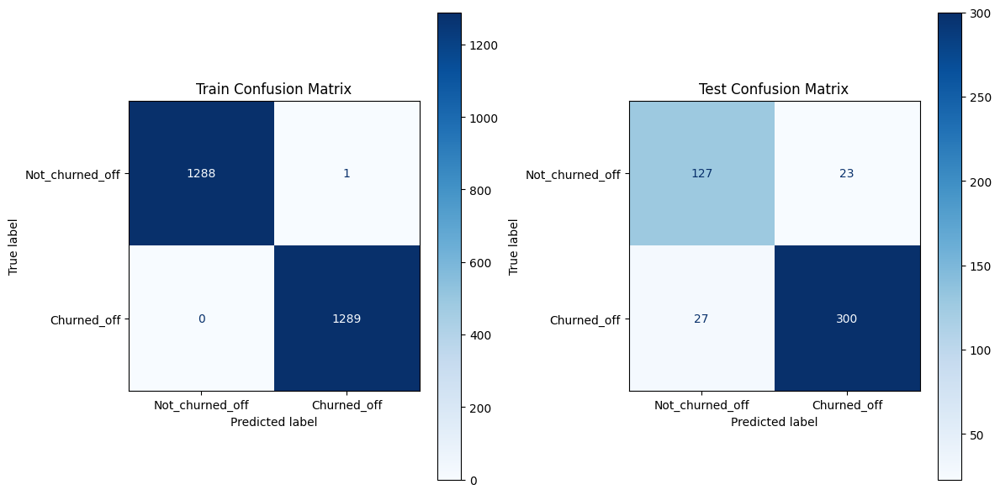

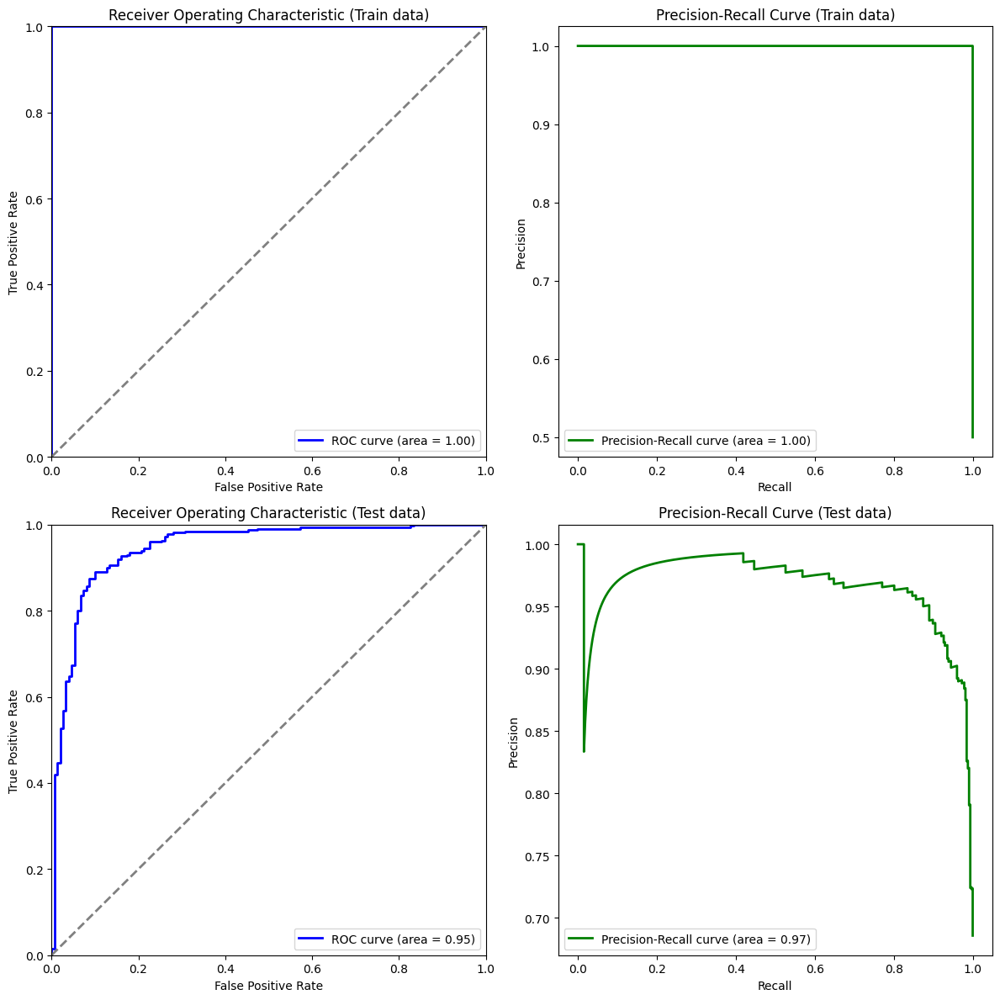

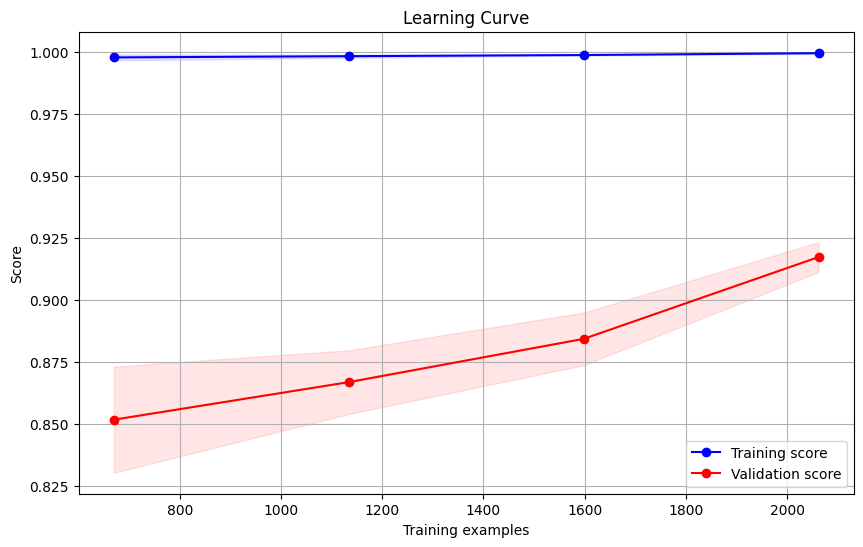

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_XG_boost_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## LIGHT_GB MODEL

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import RandomizedSearchCV
from scipy import stats
import time
import warnings

# Start timing the tuning process
start_tune_time = time.time()

# Define the parameter grid
param_dist = {
    'num_leaves': stats.randint(20, 150),              # Number of leaves in one tree
    'max_depth': stats.randint(3, 15),                 # Maximum tree depth for base learners
    'learning_rate': stats.uniform(0.01, 0.3),         # Boosting learning rate
    'n_estimators': stats.randint(100, 2000),          # Number of boosting rounds
    'min_child_samples': stats.randint(10, 100),       # Minimum number of data needed in a child (leaf)
    'min_child_weight': stats.uniform(1e-3, 1e-1),     # Minimum sum of instance weight (hessian) needed in a child (leaf)
    'subsample': stats.uniform(0.5, 1.0),              # Subsample ratio of the training instance
    'colsample_bytree': stats.uniform(0.5, 1.0),       # Subsample ratio of columns when constructing each tree
    'reg_alpha': stats.uniform(0, 0.5),                # L1 regularization term on weights
    'reg_lambda': stats.uniform(0.5, 1.5),             # L2 regularization term on weights
    'scale_pos_weight': stats.uniform(0.5, 2),         # Control the balance of positive and negative weights
    'boosting_type': ['gbdt', 'dart', 'goss'],         # Boosting type
    'objective': ['binary', 'multiclass'],             # Objective function
    'bagging_fraction': stats.uniform(0.5, 1.0),       # Fraction of data to use for each iteration (randomly selected)
    'bagging_freq': stats.randint(1, 10),              # Frequency of bagging
    'feature_fraction': stats.uniform(0.5, 1.0),       # Fraction of features to consider at each iteration
    'min_split_gain': stats.uniform(0, 0.1),           # Minimum gain to make a split
    'min_data_in_leaf': stats.randint(20, 100),        # Minimum number of data points in a leaf node
    'random_state': [42],                            # Fixed random state for reproducibility
}

# Initialize the LGBMClassifier
lgbm_clf = LGBMClassifier()

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=lgbm_clf,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=False,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_

# End timing and print tuning time
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time:", tuning_time)
warnings.filterwarnings('ignore')

> Best parameters found: {'bagging_fraction': 0.7040356346288988, 'bagging_freq': 5, 'boosting_type': 'dart', 'colsample_bytree': 1.1159854502601791, 'feature_fraction': 0.6880247346154161, 'learning_rate': 0.11661537060572182, 'max_depth': 11, 'min_child_samples': 45, 'min_child_weight': 0.0015229613542912736, 'min_data_in_leaf': 77, 'min_split_gain': 0.003531135494023907, 'n_estimators': 308, 'num_leaves': 33, 'objective': 'binary', 'random_state': 42, 'reg_alpha': 0.4790367400596901, 'reg_lambda': 1.0519111269531267, 'scale_pos_weight': 1.1538632326761582, 'subsample': 0.6488880503324447}

> Best score: 0.9149026108578534

> Tuning_time: 31.56225085258484

#### Logging Best Light GBM Model into MLFLOW

In [ ]:
# Model details
name = "Tuned_Light_GBM_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

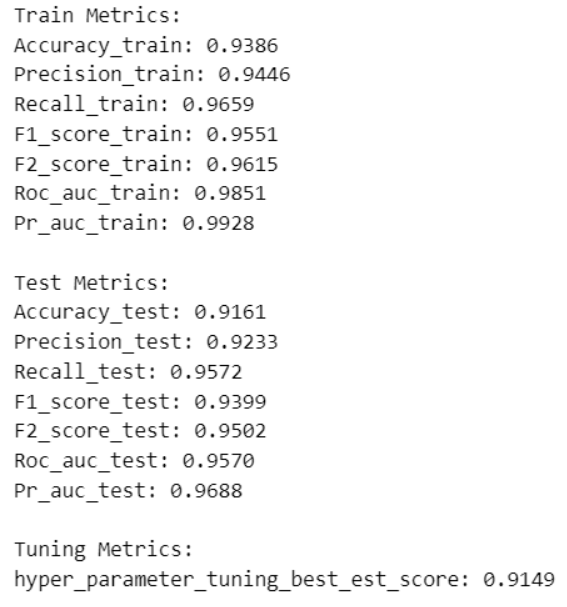

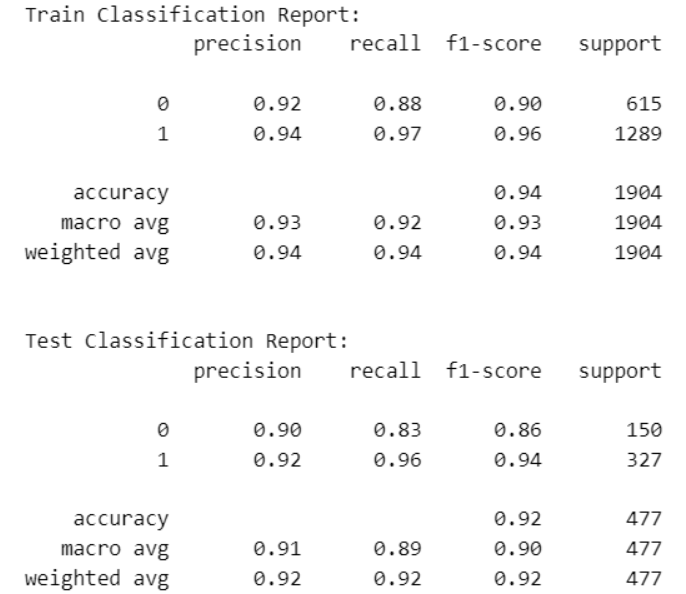

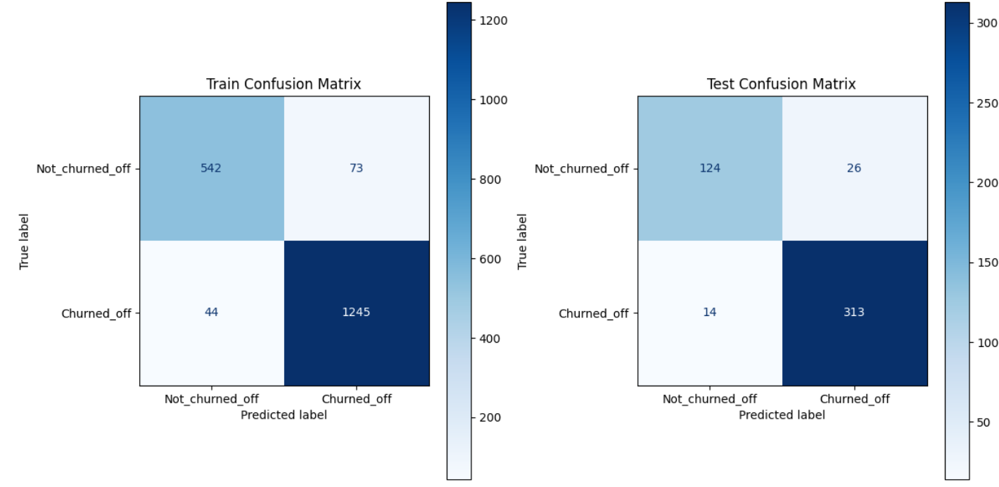

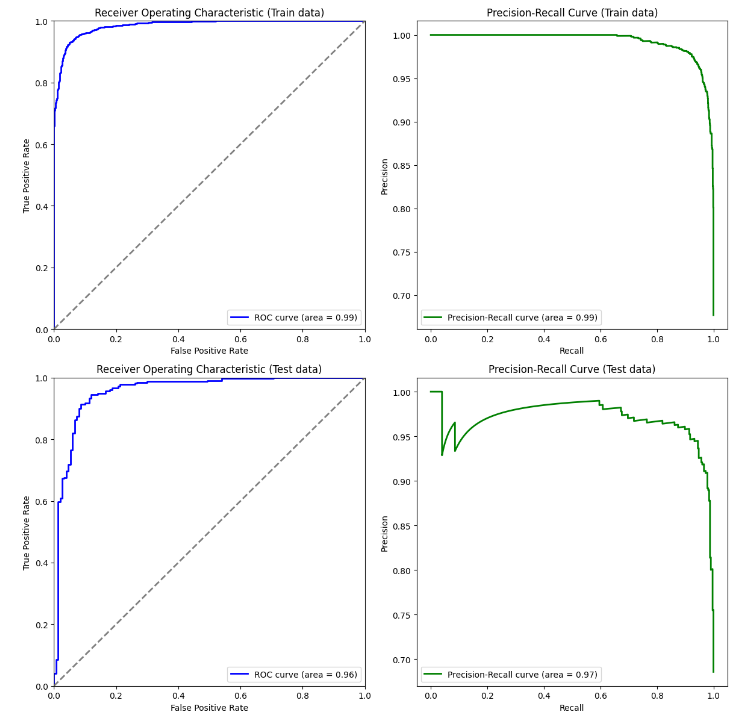

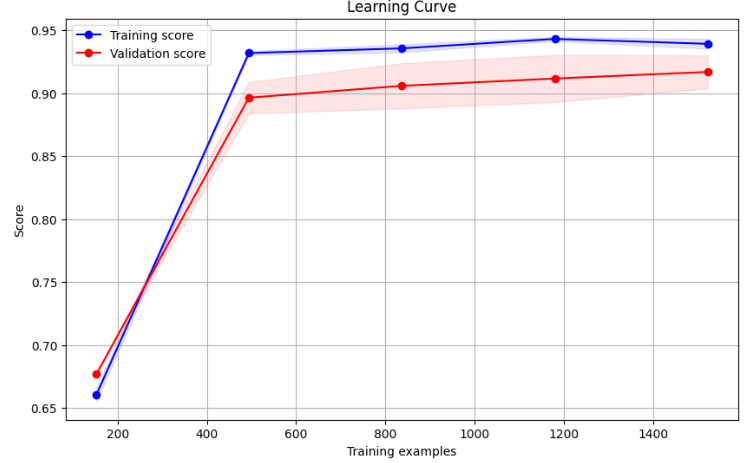

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import RandomizedSearchCV
from scipy import stats
import time
import warnings

# Start timing the tuning process
start_tune_time = time.time()

# Define the parameter grid
param_dist = {
    'num_leaves': stats.randint(20, 150),              # Number of leaves in one tree
    'max_depth': stats.randint(3, 15),                 # Maximum tree depth for base learners
    'learning_rate': stats.uniform(0.01, 0.3),         # Boosting learning rate
    'n_estimators': stats.randint(100, 2000),          # Number of boosting rounds
    'min_child_samples': stats.randint(10, 100),       # Minimum number of data needed in a child (leaf)
    'min_child_weight': stats.uniform(1e-3, 1e-1),     # Minimum sum of instance weight (hessian) needed in a child (leaf)
    'subsample': stats.uniform(0.5, 1.0),              # Subsample ratio of the training instance
    'colsample_bytree': stats.uniform(0.5, 1.0),       # Subsample ratio of columns when constructing each tree
    'reg_alpha': stats.uniform(0, 0.5),                # L1 regularization term on weights
    'reg_lambda': stats.uniform(0.5, 1.5),             # L2 regularization term on weights
    'scale_pos_weight': stats.uniform(0.5, 2),         # Control the balance of positive and negative weights
    'boosting_type': ['gbdt', 'dart', 'goss'],         # Boosting type
    'objective': ['binary', 'multiclass'],             # Objective function
    'bagging_fraction': stats.uniform(0.5, 1.0),       # Fraction of data to use for each iteration (randomly selected)
    'bagging_freq': stats.randint(1, 10),              # Frequency of bagging
    'feature_fraction': stats.uniform(0.5, 1.0),       # Fraction of features to consider at each iteration
    'min_split_gain': stats.uniform(0, 0.1),           # Minimum gain to make a split
    'min_data_in_leaf': stats.randint(20, 100),        # Minimum number of data points in a leaf node
    'random_state': [42],                            # Fixed random state for reproducibility
}

# Initialize the LGBMClassifier
lgbm_clf = LGBMClassifier()

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=lgbm_clf,
    param_distributions=param_dist,
    n_iter=200,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=False,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_

# End timing and print tuning time
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning_time:", tuning_time)
warnings.filterwarnings('ignore')

> Best parameters found: {'bagging_fraction': 0.795633685837714, 'bagging_freq': 5, 'boosting_type': 'dart', 'colsample_bytree': 0.9565345704829102, 'feature_fraction': 0.7184404372168336, 'learning_rate': 0.13495298436110986, 'max_depth': 13, 'min_child_samples': 98, 'min_child_weight': 0.03280034749718639, 'min_data_in_leaf': 20, 'min_split_gain': 0.02279351625419417, 'n_estimators': 732, 'num_leaves': 135, 'objective': 'binary', 'random_state': 42, 'reg_alpha': 0.4303652916281717, 'reg_lambda': 0.510428195796786, 'scale_pos_weight': 1.5214946051551315, 'subsample': 0.917411003148779}

> Best score: 0.9104056596673441

> Tuning_time: 41.100813150405884

#### Logging Best Light GBM boost Model into MLFLOW

In [ ]:
# Model details
name = "Tuned_Light_GBM_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

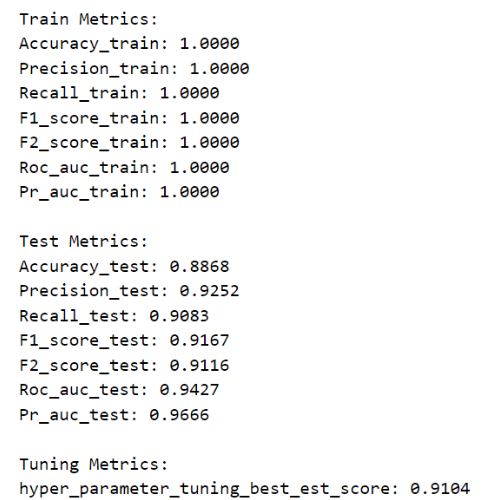

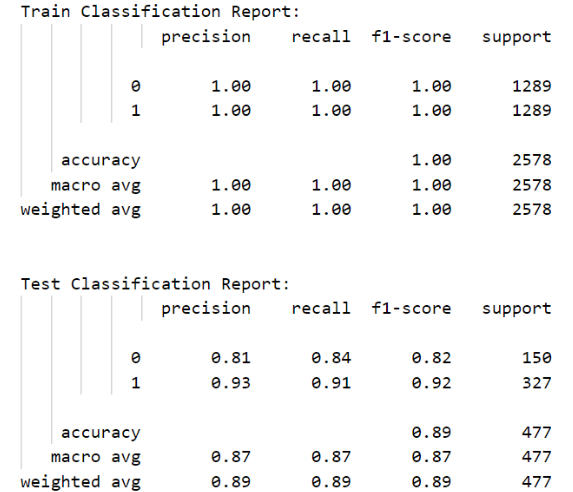

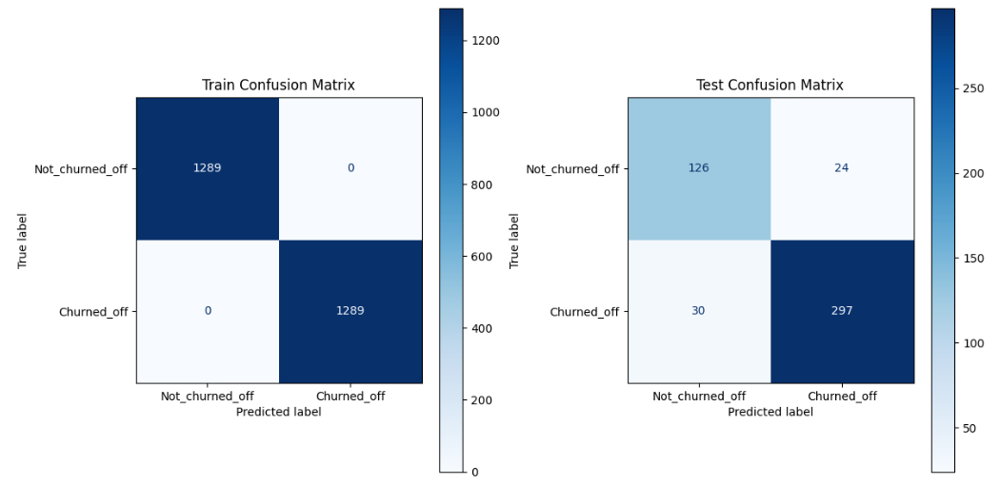

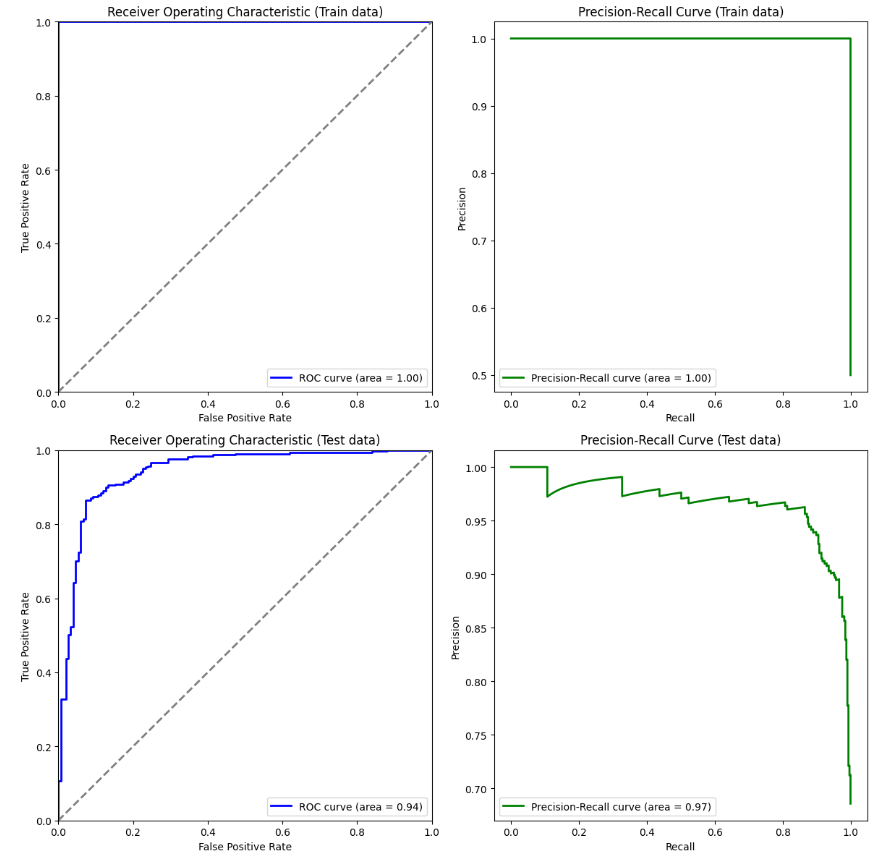

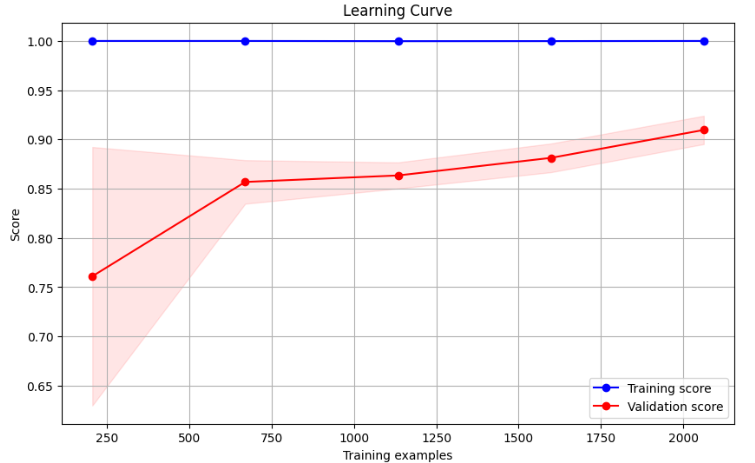

## VOTING CLASSIFIER MODEL

### Imbalanced Dataset

#### Loading all the models from mlflow

In [ ]:
def load_model_from_run(run_id, run_name):
    # Construct the model URI
    model_uri = f"runs:/{run_id}/{run_name}_model"

    try:
        # Load the model
        model = mlflow.sklearn.load_model(model_uri)
        print(f"Loaded model from run {run_id} with run name {run_name}")
        return model
    except Exception as e:
        print(f"Failed to load model from run {run_id}: {e}")
        return None

# Example usage to load models
experiment = mlflow.get_experiment_by_name("Ola_Ensemble_Learning")
experiment_id = experiment.experiment_id

# Search for runs
runs = mlflow.search_runs(experiment_ids=[experiment_id])
run_ids = runs['run_id'].tolist()

# Load models
models = []
for run_id in run_ids:
    run = mlflow.get_run(run_id)
    run_name = run.info.run_name
    model = load_model_from_run(run_id, run_name)
    if model:
        models.append((f"model_{run_id}", model))
# models = [i[1] for i in models]
print(models)

Loaded model from run eba5fab22ac34697bed53bb627af2c33 with run name Tuned_Light_GBM_on_Balanced_Dataset
Loaded model from run 0c81cb30c10d4f56a99f55b2e9fb2d4c with run name Tuned_Light_GBM_on_Imbalanced_Dataset
Loaded model from run 32171425fbf342ee9f549d502105a681 with run name Tuned_XG_boost_on_Balanced_Dataset
Loaded model from run 2adb1674b77d4b9ba15c0c8978e82d50 with run name Tuned_XG_boost_on_Imbalanced_Dataset
Loaded model from run 2576e8de75f841a5bbfc9aa9108e406d with run name Tuned_Gradient_boost_on_Balanced_Dataset
Loaded model from run aef92e3ec93c485bb2457c0a4bd209d8 with run name Tuned_Gradient_boost_on_Imbalanced_Dataset
Loaded model from run 6dce7745cea54262abfdd53e1081031c with run name Tuned_Adaboost_on_Balanced_Dataset
Loaded model from run 0d740d00e0094d11b582f53aed58a72b with run name Tuned_Adaboost_on_Imbalanced_Dataset
Loaded model from run 13b64ce985364b61ba859b705db9bac5 with run name Tuned_Bagging_RF_on_Balanced_Dataset
Loaded model from run 907c9c90e757474bb2

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid for RandomizedSearchCV
start_tune_time = time.time()
param_dist = {
    'voting': ['hard', 'soft'],
    'weights': [
        None,  # Default equal weights
        [1] * len(models[1::2]),  # Equal weights
        list([1 / (i + 1) for i in range(len(models[1::2]))])
        ],
    'n_jobs': [-1]
}
# Initialize the VotingClassifier
voting_clf = VotingClassifier(estimators=models[1::2])

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=voting_clf,
    param_distributions=param_dist,
    n_iter=6,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning time:", tuning_time)

Fitting 5 folds for each of 6 candidates, totalling 30 fits
Best parameters found: {'weights': [1.0, 0.5, 0.3333333333333333, 0.25, 0.2, 0.16666666666666666, 0.14285714285714285, 0.125, 0.1111111111111111, 0.1, 0.09090909090909091, 0.08333333333333333], 'voting': 'hard', 'n_jobs': -1}
Best score: 0.9138541234977208
Tuning time: 1044.1496663093567


#### Logging Best Voting Classifier Model into MLFLOW

[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.6880247346154161, colsample_bytree=1.1159854502601791 will be ignored. Current value: feature_fraction=0.6880247346154161
[LightGBM] [Warning] bagging_fraction is set=0.7040356346288988, subsample=0.6488880503324447 will be ignored. Current value: bagging_fraction=0.7040356346288988
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.6880247346154161, colsample_bytree=1.1159854502601791 will be ignored. Current value: feature_fraction=0.6880247346154161
[LightGBM] [Warning] bagging_fraction is set=0.7040356346288988, subsample=0.6488880503324447 will be ignored. Current value: bagging_fraction=0.704

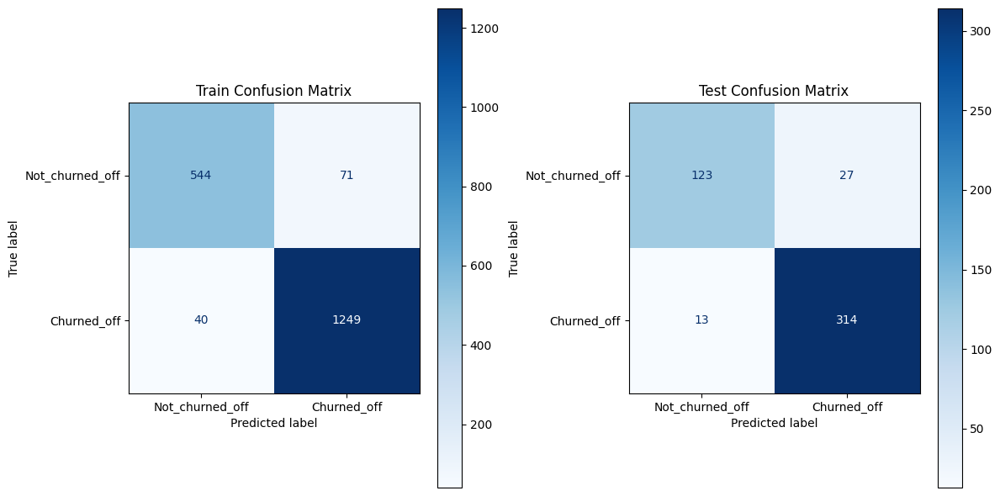

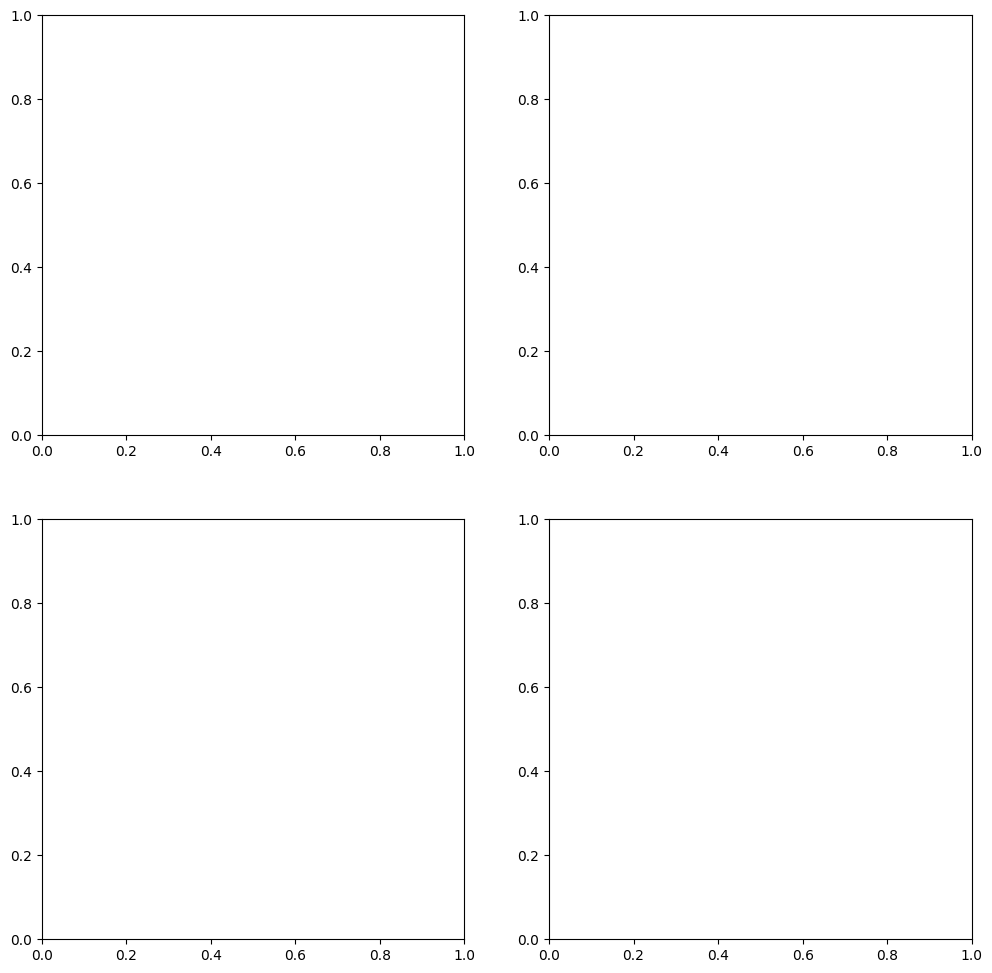

In [ ]:
# Model details
name = "Tuned_Voting_Classifier_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid for RandomizedSearchCV
start_tune_time = time.time()
param_dist = {
    'voting': ['hard', 'soft'],
    'weights': [
        None,  # Default equal weights
        [1] * len(models[::2]),  # Equal weights
        list([1 / (i + 1) for i in range(len(models[::2]))])  # Decreasing
    ],
    'n_jobs': [-1]
}
# Initialize the VotingClassifier
voting_clf = VotingClassifier(estimators=models[::2])

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=voting_clf,
    param_distributions=param_dist,
    n_iter=6,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning time:", tuning_time)

Fitting 5 folds for each of 6 candidates, totalling 30 fits
Best parameters found: {'weights': [1.0, 0.5, 0.3333333333333333, 0.25, 0.2, 0.16666666666666666, 0.14285714285714285, 0.125, 0.1111111111111111, 0.1, 0.09090909090909091, 0.08333333333333333], 'voting': 'soft', 'n_jobs': -1}
Best score: 0.9169978174155189
Tuning time: 275.3588945865631


#### Logging Best Voting Classifier Model into MLFLOW

[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] feature_fraction is set=0.7184404372168336, colsample_bytree=0.9565345704829102 will be ignored. Current value: feature_fraction=0.7184404372168336
[LightGBM] [Warning] bagging_fraction is set=0.795633685837714, subsample=0.917411003148779 will be ignored. Current value: bagging_fraction=0.795633685837714
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] feature_fraction is set=0.7184404372168336, colsample_bytree=0.9565345704829102 will be ignored. Current value: feature_fraction=0.7184404372168336
[LightGBM] [Warning] bagging_fraction is set=0.795633685837714, subsample=0.917411003148779 will be ignored. Current value: bagging_fraction=0.79563368

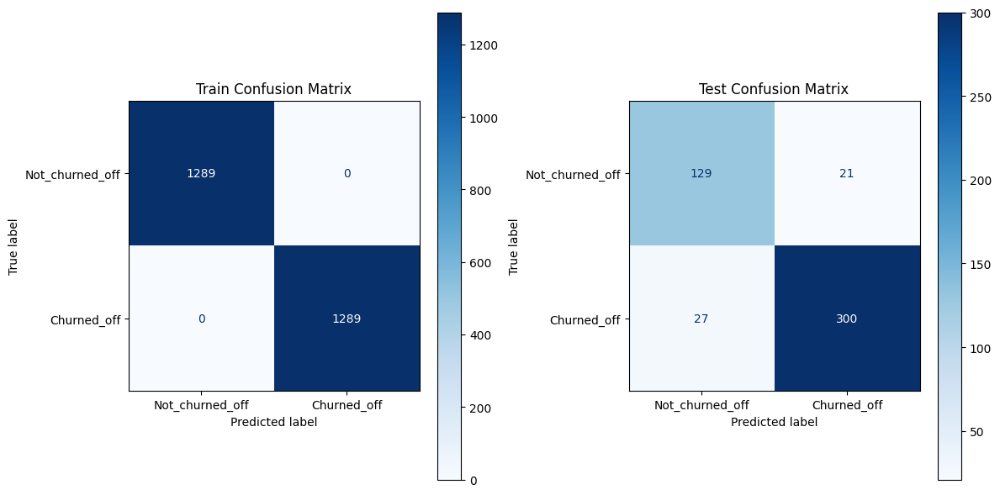

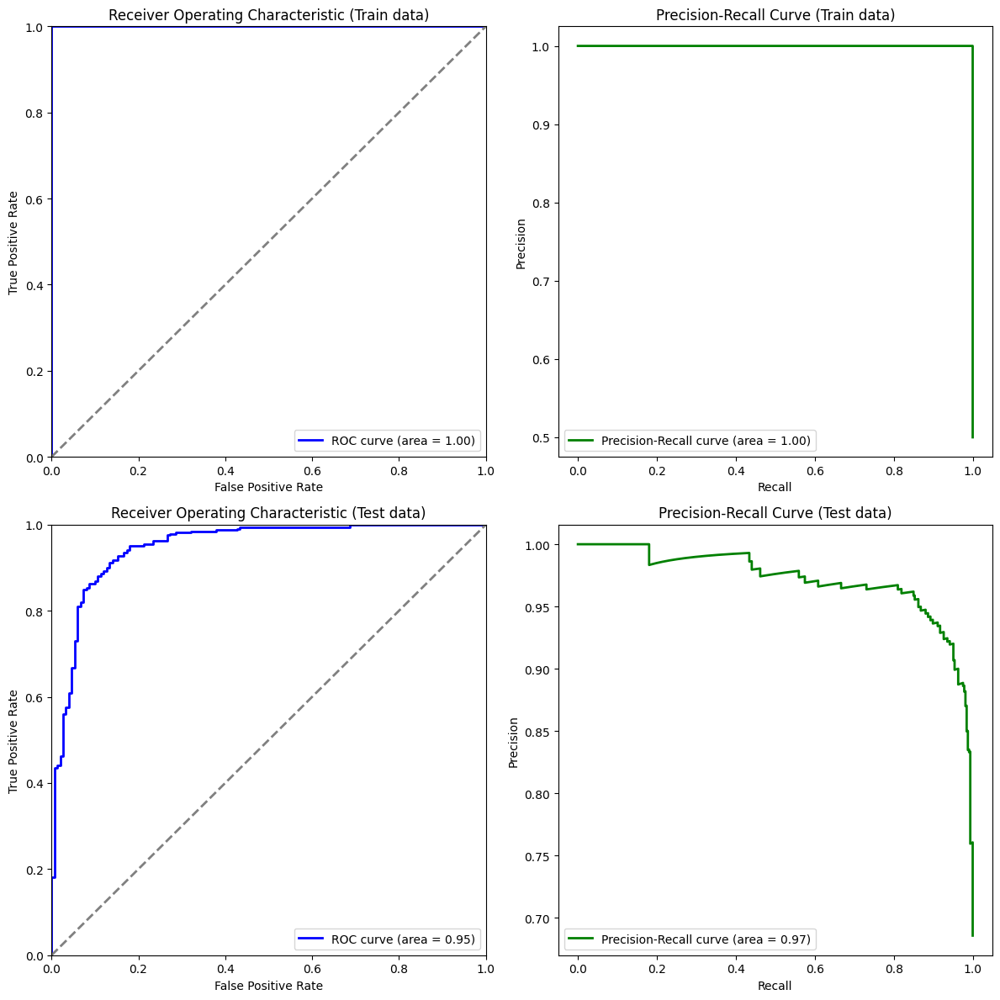

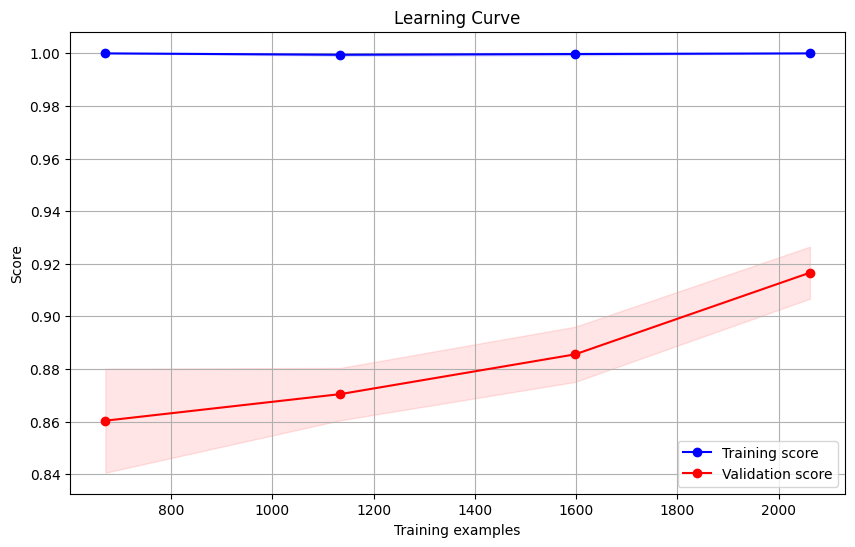

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Voting_Classifier_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## STACKING CLASSIFIER

### Imbalanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid for RandomizedSearchCV
start_tune_time = time.time()
param_dist = {
    'stack_method': ['auto', 'predict_proba', 'predict'],  # Methods for stacking
    'passthrough': [True, False],  # Whether to pass the original features to the final estimator
}

# Initialize the StackingClassifier
stacking_clf = StackingClassifier(
    estimators=models[1::2],  # The base models
    final_estimator=LogisticRegression(max_iter=10000, random_state=42),  # The final estimator
    n_jobs=-1  # Use all available cores
)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=stacking_clf,
    param_distributions=param_dist,
    n_iter=6,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit RandomizedSearchCV
random_search.fit(X_train_imb, y_train_imb)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning time:", tuning_time)


Fitting 5 folds for each of 6 candidates, totalling 30 fits
Best parameters found: {'stack_method': 'predict', 'passthrough': True}
Best score: 0.9133305705207901
Tuning time: 3721.9128143787384


#### Logging Best Stacking Classifier Model into MLFLOW

[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.6880247346154161, colsample_bytree=1.1159854502601791 will be ignored. Current value: feature_fraction=0.6880247346154161
[LightGBM] [Warning] bagging_fraction is set=0.7040356346288988, subsample=0.6488880503324447 will be ignored. Current value: bagging_fraction=0.7040356346288988
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] min_data_in_leaf is set=77, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=77
[LightGBM] [Warning] feature_fraction is set=0.6880247346154161, colsample_bytree=1.1159854502601791 will be ignored. Current value: feature_fraction=0.6880247346154161
[LightGBM] [Warning] bagging_fraction is set=0.7040356346288988, subsample=0.6488880503324447 will be ignored. Current value: bagging_fraction=0.704

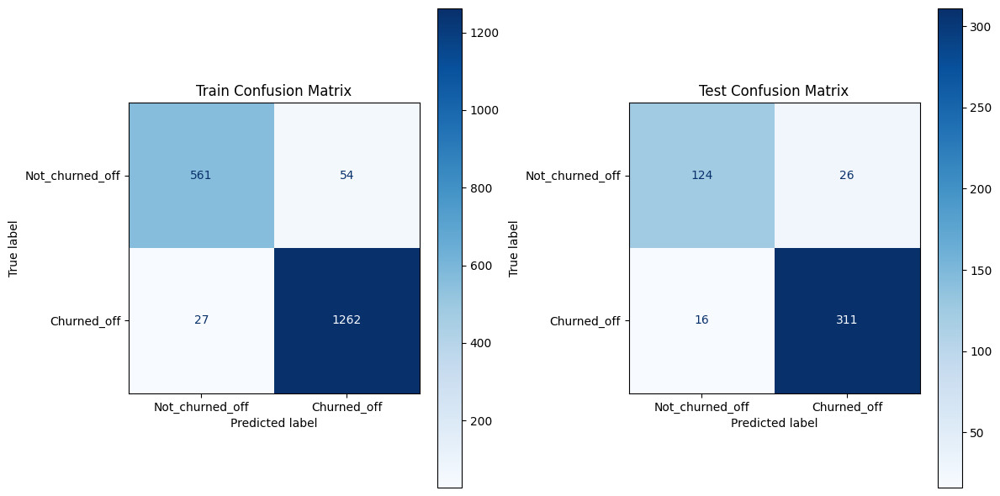

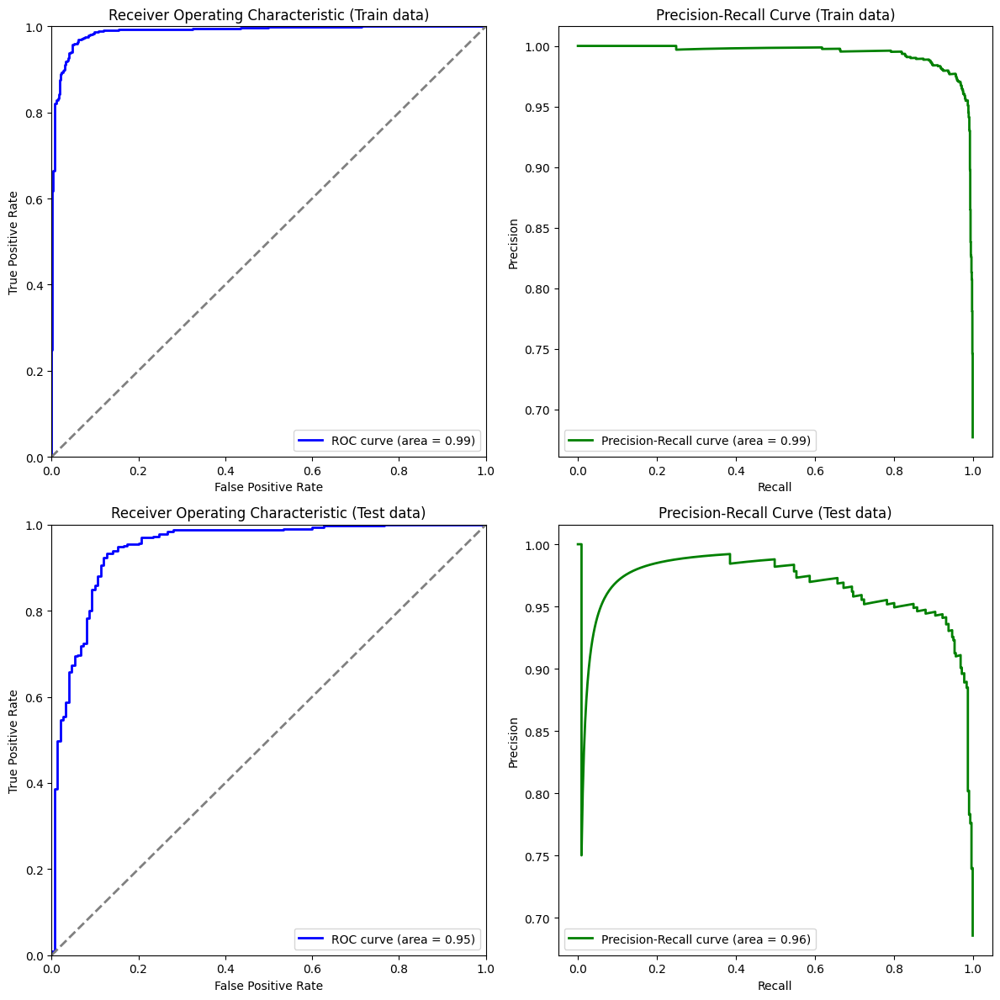

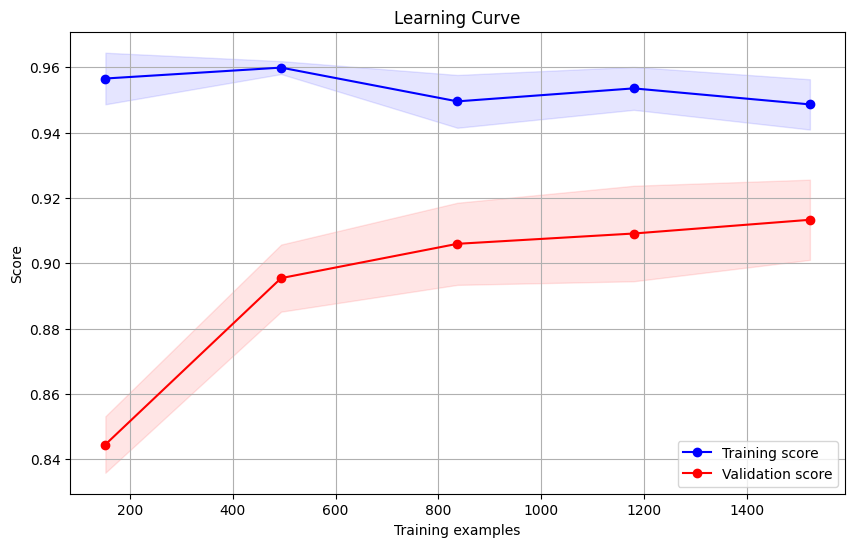

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Stacking_Classifier_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_imb, y_train_imb)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_imb_train = model.predict(X_train_imb)
y_pred_imb_test = model.predict(X_test_imb)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)

### Balanced Dataset

#### Hyper parameter Tuning

In [ ]:
# Define the parameter grid for RandomizedSearchCV
start_tune_time = time.time()
param_dist = {
    'stack_method': ['auto', 'predict_proba', 'predict'],  # Methods for stacking
    'passthrough': [True, False],  # Whether to pass the original features to the final estimator
}

# Initialize the StackingClassifier
stacking_clf = StackingClassifier(
    estimators=models[::2],  # The base models
    final_estimator=LogisticRegression(max_iter=10000, random_state=42),  # The final estimator
    n_jobs=-1  # Use all available cores
)

# Setup RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=stacking_clf,
    param_distributions=param_dist,
    n_iter=6,  # Number of parameter settings to try
    cv=5,  # Number of folds in cross-validation
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit RandomizedSearchCV
random_search.fit(X_train_bal, y_train_bal)

# Best model and hyperparameters
print("Best parameters found:", random_search.best_params_)
print("Best score:", random_search.best_score_)
tuning_score = random_search.best_score_
end_tune_time = time.time()
tuning_time = end_tune_time - start_tune_time
print("Tuning time:", tuning_time)


Fitting 5 folds for each of 6 candidates, totalling 30 fits
Best parameters found: {'stack_method': 'predict', 'passthrough': True}
Best score: 0.9228200496726122
Tuning time: 1385.157784461975


#### Logging Best Stacking Classifier Model into MLFLOW

[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] feature_fraction is set=0.7184404372168336, colsample_bytree=0.9565345704829102 will be ignored. Current value: feature_fraction=0.7184404372168336
[LightGBM] [Warning] bagging_fraction is set=0.795633685837714, subsample=0.917411003148779 will be ignored. Current value: bagging_fraction=0.795633685837714
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] feature_fraction is set=0.7184404372168336, colsample_bytree=0.9565345704829102 will be ignored. Current value: feature_fraction=0.7184404372168336
[LightGBM] [Warning] bagging_fraction is set=0.795633685837714, subsample=0.917411003148779 will be ignored. Current value: bagging_fraction=0.79563368

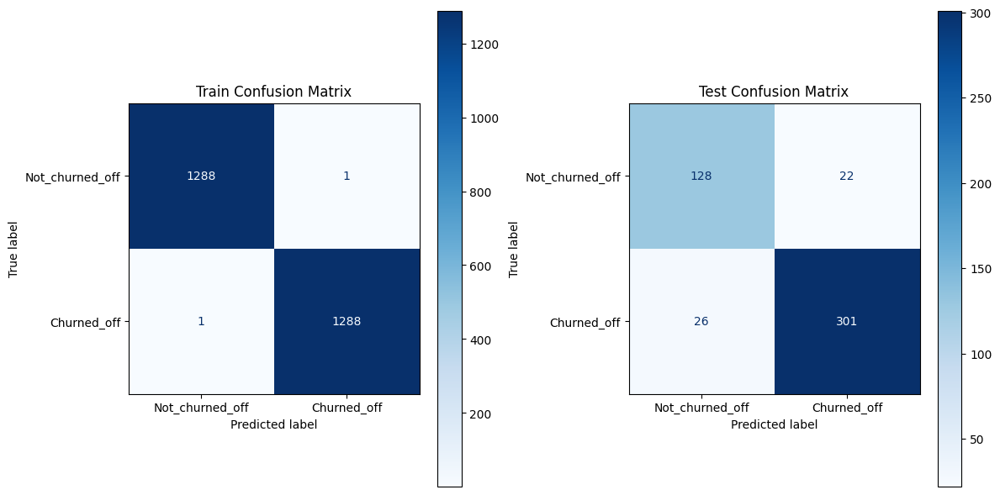

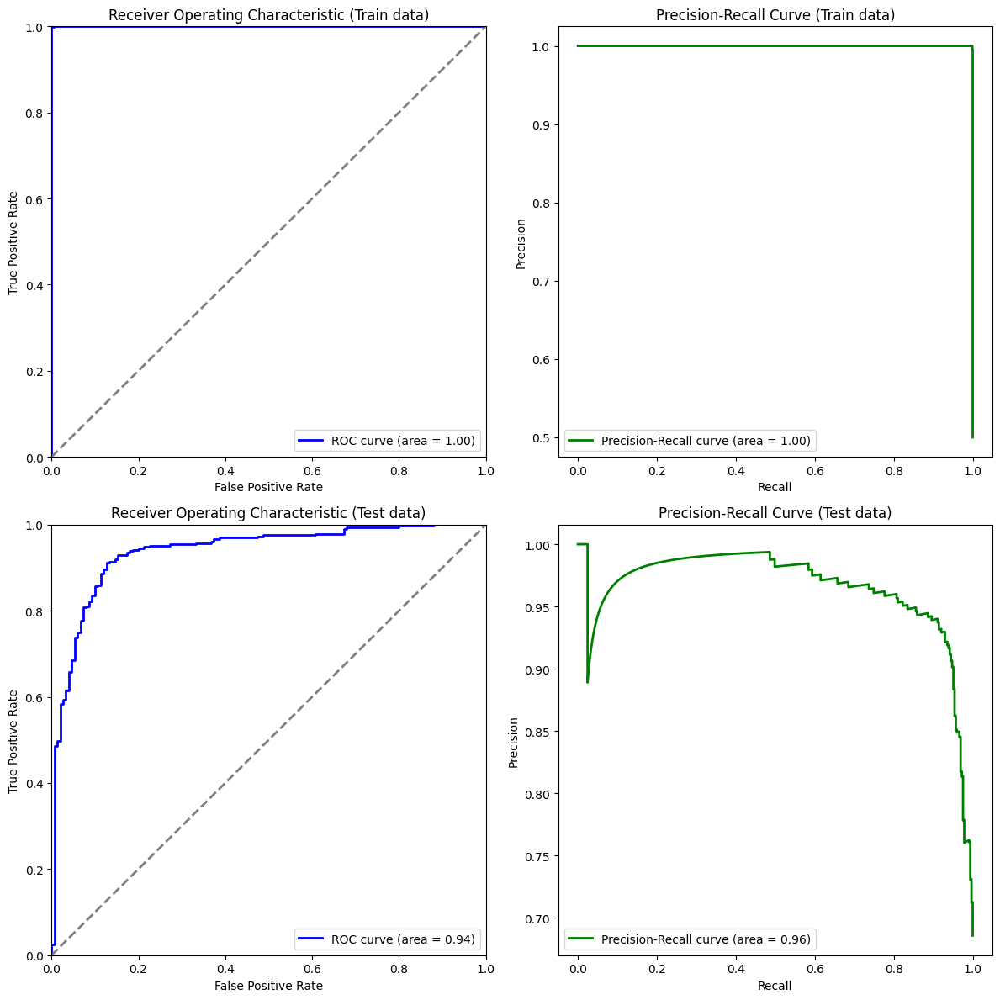

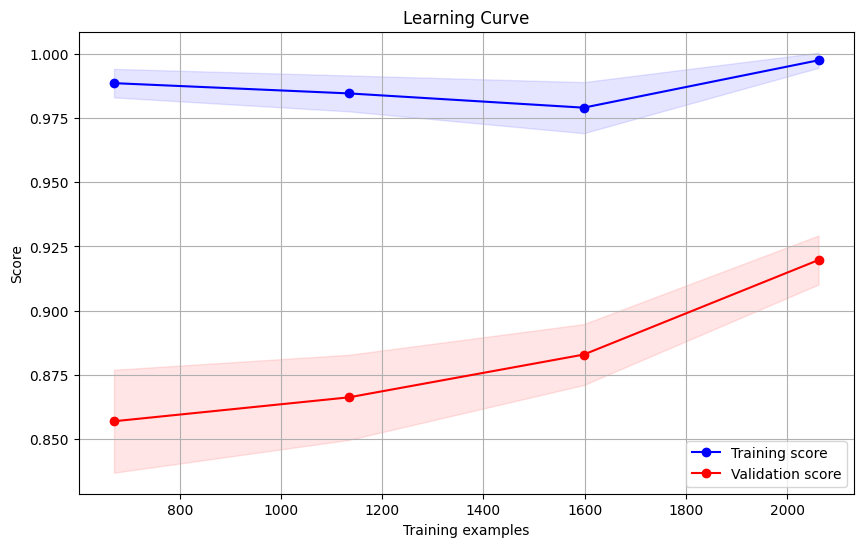

MLFLOW Logging is completed


In [ ]:
# Model details
name = "Tuned_Stacking_Classifier_on_Balanced_Dataset"
bal_type = "Balanced"
model = random_search.best_estimator_
params = random_search.best_params_

# Record training time
start_train_time = time.time()
model.fit(X_train_bal, y_train_bal)
end_train_time = time.time()

# Calculate training time
training_time = end_train_time - start_train_time

# Record testing time
start_test_time = time.time()
y_pred_bal_train = model.predict(X_train_bal)
y_pred_bal_test = model.predict(X_test_bal)
end_test_time = time.time()

# Calculate testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")
print(f"Tuning Time: {tuning_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,model,ola_features,bal_type,tuning_time)
mlflow_logging_and_metric_printing(model,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)

## CASCADING CLASSIFIER MODEL

### Imbalanced Dataset (Code from scratch)

In [ ]:
def load_model_from_run(run_id, run_name):
    # Construct the model URI
    model_uri = f"runs:/{run_id}/{run_name}_model"

    try:
        # Load the model
        model = mlflow.sklearn.load_model(model_uri)
        print(f"Loaded model from run {run_id} with run name {run_name}")
        return model
    except Exception as e:
        print(f"Failed to load model from run {run_id}: {e}")
        return None

# Example usage to load models
experiment = mlflow.get_experiment_by_name("Ola_Ensemble_Learning")
experiment_id = experiment.experiment_id

# Search for runs
runs = mlflow.search_runs(experiment_ids=[experiment_id])
run_ids = runs['run_id'].tolist()

# Load models
models = []
for run_id in run_ids:
    run = mlflow.get_run(run_id)
    run_name = run.info.run_name
    model = load_model_from_run(run_id, run_name)
    if model:
        models.append((f"model_{run_id}", model))
models = [i[1] for i in models]
print(models)

> Loaded model from run 081f39eda2ee48a0a5b63617f22e9ab3 with run name Tuned_Stacking_Classifier_on_Balanced_Dataset

> Loaded model from run 54f7b900538248c396eb076c95a1d717 with run name Tuned_Stacking_Classifier_on_Imbalanced_Dataset

> Loaded model from run ebda8eeaaff44d5abb19a8d48bf35300 with run name Tuned_Voting_Classifier_on_Balanced_Dataset

> Failed to load model from run 08a2273f534a4a5db7f59e667dc8698c: No such file or directory: 'C:\Users\saina\Desktop\DS_ML_AI\Scaler\Module_14_ML_Supervised_Algorithms\Case_study\Ola_Ensemble_learning_Case_study\main\mlruns\165809646674472470\08a2273f534a4a5db7f59e667dc8698c\artifacts\Tuned_Voting_Classifier_on_Imbalanced_Dataset_model'

> Loaded model from run eba5fab22ac34697bed53bb627af2c33 with run name Tuned_Light_GBM_on_Balanced_Dataset

> Loaded model from run 0c81cb30c10d4f56a99f55b2e9fb2d4c with run name Tuned_Light_GBM_on_Imbalanced_Dataset

> Loaded model from run 32171425fbf342ee9f549d502105a681 with run name Tuned_XG_boost_on_Balanced_Dataset

> Loaded model from run 2adb1674b77d4b9ba15c0c8978e82d50 with run name Tuned_XG_boost_on_Imbalanced_Dataset

> Loaded model from run 2576e8de75f841a5bbfc9aa9108e406d with run name Tuned_Gradient_boost_on_Balanced_Dataset

> Loaded model from run aef92e3ec93c485bb2457c0a4bd209d8 with run name Tuned_Gradient_boost_on_Imbalanced_Dataset

> Loaded model from run 6dce7745cea54262abfdd53e1081031c with run name Tuned_Adaboost_on_Balanced_Dataset

> Loaded model from run 0d740d00e0094d11b582f53aed58a72b with run name Tuned_Adaboost_on_Imbalanced_Dataset

> Loaded model from run 13b64ce985364b61ba859b705db9bac5 with run name Tuned_Bagging_RF_on_Balanced_Dataset

> Loaded model from run 907c9c90e757474bb2335a8d6155d157 with run name Tuned_Bagging_RF_on_Imbalanced_Dataset

> Loaded model from run 396f38da1e9d416bbd82023ff75cf227 with run name Tuned_Random_Forest_on_Balanced_Dataset

> Loaded model from run 60050ff4ee41446da38a6b38fa371520 with run name Tuned_Random_Forest_on_Imbalanced_Dataset

> Loaded model from run b64120f1fb98427ca7cce36345695bbf with run name Tuned_Decision_Tree_on_Balanced_Dataset

> Loaded model from run 43f861f9ac2041e0a2fd0663667b8129 with run name Tuned_Decision_Tree_on_Imbalanced_Dataset

> Loaded model from run 477ac0ff3c144d70af08a5747b5e8e96 with run name Tuned_SVC_on_Balanced_Dataset

> Loaded model from run 112add6166414f00887dcbea7fc6d86d with run name Tuned_SVC_on_Imbalanced_Dataset

> Loaded model from run 2897df0fb90d464c9c9195c03064411e with run name Tuned_KNN_on_Balanced_Dataset

> Loaded model from run 1c152ab6db5a4f2fbc1a457823c9f65f with run name Tuned_KNN_on_Imbalanced_Dataset

> Loaded model from run 4caa37eaa4964998b5ff0b94dae599b1 with run name Tuned_MLPClassifier_on_Balanced_Dataset

> Loaded model from run 1d7993e0c3124955a9b383b40b15ea48 with run name Tuned_MLPClassifier_on_Imbalanced_Dataset

> Loaded model from run 62fc0473d24b4f71babf471575f220cf with run name Tuned_Logistic_Regression_on_Balanced_Dataset

> Loaded model from run a2514820d45d41e5883b697be7f14629 with run name Tuned_Logistic_Regression_on_Imbalanced_Dataset

> Loaded model from run efea588e45d8474f83c3b0771dfa5709 with run name Simple_Logistic_Regresssion_on_balanced_Dataset

> Loaded model from run e624cb2d315c46f5a563c2e82653f175 with run name Simple_Logistic_Regression_on_Imbalanced_Dataset

> [StackingClassifier(estimators=[('model_eba5fab22ac34697bed53bb627af2c33',
                                LGBMClassifier(bagging_fraction=0.795633685837714,
                                               bagging_freq=5,
                                               boosting_type='dart',
                                               colsample_bytree=0.9565345704829102,
                                               feature_fraction=0.7184404372168336,
                                               learning_rate=0.13495298436110986,
                                               max_depth=13,
                                               min_child_samples=98,
                                               min_child_weight=0.03280034749718639,
                                               min_data_in_le...
                               ('model_62fc0473d24b4f71babf471575f220cf',
                                LogisticRegression(C=1872.706848835624,
                                                   class_weight='balanced',
                                                   max_iter=10000, penalty='l1',
                                                   random_state=42,
                                                   solver='saga')),
                               ('model_efea588e45d8474f83c3b0771dfa5709',
                                LogisticRegression(n_jobs=-1,
                                                   random_state=42))],
                   final_estimator=LogisticRegression(max_iter=10000,
                                                      random_state=42),
                   n_jobs=-1, passthrough=True, stack_method='predict'), StackingClassifier(estimators=[('model_0c81cb30c10d4f56a99f55b2e9fb2d4c',
                                LGBMClassifier(bagging_fraction=0.7040356346288988,
                                               bagging_freq=5,
                                               boosting_type='dart',
                                               colsample_bytree=1.1159854502601791,
                                               feature_fraction=0.6880247346154161,
                                               learning_rate=0.11661537060572182,
                                               max_depth=11,
                                               min_child_samples=45,
                                               min_child_weight=0.0015229613542912736,
                                               min_data_in...
                               ('model_a2514820d45d41e5883b697be7f14629',
                                LogisticRegression(C=1872.706848835624,
                                                   class_weight='balanced',
                                                   max_iter=10000, penalty='l1',
                                                   random_state=42,
                                                   solver='saga')),
                               ('model_e624cb2d315c46f5a563c2e82653f175',
                                LogisticRegression(n_jobs=-1,
                                                   random_state=42))],
                   final_estimator=LogisticRegression(max_iter=10000,
                                                      random_state=42),
                   n_jobs=-1, passthrough=True, stack_method='predict'), VotingClassifier(estimators=[('model_eba5fab22ac34697bed53bb627af2c33',
                              LGBMClassifier(bagging_fraction=0.795633685837714,
                                             bagging_freq=5,
                                             boosting_type='dart',
                                             colsample_bytree=0.9565345704829102,
                                             feature_fraction=0.7184404372168336,
                                             learning_rate=0.13495298436110986,
                                             max_depth=13, min_child_samples=98,
                                             min_child_weight=0.03280034749718639,
                                             min_data_in_leaf...
                                                 class_weight='balanced',
                                                 max_iter=10000, penalty='l1',
                                                 random_state=42,
                                                 solver='saga')),
                             ('model_efea588e45d8474f83c3b0771dfa5709',
                              LogisticRegression(n_jobs=-1, random_state=42))],
                 n_jobs=-1, voting='soft',
                 weights=[1.0, 0.5, 0.3333333333333333, 0.25, 0.2,
                          0.16666666666666666, 0.14285714285714285, 0.125,
                          0.1111111111111111, 0.1, 0.09090909090909091,
                          0.08333333333333333]), LGBMClassifier(bagging_fraction=0.795633685837714, bagging_freq=5,
               boosting_type='dart', colsample_bytree=0.9565345704829102,
               feature_fraction=0.7184404372168336,
               learning_rate=0.13495298436110986, max_depth=13,
               min_child_samples=98, min_child_weight=0.03280034749718639,
               min_data_in_leaf=20, min_split_gain=0.02279351625419417,
               n_estimators=732, num_leaves=135, objective='binary',
               random_state=42, reg_alpha=0.4303652916281717,
               reg_lambda=0.510428195796786,
               scale_pos_weight=1.5214946051551315,
               subsample=0.917411003148779), LGBMClassifier(bagging_fraction=0.7040356346288988, bagging_freq=5,
               boosting_type='dart', colsample_bytree=1.1159854502601791,
               feature_fraction=0.6880247346154161,
               learning_rate=0.11661537060572182, max_depth=11,
               min_child_samples=45, min_child_weight=0.0015229613542912736,
               min_data_in_leaf=77, min_split_gain=0.003531135494023907,
               n_estimators=308, num_leaves=33, objective='binary',
               random_state=42, reg_alpha=0.4790367400596901,
               reg_lambda=1.0519111269531267,
               scale_pos_weight=1.1538632326761582,
               subsample=0.6488880503324447), XGBClassifier(base_score=None, booster='dart', callbacks=None,
              colsample_bylevel=0.8350373297259278,
              colsample_bynode=0.7680894083096093,
              colsample_bytree=0.9668172748386532, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None,
              gamma=0.22530982836487895, grow_policy='depthwise',
              importance_type=None, interaction_constraints=None,
              learning_rate=0.055050700245112494, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=14, max_leaves=None,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=186, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...), XGBClassifier(base_score=None, booster='dart', callbacks=None,
              colsample_bylevel=0.9526356769407125,
              colsample_bynode=0.9514986114133412,
              colsample_bytree=0.840607947938491, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None,
              gamma=0.2074097511688326, grow_policy='depthwise',
              importance_type=None, interaction_constraints=None,
              learning_rate=0.014101589448099186, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=9, max_leaves=None,
              min_child_weight=6, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=575, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...), GradientBoostingClassifier(learning_rate=0.07858754845747705, max_depth=9,
                           max_features='log2',
                           min_impurity_decrease=0.0001120111480109487,
                           min_samples_leaf=2, min_samples_split=15,
                           n_estimators=688, random_state=42,
                           subsample=0.8522403201282508), GradientBoostingClassifier(learning_rate=0.06676646193550176, max_depth=7,
                           max_features='log2',
                           min_impurity_decrease=0.09613152881849074,
                           min_samples_leaf=19, min_samples_split=11,
                           n_estimators=493, random_state=42,
                           subsample=0.94598407522243), AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=5),
                   learning_rate=0.9000053418175663, n_estimators=520,
                   random_state=42), AdaBoostClassifier(algorithm='SAMME',
                   estimator=DecisionTreeClassifier(max_depth=5),
                   learning_rate=0.1370605126518848, n_estimators=313,
                   random_state=42), BaggingClassifier(bootstrap=False,
                  estimator=RandomForestClassifier(class_weight='balanced',
                                                   criterion='log_loss',
                                                   max_depth=20,
                                                   max_leaf_nodes=20,
                                                   n_estimators=5,
                                                   oob_score=True,
                                                   random_state=42),
                  max_features=0.9631385219890038,
                  max_samples=0.9803599686384168, n_estimators=154,
                  random_state=42), BaggingClassifier(bootstrap=False,
                  estimator=RandomForestClassifier(class_weight='balanced',
                                                   criterion='log_loss',
                                                   max_depth=20,
                                                   max_leaf_nodes=20,
                                                   n_estimators=5,
                                                   oob_score=True,
                                                   random_state=42),
                  max_features=0.9631385219890038,
                  max_samples=0.9803599686384168, n_estimators=154, n_jobs=-1,
                  random_state=42), RandomForestClassifier(ccp_alpha=0.028792961647572612, class_weight='balanced',
                       criterion='log_loss', max_depth=13, max_leaf_nodes=14,
                       min_impurity_decrease=0.013911619414306187,
                       min_samples_leaf=18,
                       min_weight_fraction_leaf=0.009055091910420254,
                       n_estimators=877, oob_score=True, random_state=42), RandomForestClassifier(ccp_alpha=0.028792961647572612, class_weight='balanced',
                       criterion='log_loss', max_depth=13, max_leaf_nodes=14,
                       min_impurity_decrease=0.013911619414306187,
                       min_samples_leaf=18,
                       min_weight_fraction_leaf=0.009055091910420254,
                       n_estimators=877, oob_score=True, random_state=42), DecisionTreeClassifier(ccp_alpha=0.011483682473920355, criterion='entropy',
                       max_depth=15, max_features='log2', max_leaf_nodes=39,
                       min_impurity_decrease=0.05812382214226123,
                       min_samples_leaf=11, min_samples_split=5,
                       min_weight_fraction_leaf=0.16032109607975714,
                       random_state=42), DecisionTreeClassifier(ccp_alpha=0.01504168911035282, max_depth=18,
                       max_leaf_nodes=34,
                       min_impurity_decrease=0.046869315979497034,
                       min_samples_leaf=3,
                       min_weight_fraction_leaf=0.0068359824134986424,
                       random_state=42), SVC(C=81.5862458136845, class_weight='balanced', degree=2, gamma='auto',
    max_iter=1677, probability=True, random_state=42), SVC(C=6.436932213118794, class_weight='balanced', degree=4, gamma='auto',
    max_iter=1130, probability=True, random_state=42), KNeighborsClassifier(algorithm='ball_tree', leaf_size=49, n_neighbors=16, p=1,
                     weights='distance'), KNeighborsClassifier(algorithm='kd_tree', leaf_size=28, metric='manhattan',
                     n_neighbors=11, p=3, weights='distance'), MLPClassifier(activation='logistic', alpha=3.893929205071642,
              hidden_layer_sizes=(50,), learning_rate_init=0.030524224295953774,
              max_iter=221, random_state=42), MLPClassifier(activation='logistic', alpha=3.893929205071642,
              hidden_layer_sizes=(50,), learning_rate_init=0.030524224295953774,
              max_iter=221, random_state=42), LogisticRegression(C=1872.706848835624, class_weight='balanced', max_iter=10000,
                   penalty='l1', random_state=42, solver='saga'), LogisticRegression(C=1872.706848835624, class_weight='balanced', max_iter=10000,
                   penalty='l1', random_state=42, solver='saga'), LogisticRegression(n_jobs=-1, random_state=42), LogisticRegression(n_jobs=-1, random_state=42)]

In [ ]:
# Model details
name = "Two_Level_Cascading_Classifier_on_Imbalanced_Dataset"
bal_type = "Imbalanced"
params = {}
tuning_score = 0

# Models are selectef form MLFLOW and Refined to avoid any errors
cascade_models = models[6::2]

# Train first-level models and collect predictions
def train_first_level_models(models, X_train, y_train):
    predictions_train = []
    for model in models:
        model.fit(X_train, y_train)
        preds = model.predict(X_train).reshape(-1, 1)
        probas = model.predict_proba(X_train)
        predictions_train.append(np.hstack((preds, probas)))
    return predictions_train

def transform_features(preds_list, X):
    transformed_features = []
    for model, preds in zip(cascade_models, preds_list):
        preds_test = model.predict(X).reshape(-1, 1)
        probas_test = model.predict_proba(X)
        transformed_features.append(np.hstack((preds_test, probas_test)))
    return np.hstack(transformed_features)

# Collect predictions from the first-level models
start_train_time = time.time()
first_level_train_preds = train_first_level_models(cascade_models, X_train_imb, y_train_imb)
X_train_level2 = np.hstack(first_level_train_preds)

# Define and train the second-level model
second_level_model = LGBMClassifier(random_state=42)
second_level_model.fit(X_train_level2, y_train_imb)
end_train_time = time.time()

# training_time
training_time = end_train_time - start_train_time

# Prepare test data for the second level
start_test_time = time.time()
first_level_train_preds = [model.predict(X_train_imb).reshape(-1, 1) for model in cascade_models]
first_level_test_preds = [model.predict(X_test_imb).reshape(-1, 1) for model in cascade_models]

first_level_train_probas = [model.predict_proba(X_train_imb) for model in cascade_models]
first_level_test_probas = [model.predict_proba(X_test_imb) for model in cascade_models]

X_train_level2 = np.hstack(first_level_train_preds + first_level_train_probas)
X_test_level2 = np.hstack(first_level_test_preds + first_level_test_probas)

# Make final predictions
y_pred_imb_train = second_level_model.predict(X_train_level2)
y_pred_imb_test = second_level_model.predict(X_test_level2)
end_test_time = time.time()

# testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,cascade_models,ola_features,bal_type)
mlflow_logging_and_metric_printing(cascade_models,name,bal_type,X_train_imb,y_train_imb,X_test_imb,y_test_imb,y_pred_imb_train,y_pred_imb_test,tuning_score,**params)


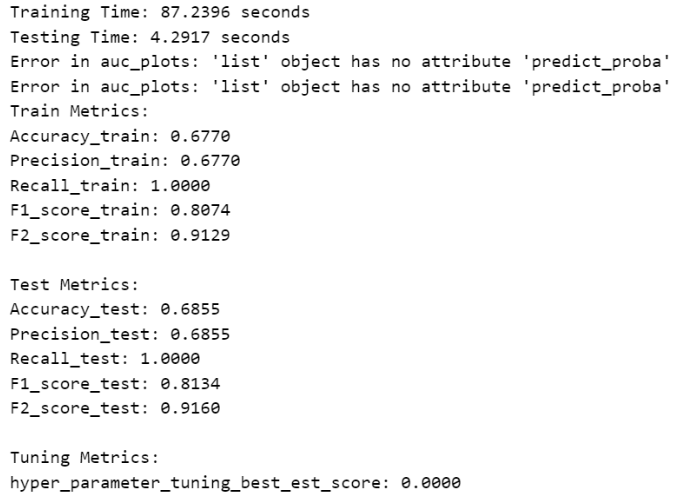

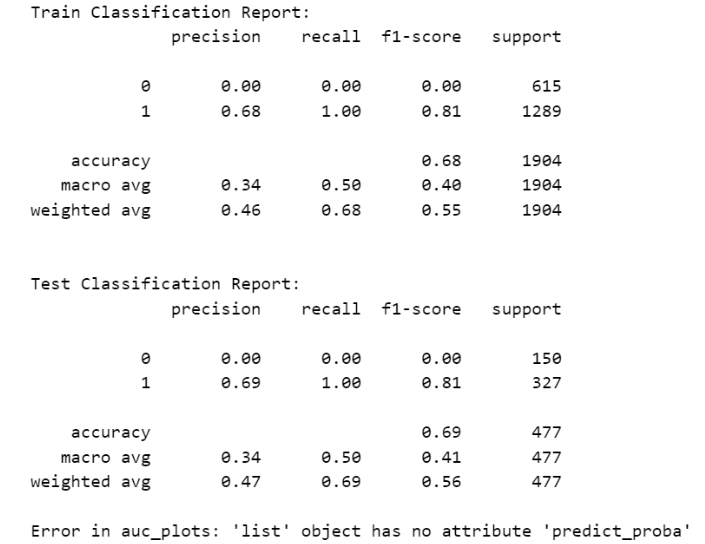

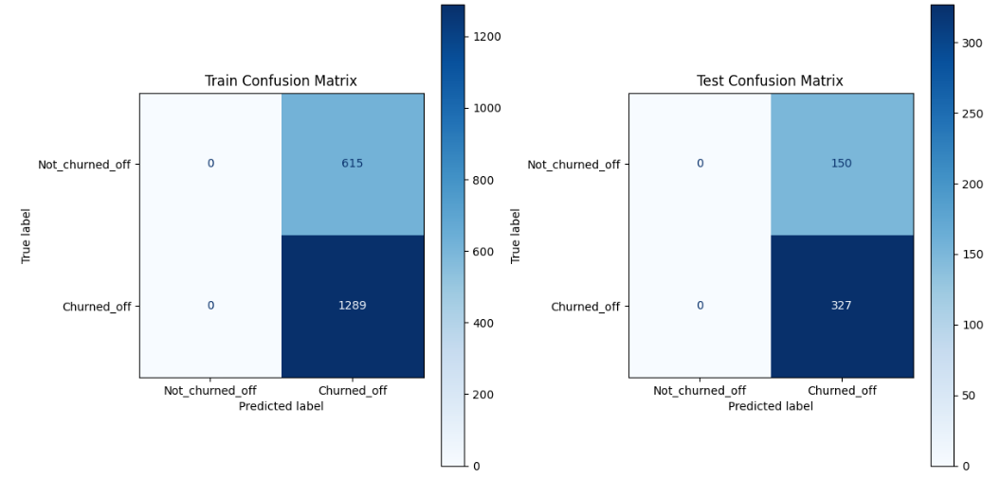

### Balanced Dataset

In [ ]:
# Model details
name = "Two_Level_Cascading_Classifier_on_Balanced_Dataset"
bal_type = "Balanced"
params = {}
tuning_score = 0

# Models are selectef form MLFLOW and Refined to avoid any errors
cascade_models = models[5::2]

# Train first-level models and collect predictions
def train_first_level_models(models, X_train, y_train):
    predictions_train = []
    for model in models:
        model.fit(X_train, y_train)
        preds = model.predict(X_train).reshape(-1, 1)
        probas = model.predict_proba(X_train)
        predictions_train.append(np.hstack((preds, probas)))
    return predictions_train

def transform_features(preds_list, X):
    transformed_features = []
    for model, preds in zip(cascade_models, preds_list):
        preds_test = model.predict(X).reshape(-1, 1)
        probas_test = model.predict_proba(X)
        transformed_features.append(np.hstack((preds_test, probas_test)))
    return np.hstack(transformed_features)

# Collect predictions from the first-level models
start_train_time = time.time()
first_level_train_preds = train_first_level_models(cascade_models, X_train_bal, y_train_bal)
X_train_level2 = np.hstack(first_level_train_preds)

# Define and train the second-level model
second_level_model = LGBMClassifier(random_state=42)
second_level_model.fit(X_train_level2, y_train_bal)
end_train_time = time.time()

# training_time
training_time = end_train_time - start_train_time

# Prepare test data for the second level
start_test_time = time.time()
first_level_train_preds = [model.predict(X_train_bal).reshape(-1, 1) for model in cascade_models]
first_level_test_preds = [model.predict(X_test_bal).reshape(-1, 1) for model in cascade_models]

first_level_train_probas = [model.predict_proba(X_train_bal) for model in cascade_models]
first_level_test_probas = [model.predict_proba(X_test_bal) for model in cascade_models]

X_train_level2 = np.hstack(first_level_train_preds + first_level_train_probas)
X_test_level2 = np.hstack(first_level_test_preds + first_level_test_probas)

# Make final predictions
y_pred_bal_train = second_level_model.predict(X_train_level2)
y_pred_bal_test = second_level_model.predict(X_test_level2)
end_test_time = time.time()

# testing time
testing_time = end_test_time - start_test_time

# Print model name and times
print(f"Model: {name}")
print(f"params: {params}")
print(f"Training Time: {training_time:.4f} seconds")
print(f"Testing Time: {testing_time:.4f} seconds")

# logging time_df, feature_importance_df, mlflow_logging_and_metric_printing
time_df,feature_importance_df = log_time_and_feature_importances_df(time_df,feature_importance_df,name,training_time,testing_time,cascade_models,ola_features,bal_type)
mlflow_logging_and_metric_printing(cascade_models,name,bal_type,X_train_bal,y_train_bal,X_test_bal,y_test_bal,y_pred_bal_train,y_pred_bal_test,tuning_score,**params)


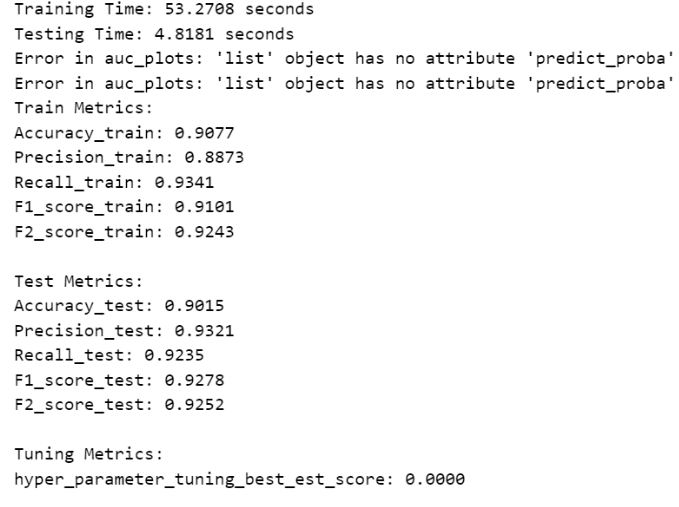

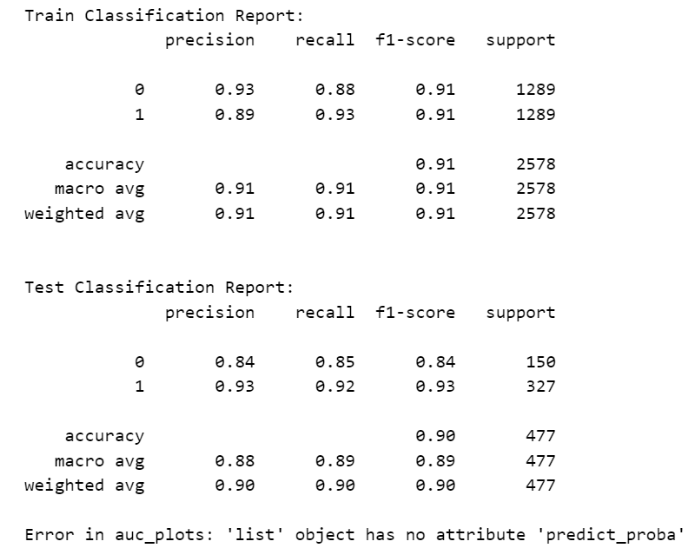

![image.png](attachment:image.png)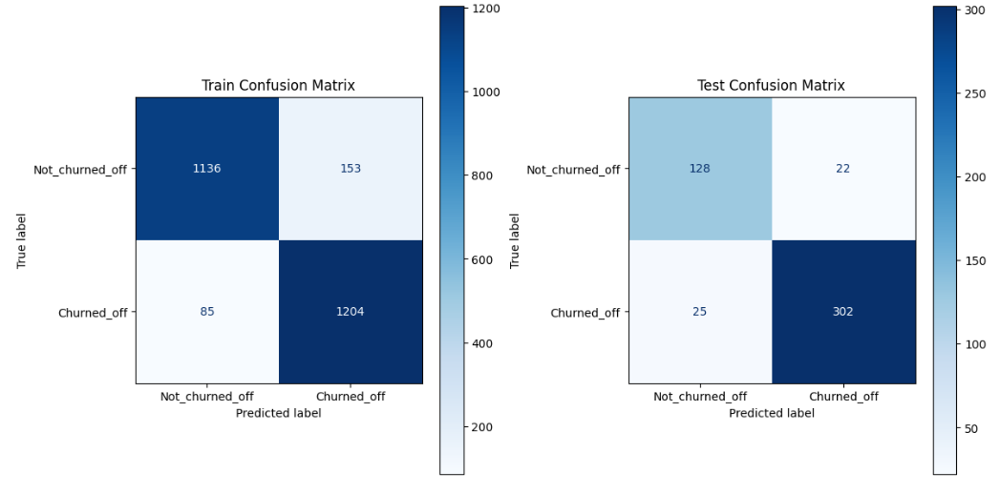

# CHAPTER 6 RESULTS EVALUATION

## ALL_LOGGED_METRICS

In [ ]:
all_logged_metrics_df = all_logged_metrics()
all_logged_metrics_df

,run_name,bal_type,params_dict,metrics.Accuracy_test,metrics.Accuracy_train,metrics.F1_score_test,metrics.F1_score_train,metrics.F2_score_test,metrics.F2_score_train,metrics.Pr_auc_test,metrics.Pr_auc_train,metrics.Precision_test,metrics.Precision_train,metrics.Recall_test,metrics.Recall_train,metrics.Roc_auc_test,metrics.Roc_auc_train,metrics.hyper_parameter_tuning_best_est_score
0,Two_Level_Cascading_Classifier_on_Balanced_Dat...,Balanced,{'params.bal_type': 'Balanced'},0.901468,0.907680,0.927803,0.910053,0.925245,0.924305,NaN,NaN,0.932099,0.887251,0.923547,0.934057,NaN,NaN,0.000000
1,Two_Level_Cascading_Classifier_on_Imbalanced_D...,Imbalanced,{'params.bal_type': 'Imbalanced'},0.685535,0.676996,0.813433,0.807391,0.915966,0.912890,NaN,NaN,0.685535,0.676996,1.000000,1.000000,NaN,NaN,0.000000
2,Tuned_Stacking_Classifier_on_Balanced_Dataset,Balanced,"{'params.bal_type': 'Balanced', 'params.passth...",0.899371,0.999224,0.926154,0.999224,0.922747,0.999224,0.963908,0.999996,0.931889,0.999224,0.920489,0.999224,0.938899,0.999996,0.922820
3,Tuned_Stacking_Classifier_on_Imbalanced_Dataset,Imbalanced,"{'params.bal_type': 'Imbalanced', 'params.pass...",0.911950,0.957458,0.936747,0.968906,0.945289,0.974969,0.963391,0.993925,0.922849,0.958967,0.951070,0.979054,0.947971,0.988263,0.913331
4,Tuned_Voting_Classifier_on_Balanced_Dataset,Balanced,"{'params.bal_type': 'Balanced', 'params.voting...",0.899371,1.000000,0.925926,1.000000,0.920810,1.000000,0.971881,1.000000,0.934579,1.000000,0.917431,1.000000,0.949541,1.000000,0.916998
5,Tuned_Voting_Classifier_on_Imbalanced_Dataset,Imbalanced,"{'params.bal_type': 'Imbalanced', 'params.voti...",0.916143,0.941702,0.940120,0.957455,0.952092,0.964330,NaN,NaN,0.920821,0.946212,0.960245,0.968968,NaN,NaN,0.913854
6,Tuned_Light_GBM_on_Balanced_Dataset,Balanced,"{'params.bal_type': 'Balanced', 'params.learni...",0.886792,1.000000,0.916667,1.000000,0.911602,1.000000,0.966628,1.000000,0.925234,1.000000,0.908257,1.000000,0.942712,1.000000,0.910406
7,Tuned_Light_GBM_on_Imbalanced_Dataset,Imbalanced,"{'params.bal_type': 'Imbalanced', 'params.lear...",0.916143,0.938550,0.939940,0.955121,0.950213,0.961538,0.968791,0.992846,0.923304,0.944613,0.957187,0.965865,0.956962,0.985067,0.914903
8,Tuned_XG_boost_on_Balanced_Dataset,Balanced,"{'params.bal_type': 'Balanced', 'params.learni...",0.895178,0.999612,0.923077,0.999612,0.919681,0.999845,0.965202,1.000000,0.928793,0.999225,0.917431,1.000000,0.947706,1.000000,0.918547
9,Tuned_XG_boost_on_Imbalanced_Dataset,Imbalanced,"{'params.bal_type': 'Imbalanced', 'params.lear...",0.909853,0.955882,0.936107,0.968037,0.952237,0.979215,0.968922,0.995976,0.910405,0.949963,0.963303,0.986811,0.956901,0.991914,0.912279


### Fill zero inplace of Null values

In [ ]:
all_logged_metrics_df.fillna(value = 0,inplace=True)

### all_logged_metrics_df_plots

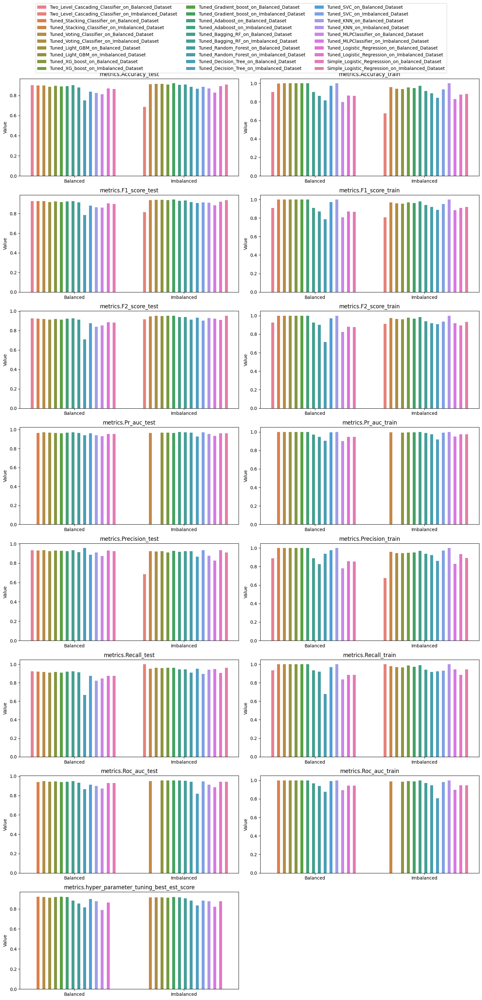

In [ ]:
all_logged_metrics_df_plots(all_logged_metrics_df)

### printing best models according to each metric

In [ ]:
# Assuming your DataFrame is named 'all_logged_metrics_df'
metrics_columns = all_logged_metrics_df.columns[all_logged_metrics_df.columns.str.startswith('metrics.')]

for metric in metrics_columns:
    best_model = all_logged_metrics_df.loc[all_logged_metrics_df[metric].idxmax(), 'run_name']
    best_params = all_logged_metrics_df.loc[all_logged_metrics_df[metric].idxmax(), 'params_dict']
    print(f"{metric} -> best_model -> \"{best_model}\", best_params -> {best_params}")


metrics.Accuracy_test -> best_model -> "Tuned_Gradient_boost_on_Imbalanced_Dataset", best_params -> {'params.bal_type': 'Imbalanced', 'params.learning_rate': '0.06676646193550176', 'params.random_state': '42', 'params.subsample': '0.94598407522243', 'params.max_depth': '7', 'params.n_estimators': '493', 'params.min_impurity_decrease': '0.09613152881849074', 'params.min_samples_leaf': '19', 'params.max_features': 'log2', 'params.min_samples_split': '11'}
metrics.Accuracy_train -> best_model -> "Tuned_Voting_Classifier_on_Balanced_Dataset", best_params -> {'params.bal_type': 'Balanced', 'params.voting': 'soft', 'params.weights': '[1.0, 0.5, 0.3333333333333333, 0.25, 0.2, 0.16666666666666666, 0.14285714285714285, 0.125, 0.1111111111111111, 0.1, 0.09090909090909091, 0.08333333333333333]', 'params.n_jobs': '-1'}
metrics.F1_score_test -> best_model -> "Tuned_Gradient_boost_on_Imbalanced_Dataset", best_params -> {'params.bal_type': 'Imbalanced', 'params.learning_rate': '0.06676646193550176', 

**Observation**
> On train dataset, KNN is dominating in on trained models. Because KNN has no training time. It simply stores the entire training dataset in memory. Voting Classifier on Balanced Dataset has 100% on most metrics of train dataset

> On test dataset, Boosting algorithms like GBDT, Adaboost, XGBoost, Light_GBM are performing better than Bagging and Stacking.

> Cascading and Stacking ensemble learning techniques provide best models but so slow

> Boosting models are provide next best models but very fast. Sufficient for this dataset  

> Balanced Dataset has more generalization than Imbalanced Datasets.

> Algorithms like Adaboost, LightGBM works better on Imbalanced Datsets also.

> Recall is important in this Case Study because in a churn prediction scenario, missing a churned driver (false negative) can be costly for a business. If the model fails to identify a driver who is likely to churn, the company loses the opportunity to intervene (e.g., offering incentives or addressing issues) to retain the driver.

> So on Recall_test --> Cascading on Imbalanced , F2 Score_test --> Gradient boost on balanced, Pr_auc_test --> Adaboost on Imbalanced Models are dominating. Clearly Boosting is effective.

> But because of lack of much data, The max_accuracy_test is limited to 92%, max_recall_test is limited to 96%

## TIME_DF AND ITS PLOT

### time_df_plots

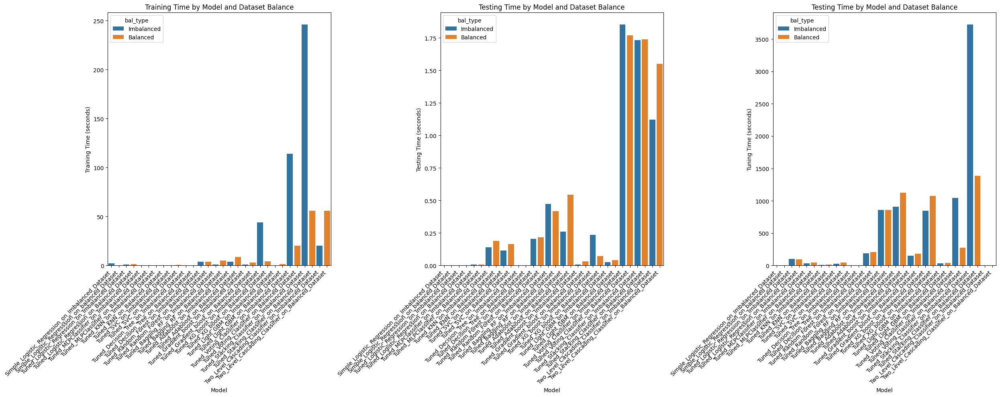

In [ ]:
time_df_plots(time_df)

**Observation**
> Training_time and testing_time is more for ensemble models because of combination of individual models

> clearly balanced dataset has more training time and testing time compared to imbalanced dataset because of oversampling

> Stacking hyper parametric tuning has more time taken.

> Hyper parametric tuning of ensemble models are significantly higher than individual models  

## FEATURE IMPORTANCE DF

In [ ]:
feature_importance_df

,Simple_Logistic_Regression_on_Imbalanced_Dataset,Simple_Logistic_Regresssion_on_balanced_Dataset,Tuned_Logistic_Regression_on_Imbalanced_Dataset,Tuned_Logistic_Regression_on_Balanced_Dataset,Tuned_Decision_Tree_on_Imbalanced_Dataset,Tuned_Decision_Tree_on_Balanced_Dataset,Tuned_Random_Forest_on_Imbalanced_Dataset,Tuned_Random_Forest_on_Balanced_Dataset,Tuned_Adaboost_on_Imbalanced_Dataset,Tuned_Adaboost_on_Balanced_Dataset,Tuned_Gradient_boost_on_Imbalanced_Dataset,Tuned_Gradient_boost_on_Balanced_Dataset,Tuned_XG_boost_on_Imbalanced_Dataset,Tuned_XG_boost_on_Balanced_Dataset,Tuned_Light_GBM_on_Imbalanced_Dataset,Tuned_Light_GBM_on_Balanced_Dataset
Age,0.109896,0.095305,0.135382,0.114213,0.00000,0.000000,0.000247,0.000588,6.314434e-02,1.072546e-01,0.010894,2.233592e-02,0.010045,0.010969,141,2362
City,0.069281,0.098565,0.083032,0.091471,0.00000,0.000000,0.000000,0.000000,4.760089e-02,1.298196e-01,0.010858,2.664572e-02,0.009428,0.012143,221,3068
Education_Level,0.037378,0.256508,0.088890,0.288007,0.00000,0.000000,0.000000,0.000000,1.760755e-02,3.317097e-02,0.002599,9.719161e-03,0.009156,0.012719,24,542
Gender,0.047752,0.335353,0.051474,0.345657,0.00000,0.000000,0.000000,0.001334,4.308098e-03,1.871191e-02,0.001942,8.120786e-03,0.008312,0.015871,25,366
Grade,-0.778416,-0.293402,-0.640852,-0.154351,0.00000,0.000000,0.005073,0.001030,3.782188e-03,1.633346e-02,0.007243,8.943055e-03,0.011849,0.012438,39,274
Grade_raise,-0.200566,0.095718,-0.364203,0.077249,0.00000,0.000000,0.000139,0.000046,6.737049e-18,1.590947e-13,0.000000,7.419100e-05,0.000000,0.006970,0,0
Income_raise,-0.200566,0.095718,-0.364203,0.077249,0.00000,0.000000,0.000059,0.000270,5.466737e-18,0.000000e+00,0.000000,2.278973e-03,0.000000,0.000000,0,0
Income_range,0.722095,0.239048,1.126104,0.368688,0.00000,0.000000,0.000214,0.000801,1.180588e-04,2.689280e-06,0.000000,6.836883e-03,0.000000,0.005333,0,0
Join_month,-0.365371,-0.312485,-0.389475,-0.317873,0.00000,0.000000,0.006255,0.001465,7.181951e-02,1.074560e-01,0.031496,4.425638e-02,0.024300,0.017636,264,2530
Join_year,-2.013868,-2.256950,-2.588902,-2.569129,0.00000,0.377202,0.186109,0.170910,1.735583e-01,2.629639e-02,0.188310,1.814671e-01,0.110274,0.126778,320,1067


In [ ]:
# normalizing the values
scaler = StandardScaler()
feature_importance_scaled = pd.DataFrame(scaler.fit_transform(feature_importance_df),
                                         index=feature_importance_df.index,
                                         columns=feature_importance_df.columns)
feature_importance_scaled

,Simple_Logistic_Regression_on_Imbalanced_Dataset,Simple_Logistic_Regresssion_on_balanced_Dataset,Tuned_Logistic_Regression_on_Imbalanced_Dataset,Tuned_Logistic_Regression_on_Balanced_Dataset,Tuned_Decision_Tree_on_Imbalanced_Dataset,Tuned_Decision_Tree_on_Balanced_Dataset,Tuned_Random_Forest_on_Imbalanced_Dataset,Tuned_Random_Forest_on_Balanced_Dataset,Tuned_Adaboost_on_Imbalanced_Dataset,Tuned_Adaboost_on_Balanced_Dataset,Tuned_Gradient_boost_on_Imbalanced_Dataset,Tuned_Gradient_boost_on_Balanced_Dataset,Tuned_XG_boost_on_Imbalanced_Dataset,Tuned_XG_boost_on_Balanced_Dataset,Tuned_Light_GBM_on_Imbalanced_Dataset,Tuned_Light_GBM_on_Balanced_Dataset
Age,0.265722,0.221225,0.243013,0.202165,-0.246288,-0.331260,-0.644419,-0.625474,0.638896,1.704283,-0.479774,-0.268031,-0.364567,-0.333042,0.452439,1.324696
City,0.232419,0.223468,0.210920,0.189602,-0.246288,-0.331260,-0.649228,-0.636701,0.305776,2.224529,-0.480545,-0.162992,-0.374230,-0.315556,1.221456,1.995708
Education_Level,0.206260,0.332120,0.214511,0.298172,-0.246288,-0.331260,-0.649228,-0.636701,-0.337028,-0.003743,-0.657126,-0.575528,-0.378478,-0.306986,-0.672250,-0.405110
Gender,0.214766,0.386360,0.191574,0.330019,-0.246288,-0.331260,-0.649228,-0.611229,-0.622056,-0.337103,-0.671160,-0.614484,-0.391687,-0.260038,-0.662637,-0.572388
Grade,-0.462668,-0.046176,-0.232848,0.053805,-0.246288,-0.331260,-0.550416,-0.617031,-0.633327,-0.391939,-0.557831,-0.594443,-0.336328,-0.311162,-0.528059,-0.659829
Grade_raise,0.011152,0.221509,-0.063252,0.181746,-0.246288,-0.331260,-0.646519,-0.635821,-0.714385,-0.768513,-0.712690,-0.810596,-0.521812,-0.392591,-0.902955,-0.920250
Income_raise,0.011152,0.221509,-0.063252,0.181746,-0.246288,-0.331260,-0.648080,-0.631549,-0.714385,-0.768513,-0.712690,-0.756861,-0.521812,-0.496388,-0.902955,-0.920250
Income_range,0.767709,0.320109,0.850363,0.342742,-0.246288,-0.331260,-0.645063,-0.621397,-0.711855,-0.768451,-0.712690,-0.645775,-0.521812,-0.416974,-0.902955,-0.920250
Join_month,-0.123984,-0.059304,-0.078744,-0.036528,-0.246288,-0.331260,-0.527406,-0.608726,0.824819,1.708928,-0.039280,0.266218,-0.141410,-0.233752,1.634803,1.484370
Join_year,-1.475705,-1.396947,-1.427076,-1.280165,-0.246288,3.417304,2.975579,2.627866,3.005240,-0.162240,3.313511,3.610337,1.204455,1.391542,2.173116,0.093872


### Feature_importance_df_plots

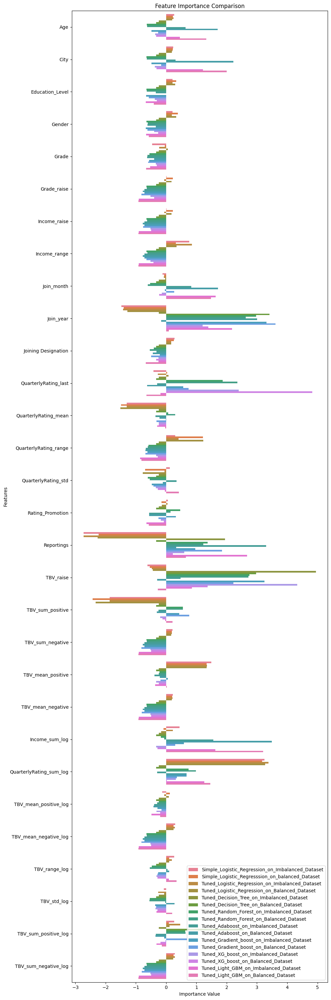

In [ ]:
feature_importance_plots(feature_importance_scaled)

### sum of all the feature_importances and normalizing

In [ ]:
combined_feature_importance_scaled = feature_importance_scaled.sum(axis = 1)

In [ ]:
combined_feature_importance_scaled = pd.DataFrame(combined_feature_importance_scaled,index=combined_feature_importance_scaled.index,columns = ["combined_feature_importances"])

In [ ]:
combined_feature_importance_scaled

,combined_feature_importances
Age,1.759584
City,3.407079
Education_Level,-4.148663
Gender,-4.846839
Grade,-6.445801
Grade_raise,-7.252526
Income_raise,-7.299877
Income_range,-5.163849
Join_month,3.492457
Join_year,17.824404


In [ ]:
scaler = StandardScaler()
combined_feature_importance_scaled = pd.DataFrame(scaler.fit_transform(combined_feature_importance_scaled),
                                         index=combined_feature_importance_scaled.index,
                                         columns = combined_feature_importance_scaled.columns)
combined_feature_importance_scaled

,combined_feature_importances
Age,0.212454
City,0.411374
Education_Level,-0.500914
Gender,-0.585213
Grade,-0.778273
Grade_raise,-0.875678
Income_raise,-0.881395
Income_range,-0.623489
Join_month,0.421683
Join_year,2.152138


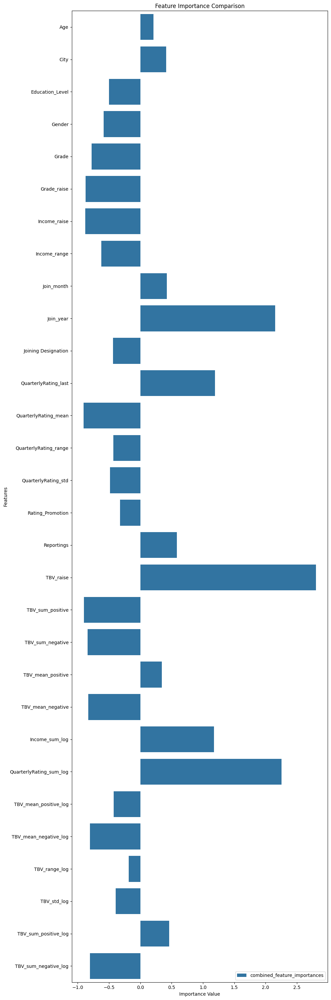

In [ ]:
feature_importance_plots(combined_feature_importance_scaled)

In [ ]:
combined_feature_importance_scaled[np.abs(combined_feature_importance_scaled["combined_feature_importances"])>=0.8]

,combined_feature_importances
Grade_raise,-0.875678
Income_raise,-0.881395
Join_year,2.152138
QuarterlyRating_last,1.191021
QuarterlyRating_mean,-0.907765
TBV_raise,2.805281
TBV_sum_positive,-0.900924
TBV_sum_negative,-0.839530
TBV_mean_negative,-0.831710
Income_sum_log,1.175887


**Observation**
> Most Important Features:<br>
* QuarterlyRating_sum_log: Another critical feature, suggesting that the cumulative log of quarterly ratings significantly impacts the outcome. <br>
* TBV_raise: This feature also shows high importance, meaning that changes or raises in Total Business Value (TBV) are crucial.<br>
* Join_year: The year of joining appears to be a highly relevant factor, potentially affecting performance or outcomes over time.<br>

> Moderately Important Features:<br>
* Income_sum_log: The log-transformed sum of income is moderately important, indicating that income trends play a role.<br>
* TBV_sum_positive_log: This suggests that positive TBV values, when log-transformed, also have a moderate impact.<br>
* QuarterlyRating_last, QuarterlyRating_mean: Both the last and mean quarterly ratings are moderately important, highlighting the significance of periodic performance evaluations.<br>

> Less Important Features:<br>
* Age, City: These demographic features have relatively lower importance, indicating they have less influence on the target variable.<br>
* Gender, Education_Level: These features also show lower importance, suggesting that gender and education level may not be as critical in this context.<br>
* Various other TBV and Rating features: Some TBV and rating-related features (like TBV_mean_positive_log, TBV_mean_negative, TBV_std_log) have lesser importance, but they still contribute to the model. <br>

> Negative Importance Values:<br>
* Some features have negative importance values, such as QuarterlyRating_std, TBV_sum_positive, TBV_mean_negative_log. This might indicate that these features negatively correlate with the target. So Increase in These features makes the driver churn off

## PLOT ALL LEARNING CURVES

In [ ]:
def get_experiment_id(experiment_name):
    experiment = mlflow.get_experiment_by_name(experiment_name)
    if experiment:
        return experiment.experiment_id
    else:
        print(f"Experiment '{experiment_name}' not found.")
        return None

def get_run_ids(experiment_id):
    client = mlflow.tracking.MlflowClient()
    runs = client.search_runs(experiment_id)
    return [run.info.run_id for run in runs]

# Example usage
experiment_id = get_experiment_id("Ola_Ensemble_Learning")
run_ids = get_run_ids(experiment_id)

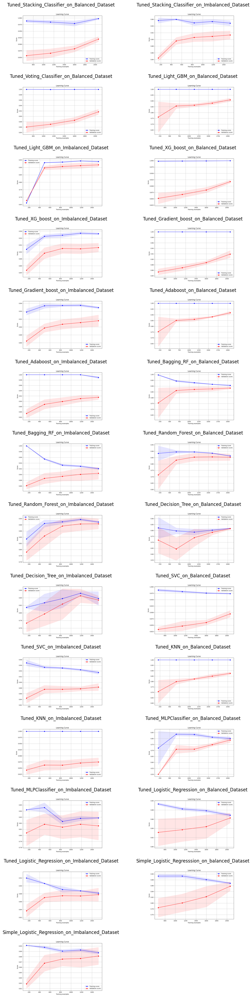

In [ ]:
def plot_all_learning_curves(experiment_id, run_ids):
    plt.figure(figsize=(10, 40))
    plot_count = 1

    for run_id in run_ids:
        run_path = f"mlruns/{experiment_id}/{run_id}/artifacts/"
        for file in os.listdir(run_path):
            if file.endswith("_learning_curve.png"):
                img = plt.imread(os.path.join(run_path, file))
                plt.subplot(len(run_ids)//2, 2, plot_count)
                plt.imshow(img)
                plt.axis('off')
                plt.title(f"{file.replace('_learning_curve.png', '')}")
                plot_count += 1

    plt.tight_layout()
    plt.show()

# Example usage
plot_all_learning_curves(experiment_id, run_ids)

**Observation**
> Stacking classifier has Good Training scores and Validation scores are steadily improving with increase in training examples. Both training and test score crossed 90%. So increase in dataset results in better accuracy by using stacking classifer

> Voting Classifier for Imbalanced dataset was not logged

> LightGBM has Best generalization in case of Imbalanced Dataset

> All the Boosting models have very less scores for less training samples, But Drastically improved with number of training samples. So increase in dataset definitely improves better generalization in Boosting with less training and testing times

> Bagging and Random forest are not near 100 %. So to improve the accuracy in Bagging or RF, We need very big datasets. But generalization is very good in these techniques.

> All Basic models, Logistic Regression, MLPClassifier,DT cannot provide better accuracy but provide better generatlisation.

> KNN and SVC suffers in at both accuracy and generalization

## PLOT ALL AUC PLOTS

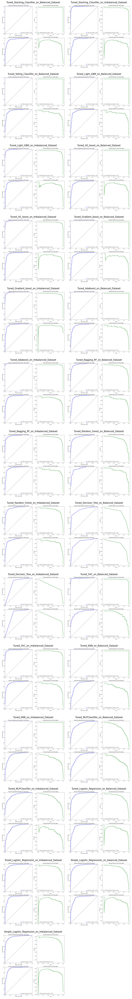

In [ ]:
def plot_all_roc_auc_plots(experiment_id, run_ids):
    plt.figure(figsize=(10, 80))
    plot_count = 1

    for run_id in run_ids:
        run_path = f"mlruns/{experiment_id}/{run_id}/artifacts/"
        for file in os.listdir(run_path):
            if file.endswith("_auc_plots.png"):
                img = plt.imread(os.path.join(run_path, file))
                plt.subplot(len(run_ids)//2, 2, plot_count)
                plt.imshow(img)
                plt.axis('off')
                plt.title(f"{file.replace('_auc_plots.png', '')}")
                plot_count += 1

    plt.tight_layout()
    plt.show()

# Example usage
plot_all_roc_auc_plots(experiment_id, run_ids)

**Observation**
>PR_AUC_test achieved is 0.97 on Boosting , Voting and Stacking Classifiers

> AU_ROC test achieved is 0.96 on Adaboost, Gradient_Boost, XGBoost and LightGBM models

> PR_AUC is used for comparing imbalanced datasets

> Au_roc is used for comparing balanced datasets

> PR_AUC reached 1 for Stacking, Voting, LightGBM, XGBOOST, Adaboost for balanced training dataset    

## PRINT ALL CLASSIFICATION REPORTS

In [ ]:
def print_all_classification_reports(experiment_id, run_ids):
    for run_id in run_ids:
        run_path = f"mlruns/{experiment_id}/{run_id}/artifacts/"
        for file in os.listdir(run_path):
            if file.endswith("_classification_report.csv"):
                report_df = pd.read_csv(os.path.join(run_path, file), index_col=0)
                print(f"\n{file.replace('_classification_report.csv', '')}:\n")
                print(report_df)
                print("\n" + "-"*80 + "\n")

# Example usage
print_all_classification_reports(experiment_id, run_ids)


Two_Level_Cascading_Classifier_on_Balanced_Dataset_test:

              precision    recall  f1-score     support
0              0.831169  0.853333  0.842105  150.000000
1              0.931889  0.920489  0.926154  327.000000
accuracy       0.899371  0.899371  0.899371    0.899371
macro avg      0.881529  0.886911  0.884130  477.000000
weighted avg   0.900216  0.899371  0.899723  477.000000

--------------------------------------------------------------------------------


Two_Level_Cascading_Classifier_on_Balanced_Dataset_train:

              precision    recall  f1-score      support
0              0.999224  0.999224  0.999224  1289.000000
1              0.999224  0.999224  0.999224  1289.000000
accuracy       0.999224  0.999224  0.999224     0.999224
macro avg      0.999224  0.999224  0.999224  2578.000000
weighted avg   0.999224  0.999224  0.999224  2578.000000

--------------------------------------------------------------------------------


Two_Level_Cascading_Classifier_on_Im

# CHAPTER 7 ACTIONABLE INSIGHTS AND RECOMMENDATIONS

## INSIGHTS

> The percentages of employees with different education levels are almost same

> Majority (35%) of the employees currently are at designation level 2, followed by designation level 1 (31%) and 3 (26%). Less than 5% of the employees are currently in higher designations.

> Almost 43% of the employees joined at lowest designation (1). 34% joined at level 2, 20% at level 3 and below 2% joined at higher levels.

> The median of the Income for employees having higher Grades is greater.

> Top reporting days is 24 days.     

> Recall and F1 or F2 Score should be considered important in driver churn prediction case.

> Initial Dataset contains 12 Features. But after Feature Engineering feature space was increased to 31 features and 1 target

> Models under perform with outliers in Age and Gender. So they are handled by using neighboring value in ordered data.

> For basic models Imbalanced models may dominate balanced models in terms of metrics, but ensemble models definitely Balanced models provide better accuracy and generalization. It can be observed in learning curves and classification reports.

> To deploy the model, It is better to use Balanced Dataset and Voting/Stacking ensembling on Boosted Models.

> Join_year, TBV_raise, QuarterlyRating_sum_log are most important features positively

> TBV_mean_negative_log, TBV_sum_positive, Quarerly_rating_std, Grade raise, income raise are most important features negatively.

> Models tend to perform better on balanced datasets, showing higher validation scores and narrower gaps between training and validation scores.

> Overfitting is more pronounced on imbalanced datasets, with larger gaps between training and validation scores.

> Ensemble models like Stacking, Voting, LightGBM, and XGBoost generally perform well but still show signs of overfitting on imbalanced data.

> Simpler models like Logistic Regression and SVC demonstrate better generalization but may have lower overall performance compared to ensemble methods.

> Max PR_AUC_test achieved is 0.97 using Boosting, Voting and Stacking

> Max AU_ROC_test achieved is 0.96 using Boosting models

## RECOMMENDATIONS

> Increase the Dataset size for better accuracy and generalization. Learning curves shows that there is monotonic increase in validation scores with increase in training samples.

> Cascading with two level may not provide better accuracy. So Better go for four or five level cascade models.

> Hyper parameter tuning can be done by using Grid search cv for better tuning parameters. But it may cost more time.

> Robust performance can be achieved by Balancing dataset and using Ensemble methods like Voting and Stacking.

> Regularization can be done to reduce the overfitting scenarios in ensemble methods

> Deploying can be done by integrating MLFlow with AWS Sagemaker/Streamlit     